In [1]:
#%pip install tensorflow --user

In [ ]:
import random
import sys
sys.path.append('/Users/nizol/Desktop/tgym/dq-MM/')
import numpy as np
import pandas as pd
from keras.layers import Dense
from keras.models import Sequential
from keras.optimizers import Adam
#from tgym.envs import SpreadTrading
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [4]:
t = pd.read_csv('data/SBER20150310.csv')
t.head()

,Unnamed: 0,BidPrice5,BidVolume5,BidPrice4,BidVolume4,BidPrice3,BidVolume3,BidPrice2,BidVolume2,BidPrice1,...,EMA30,EMA100,STD10,STD50,STD100,STD1000,RSI14,RSI30,RSI50,RSI100
0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,70.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,0.0,0.0,0.0,0.0,0.0,0.0,70.00,20.0,70.50,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,0.0,0.0,0.0,0.0,70.0,20.0,70.50,880.0,72.45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3,0.0,0.0,70.0,20.0,70.5,880.0,72.23,10700.0,72.45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4,70.0,20.0,70.5,880.0,71.0,100.0,72.23,10700.0,72.45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
data = t[['AskPrice1', 'AskVolume1', 'BidPrice1', 'BidVolume1']]
data.head()

,AskPrice1,AskVolume1,BidPrice1,BidVolume1
0,0.0,0.0,70.00,20.0
1,0.0,0.0,70.50,880.0
2,0.0,0.0,72.45,15000.0
3,0.0,0.0,72.45,15000.0
4,0.0,0.0,72.45,15000.0


In [6]:
data.drop_duplicates(inplace=True)

<ipython-input-6-515f69ef7765>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop_duplicates(inplace=True)


In [8]:
class DataFeed(object):
    def __init__(self, data_RA):
        self.data_RA = data_RA
        self.rewind()
    def next(self):
        try:
            return self.__gen.__next__()
        except StopIteration as e:
            raise e
    def rewind(self):
        self.__gen = (row for row in self.data_RA)

In [9]:
data_RA = np.array(data[5:100001])
data_generator = DataFeed(data_RA)

In [33]:
class Env(object):
    """Abstract class for an environment. Simplified OpenAI API.
    """

    def __init__(self):
        self.n_actions = None
        self.state_shape = None

    def step(self, action):
        """Run one timestep of the environment's dynamics.
        Accepts an action and returns a tuple (observation, reward, done, info).
        Args:
            action (numpy.array): action array
        Returns:
            tuple:
                - observation (numpy.array): Agent's observation of the current environment.
                - reward (float) : Amount of reward returned after previous action.
                - done (bool): Whether the episode has ended, in which case further step() calls will return undefined results.
                - info (str): Contains auxiliary diagnostic information (helpful for debugging, and sometimes learning).
        """
        raise NotImplementedError()

    def reset(self):
        """Reset the state of the environment and returns an initial observation.
        Returns:
            numpy.array: The initial observation of the space. Initial reward is assumed to be 0.
        """
        raise NotImplementedError()

    def render(self):
        """Render the environment.
        """
        raise NotImplementedError()

In [34]:
class SpreadTrading(Env):
    """Class for a discrete (buy/hold/sell) spread trading environment.
    """

    _actions = {
        'hold': np.array([1, 0, 0]),
        'buy': np.array([0, 1, 0]),
        'sell': np.array([0, 0, 1])
    }

    _positions = {
        'flat': np.array([1, 0, 0]),
        'long': np.array([0, 1, 0]),
        'short': np.array([0, 0, 1])
    }

    def __init__(self, data_generator, spread_coefficients, episode_length=1000, trading_fee=0, time_fee=0, history_length=2):
        """Initialisation function
        Args:
            data_generator (tgym.core.DataGenerator): A data
                generator object yielding a 1D array of bid-ask prices.
            spread_coefficients (list): A list of signed integers defining
                how much of each product to buy (positive) or sell (negative)
                when buying or selling the spread.
            episode_length (int): number of steps to play the game for
            trading_fee (float): penalty for trading
            time_fee (float): time fee
            depths_history: bid, ask depth
            history_length (int): number of historical states to stack in the
                observation vector.
        """
        #assert data_generator.n_products == len(spread_coefficients)
        assert history_length > 0
        self._data_generator = data_generator
        self._spread_coefficients = spread_coefficients
        self._first_render = True
        self._trading_fee = trading_fee
        self._time_fee = time_fee
        self._episode_length = episode_length
        self.n_actions = 3
        self._prices_history = []
        self._depths_history = []
        self._history_length = history_length
        self.reset()

    def reset(self):
        """Reset the trading environment. Reset rewards, data generator...
        Returns:
            observation (numpy.array): observation of the state
        """
        self._iteration = 0
        self._data_generator.rewind()
        self._total_reward = 0
        self._total_pnl = 0
        self._position = self._positions['flat']
        self._entry_price = 0
        self._exit_price = 0
        self._closed_plot = False

        for i in range(self._history_length):
            gen = np.array(self._data_generator.next())
            self._prices_history.append(gen[[2,0]])
            self._depths_history.append(gen[[3,1]])

        observation = self._get_observation()
        self.state_shape = observation.shape
        self._action = self._actions['hold']
        return observation

    def step(self, action):
        """Take an action (buy/sell/hold) and computes the immediate reward.
        Args:
            action (numpy.array): Action to be taken, one-hot encoded.
        Returns:
            tuple:
                - observation (numpy.array): Agent's observation of the current environment.
                - reward (float) : Amount of reward returned after previous action.
                - done (bool): Whether the episode has ended, in which case further step() calls will return undefined results.
                - info (dict): Contains auxiliary diagnostic information (helpful for debugging, and sometimes learning).
        """

        assert any([(action == x).all() for x in self._actions.values()])
        self._action = action
        self._iteration += 1
        done = False
        instant_pnl = 0
        info = {}
        reward = -self._time_fee
        #r = np.random.rand(1)
        q = np.float(self._depths_history[-1][0])/(self._depths_history[-1][0] +self._depths_history[-1][1])
        fill_ask = True 
        fill_bid = True 
        
        #if q>0.8:
        #    fill_bid = False 
        #elif q<0.2:
        #    fill_ask = False 

        if all(action == self._actions['buy']) and (fill_bid):
            reward -= self._trading_fee
            if all(self._position == self._positions['flat']):         
                self._position = self._positions['long']
                self._entry_price =  self._prices_history[-1][0]  # bid
                #reward -= 0 #self._entry_price
            elif all(self._position == self._positions['short']): # closed out a short position          
                self._position = self._positions['flat']
                self._exit_price = self._prices_history[-1][0]  # bid

                instant_pnl = self._entry_price - self._exit_price
                self._entry_price = 0

        elif all(action == self._actions['sell']) and (fill_ask):
            reward -= self._trading_fee
            if all(self._position == self._positions['flat']):
                self._position = self._positions['short']
                self._entry_price = self._prices_history[-1][1]  # ask
            elif all(self._position == self._positions['long']):
                self._exit_price = self._prices_history[-1][1]  # ask
                instant_pnl = self._exit_price - self._entry_price
                self._position = self._positions['flat']
                self._entry_price = 0

        reward += instant_pnl
        self._total_pnl += instant_pnl
        self._total_reward += reward

        # Game over logic
        try:
            gen = np.array(self._data_generator.next())
            self._prices_history.append(gen[[2,0]])
            self._depths_history.append(gen[[3,1]])
        except StopIteration:
            done = True
            info['status'] = 'No more data.'
        if self._iteration >= self._episode_length:
            done = True
            info['status'] = 'Time out.'
        if self._closed_plot:
            info['status'] = 'Closed plot'

        observation = self._get_observation()
        return observation, reward, done, info
    
    def _handle_close(self, evt):
        self._closed_plot = True

    def render(self, savefig=False, filename='myfig'):
        """Matlplotlib rendering of each step.
        Args:
            savefig (bool): Whether to save the figure as an image or not.
            filename (str): Name of the image file.
        """
        if self._first_render:
            self._f, self._ax = plt.subplots(
                len(self._spread_coefficients) + int(len(self._spread_coefficients) > 1),
                sharex=True
            )
            if len(self._spread_coefficients) == 1:
                self._ax = [self._ax]
            self._f.set_size_inches(12, 6)
            self._first_render = False
            self._f.canvas.mpl_connect('close_event', self._handle_close)
        if len(self._spread_coefficients) > 1:
            # TODO: To be checked
            for prod_i in range(len(self._spread_coefficients)):
                bid = self._prices_history[-1][2 * prod_i]
                ask = self._prices_history[-1][2 * prod_i + 1]
                self._ax[prod_i].plot([self._iteration, self._iteration + 1],
                                      [bid, bid], color='white')
                self._ax[prod_i].plot([self._iteration, self._iteration + 1],
                                      [ask, ask], color='white')
                self._ax[prod_i].set_title('Product {} (spread coef {})'.format(
                    prod_i, str(self._spread_coefficients[prod_i])))

        # Spread price
        prices = self._prices_history[-1]
        bid, ask = calc_spread(prices, self._spread_coefficients)
        self._ax[-1].plot([self._iteration, self._iteration + 1],
                          [bid, bid], color='white')
        self._ax[-1].plot([self._iteration, self._iteration + 1],
                          [ask, ask], color='white')
        ymin, ymax = self._ax[-1].get_ylim()
        yrange = ymax - ymin
        if (self._action == self._actions['sell']).all():
            self._ax[-1].scatter(self._iteration + 0.5, bid + 0.03 *
                                 yrange, color='orangered', marker='v')
        elif (self._action == self._actions['buy']).all():
            self._ax[-1].scatter(self._iteration + 0.5, ask - 0.03 *
                                 yrange, color='lawngreen', marker='^')
        plt.suptitle('Cumulated Reward: ' + "%.2f" % self._total_reward + ' ~ ' +
                     'Cumulated PnL: ' + "%.2f" % self._total_pnl + ' ~ ' +
                     'Position: ' + ['flat', 'long', 'short'][list(self._position).index(1)] + ' ~ ' +
                     'Entry Price: ' + "%.2f" % self._entry_price)
        self._f.tight_layout()
        plt.xticks(range(self._iteration)[::5])
        plt.xlim([max(0, self._iteration - 80.5), self._iteration + 0.5])
        plt.subplots_adjust(top=0.85)
        plt.pause(0.01)
        if savefig:
            plt.savefig(filename)

    def _get_observation(self):
        """Concatenate all necessary elements to create the observation.
        Returns:
            numpy.array: observation array.
        """
        return np.concatenate(
            [prices for prices in self._prices_history[-self._history_length:]] +

            [depths for depths in self._depths_history[-self._history_length:]] +
            [
                np.array([self._entry_price]),
                np.array(self._position)
            ]
        )

    @staticmethod
    def random_action_fun():
        """The default random action for exploration.
        We hold 80% of the time and buy or sell 10% of the time each.
        Returns:
            numpy.array: array with a 1 on the action index, 0 elsewhere.
        """
        return np.random.multinomial(1, [0.8, 0.1, 0.1])

In [35]:
class DQNAgent:
    def __init__(self,
                 state_size,
                 action_size,
                 episodes,
                 episode_length,
                 memory_size=2000,
                 train_interval=100,
                 gamma=0.95,
                 learning_rate=0.001,
                 batch_size=64,
                 epsilon_min=0.01
                 ):
        self.state_size = state_size
        self.action_size = action_size
        self.memory_size = memory_size
        self.memory = [None] * memory_size
        self.gamma = gamma
        self.epsilon = 1.0
        self.epsilon_min = epsilon_min
        self.epsilon_decrement = (self.epsilon - epsilon_min)\
            * train_interval / (episodes * episode_length)  # linear decrease rate
        self.learning_rate = learning_rate
        self.train_interval = train_interval
        self.batch_size = batch_size
        self.brain = self._build_brain()
        self.i = 0

    def _build_brain(self):
        """Build the agent's brain
        """
        brain = Sequential()
        neurons_per_layer = 24
        activation = "relu"
        brain.add(Dense(neurons_per_layer,
                        input_dim=self.state_size,
                        activation=activation))
        brain.add(Dense(neurons_per_layer, activation=activation))
        brain.add(Dense(self.action_size, activation='linear'))
        brain.compile(loss='mse', optimizer=Adam(lr=self.learning_rate))
        return brain

    def act(self, state):
        """Acting Policy of the DQNAgent
        """
        action = np.zeros(self.action_size)
        valid_actions = []
        position = state[-3:]
        
        if all(position == [1,0,0]): # flat
            valid_actions = [0,1,2]
        elif all(position == [0,1,0]):  # long
            valid_actions = [0,2]  # hold or sell
        else: # short
            valid_actions = [0,1]  # hold or buy
        
        if np.random.rand() <= self.epsilon:    
            action[valid_actions[random.randrange(len(valid_actions))]] = 1   
        else:
            state = state.reshape(1, self.state_size)
            act_values = self.brain.predict(state)
            print(act_values[0])
            action[valid_actions[np.argmax(act_values[0][valid_actions])]] = 1
        return action

    def observe(self, state, action, reward, next_state, done, warming_up=False):
        """Memory Management and training of the agent
        """
        self.i = (self.i + 1) % self.memory_size
        self.memory[self.i] = (state, action, reward, next_state, done)
        if (not warming_up) and (self.i % self.train_interval) == 0:
            if self.epsilon > self.epsilon_min:
                self.epsilon -= self.epsilon_decrement
            state, action, reward, next_state, done = self._get_batches()
            reward += (self.gamma
                       * np.logical_not(done)
                       * np.amax(self.brain.predict(next_state),
                                 axis=1))
            q_target = self.brain.predict(state)
            print ("state: ", state[0])
            print ("action[0]: ", action[0])
            print ("action[1]: ", action[1])
            print ("q_target: ", q_target[action[0], action[1]])
            print ("reward: ", reward)
            
            q_target[action[0], action[1]] = reward
            return self.brain.fit(state, q_target,
                                  batch_size=self.batch_size,
                                  epochs=1,
                                  verbose=False)

    def _get_batches(self):
        """Selecting a batch of memory
           Split it into categorical subbatches
           Process action_batch into a position vector
        """
        batch = np.array(random.sample(self.memory, self.batch_size))
        state_batch = np.concatenate(batch[:, 0])\
            .reshape(self.batch_size, self.state_size)
        action_batch = np.concatenate(batch[:, 1])\
            .reshape(self.batch_size, self.action_size)
        reward_batch = batch[:, 2]
        next_state_batch = np.concatenate(batch[:, 3])\
            .reshape(self.batch_size, self.state_size)
        done_batch = batch[:, 4]
        # action processing
        action_batch = np.where(action_batch == 1)
        return state_batch, action_batch, reward_batch, next_state_batch, done_batch

In [36]:
import matplotlib.pyplot as plt
#import sys
#sys.path.append('/Users/matthewdixon/Downloads/Trading-Gym/')
#from tgym.envs import SpreadTrading
#from tgym.gens.deterministic import WavySignal
#from tgym.gens.random import AR1
#from tgym.gens.csvstream import CSVStreamer
# Instantiating the environmnent
generator = data_generator
#generator = AR1(a=0.1, ba_spread=0.1)   #WavySignal(period_1=25, period_2=50, epsilon=-0.5)
episodes = 100
episode_length = 400
trading_fee = .0
time_fee = 0
history_length = 2
environment = SpreadTrading(spread_coefficients=[1],
                            data_generator=generator,
                                trading_fee=trading_fee,
                                time_fee=time_fee,
                                history_length=history_length)

In [37]:
state = environment.reset()
# Instantiating the agent
memory_size = 3000
state_size = len(state)
gamma = 0.96
epsilon_min = 0.01
batch_size = 64
action_size = len(SpreadTrading._actions)
train_interval = 10
learning_rate = 0.001
agent = DQNAgent(state_size=state_size,
                     action_size=action_size,
                     memory_size=memory_size,
                     episodes=episodes,
                     episode_length=episode_length,
                     train_interval=train_interval,
                     gamma=gamma,
                     learning_rate=learning_rate,
                     batch_size=batch_size,
                     epsilon_min=epsilon_min)

In [38]:
# Warming up the agent
for _ in range(memory_size):
        action = agent.act(state)
        next_state, reward, done, _ = environment.step(action)
        agent.observe(state, action, reward, next_state, done, warming_up=True)
        
rews = []
losses = []
epsilons = []
# Training the agent
for ep in range(episodes):
    state = environment.reset()
    rew = 0
    for _ in range(episode_length):
        action = agent.act(state)
        
        for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            position_name = position
        
    
        for _action in environment._actions:
          if all(action==environment._actions[_action]):
            action_name = _action
        
        next_state, reward, done, _ = environment.step(action)
        
        for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            next_position_name = position
        
        
           
        #print position_name, action_name, next_position_name
        loss = agent.observe(state, action, reward, next_state, done)
        state = next_state
        rew += reward
    print("Ep:" + str(ep)
           + "| rew:" + str(round(rew, 2))
           + "| eps:" + str(round(agent.epsilon, 2))
           + "| loss:" + str(round(loss.history["loss"][0], 4)))
    rews.append(rew)
    epsilons.append(agent.epsilon)
    losses.append(loss.history["loss"][0])

<ipython-input-35-42eb28726c42>:97: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  batch = np.array(random.sample(self.memory, self.batch_size))


state:  [7.245e+01 7.390e+01 7.246e+01 7.390e+01 1.500e+04 1.000e+03 1.000e+01
 1.000e+03 0.000e+00 1.000e+00 0.000e+00 0.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [2 2 0 1 1 2 0 0 2 1 0 1 0 0 2 0 0 1 1 1 0 0 0 1 0 0 1 0 1 2 1 1 1 2 0 0 1
 2 2 0 1 1 2 0 2 2 1 0 2 2 0 2 1 1 2 1 2 0 0 0 1 1 2 1]
q_target:  [ 4108.12     4108.12    -2061.5176    444.72607   444.72607  4108.12
 -2061.5176  -2061.5176   4108.12      444.72607 -2061.5176    444.72607
 -2061.5176  -2061.5176   4108.12    -2061.5176  -2061.5176    444.72607
   444.72607   444.72607 -2061.5176  -2061.5176  -2061.5176    444.72607
 -2061.5176  -2061.5176    444.72607 -2061.5176    444.72607  4108.12
   444.72583   444.72583   444.72607  4108.12    -2061.5176  -2061.5176
   444.72607  4108.12     4108.12    -2061.5176    444.72607   444.72607
  4

In [39]:
len(SpreadTrading._actions)

3

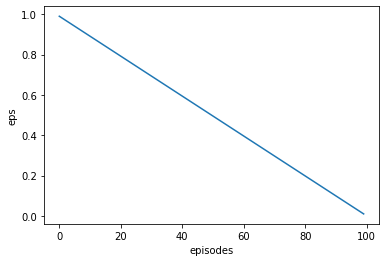

In [40]:
plt.plot(epsilons)
plt.xlabel('episodes')
plt.ylabel('eps')
plt.savefig('epsilons.jpg')

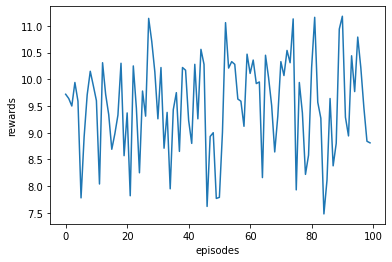

In [41]:
plt.plot(rews)
plt.xlabel('episodes')
plt.ylabel('rewards')
plt.savefig('rewards.jpg')

In [42]:
def calc_spread(prices, spread_coefficients):
    """Calculate the spread based on spread_coefficients.
    Args:
        spread_coefficients (list): A list of signed integers defining how much
            of each product to buy (positive) or sell (negative) when buying or
            selling the spread.
        prices (numpy.array): Array containing the prices (bid, ask) of
            different products, i.e: [p1_b, p1_a, p2_b, p2_a].
    Returns:
        tuple:
            - (float) spread bid price,
            - (float) spread ask price.
    """
    spread_bid = sum([
        spread_coefficients[i] *
        prices[2 * i + int(spread_coefficients[i] < 0)]
        for i in range(len(spread_coefficients))]
    )
    spread_ask = sum([
        spread_coefficients[i] *
        prices[2 * i + int(spread_coefficients[i] > 0)]
        for i in range(len(spread_coefficients))]
    )
    return spread_bid, spread_ask

[291.54666 393.5757  246.53842]
flat buy long


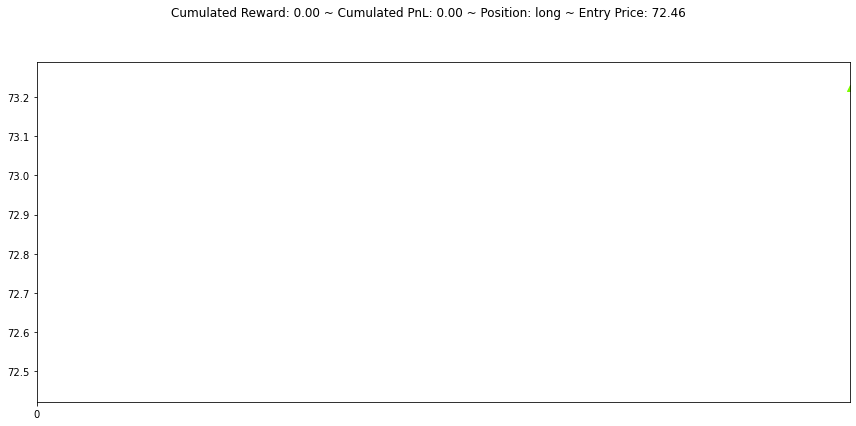

[563.48834 567.79517 520.02344]
long hold long


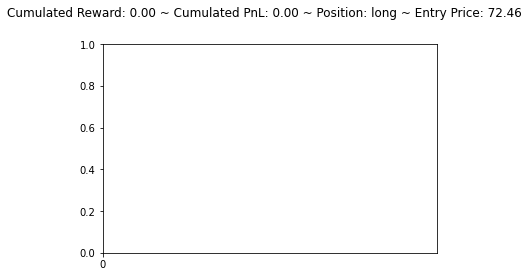

[432.2619  507.52045 335.48297]
long hold long


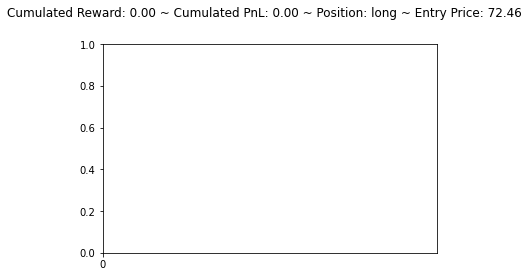

[539.5062  567.0682  539.80255]
long sell flat


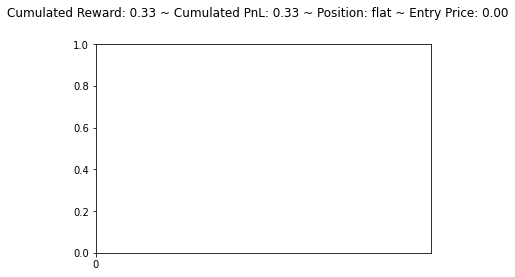

[476.18555 543.46826 482.84494]
flat buy long


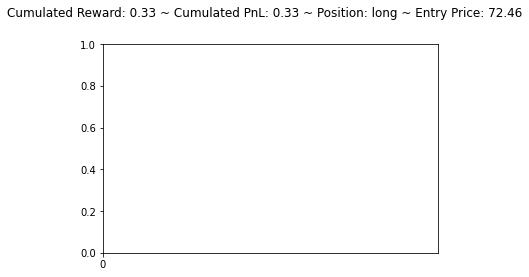

[510.32867 570.06757 532.72235]
long sell flat


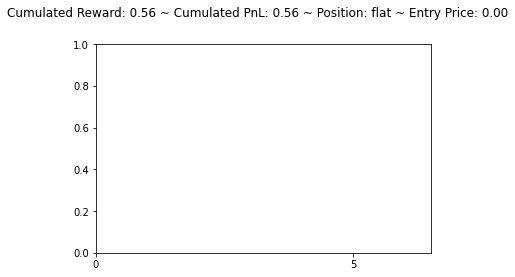

[324.93018 313.13626 312.10947]
flat hold flat


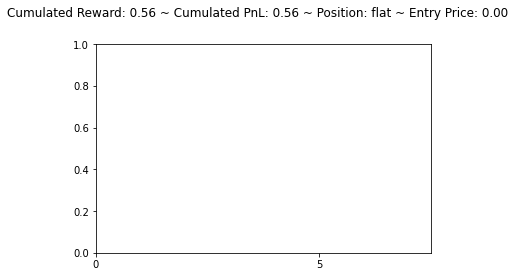

[370.0292  425.13214 350.83386]
flat buy long


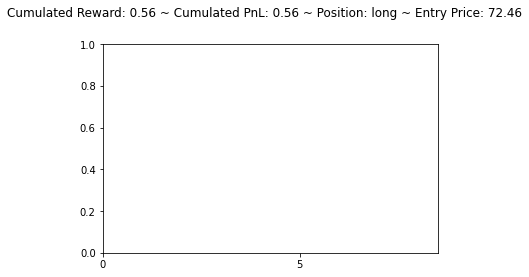

[826.5975 670.5947 755.0787]
long hold long


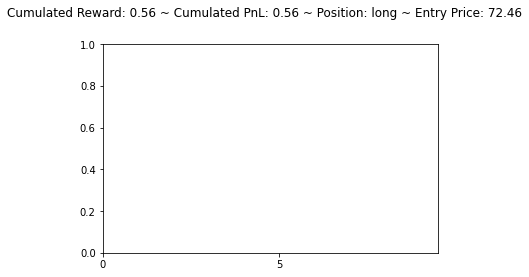

[1082.7535  859.8627 1087.7462]
long sell flat


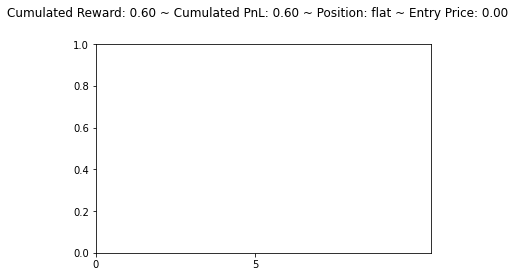

[1617.085  1215.5576 1665.2365]
flat sell short


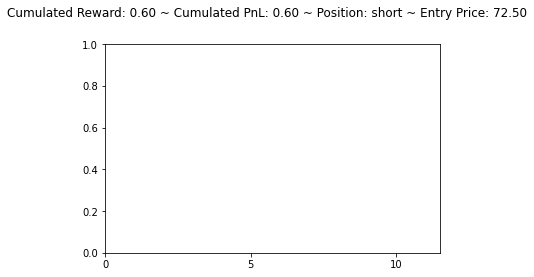

[1660.9891 1559.1953 1565.8773]
short hold short


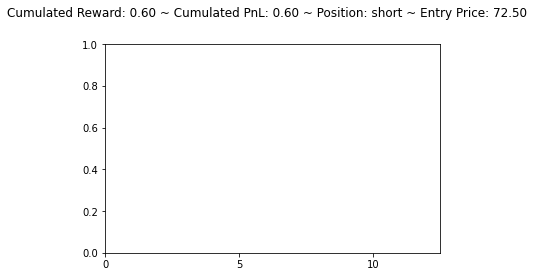

[2087.8032 1856.261  1986.1368]
short hold short


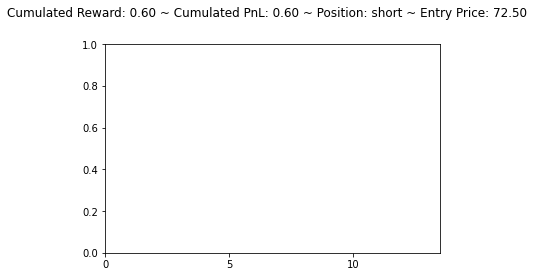

[2576.708  2274.79   2502.3286]
short hold short


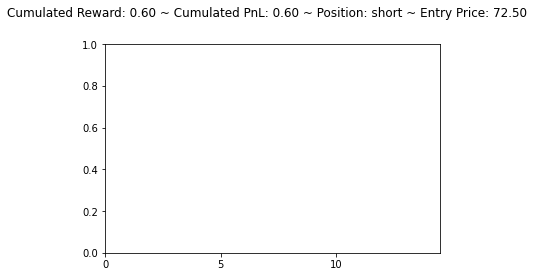

[2282.0334 2222.734  2253.352 ]
short hold short


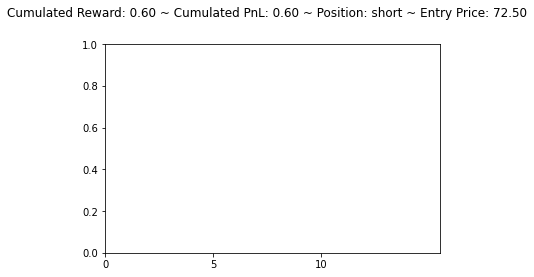

[3306.7263 2966.15   3346.1423]
short hold short


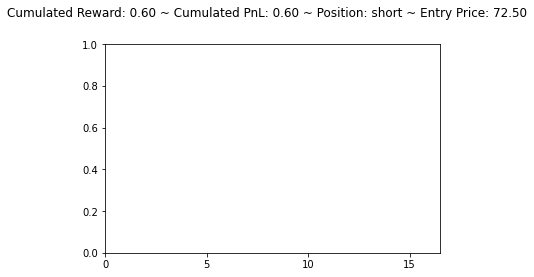

[3141.5598 2967.6353 3002.1147]
short hold short


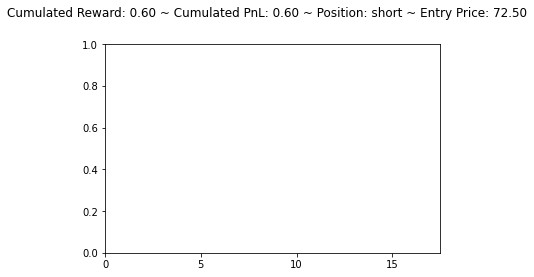

[3087.7056 2968.009  3018.7095]
short hold short


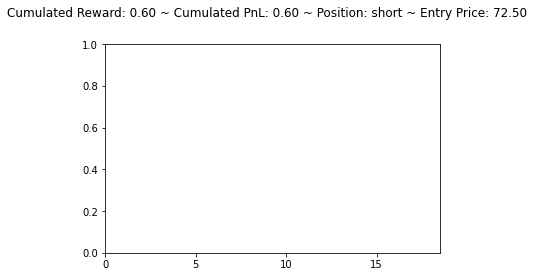

[3094.5208 2076.7007 1523.9894]
short hold short


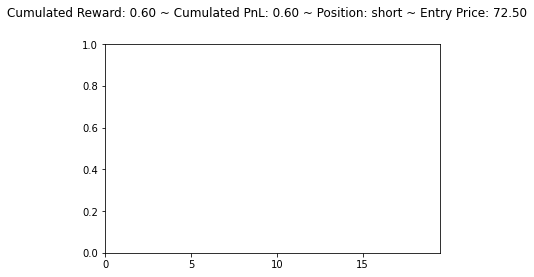

[3316.8352 3606.738  3528.4536]
short buy flat


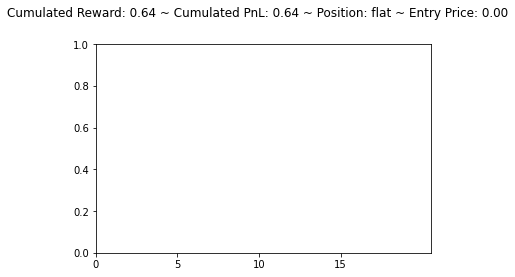

flat hold flat


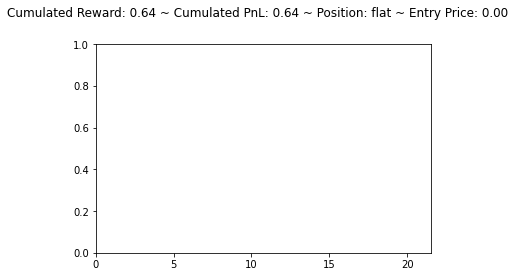

[2470.5244 2371.1238 2656.7178]
flat sell short


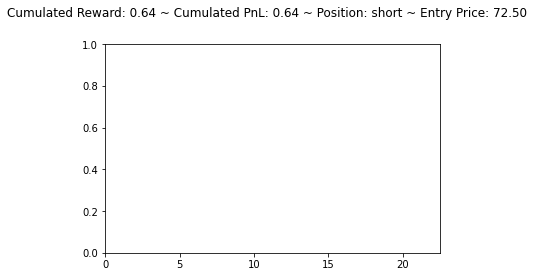

[2396.7615 2317.6294 2806.2336]
short hold short


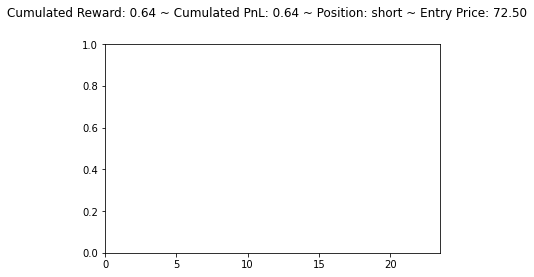

[2524.5547 2587.06   2654.4546]
short buy flat


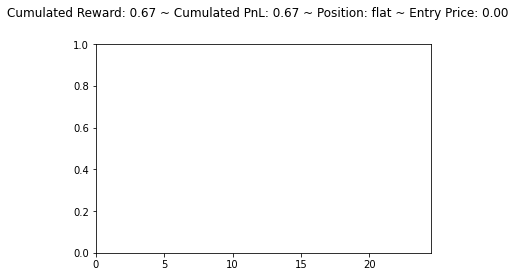

[2617.4573 2517.3936 2550.4456]
flat hold flat


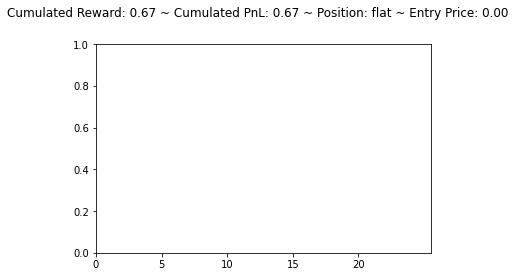

[2110.219  2065.8135 2180.7798]
flat sell short


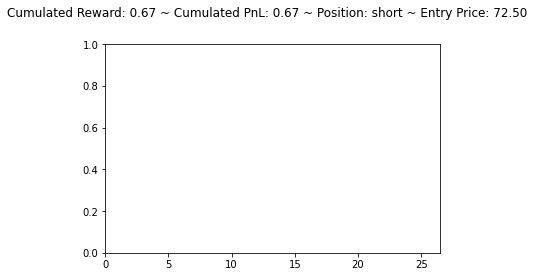

[2038.7739 1902.392  2130.074 ]
short hold short


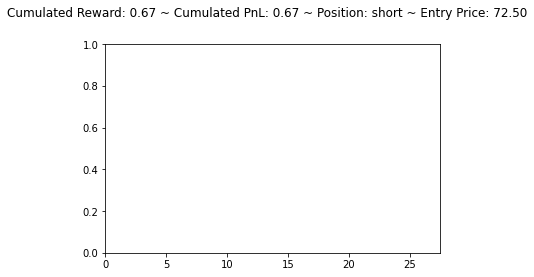

[2005.519  1798.7465 2040.1063]
short hold short


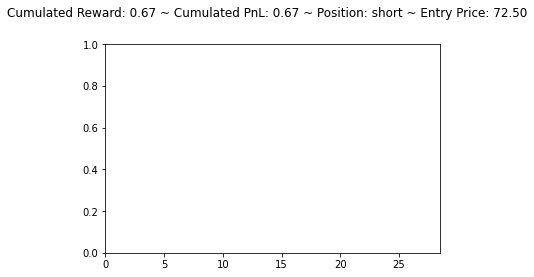

[1235.5706 1762.4922 1600.594 ]
short buy flat


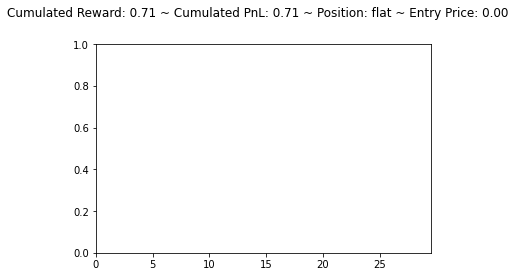

[617.4342  856.2293  924.64844]
flat sell short


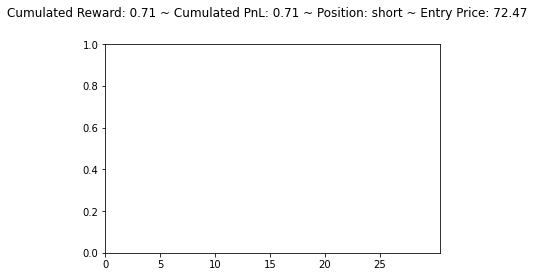

[ 730.6821  1098.4025   967.10846]
short buy flat


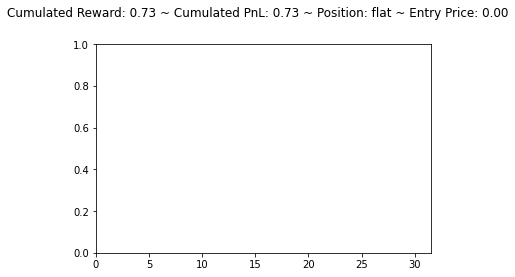

[322.14185 282.14136 406.37024]
flat sell short


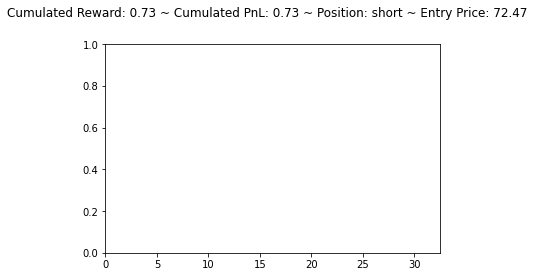

[279.28958 426.73013 409.0305 ]
short buy flat


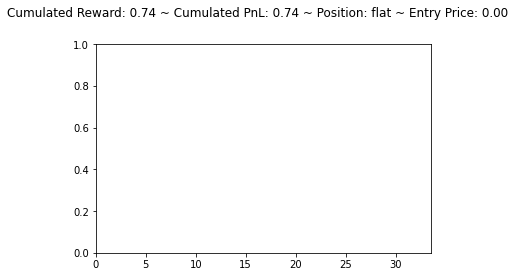

[794.0975 705.0079 654.0943]
flat hold flat


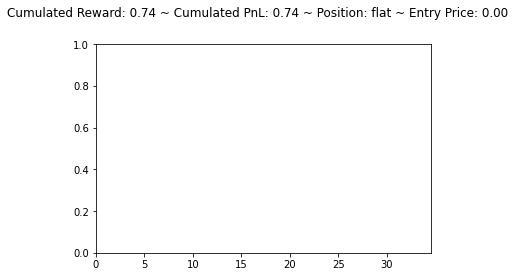

[ 645.0569  1028.7526   897.95953]
flat buy long


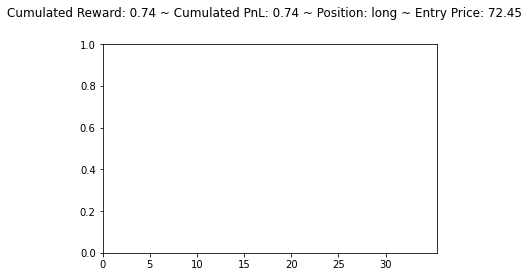

[2426.054  2671.6973 2480.567 ]
long sell flat


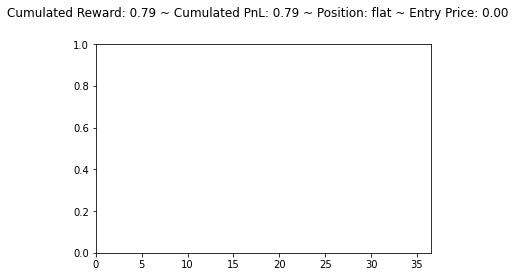

[2235.947  2071.773  2324.0398]
flat sell short


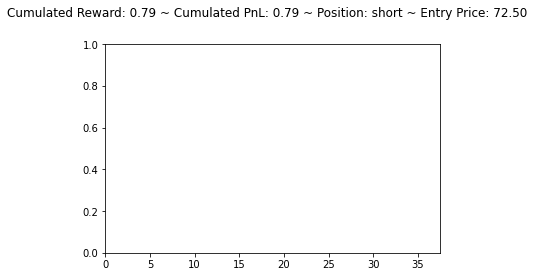

[2246.834  2058.3296 2369.342 ]
short hold short


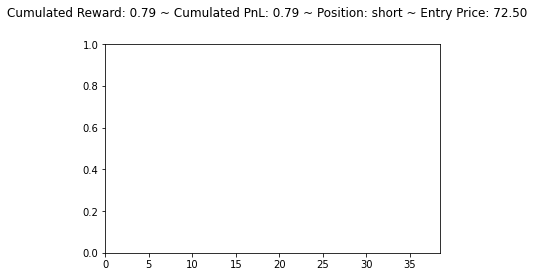

[2176.6265 1903.9736 2324.4453]
short hold short


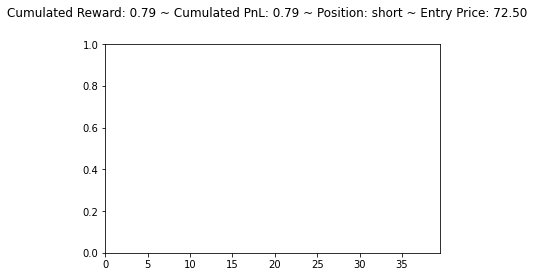

[2115.9714 1971.0691 2236.844 ]
short hold short


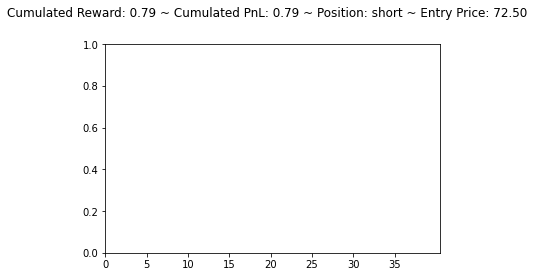

[2020.3483 2245.04   2292.5046]
short buy flat


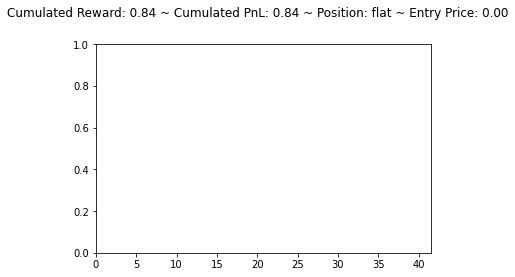

flat sell short


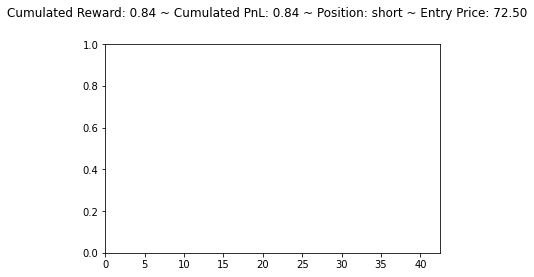

[2094.3445 1921.1162 2223.3699]
short hold short


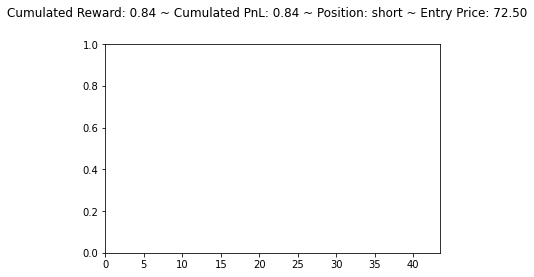

[2064.3503 1893.9296 2194.9248]
short hold short


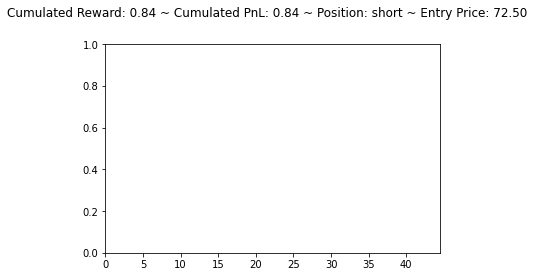

[2048.7024 1911.0442 2172.4092]
short hold short


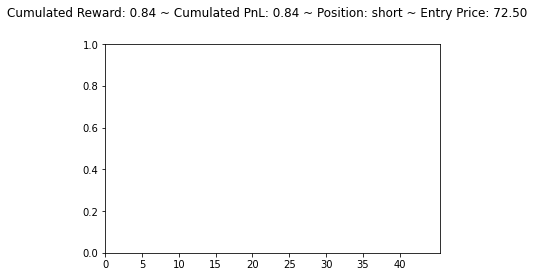

[2035.1007 1867.6329 2166.8958]
short hold short


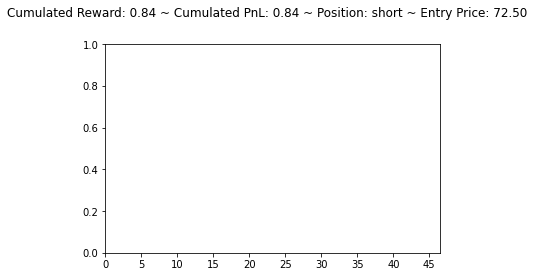

[2017.5869 1879.9125 2143.5554]
short hold short


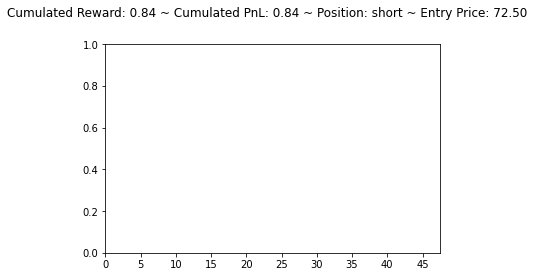

[2009.0398 1859.6517 2138.4424]
short hold short


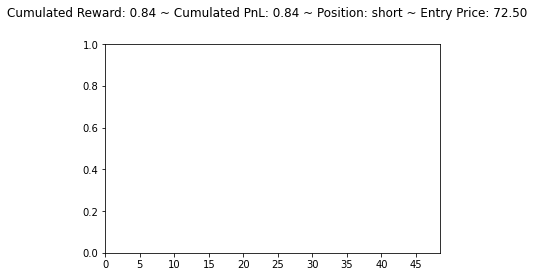

[1981.5636 1806.5935 2119.1167]
short hold short


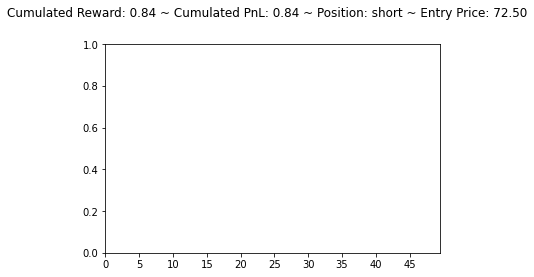

[1957.5957 1825.5355 2086.6675]
short hold short


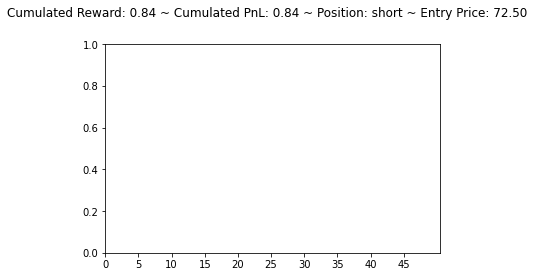

[1850.2772 2149.7146 2222.5103]
short buy flat


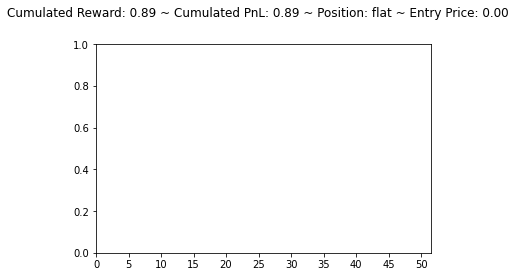

[2209.9788 2324.532  2178.3193]
flat buy long


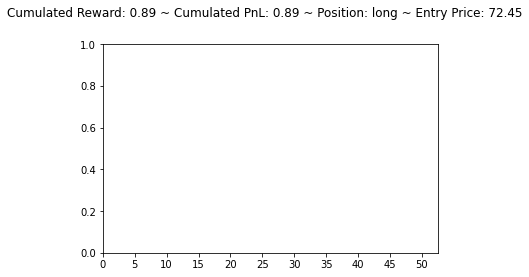

[1952.7383 1821.1382 2082.7085]
long sell flat


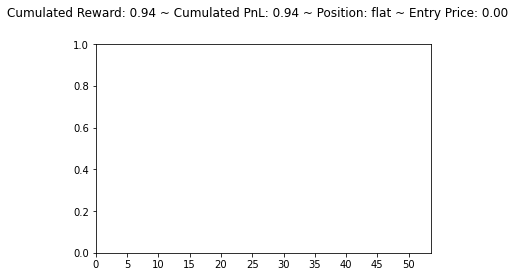

[1925.6279 1789.2571 2028.538 ]
flat sell short


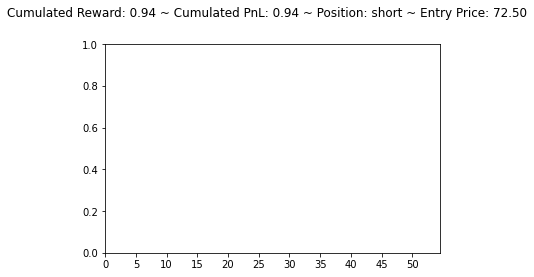

[1946.4978 1815.4773 2076.1448]
short hold short


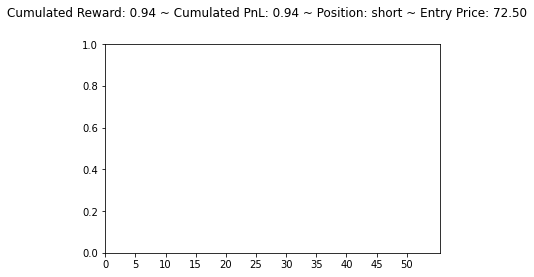

[1839.8966 2143.3486 2217.8633]
short buy flat


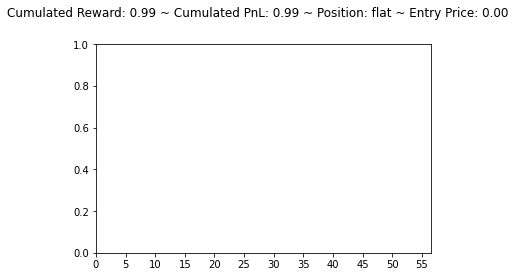

[2199.7534 2308.3494 2162.0703]
flat buy long


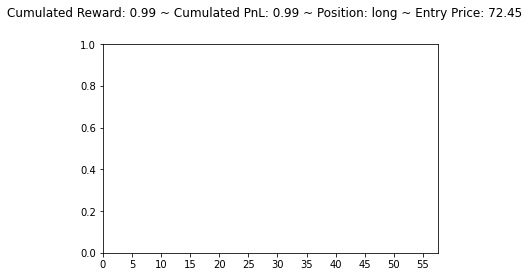

[1936.2421 1806.1842 2067.0654]
long sell flat


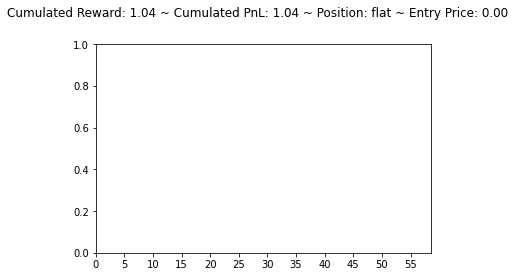

[1903.583  1756.7635 2010.6237]
flat sell short


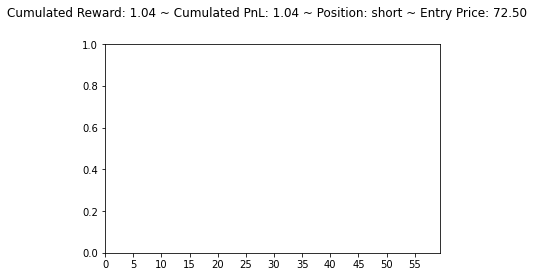

[1918.0023 1789.6489 2049.1204]
short hold short


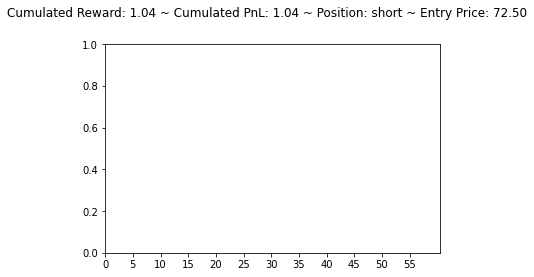

[1915.001  1786.9308 2046.2782]
short hold short


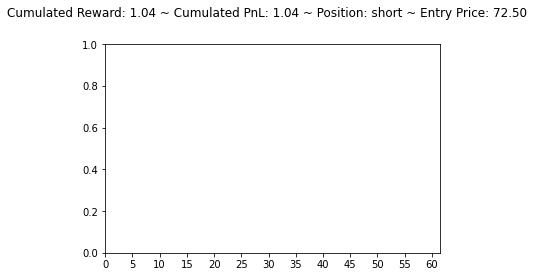

[1924.6375 1799.153  2050.0464]
short hold short


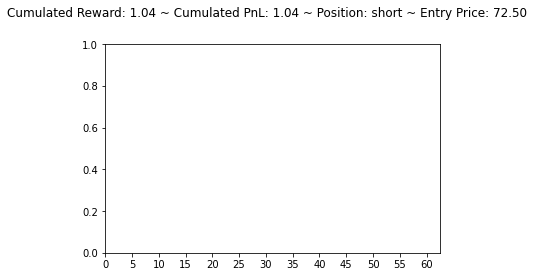

[1926.6576 1796.261  2051.9883]
short hold short


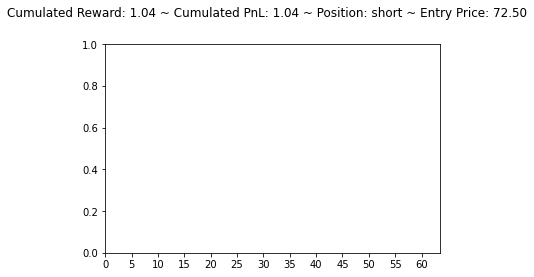

[2020.8223 2114.3508 2085.6528]
short buy flat


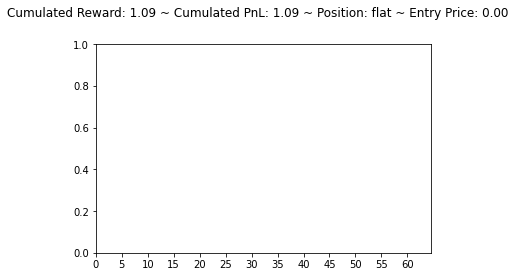

[2095.4753 1913.821  2190.9902]
flat sell short


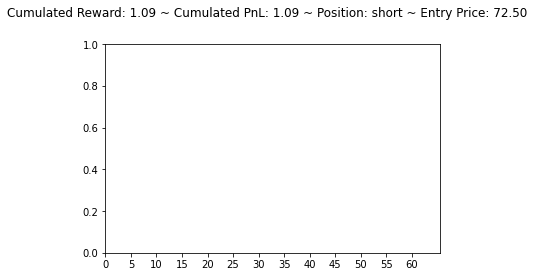

[2058.3933 1831.2054 2197.1033]
short hold short


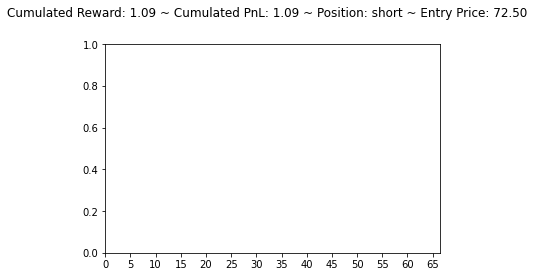

[1989.207  1815.4187 2120.2756]
short hold short


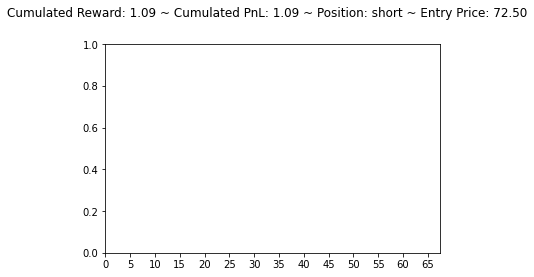

[1937.28   1752.7115 2074.7737]
short hold short


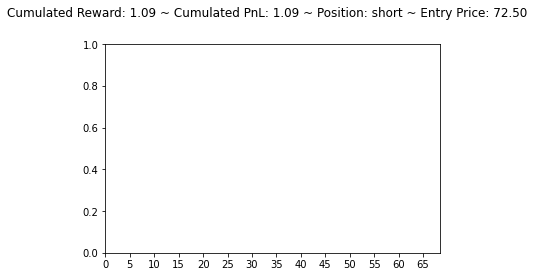

[1892.5424 1746.5688 2024.1239]
short hold short


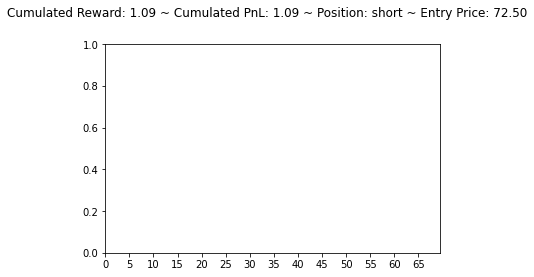

[1876.6395 1757.1818 2003.0643]
short hold short


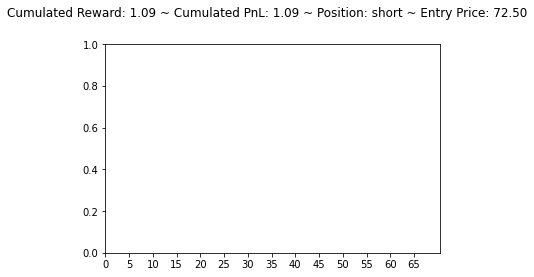

[1873.6398 1754.4617 2000.2179]
short hold short


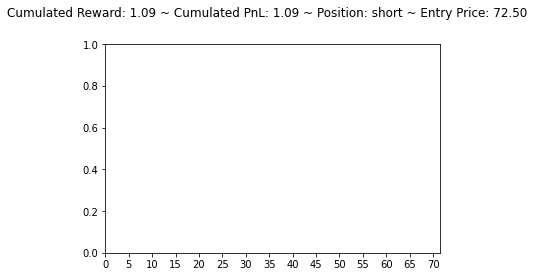

[1870.6416 1751.7429 1997.3744]
short hold short


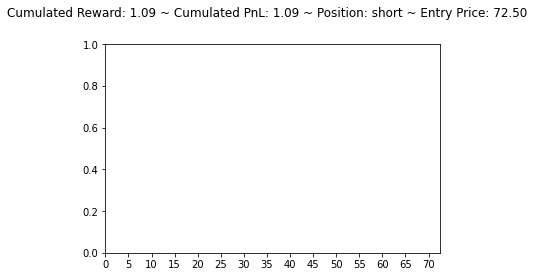

[1860.7095 1727.1001 1991.6915]
short hold short


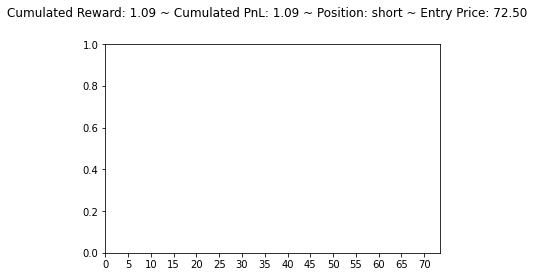

[1823.2997 1649.3984 1966.6862]
short hold short


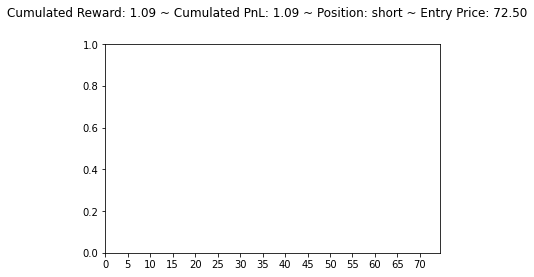

[1735.5774 1507.323  1898.4547]
short hold short


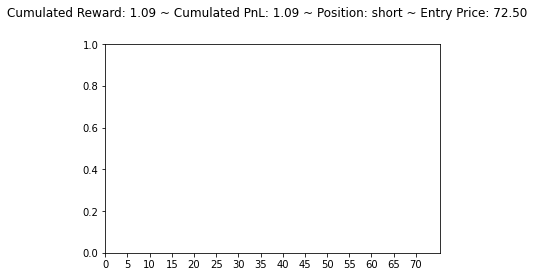

[1615.5981 1398.574  1784.6771]
short hold short


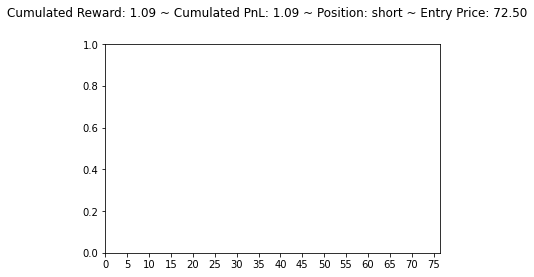

[1545.5364 1447.6841 1691.3195]
short hold short


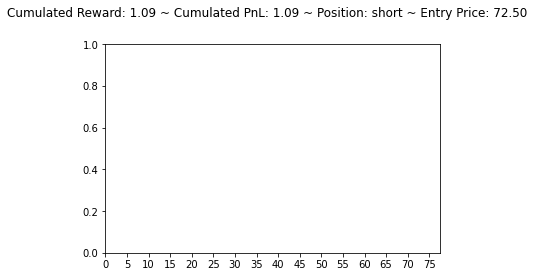

[1504.4185 1344.7231 1668.0311]
short hold short


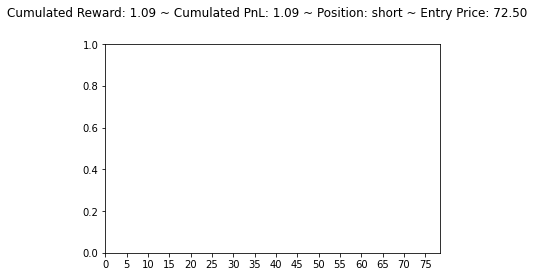

[1458.55  1368.839 1608.829]
short hold short


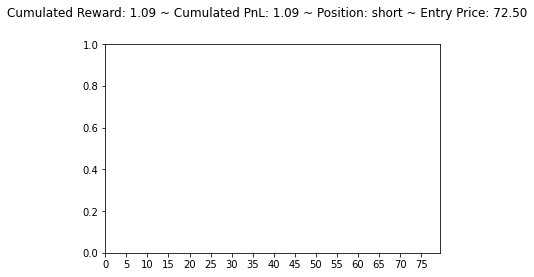

[1445.1667 1353.5791 1596.8864]
short hold short


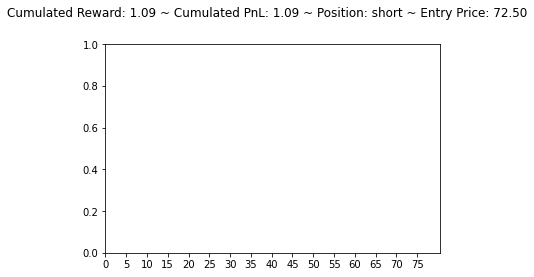

[1431.5538 1344.3708 1583.2313]
short hold short


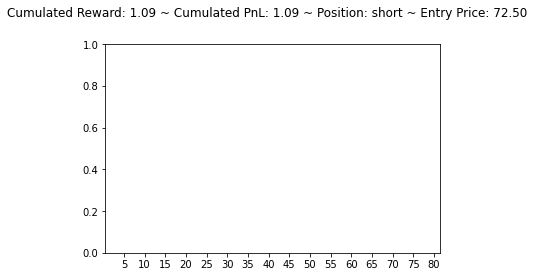

[1423.7167 1346.654  1573.5548]
short hold short


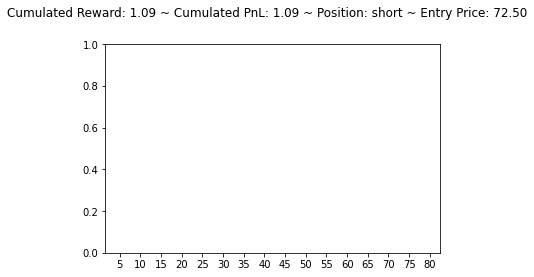

[1401.3054 1282.5459 1562.7719]
short hold short


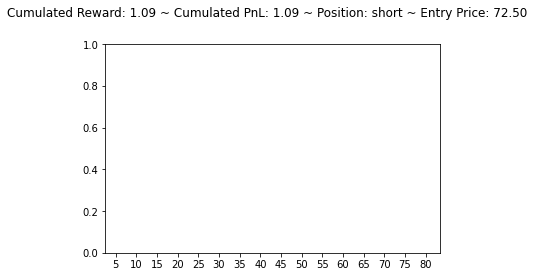

[1363.2465 1263.6881 1522.939 ]
short hold short


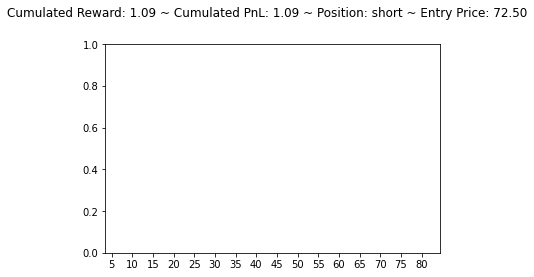

[1347.2765 1280.501  1500.2537]
short hold short


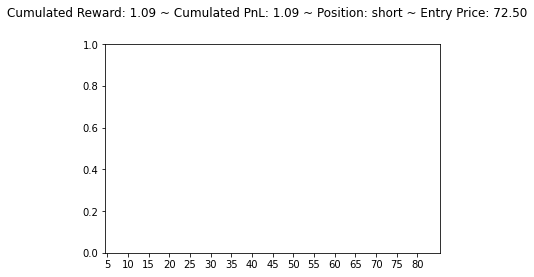

[1286.3561 1087.7076 1475.3505]
short hold short


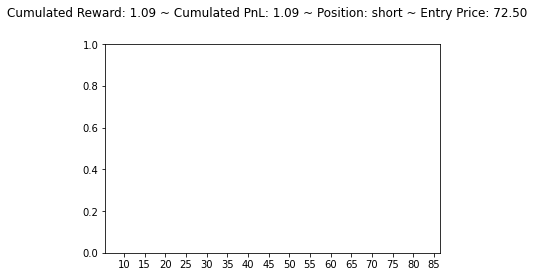

[1157.1503  976.8527 1351.3309]
short hold short


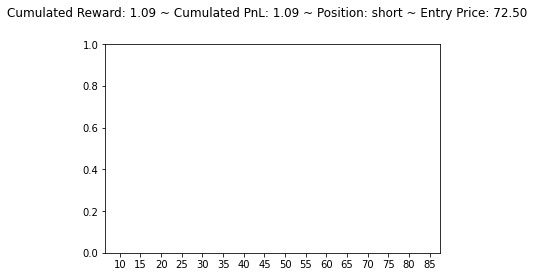

[1075.5431  1002.98615 1250.0146 ]
short hold short


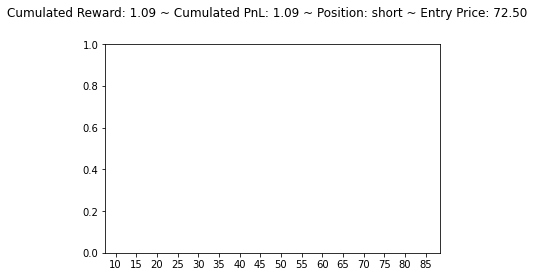

[1033.1228  873.5032 1188.9755]
short hold short


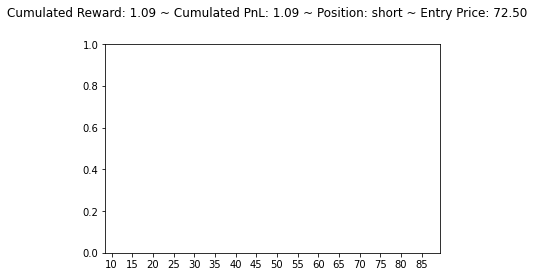

[ 950.3533   884.58057 1082.2139 ]
short hold short


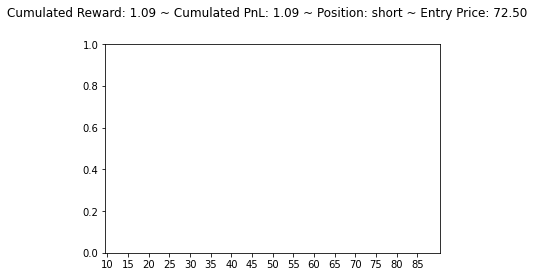

[ 948.6204   962.75867 1110.8181 ]
short buy flat


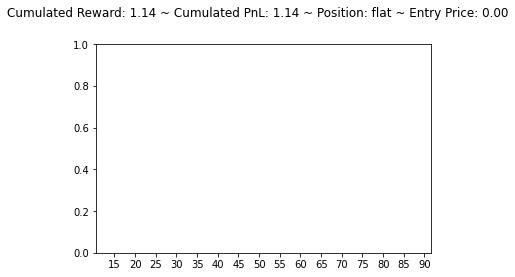

[ 879.36755  998.4938  1035.6443 ]
flat sell short


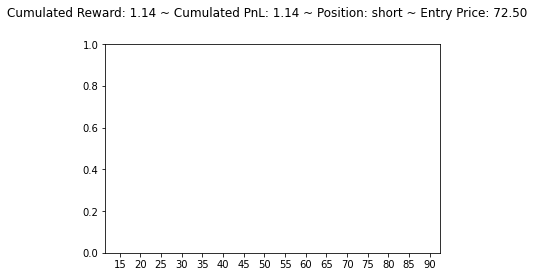

[ 861.7624 1107.9429 1073.1018]
short buy flat


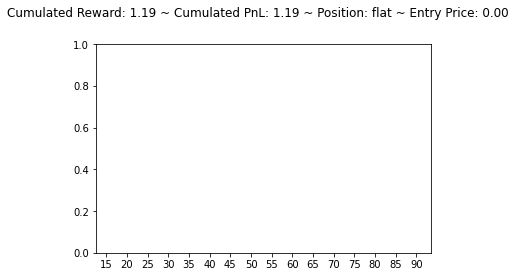

[ 845.93066 1171.2378  1030.3202 ]
flat buy long


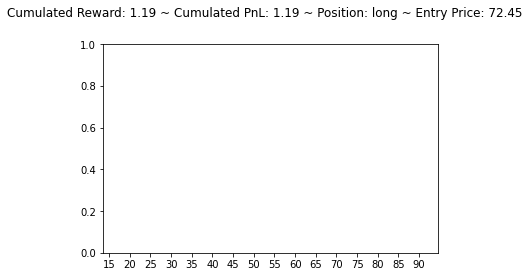

[ 953.36365 1154.7129  1062.4509 ]
long sell flat


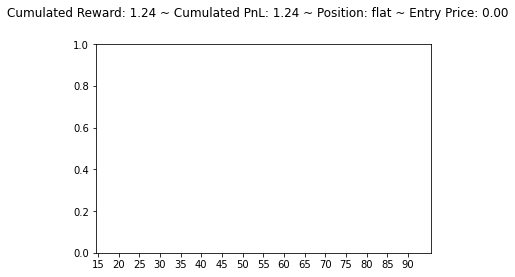

[ 924.64746 1152.0919   997.2065 ]
flat buy long


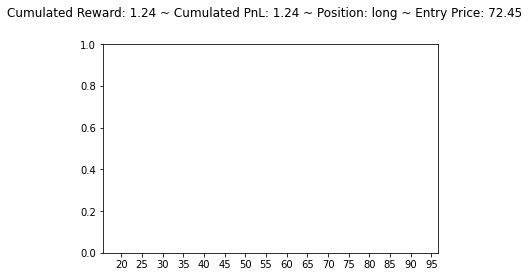

[ 979.0355 1194.3091 1056.3711]
long sell flat


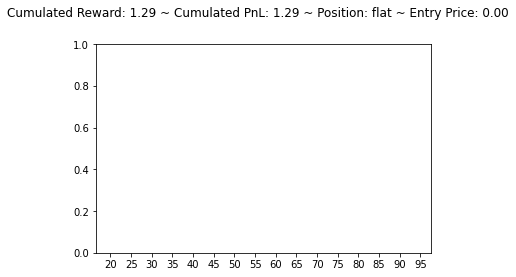

[398.67926 916.0118  824.03424]
flat buy long


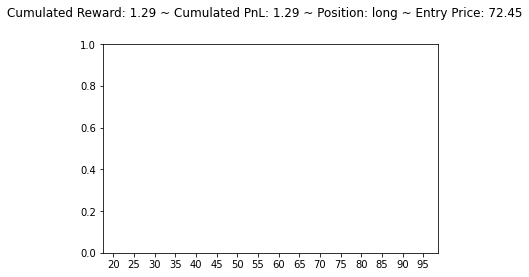

[ 828.17017 1152.9167  1095.0134 ]
long sell flat


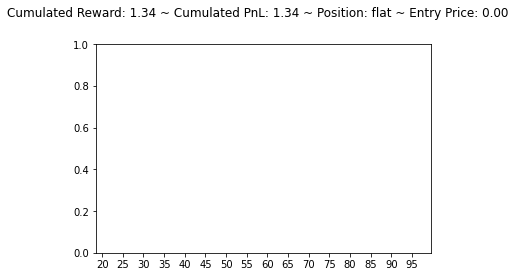

[ 951.6887 1211.6742  992.6419]
flat buy long


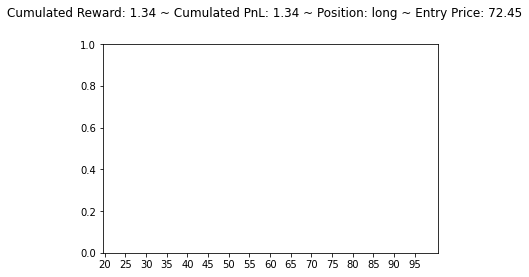

[1016.0916 1267.9719 1049.2926]
long sell flat


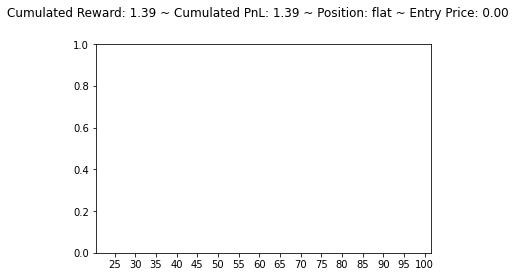

[ 899.2942 1053.0715  849.7752]
flat buy long


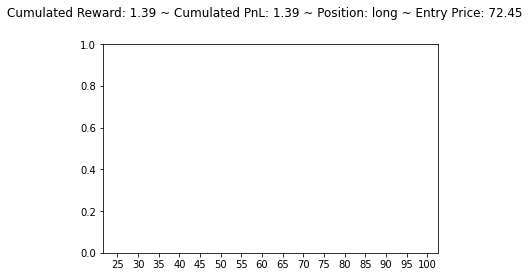

[907.12134 980.1287  841.24603]
long hold long


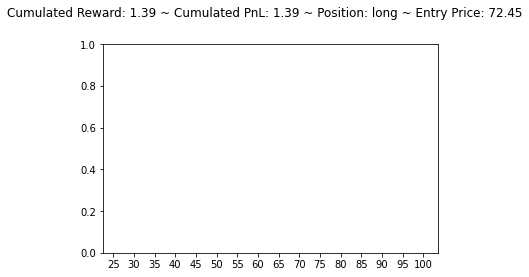

[911.1256  949.0383  826.29156]
long hold long


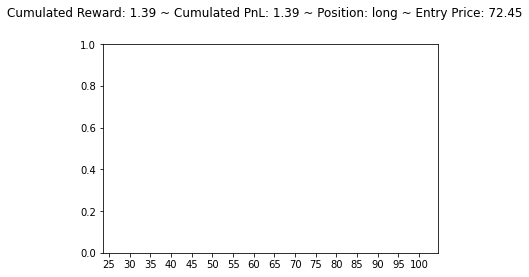

[879.9452 944.6159 832.3066]
long hold long


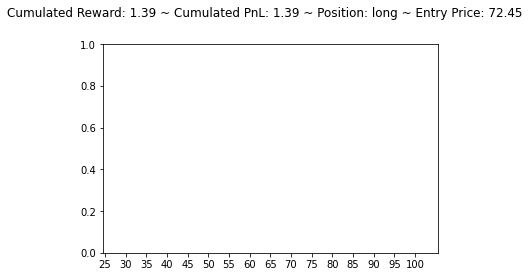

[761.77155 972.3613  830.4903 ]
long sell flat


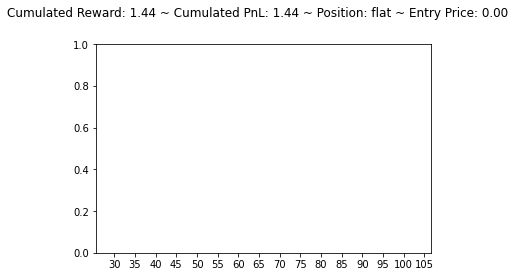

[492.03653 889.7765  857.62305]
flat buy long


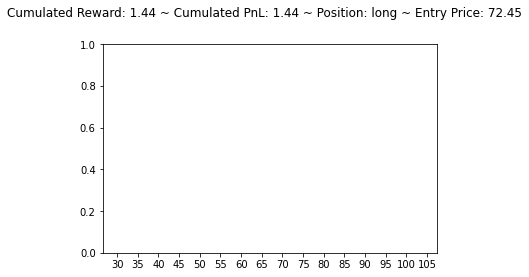

[486.6139 900.9822 843.8172]
long sell flat


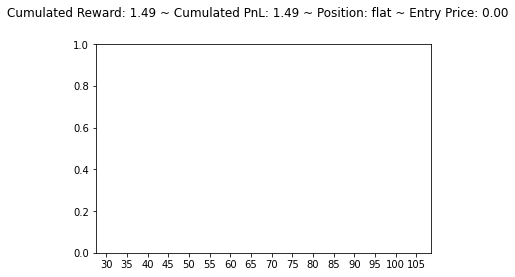

[ 935.78253 1044.2107   966.44354]
flat buy long


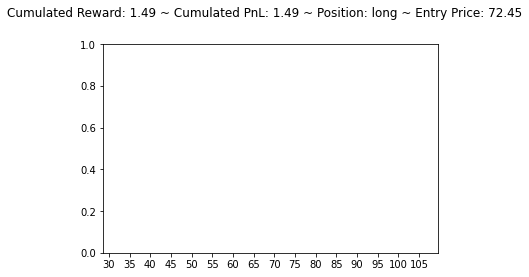

[ 978.7398 1191.5807 1019.52  ]
long sell flat


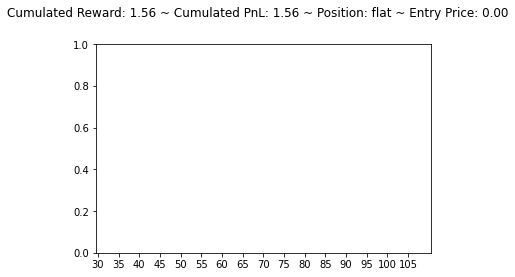

[671.25    689.94257 700.93555]
flat sell short


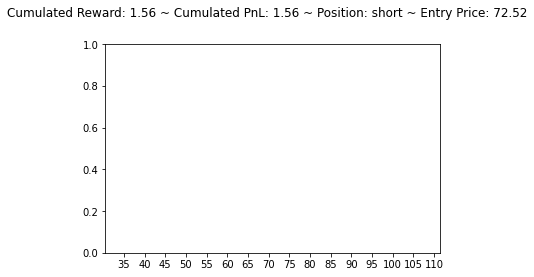

[796.9315  763.83765 605.0259 ]
short hold short


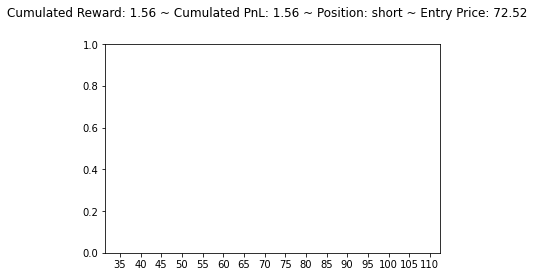

[521.46985 772.1362  633.2744 ]
short buy flat


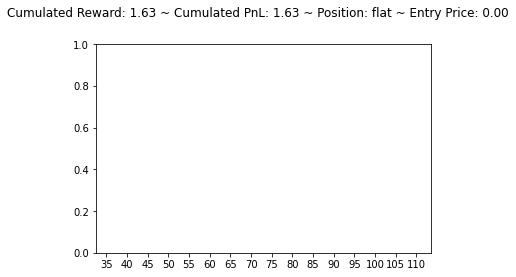

[402.1317  479.0328  496.72247]
flat sell short


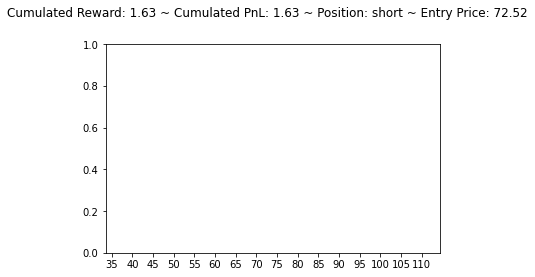

[442.41193 527.58496 543.7373 ]
short buy flat


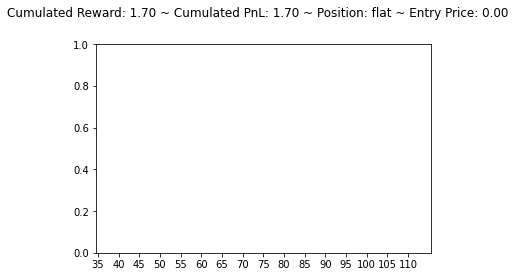

[439.40976 524.59314 501.67224]
flat buy long


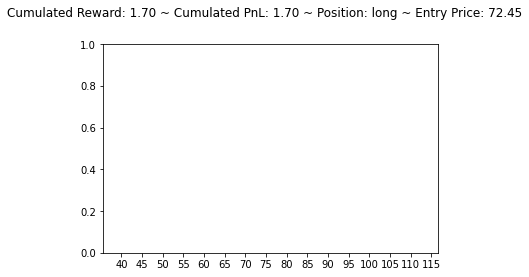

[422.2014  429.28787 559.0053 ]
long sell flat


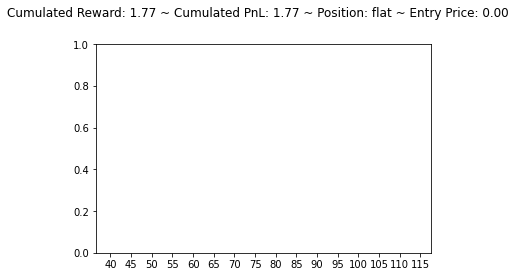

[370.8213  476.6444  405.87665]
flat buy long


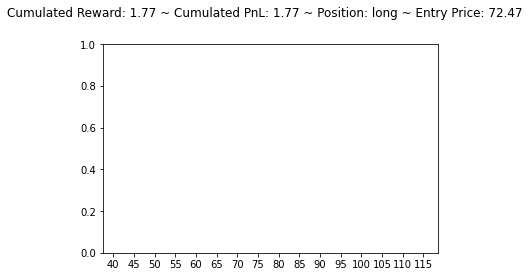

[405.75452 525.35364 479.23883]
long sell flat


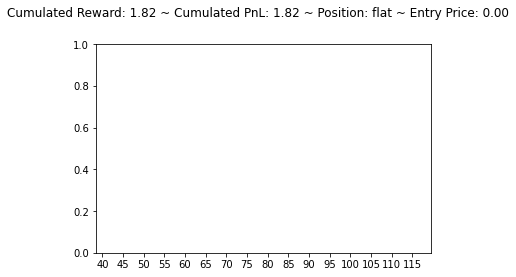

[384.38263 496.3127  417.1303 ]
flat buy long


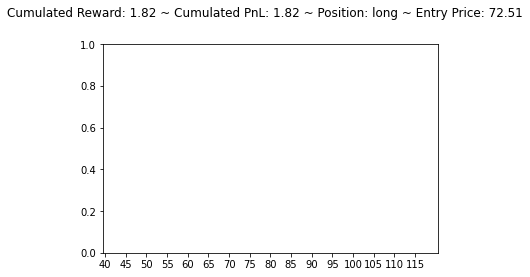

[398.622   519.30536 475.48178]
long sell flat


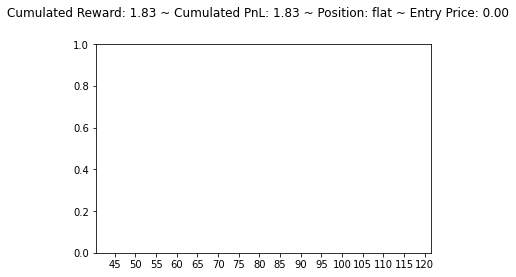

[362.9047  470.28693 417.20605]
flat buy long


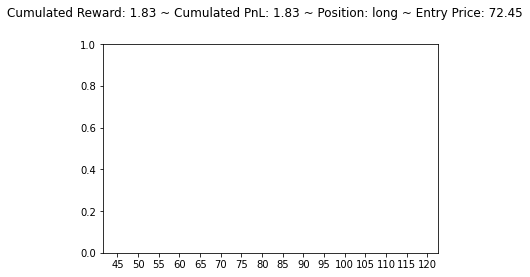

[400.9531  518.1092  452.30438]
long sell flat


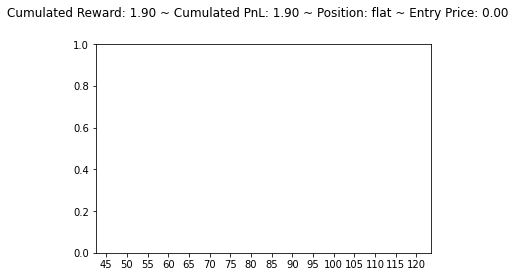

[383.1424  498.68457 428.78683]
flat buy long


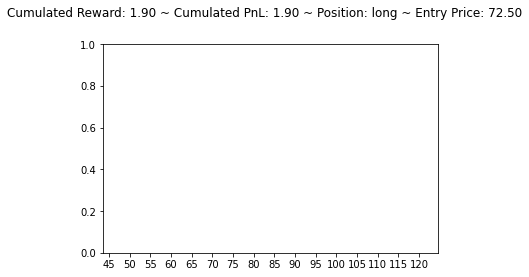

[377.3697  446.15494 466.3969 ]
long sell flat


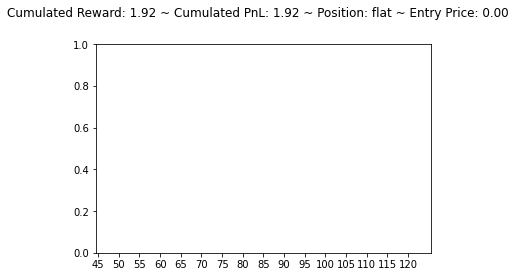

[337.84967 452.15195 382.09213]
flat buy long


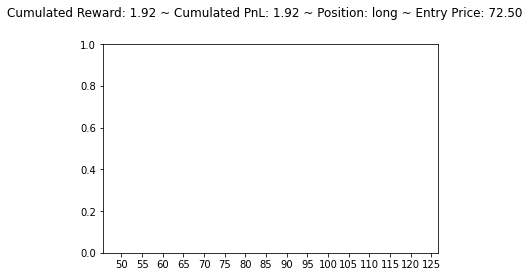

[358.35425 481.4831  434.75726]
long sell flat


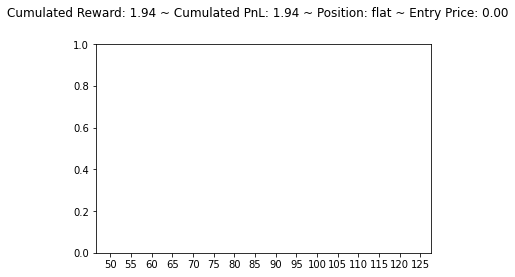

[335.7021  454.11282 362.8177 ]
flat buy long


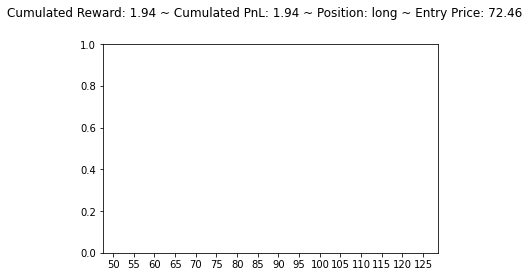

[418.57758 491.3945  443.91452]
long sell flat


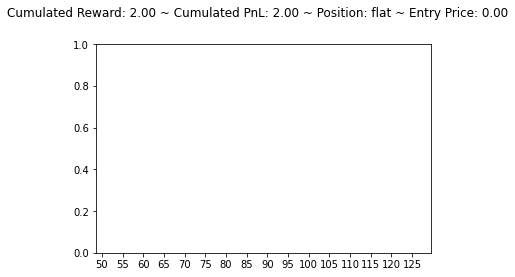

[329.10205 449.00388 380.73923]
flat buy long


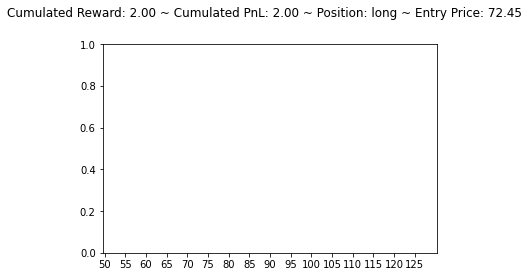

[337.10522 445.15915 423.28894]
long sell flat


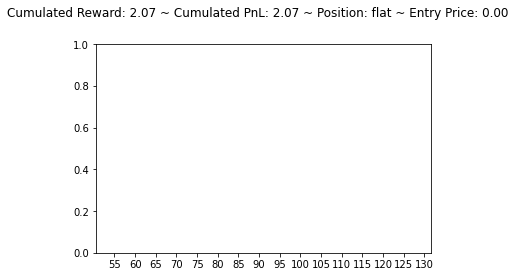

[320.8485  438.84042 345.3061 ]
flat buy long


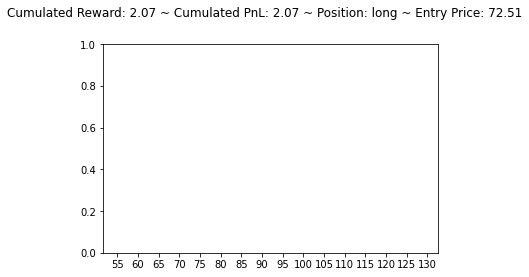

[414.0945  482.897   430.50574]
long sell flat


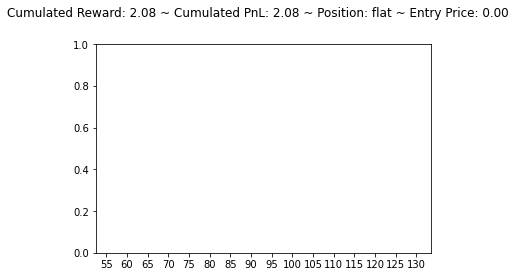

[325.48492 446.92822 390.0097 ]
flat buy long


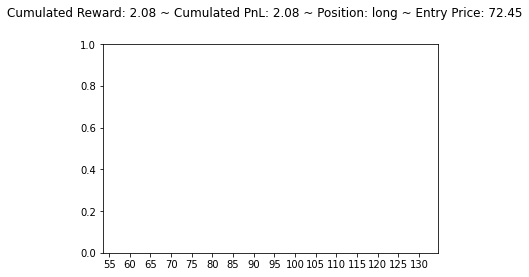

[449.42334 450.58145 328.38184]
long hold long


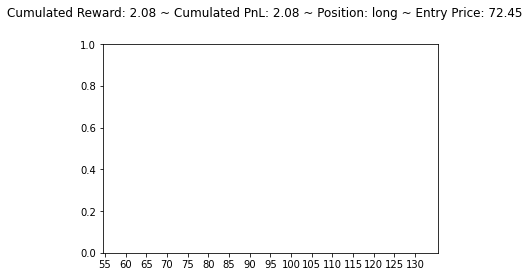

[334.49503 458.4819  387.2618 ]
long sell flat


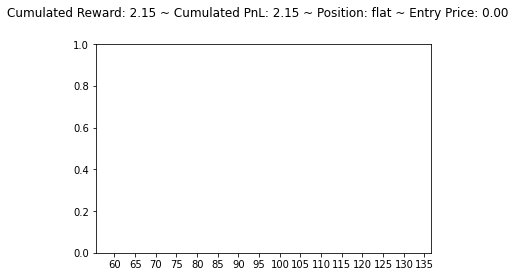

[295.68042 418.2128  355.38165]
flat buy long


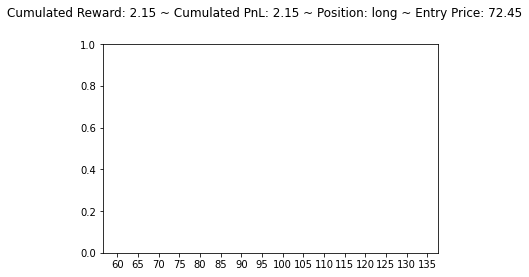

[322.4975  443.89166 367.72873]
long sell flat


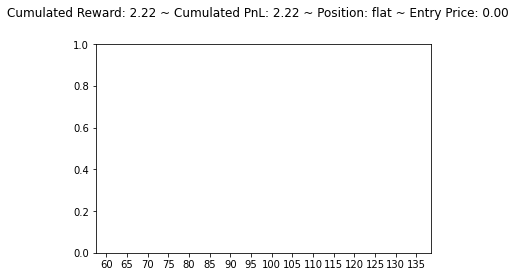

[369.4165  448.09402 371.07474]
flat buy long


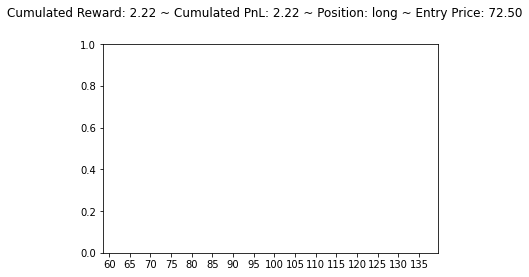

[403.94574 474.88022 421.8293 ]
long sell flat


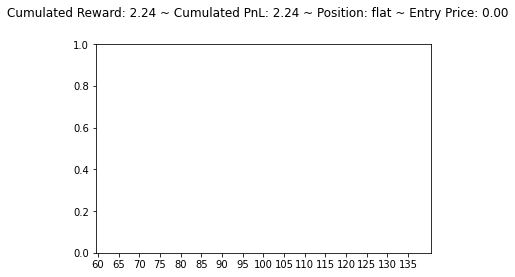

[366.9275  447.9511  371.21008]
flat buy long


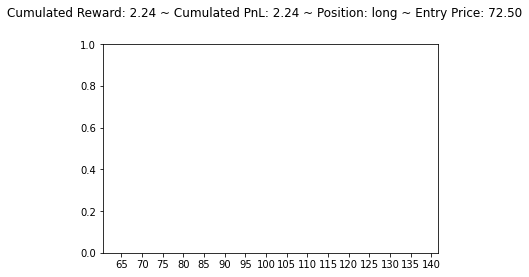

[401.4566  474.73703 421.96448]
long sell flat


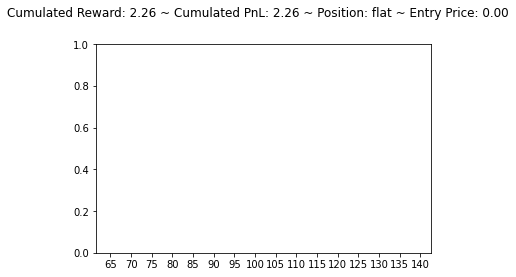

[346.252   440.20923 359.78357]
flat buy long


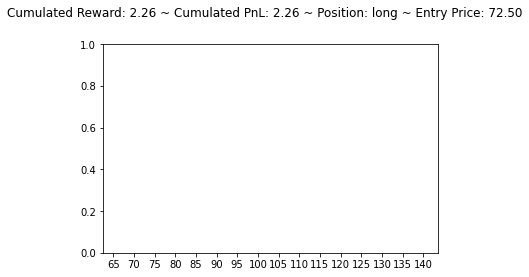

[322.32907 428.4703  366.72137]
long sell flat


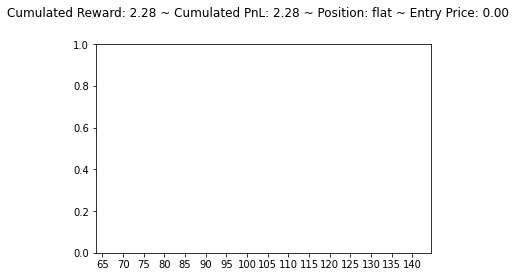

[281.99756 406.8701  333.27927]
flat buy long


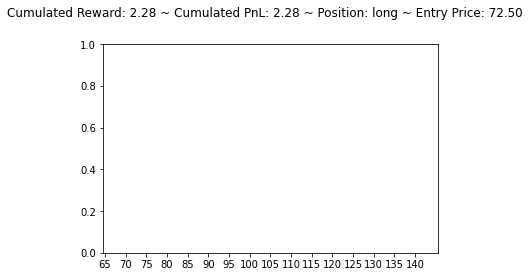

[295.9083  417.0055  378.86807]
long sell flat


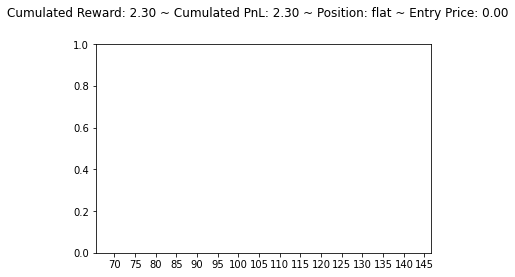

[259.07516 354.40884 320.69052]
flat buy long


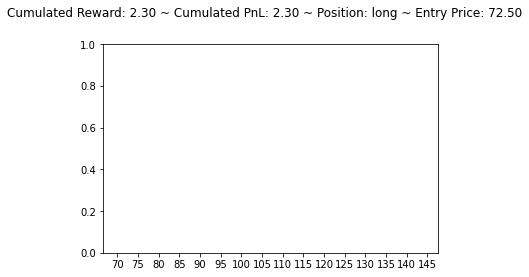

[263.3679  390.3892  350.08966]
long sell flat


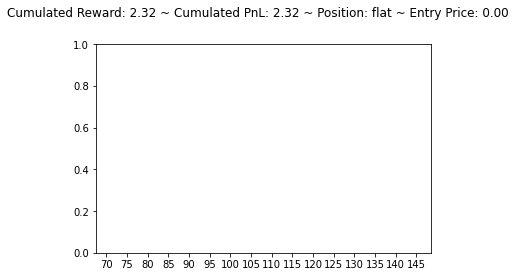

[229.16019 391.13565 365.68066]
flat buy long


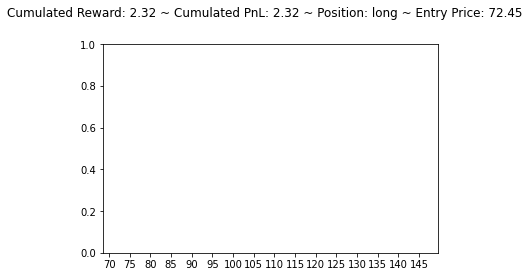

[266.7646  390.6142  385.99127]
long sell flat


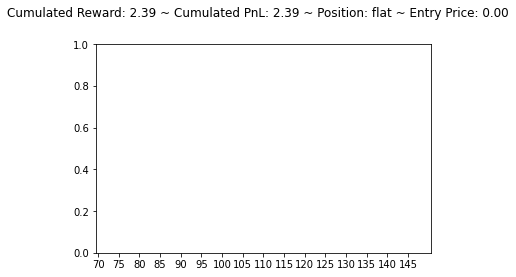

[215.30267 407.78897 361.0371 ]
flat buy long


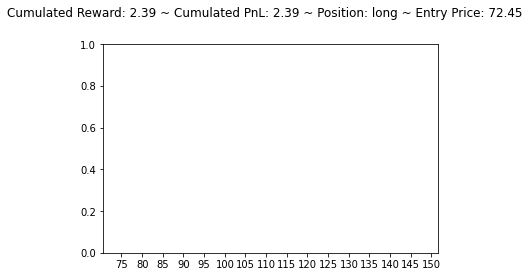

[136.11734 353.51053 340.45648]
long sell flat


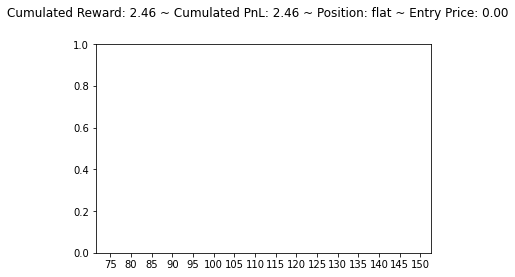

[121.05885 288.17908 206.38573]
flat buy long


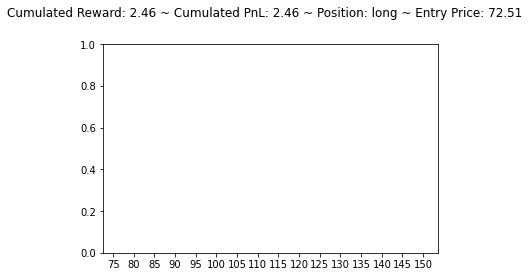

[202.77428 347.45157 221.58571]
long sell flat


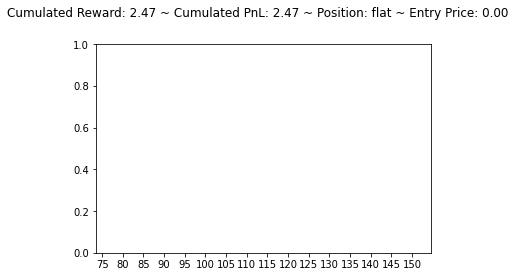

[170.53523 340.42807 246.17259]
flat buy long


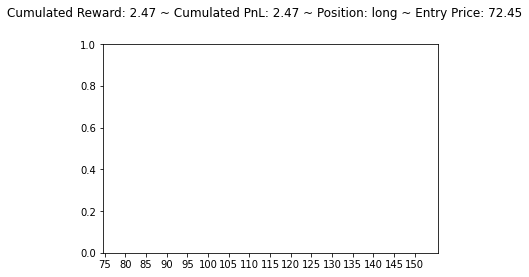

[320.55133 520.561   327.7671 ]
long sell flat


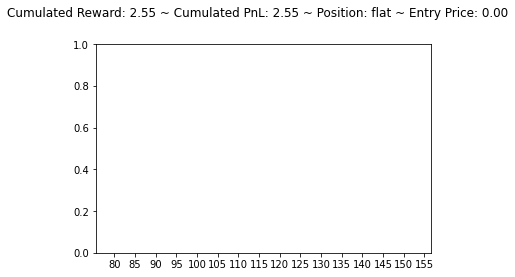

[278.64874 387.9151  343.86584]
flat buy long


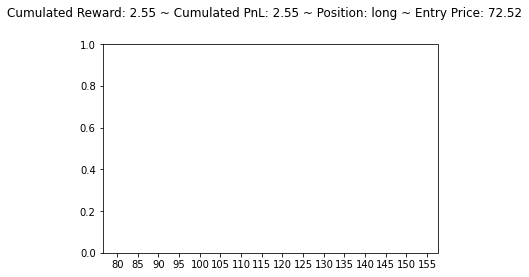

[321.9409  437.32016 405.702  ]
long sell flat


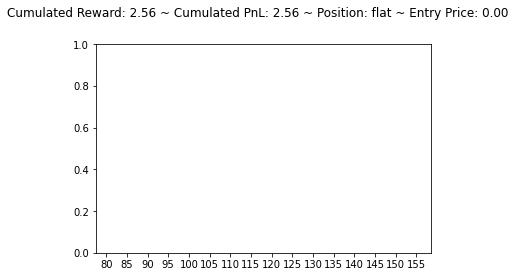

[368.35504 496.8923  397.09125]
flat buy long


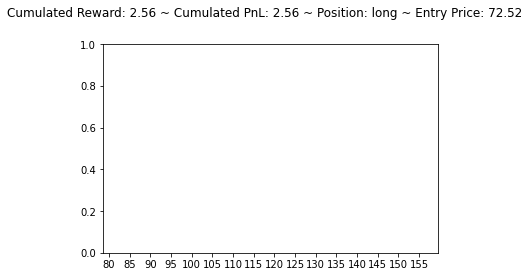

[362.91217 497.39258 320.531  ]
long hold long


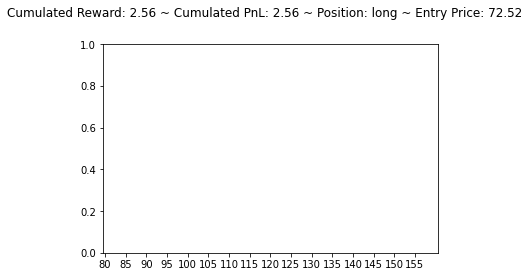

[150.12445 312.6673  215.31891]
long sell flat


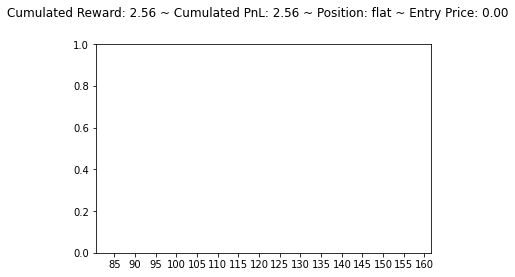

[130.843   266.43988 170.74283]
flat buy long


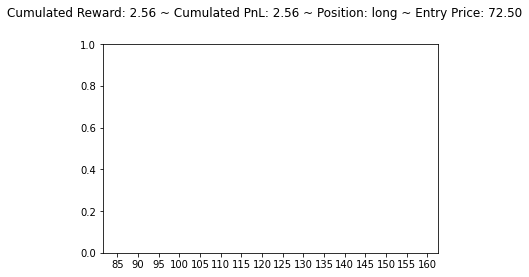

[ 86.92154 290.3874  258.75046]
long sell flat


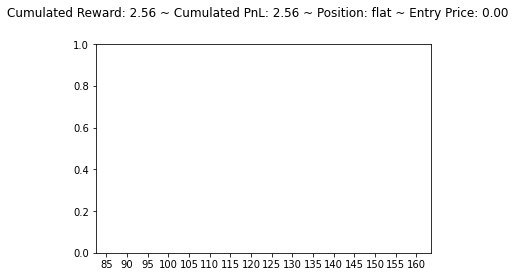

[524.8399 462.417  438.5327]
flat hold flat


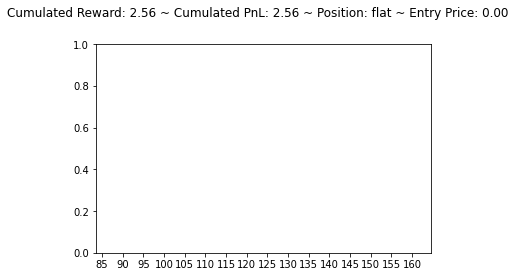

[624.8393 673.2058 668.7025]
flat buy long


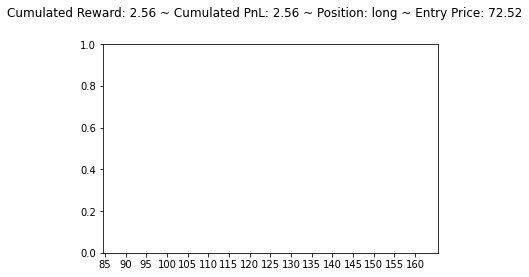

[599.8827  687.6429  651.90155]
long sell flat


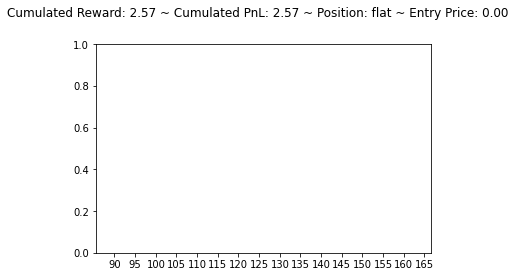

[589.7789  662.93964 606.3405 ]
flat buy long


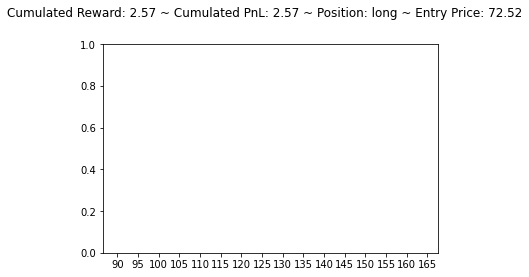

[900.1106  860.90753 938.01624]
long sell flat


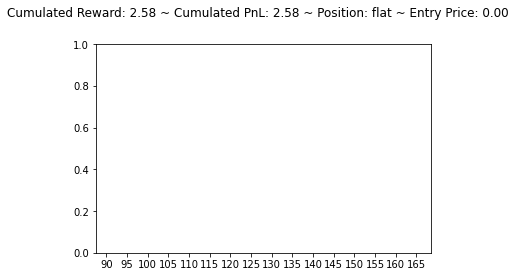

[927.19055 884.6382  831.0133 ]
flat hold flat


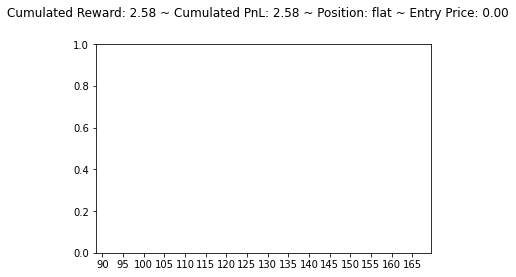

[973.50494 929.33167 878.078  ]
flat hold flat


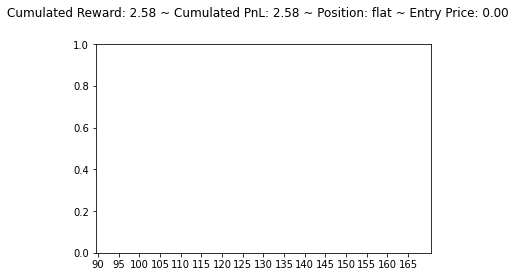

[1376.1659 1353.5895  998.3424]
flat hold flat


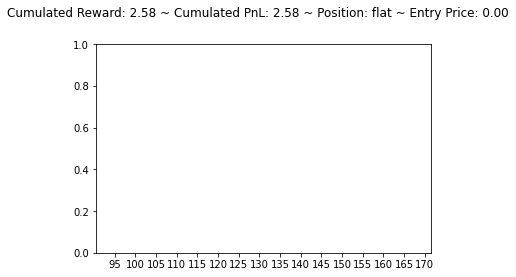

[ 758.8433 1305.4739 1125.41  ]
flat buy long


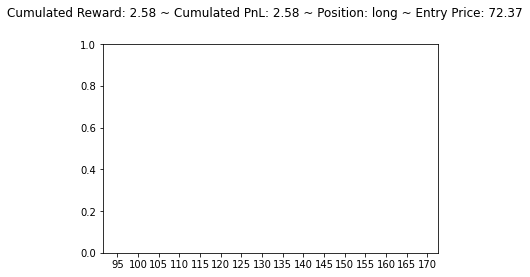

[ 846.89026 1486.764   1214.0059 ]
long sell flat


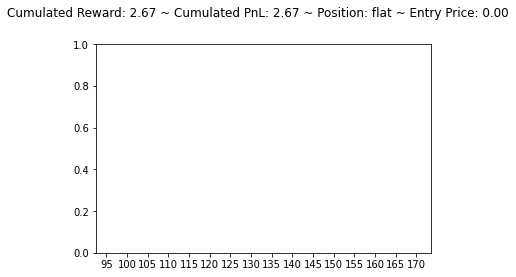

[376.17844 423.74042 349.16064]
flat buy long


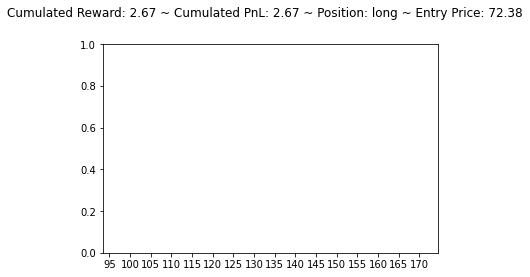

[218.12453 363.581   319.0393 ]
long sell flat


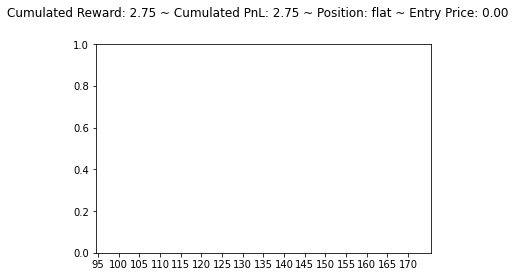

[202.37805 360.5388  319.5621 ]
flat buy long


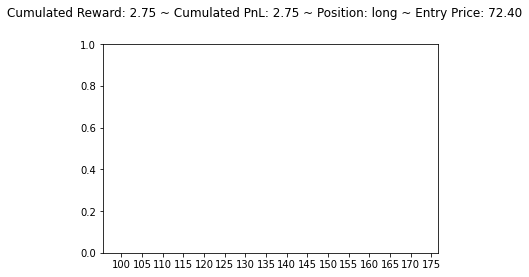

[182.25401 365.78064 312.4759 ]
long sell flat


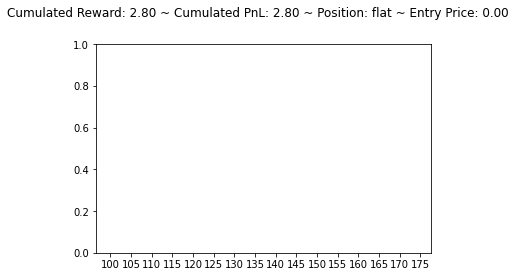

[195.4418  369.84445 270.2572 ]
flat buy long


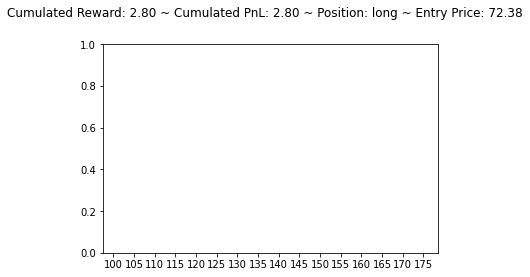

[187.30467 387.10394 352.101  ]
long sell flat


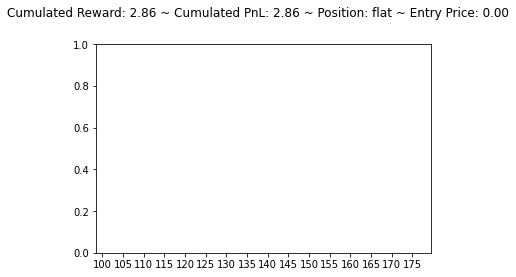

[136.53458 315.22833 229.86536]
flat buy long


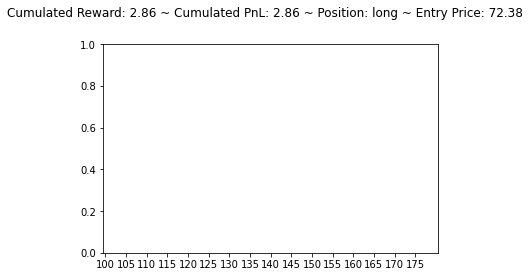

[ 98.97822 292.90732 268.31735]
long sell flat


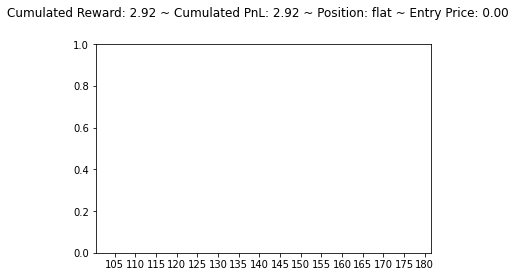

[ 98.743416 284.28873  239.97845 ]
flat buy long


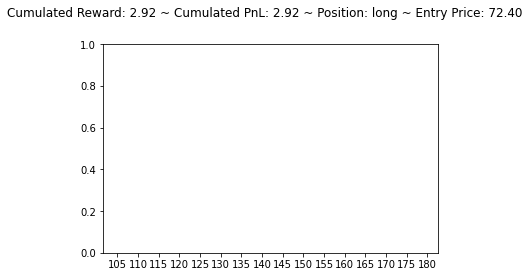

[361.9621  387.6163  255.14948]
long hold long


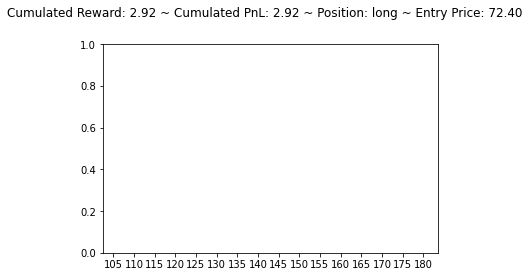

[254.38107 376.4915  339.83087]
long sell flat


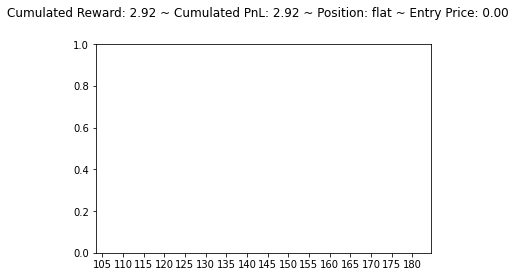

[1310.7603  1236.3918   902.59863]
flat hold flat


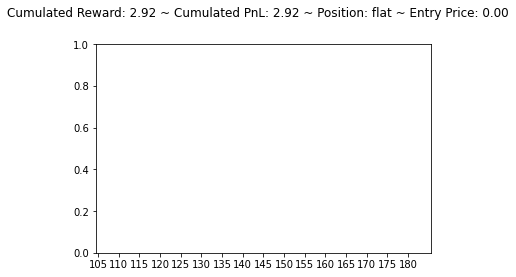

[1080.0687 1662.3219 1348.2327]
flat buy long


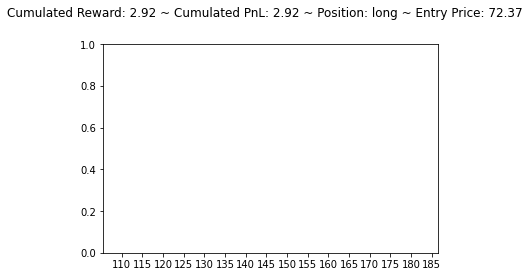

[1042.2878 1642.1969 1463.5793]
long sell flat


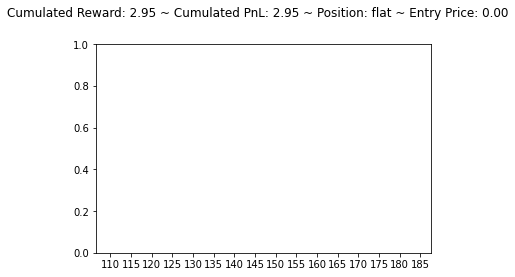

[ 835.57886 1024.1349  1068.88   ]
flat sell short


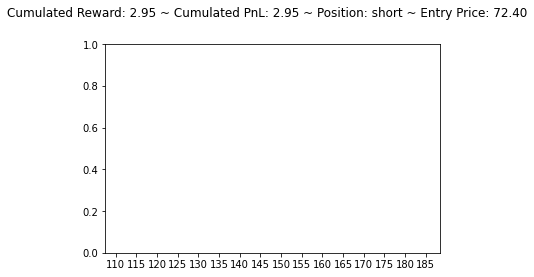

[ 873.1358 1177.525   967.3078]
short buy flat


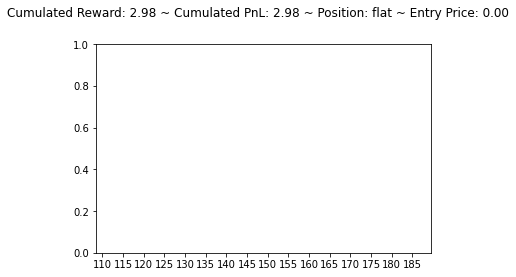

[ 790.6442 1274.3965 1051.1676]
flat buy long


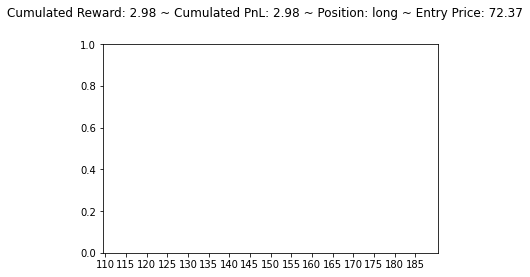

[ 916.08795 1407.0808  1220.4117 ]
long sell flat


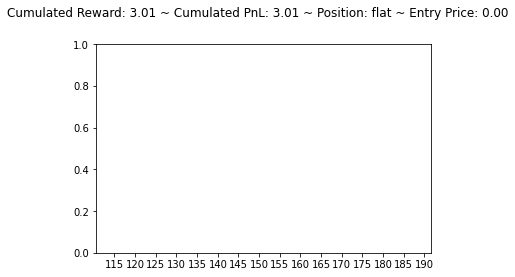

[357.3052  328.23853 393.60068]
flat sell short


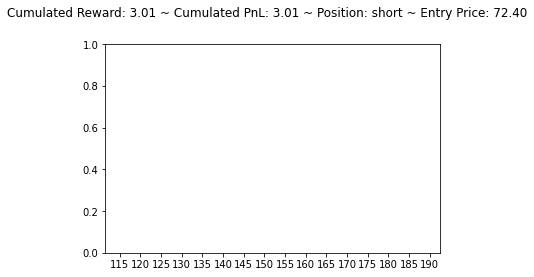

[349.37085 505.18564 424.87497]
short buy flat


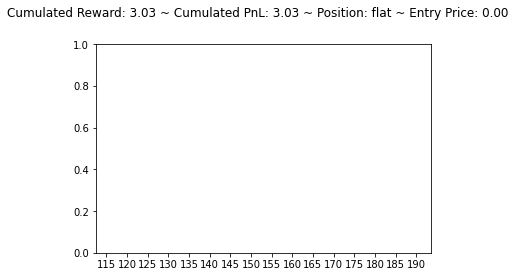

[290.08313 364.2655  391.1729 ]
flat sell short


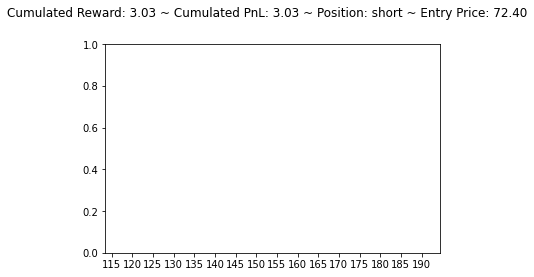

[277.81857 428.38004 432.9504 ]
short buy flat


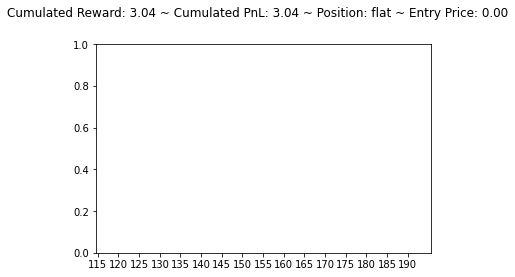

[232.92041 380.96564 338.00174]
flat buy long


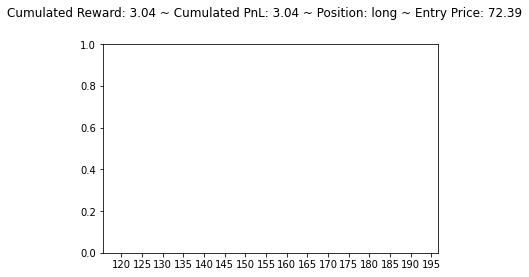

[290.7587  528.97644 402.39172]
long sell flat


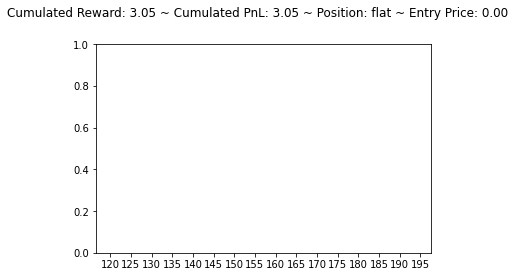

[315.8871  435.96664 368.9295 ]
flat buy long


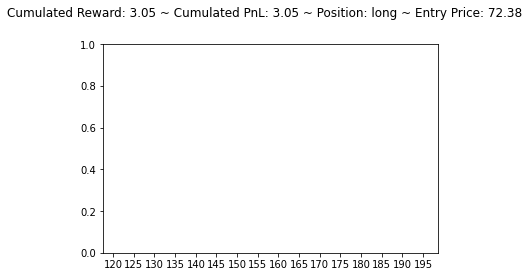

[349.61066 490.92917 434.7377 ]
long sell flat


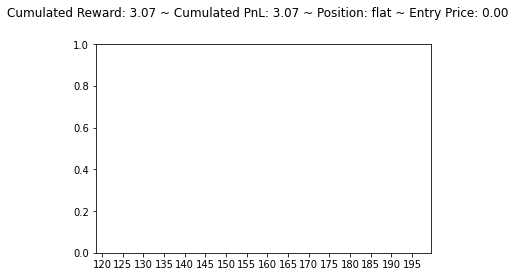

[314.38934 432.77002 374.4654 ]
flat buy long


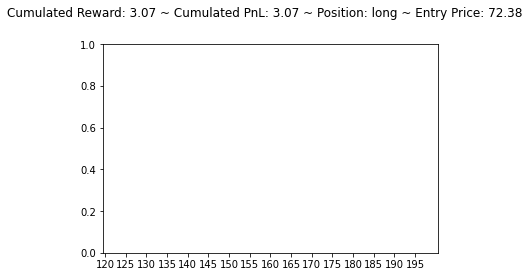

[316.068   472.60443 414.66876]
long sell flat


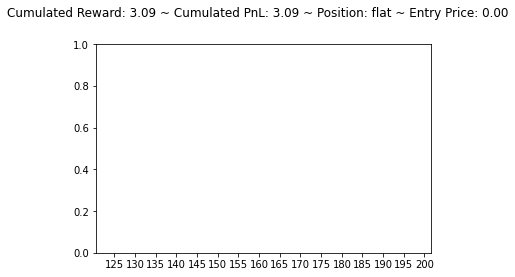

[266.86484 409.36502 350.2953 ]
flat buy long


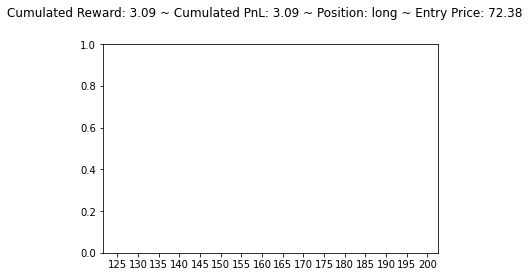

[312.5658 591.1725 503.6951]
long sell flat


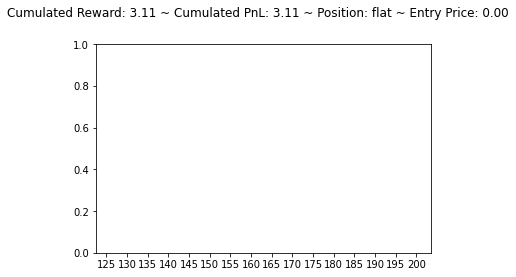

[341.34033 541.8093  508.09525]
flat buy long


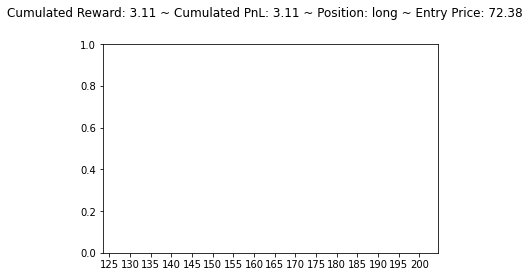

[361.28558 592.7264  569.391  ]
long sell flat


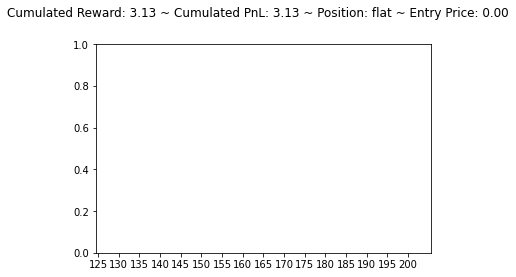

[262.20367 391.90338 403.21826]
flat sell short


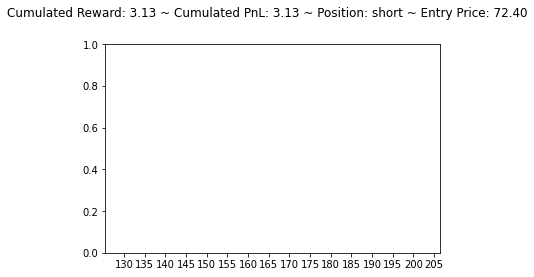

[241.99695 473.49005 449.79785]
short buy flat


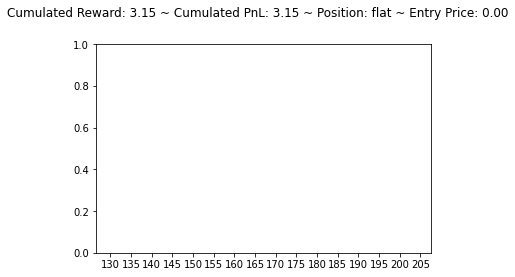

[209.12816 425.2953  404.15607]
flat buy long


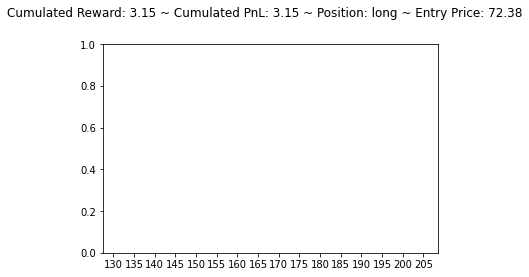

[581.8585 699.0903 526.8249]
long hold long


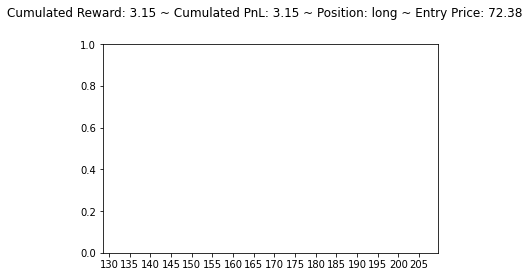

[412.9727 567.2427 537.9412]
long sell flat


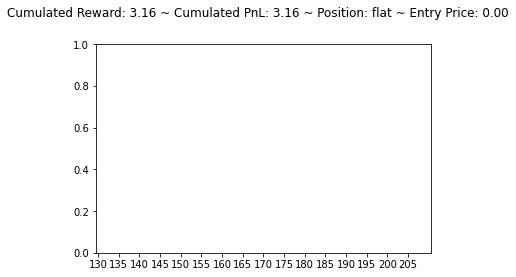

[210.22594 420.39792 397.98627]
flat buy long


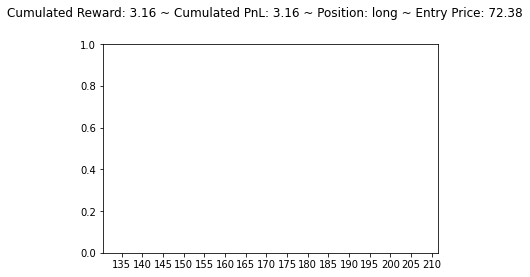

[209.97025 437.64072 445.68542]
long sell flat


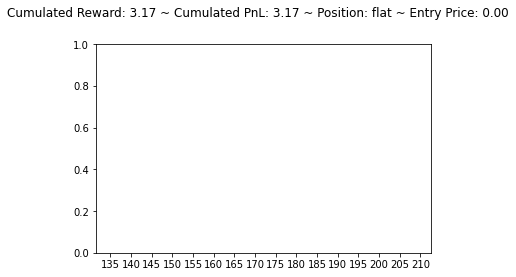

[303.8512  500.10104 412.29993]
flat buy long


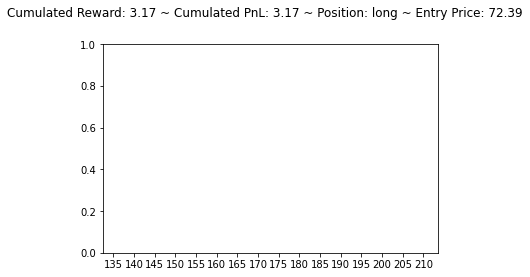

[855.00665 912.1379  930.02826]
long sell flat


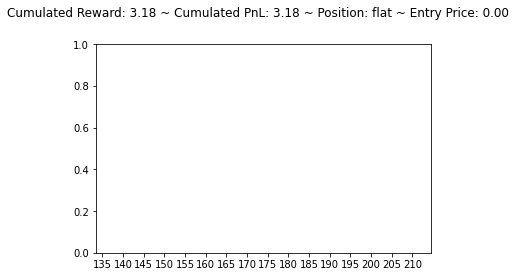

[ 612.5089  1153.1166  1005.60236]
flat buy long


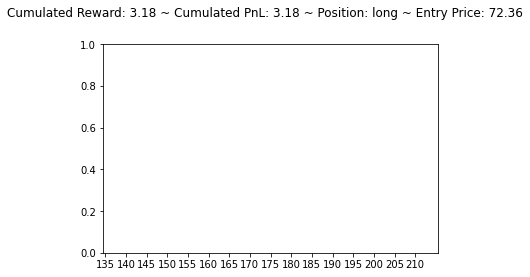

[343.48904 606.08887 642.89044]
long sell flat


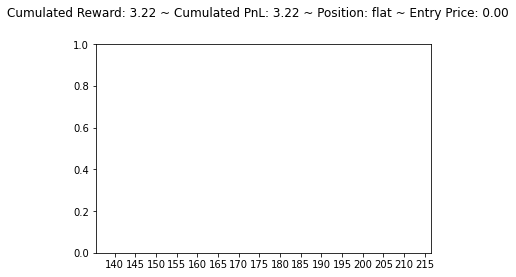

[321.6151 542.3395 525.5976]
flat buy long


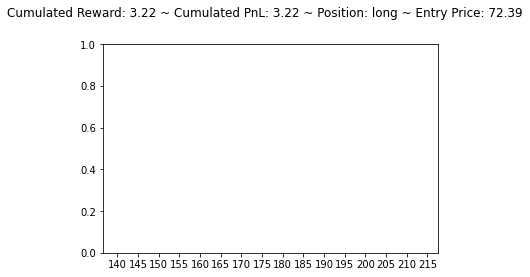

[352.98068 596.30457 588.3993 ]
long sell flat


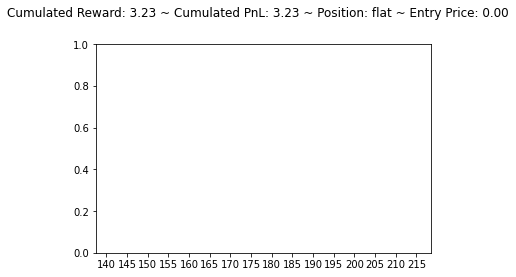

[754.07367 440.3866  676.92584]
flat hold flat


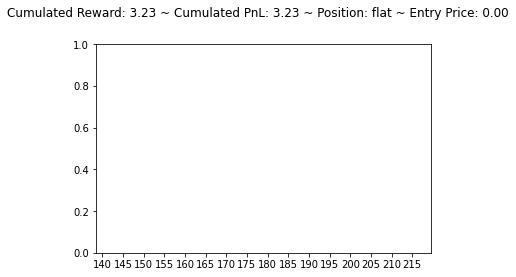

[592.9141  827.68024 869.5341 ]
flat sell short


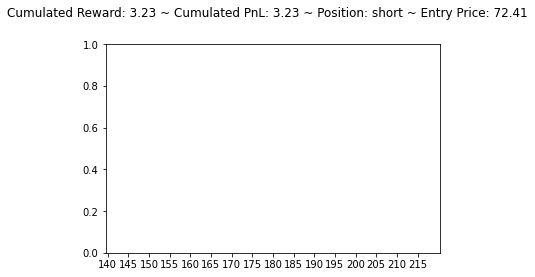

[580.1415  394.22278 729.63684]
short hold short


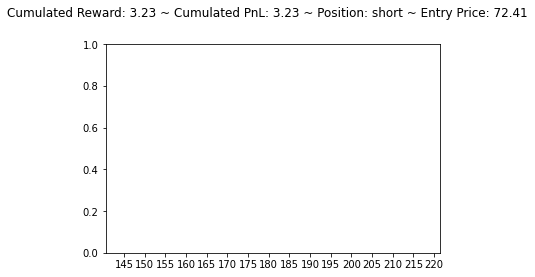

[415.28998 538.069   454.58344]
short buy flat


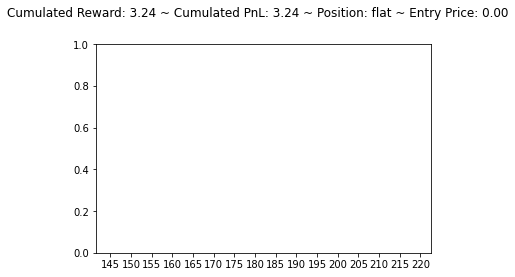

[387.3867  545.6775  486.19788]
flat buy long


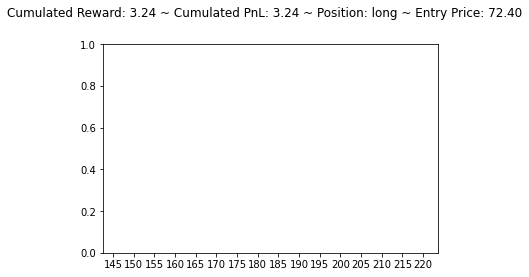

[441.85797 594.65173 562.4716 ]
long sell flat


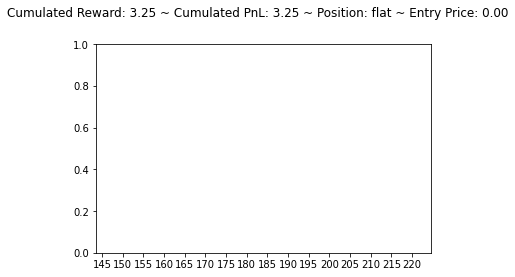

[419.4521  586.98663 533.6568 ]
flat buy long


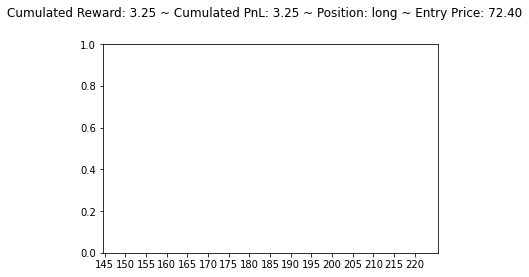

[419.4718  587.72327 471.50446]
long sell flat


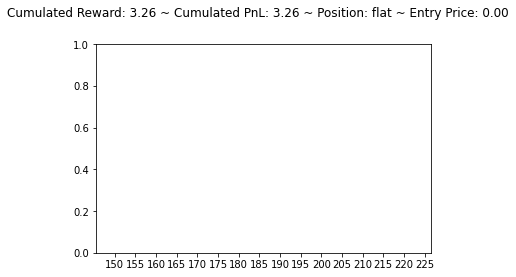

[398.54364 492.04367 438.93558]
flat buy long


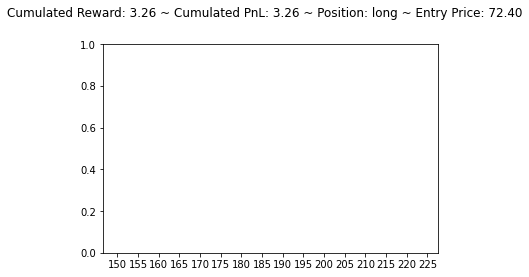

[413.312  521.8626 478.238 ]
long sell flat


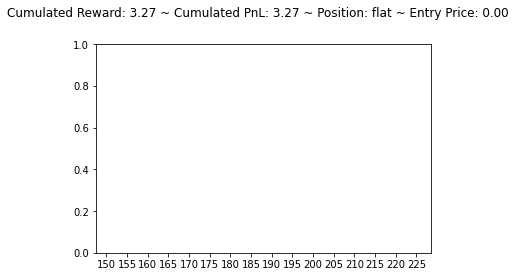

[390.85773 496.85336 427.9748 ]
flat buy long


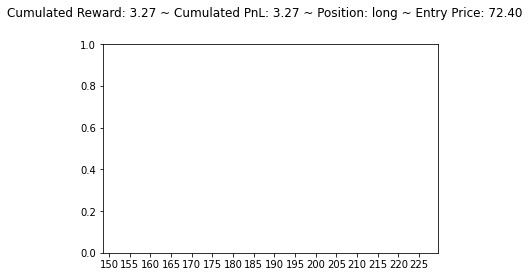

[410.18237 516.7062  472.387  ]
long sell flat


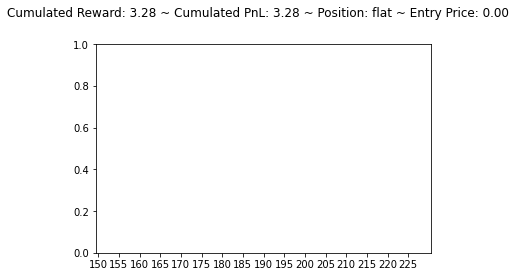

[324.87402 550.51636 582.19147]
flat sell short


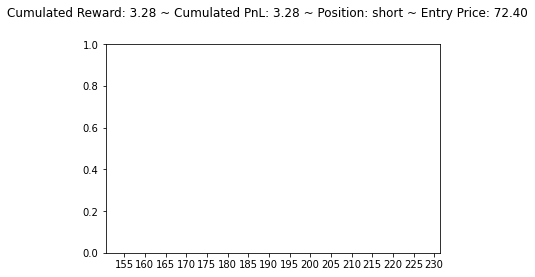

[746.6815  827.7526  800.79456]
short buy flat


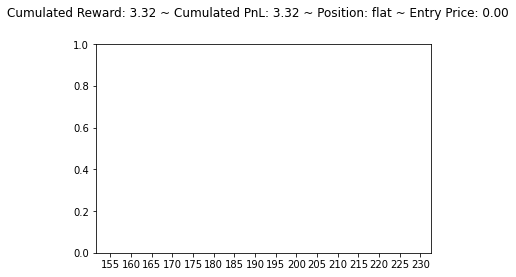

[328.74445 493.59763 551.84296]
flat sell short


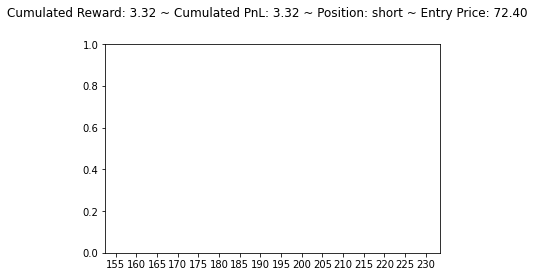

[275.9565  348.66406 302.95923]
short buy flat


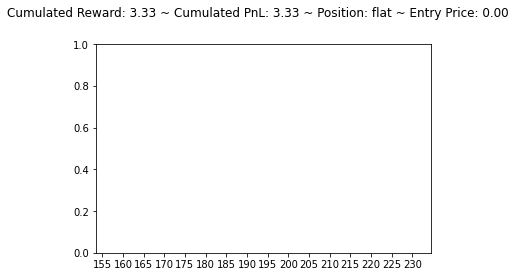

[206.52849 332.8827  259.99637]
flat buy long


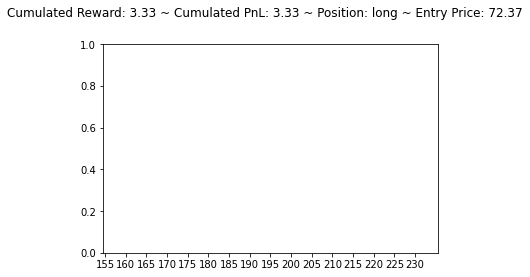

[260.8025  355.87076 377.66437]
long sell flat


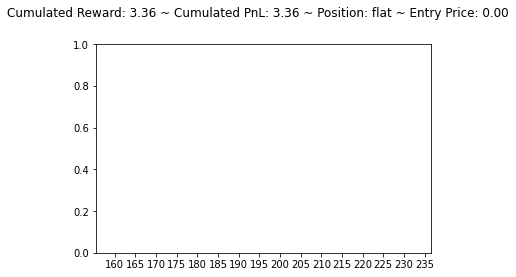

[165.77766 348.20413 255.03604]
flat buy long


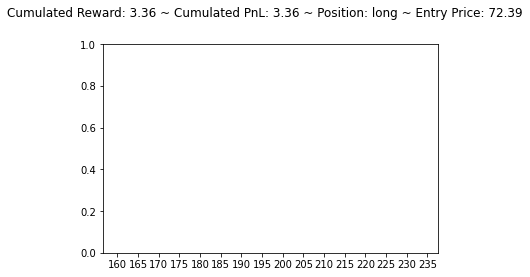

[166.6165  369.29456 298.086  ]
long sell flat


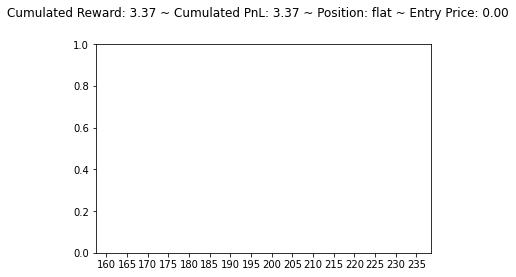

[459.69592 456.8187  375.28345]
flat hold flat


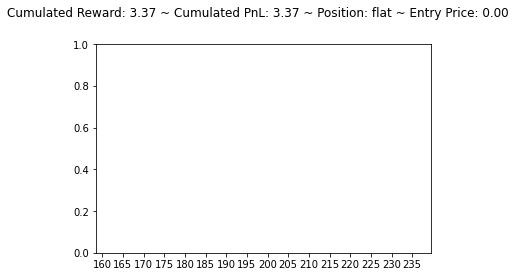

[346.2121  417.39914 403.38812]
flat buy long


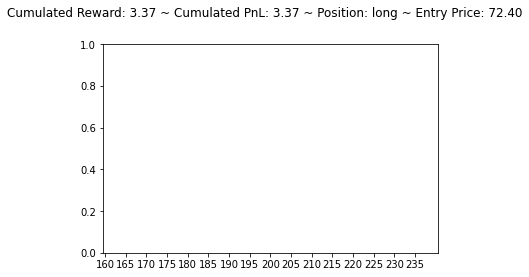

[568.5545  717.20294 772.97546]
long sell flat


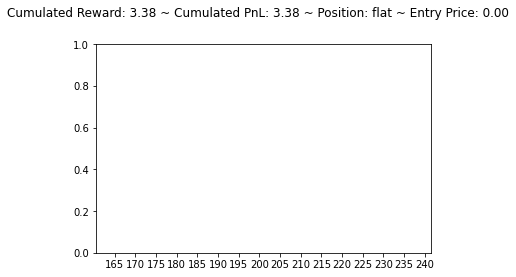

[494.13422  91.3111  723.6569 ]
flat sell short


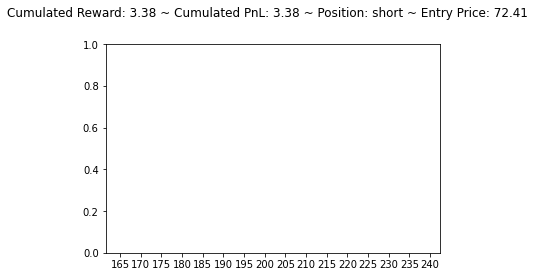

[345.28888 489.34006 475.15186]
short buy flat


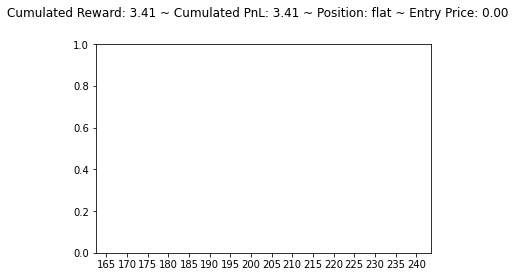

[325.66617 467.03714 417.40588]
flat buy long


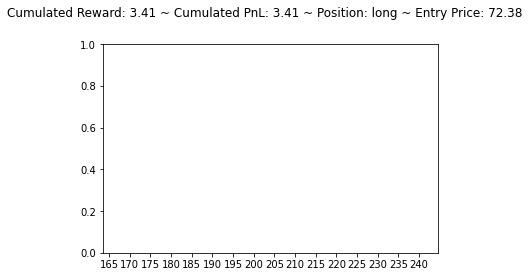

[359.43362 504.99838 492.91382]
long sell flat


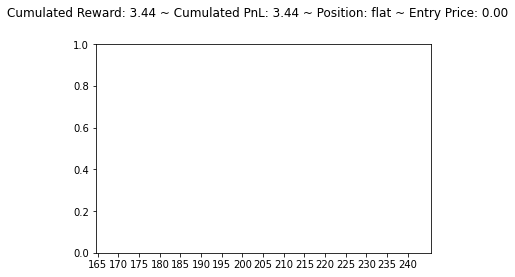

[326.73282 474.5611  430.69897]
flat buy long


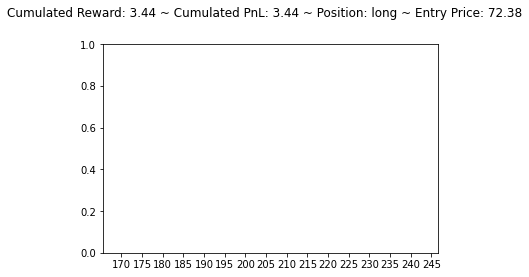

[370.71262 549.1044  541.4325 ]
long sell flat


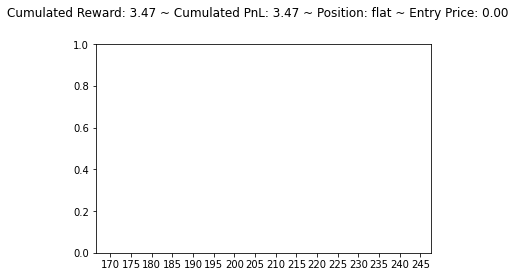

[726.5111  789.51636 717.9755 ]
flat buy long


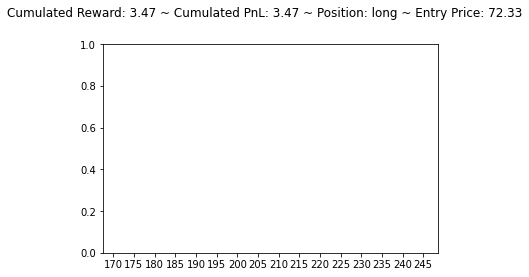

[514.0832  204.69397 732.1102 ]
long sell flat


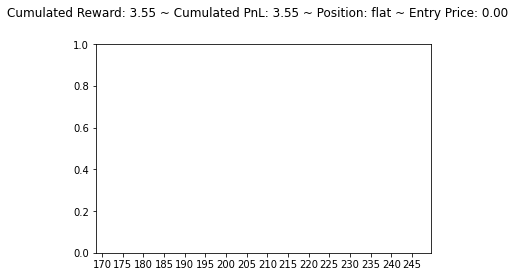

[794.97394 814.3623  786.236  ]
flat buy long


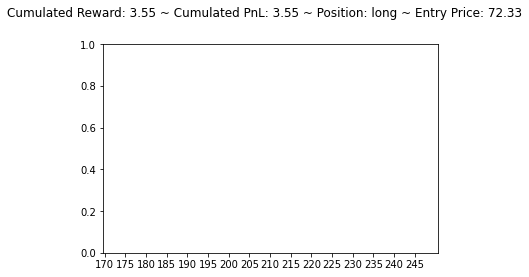

[500.50922 235.28976 706.2653 ]
long sell flat


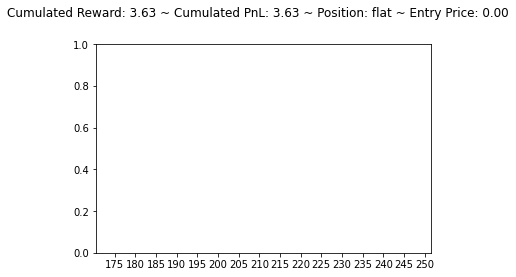

[365.89545 498.75616 460.8959 ]
flat buy long


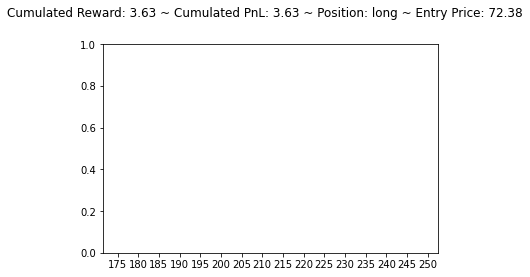

[385.89178 567.353   536.30884]
long sell flat


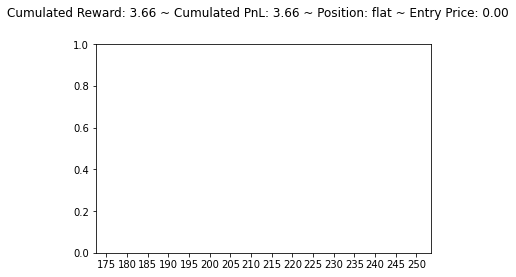

[317.62512 461.6008  405.516  ]
flat buy long


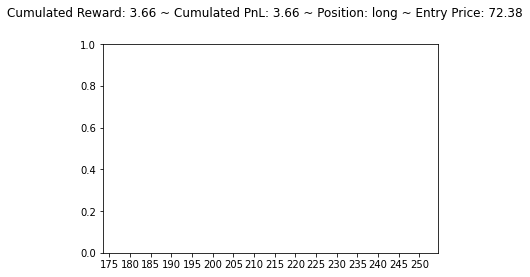

[316.7551  513.65967 480.45972]
long sell flat


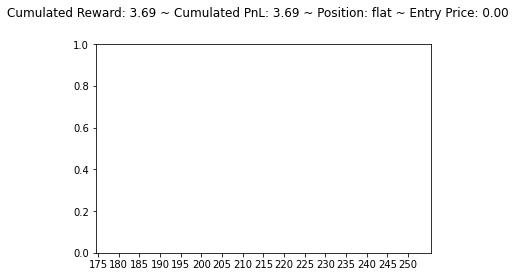

[721.5703 882.3979 682.303 ]
flat buy long


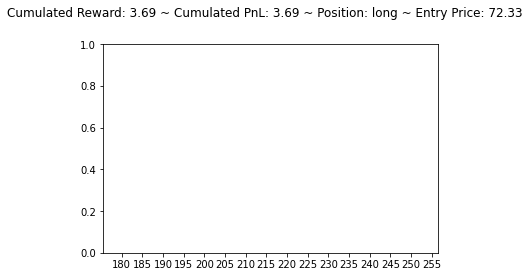

[451.89978 510.36728 626.3923 ]
long sell flat


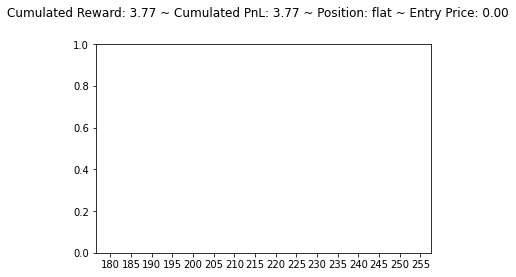

[280.07394 403.24915 346.3873 ]
flat buy long


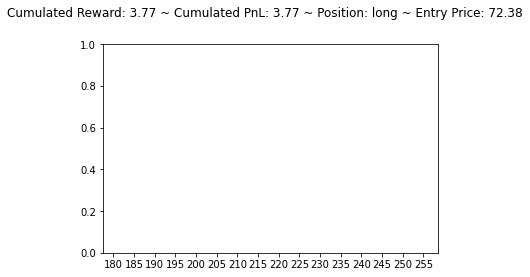

[248.06596 421.1828  357.59613]
long sell flat


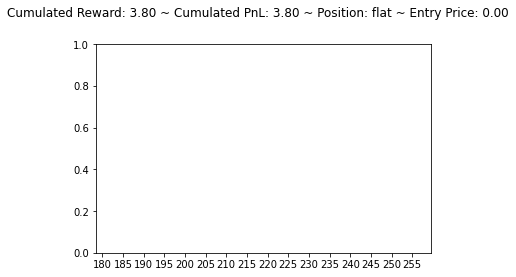

[185.55795 331.3516  269.9358 ]
flat buy long


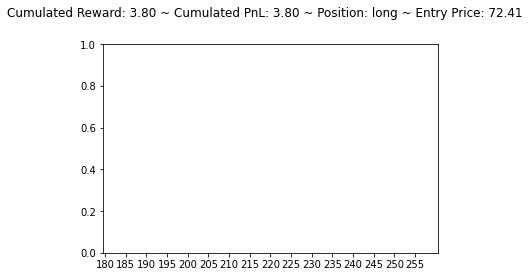

[196.38158 403.55728 331.35193]
long sell flat


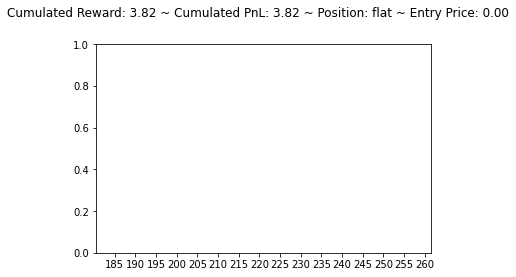

[206.37894 359.28934 287.96768]
flat buy long


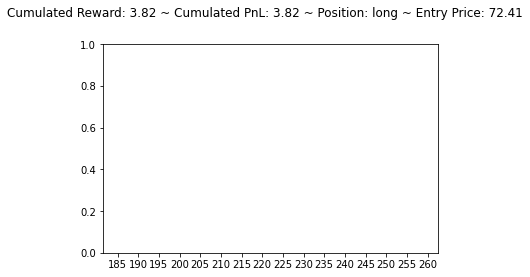

[195.84149 375.86816 278.2071 ]
long sell flat


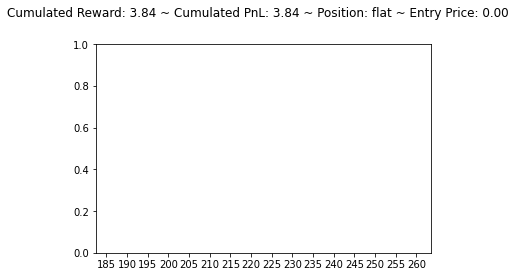

[156.038   360.93765 277.4765 ]
flat buy long


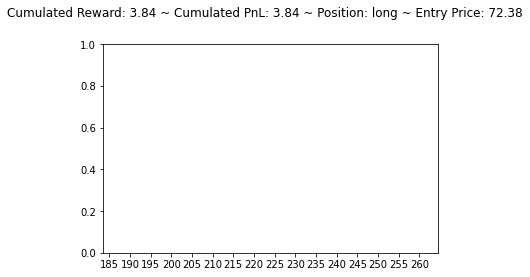

[284.23682 486.2144  394.43704]
long sell flat


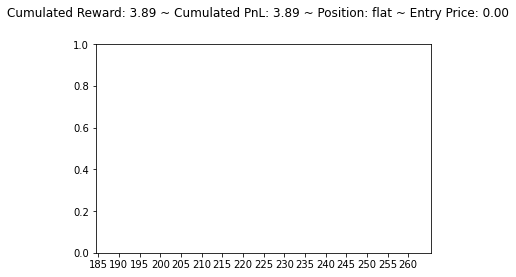

[271.41846 436.94626 349.68726]
flat buy long


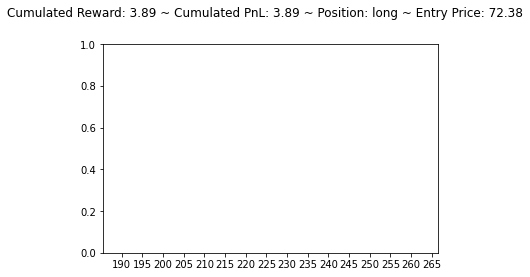

[269.81024 455.6132  377.18814]
long sell flat


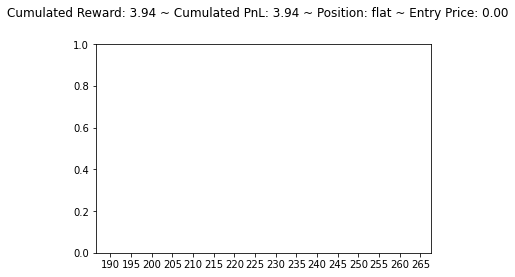

[214.87125 365.01505 292.97137]
flat buy long


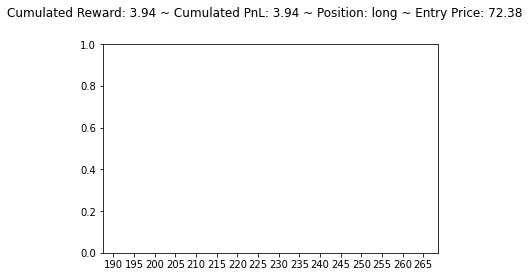

[261.3698  409.77435 293.2899 ]
long sell flat


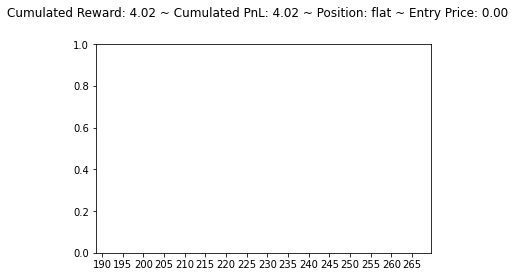

[433.359   466.6242  353.55756]
flat buy long


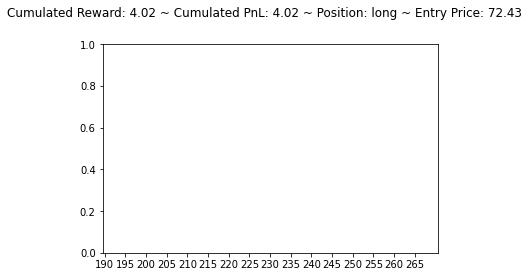

[453.1045  521.12445 471.08453]
long sell flat


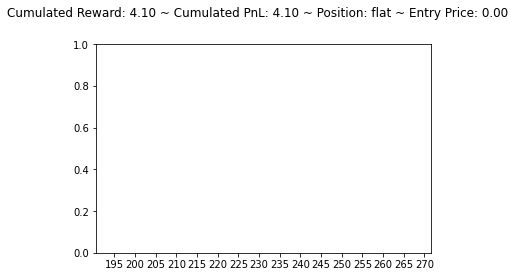

[359.54187 445.28696 307.46014]
flat buy long


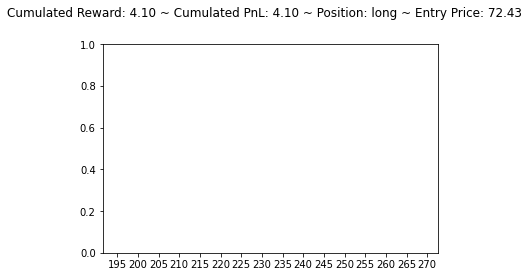

[298.53857 344.74704 246.24275]
long hold long


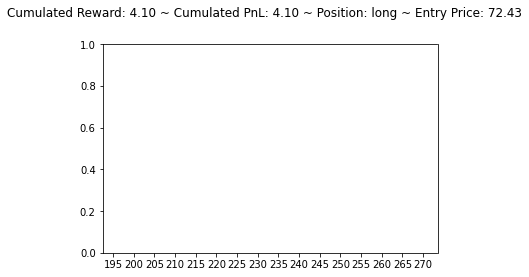

[243.6181  365.24625 317.36926]
long sell flat


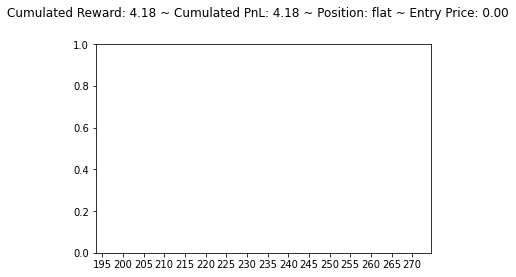

[452.06604 511.29056 430.11902]
flat buy long


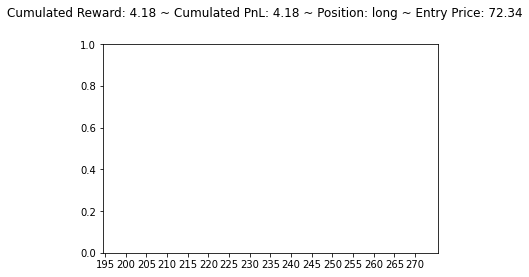

[341.84894 289.54965 399.88373]
long sell flat


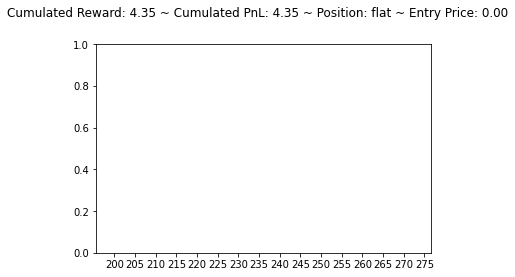

[674.84625 729.063   633.7809 ]
flat buy long


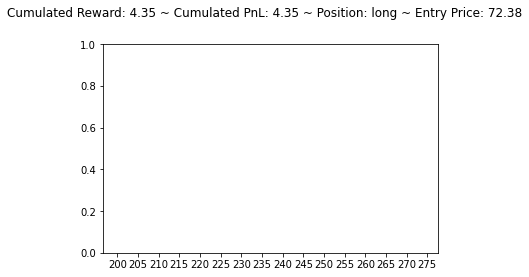

[575.8105 587.6256 497.1246]
long hold long


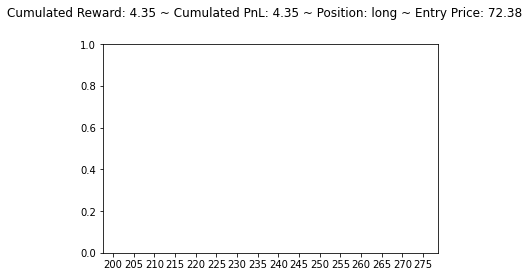

[466.66922 529.20435 469.14813]
long sell flat


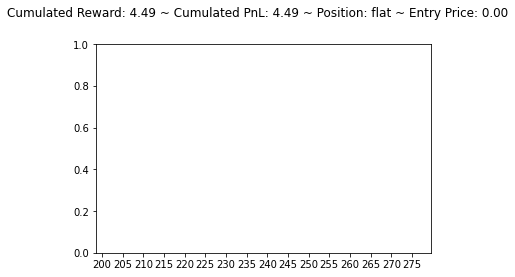

[318.69525 258.2729  365.1952 ]
flat sell short


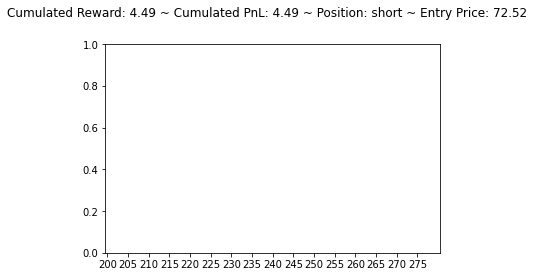

[249.6943  371.87723 343.91458]
short buy flat


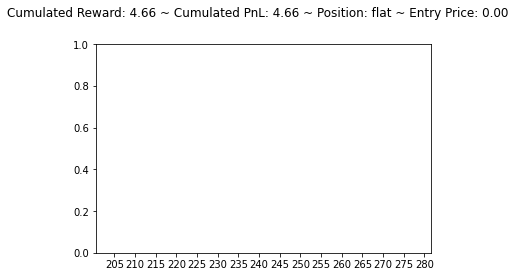

[198.54697 329.29715 235.44492]
flat buy long


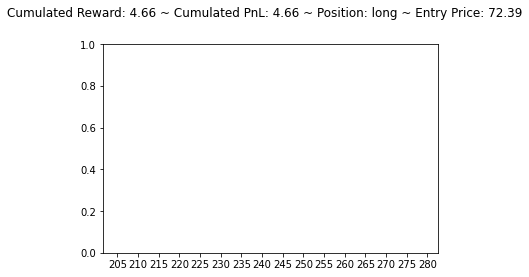

[240.89285 361.9918  315.32318]
long sell flat


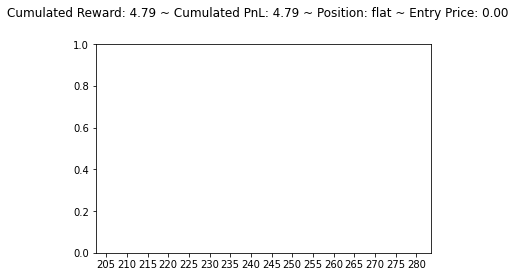

[214.3646 336.3438 281.8473]
flat buy long


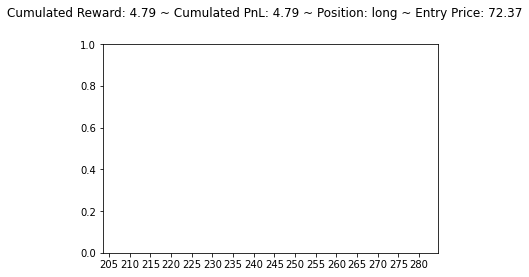

[287.1792  415.96716 374.12686]
long sell flat


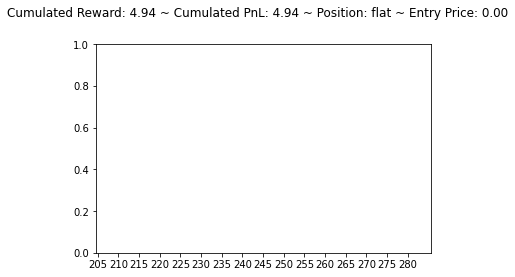

[380.70462 551.6111  418.1006 ]
flat buy long


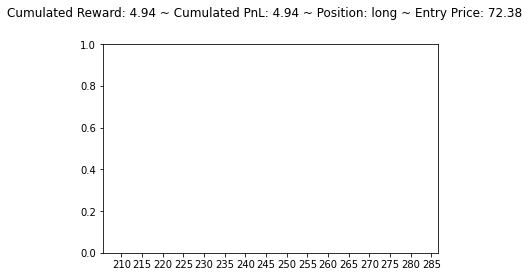

[355.01984 319.56973 379.2546 ]
long sell flat


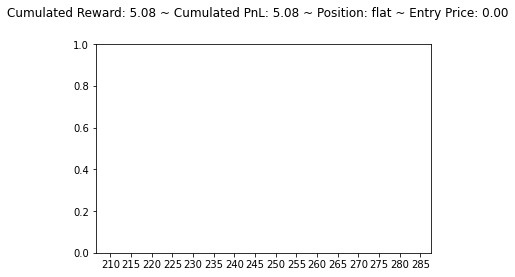

[217.39664 336.79742 238.73444]
flat buy long


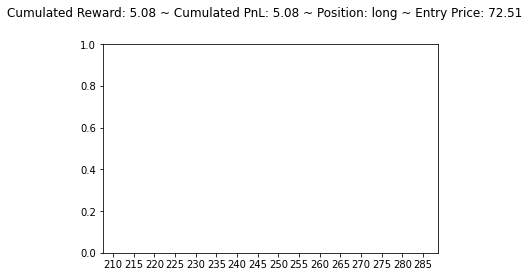

[763.3172  755.06006 710.1453 ]
long hold long


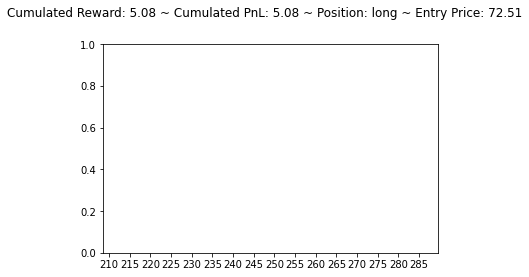

[612.79767 651.26874 596.1983 ]
long hold long


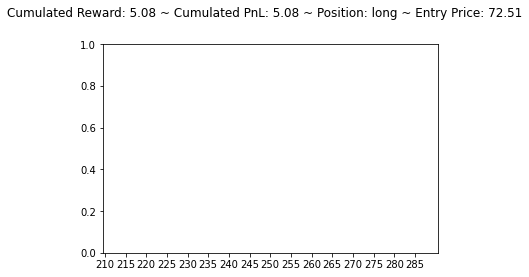

[546.2414 649.4018 556.7111]
long sell flat


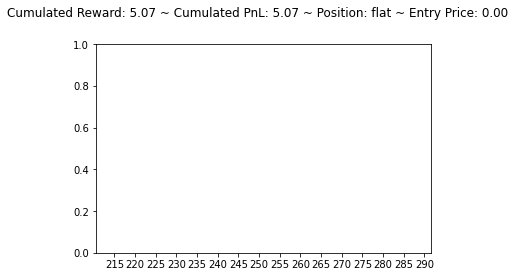

[313.6505  395.85092 412.56262]
flat sell short


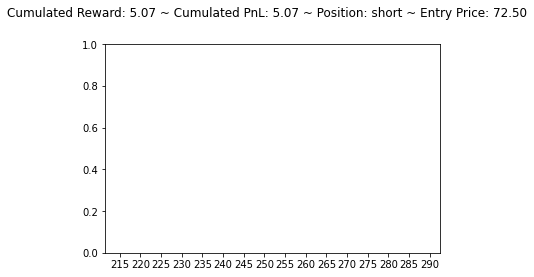

[504.539  640.448  550.2337]
short buy flat


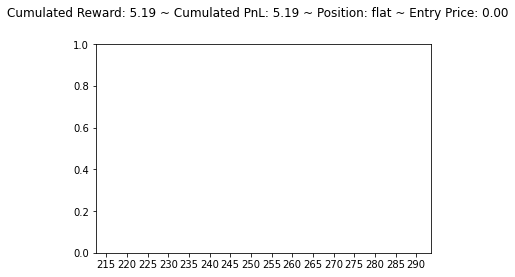

[434.6533  711.48663 649.2324 ]
flat buy long


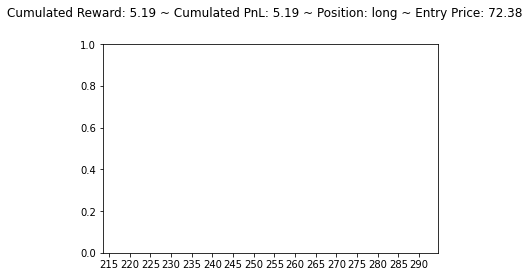

[273.9663  398.01028 477.8952 ]
long sell flat


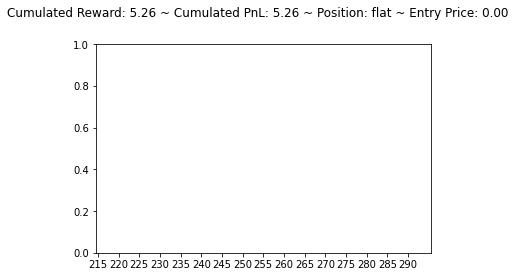

[288.82    487.28394 376.53635]
flat buy long


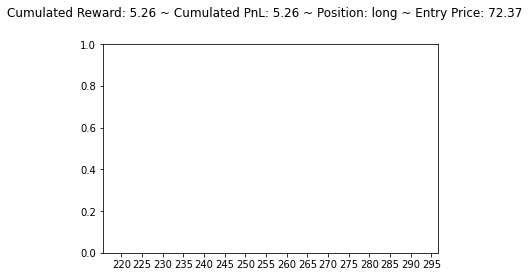

[251.18188 405.25912 366.88126]
long sell flat


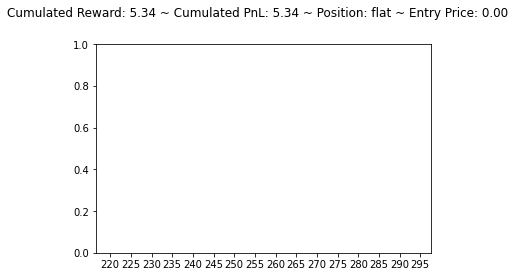

[205.24911 377.025   300.7939 ]
flat buy long


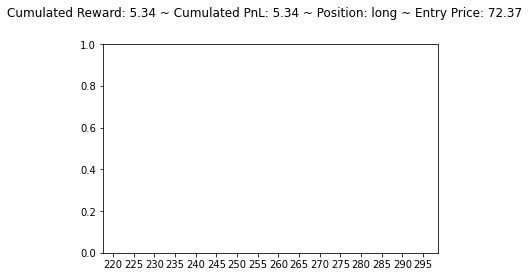

[180.99454 356.99957 313.80682]
long sell flat


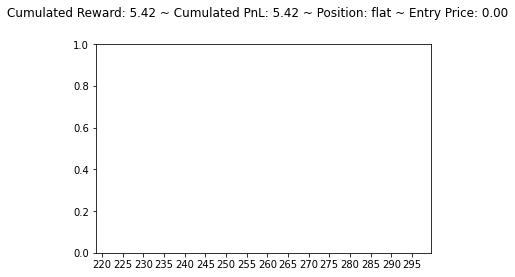

[144.9855  332.7207  240.92435]
flat buy long


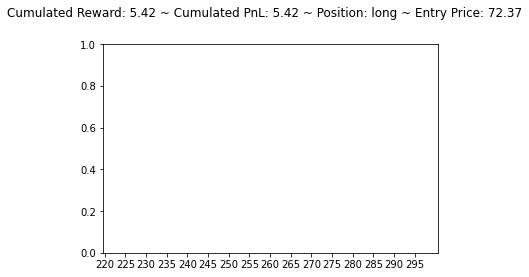

[117.231476 317.86502  303.3555  ]
long sell flat


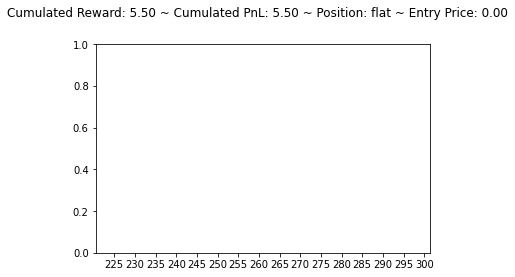

[100.65659 295.92142 223.98578]
flat buy long


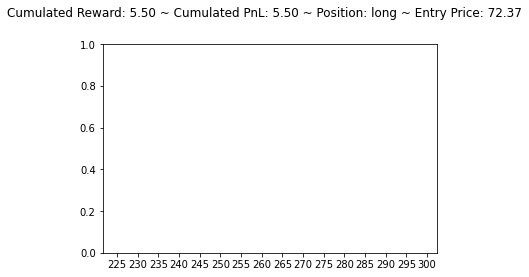

[301.00677 399.47803 328.2071 ]
long sell flat


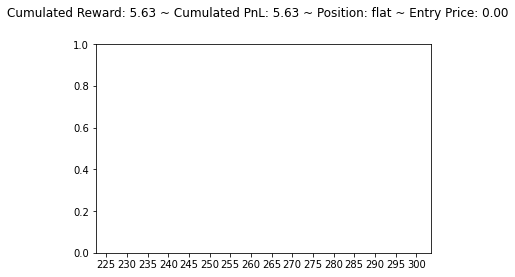

[244.04965 360.1714  273.66412]
flat buy long


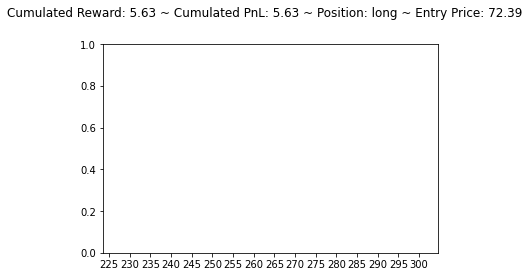

[103.38821 275.1365  262.69485]
long sell flat


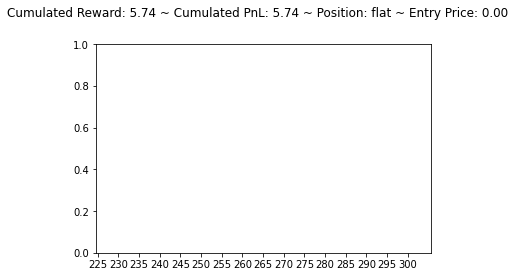

[270.09442 325.43658 176.97136]
flat buy long


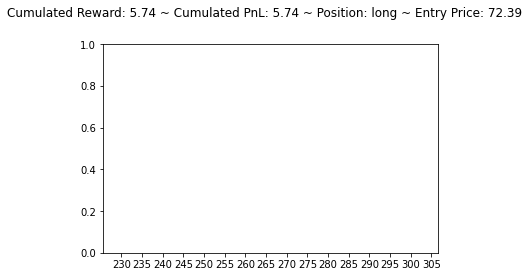

[286.77448 413.53024 355.4371 ]
long sell flat


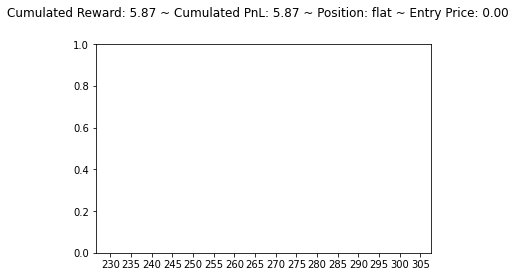

[242.70609 381.68048 354.8401 ]
flat buy long


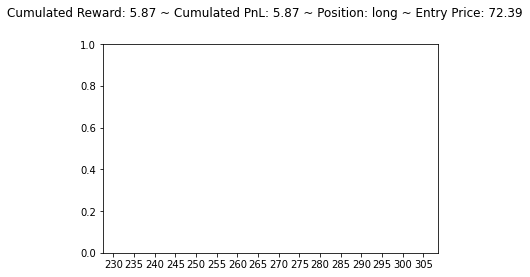

[215.56128 369.67197 297.10696]
long sell flat


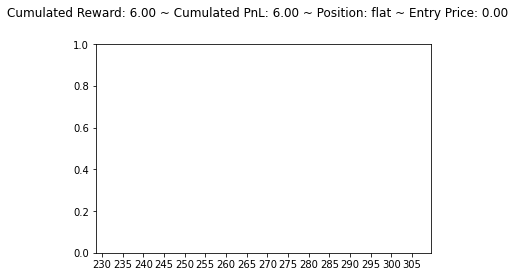

[228.34409 333.7658  274.43826]
flat buy long


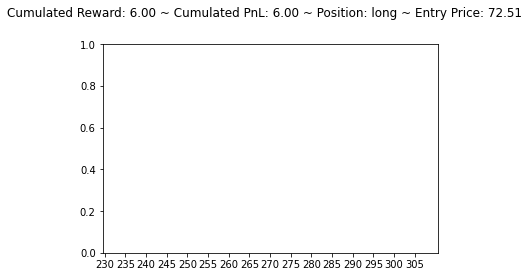

[692.787   748.07764 647.8044 ]
long hold long


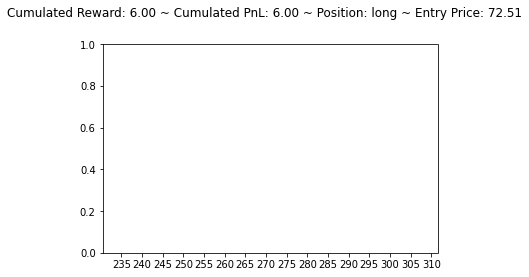

[591.6025  685.47815 662.622  ]
long sell flat


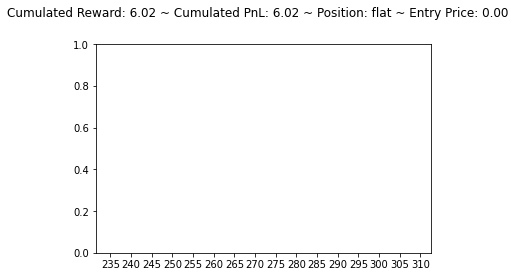

flat sell short


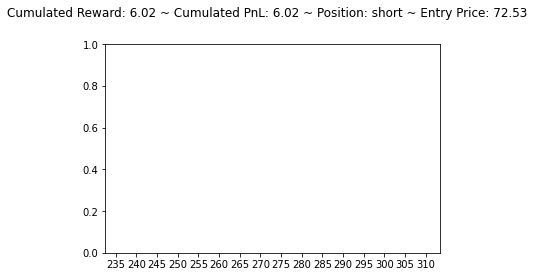

[559.0553 677.0546 593.9539]
short buy flat


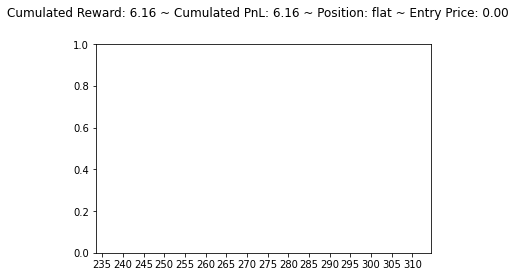

[238.9342  386.23538 337.67102]
flat buy long


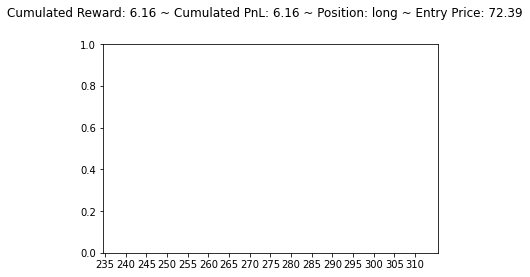

[269.10547 432.0233  382.29013]
long sell flat


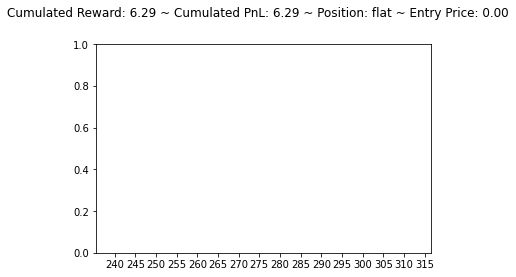

[263.71436 412.49658 354.06082]
flat buy long


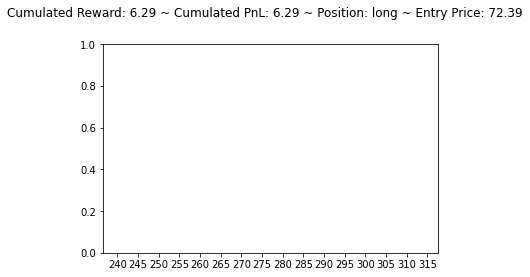

[248.1488  412.73013 378.066  ]
long sell flat


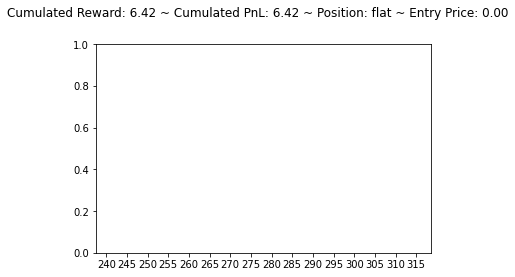

[222.38919 370.7158  326.93848]
flat buy long


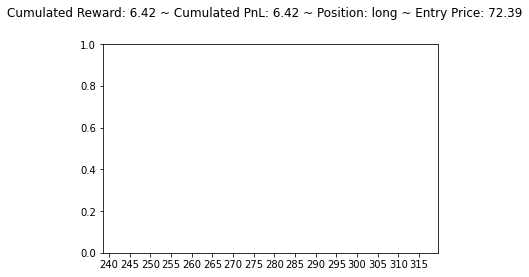

[262.0861  432.8165  375.54388]
long sell flat


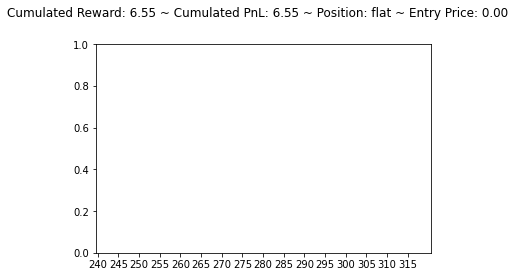

[478.80786 574.11597 406.47687]
flat buy long


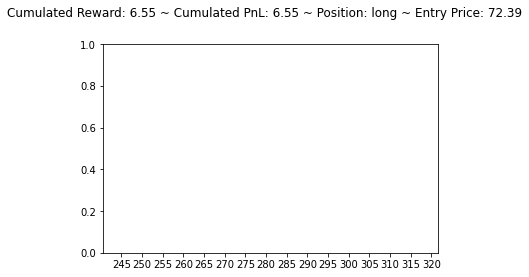

[413.37817 519.1159  495.72092]
long sell flat


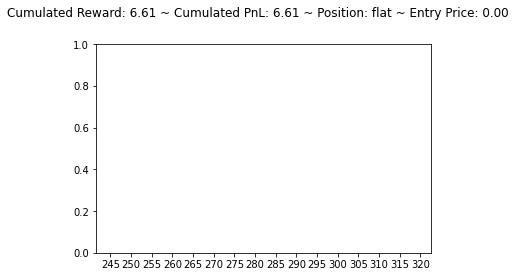

flat buy long


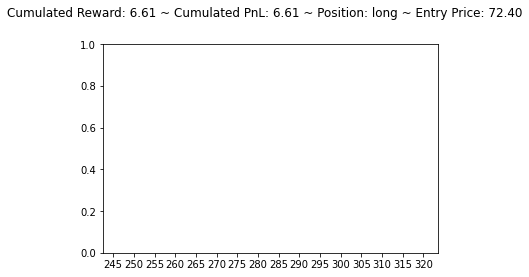

[203.91362 366.4066  335.8487 ]
long sell flat


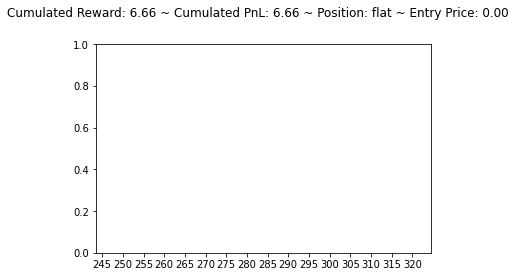

[178.48042 351.3347  292.5373 ]
flat buy long


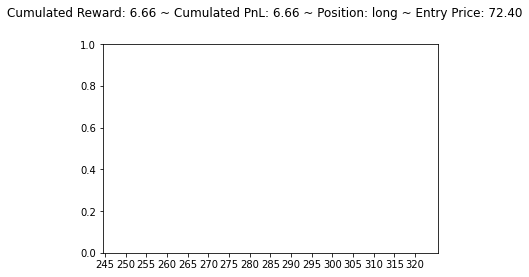

[234.79396 414.37228 249.66885]
long sell flat


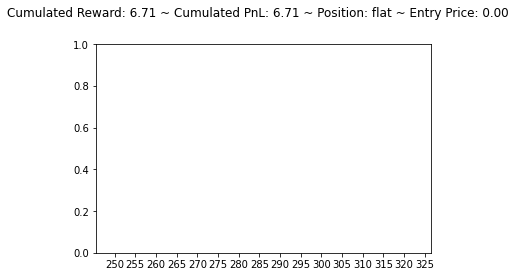

[203.54301 386.31277 309.82117]
flat buy long


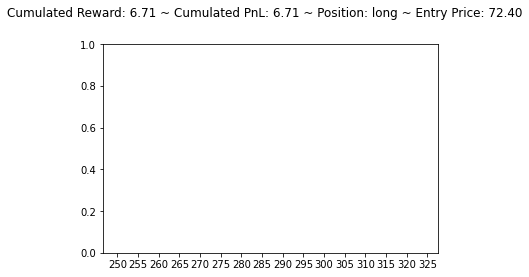

[624.474  645.4997 595.2154]
long hold long


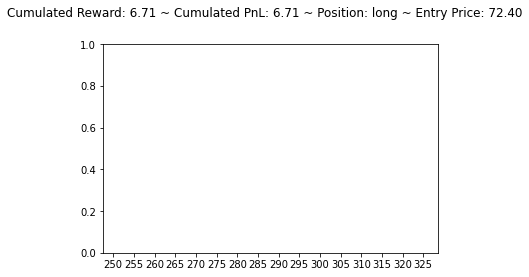

[567.3894 683.1802 614.3038]
long sell flat


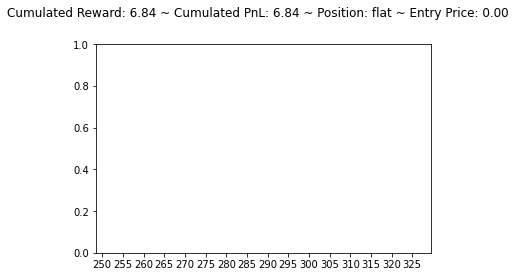

[541.02295 635.19977 582.2635 ]
flat buy long


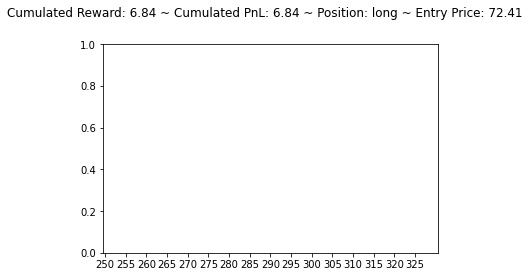

[569.72296 667.9078  635.9439 ]
long sell flat


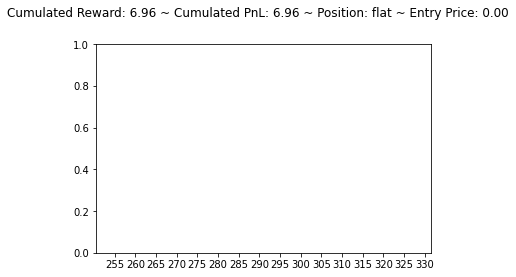

[536.8219 632.7209 580.051 ]
flat buy long


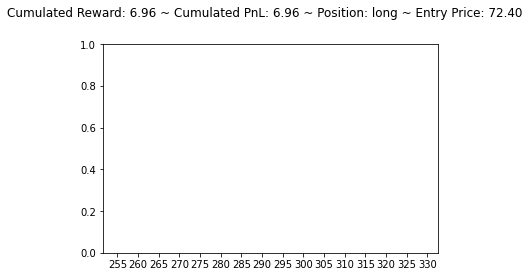

[623.90485 746.29614 653.4381 ]
long sell flat


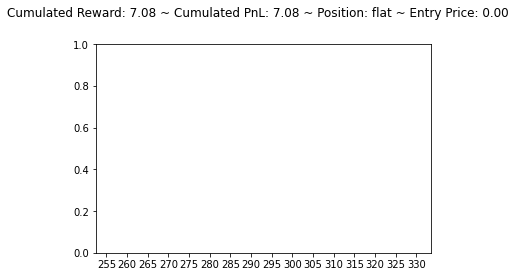

[581.0421 667.3561 631.6264]
flat buy long


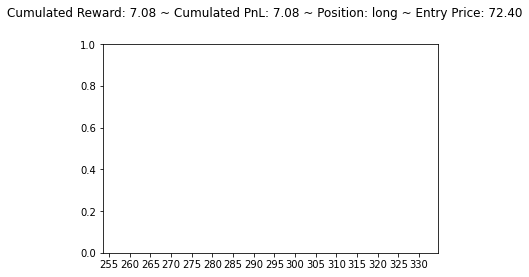

[615.06635 698.8553  687.786  ]
long sell flat


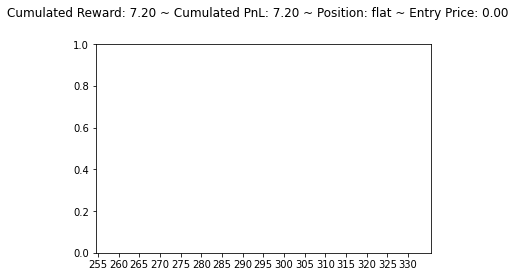

[570.1759  587.7188  629.99097]
flat sell short


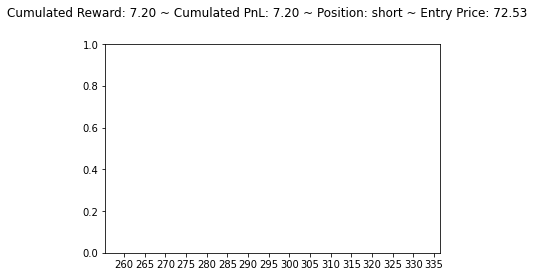

[461.06082 400.2059  541.33795]
short hold short


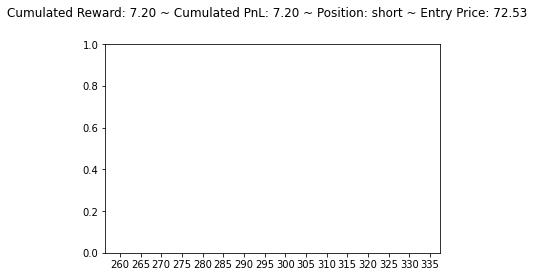

[389.42212 502.57004 468.7026 ]
short buy flat


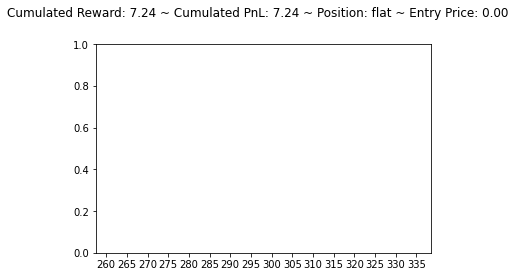

[369.63824 478.1008  420.47806]
flat buy long


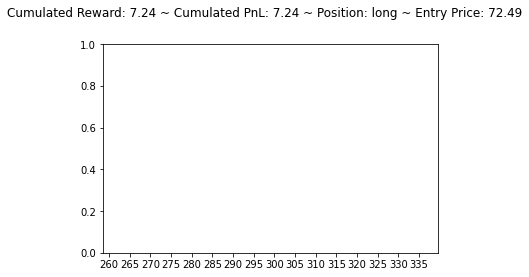

[394.14224 505.8273  472.30862]
long sell flat


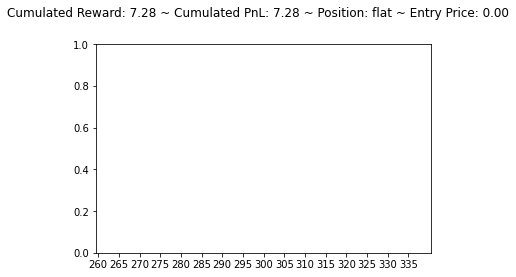

[360.04758 482.18033 367.55713]
flat buy long


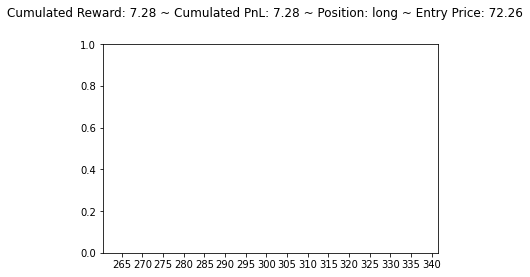

[430.9724  576.89246 549.47614]
long sell flat


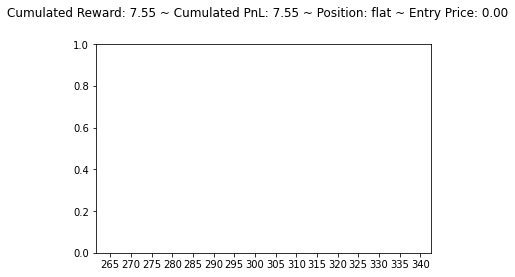

[430.48544 572.1034  513.07   ]
flat buy long


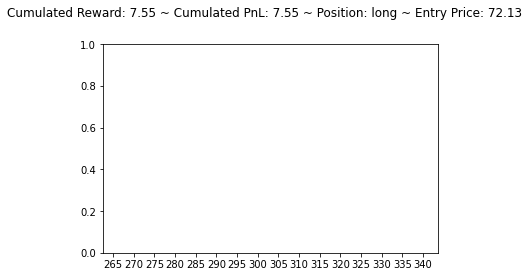

[ 675.22943 1040.9454   939.98804]
long sell flat


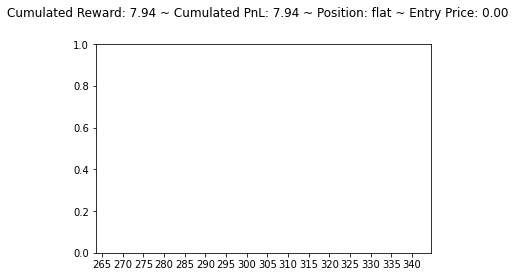

[873.5803  908.03455 905.49274]
flat buy long


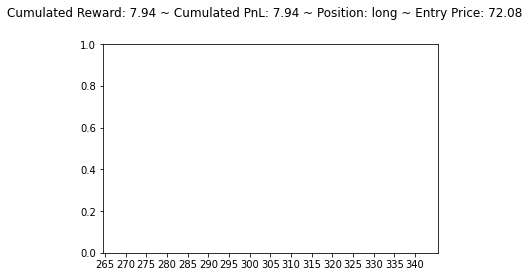

[789.33435 867.60425 900.67883]
long sell flat


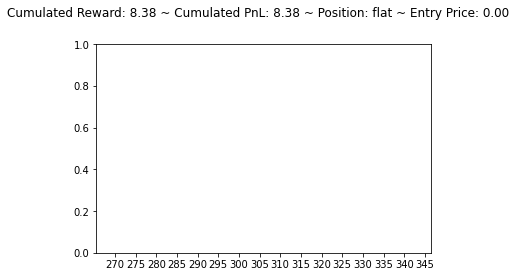

[804.74744 815.1245  866.5312 ]
flat sell short


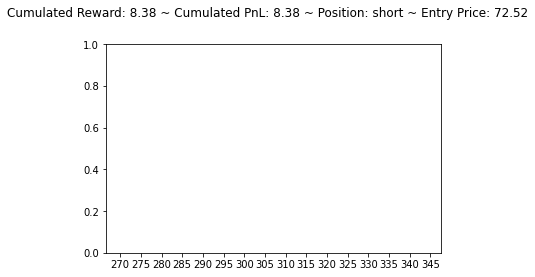

[779.2092 656.0185 777.0324]
short hold short


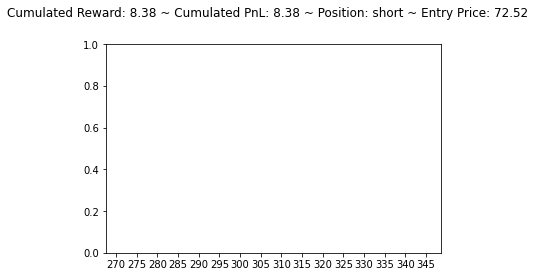

[778.7354  796.9448  620.43524]
short buy flat


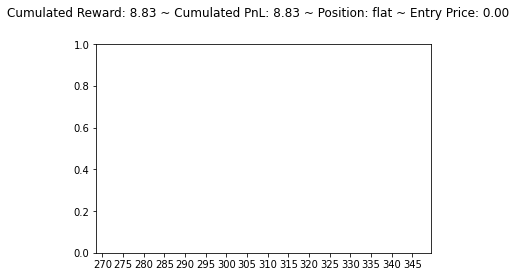

[1177.967  1197.6936 1054.1558]
flat buy long


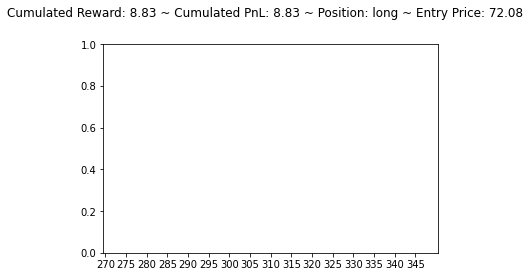

[1017.00916 1123.8992  1181.1249 ]
long sell flat


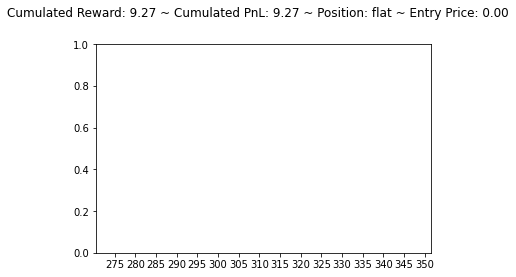

[ 947.5073 1088.3579  964.4959]
flat buy long


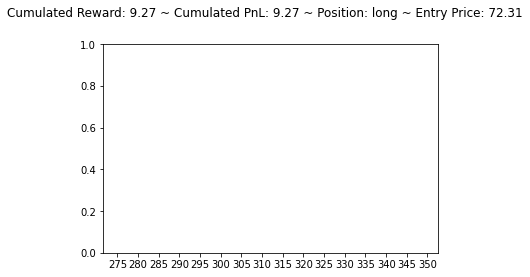

[868.4311 945.4603 921.8683]
long sell flat


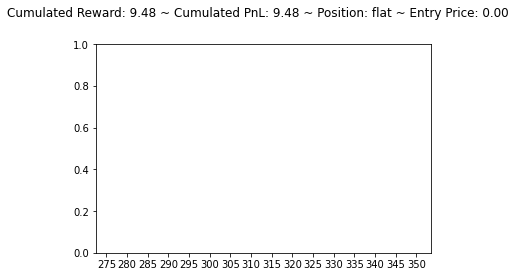

[801.0098  784.70526 600.016  ]
flat hold flat


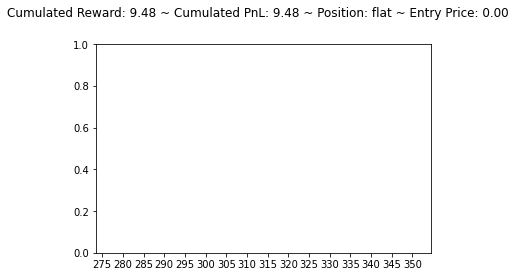

[139.0074 336.2165 311.0096]
flat buy long


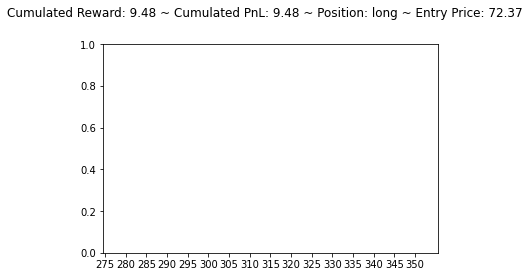

[357.88034 429.23154 424.6615 ]
long sell flat


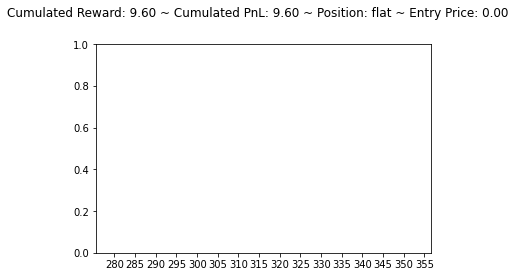

[232.50067 388.0222  373.7341 ]
flat buy long


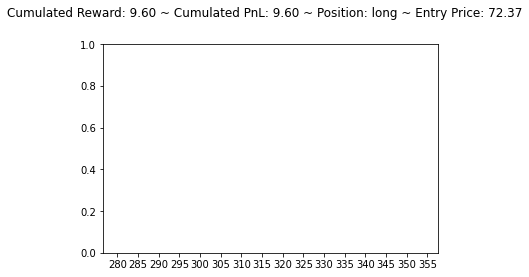

[1460.9434 1596.4415 1562.5856]
long sell flat


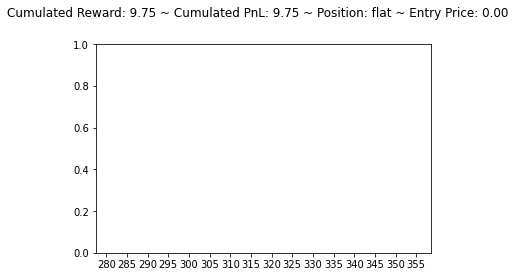

[1321.3265 1074.469   800.4406]
flat hold flat


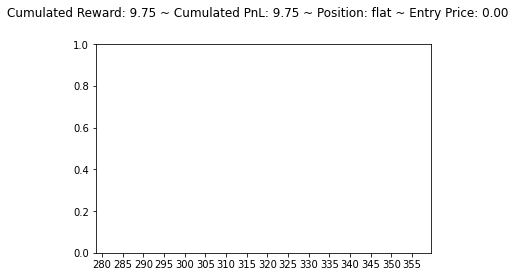

[104.94256 269.5679  278.26572]
flat sell short


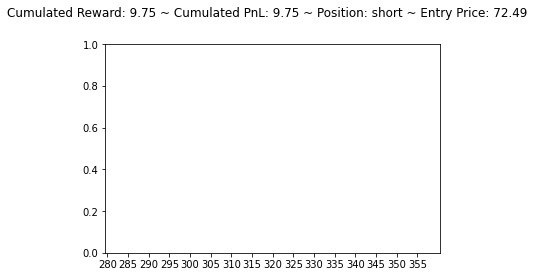

[111.56246 290.62753 198.13826]
short buy flat


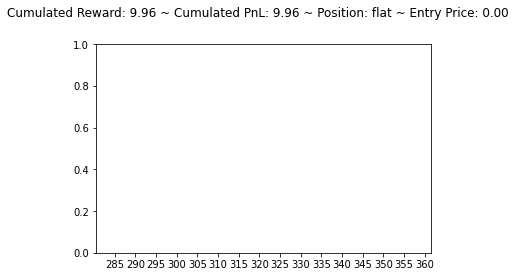

[1522.9249 1637.855  1588.2528]
flat buy long


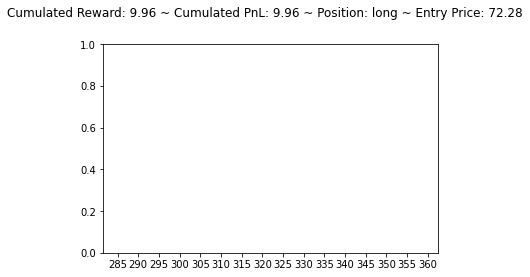

[1435.3091 1428.4559 1432.1952]
long hold long


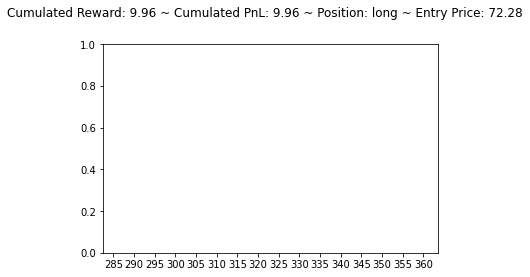

[1216.5658   756.71716  744.32745]
long hold long


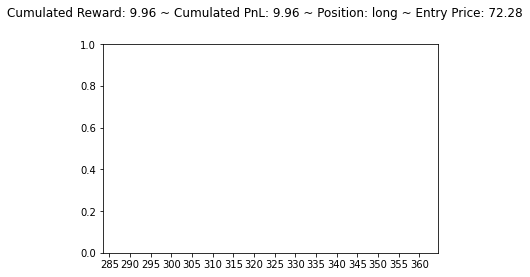

[1775.7291 1842.6157 1734.316 ]
long hold long


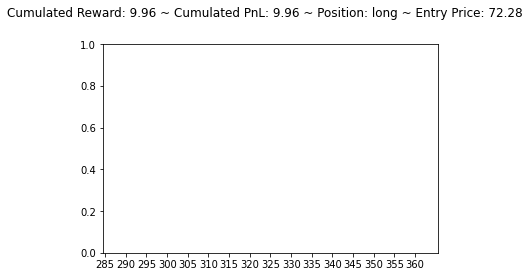

[1606.9247 1612.9231 1631.2235]
long sell flat


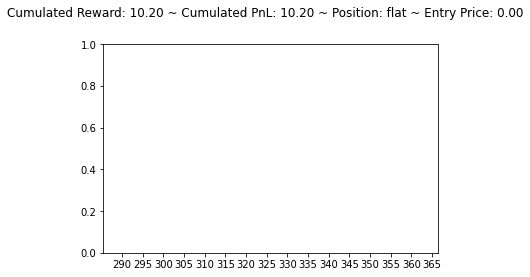

[1505.9984 1116.0303 1136.8691]
flat hold flat


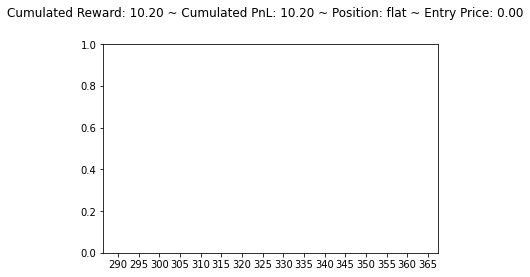

[1334.5425 1536.6096 1274.4407]
flat buy long


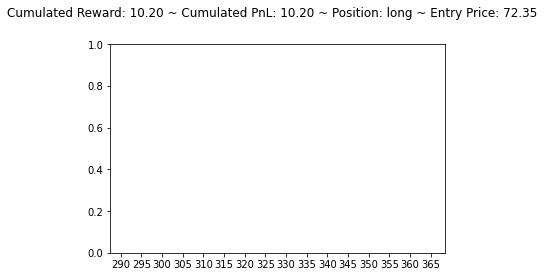

[1337.5706 1351.1355 1372.9789]
long sell flat


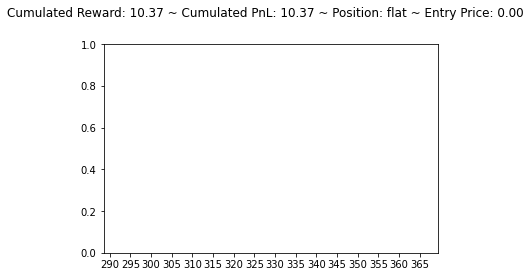

[1186.2183   791.03204  806.9189 ]
flat hold flat


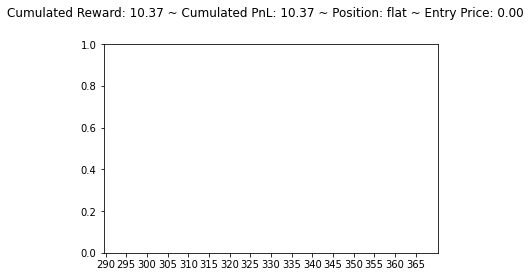

[375.1322 505.4595 420.9984]
flat buy long


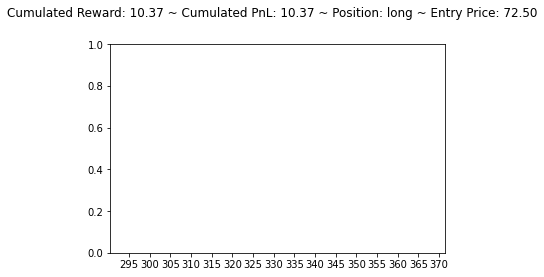

[402.45093 493.79184 485.19592]
long sell flat


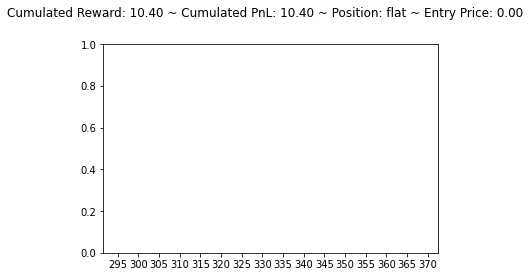

[376.23553 504.04892 421.81577]
flat buy long


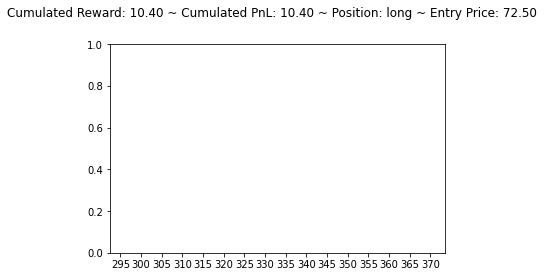

[402.04233 497.22562 483.61227]
long sell flat


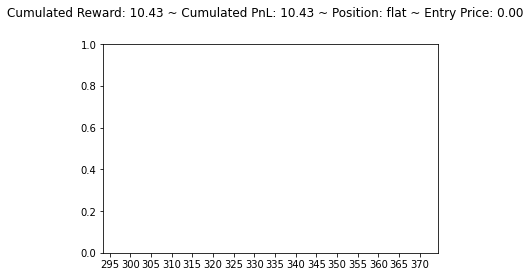

[356.12085 571.44464 441.7573 ]
flat buy long


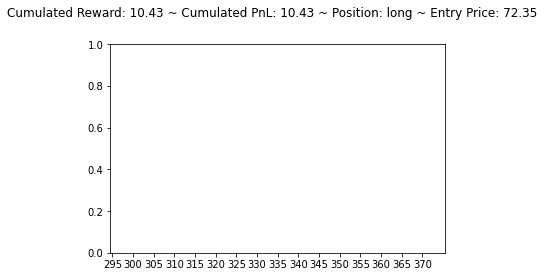

long hold long


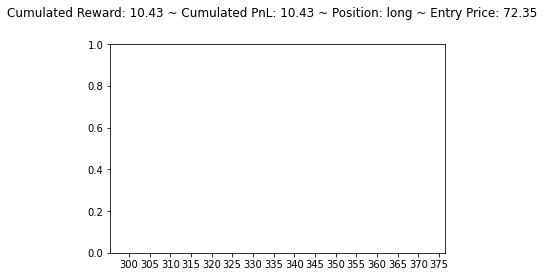

[1225.679  1217.3716 1286.1857]
long sell flat


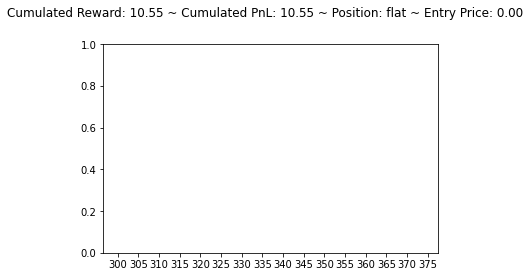

[1233.1692 1249.6565 1237.7721]
flat buy long


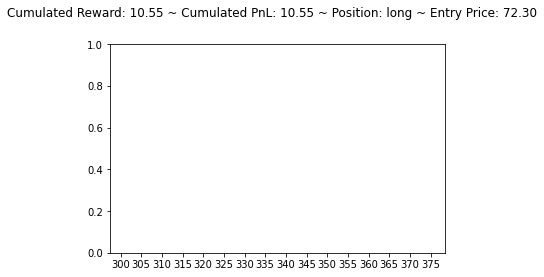

[1253.4017 1294.0831 1288.2897]
long sell flat


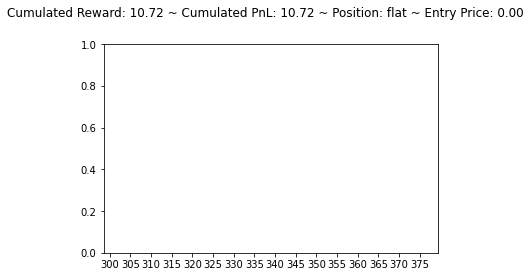

[1236.9467 1260.2242 1240.3148]
flat buy long


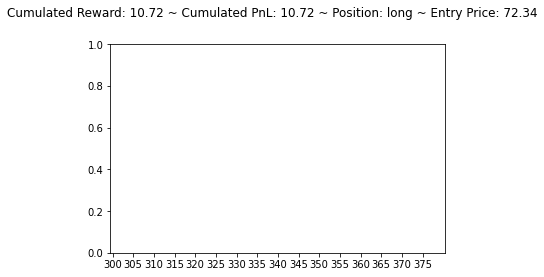

[1270.1118 1298.1908 1297.6827]
long sell flat


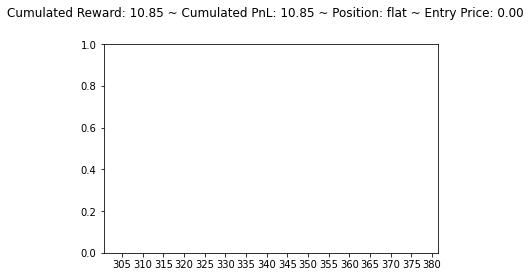

[1178.8014 1076.7473 1214.0782]
flat sell short


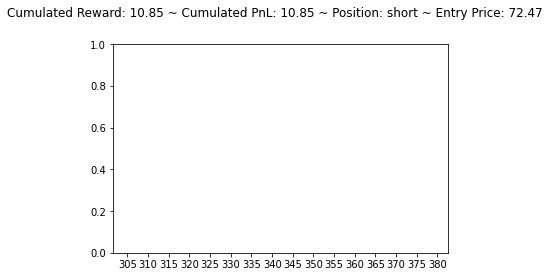

[1161.093  1183.0222 1173.7711]
short buy flat


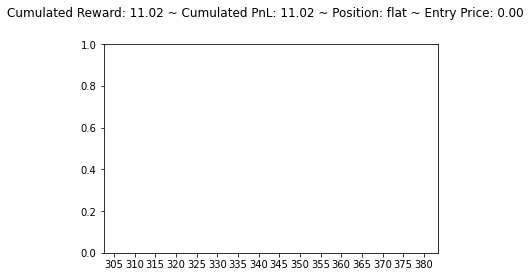

[1102.239  1150.328  1109.6093]
flat buy long


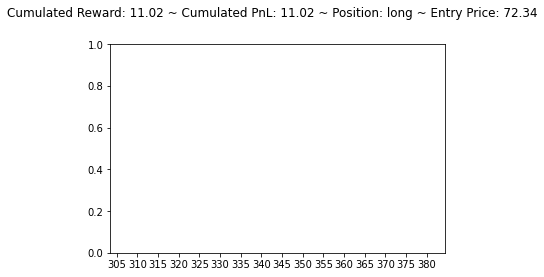

[1006.0163   854.50116 1067.5271 ]
long sell flat


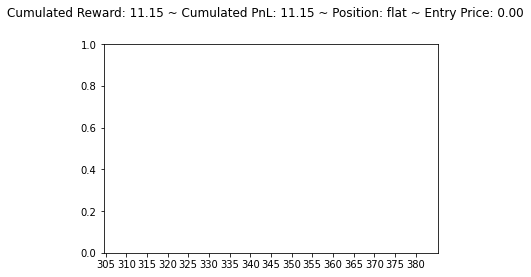

[866.19415 888.3944  898.54974]
flat sell short


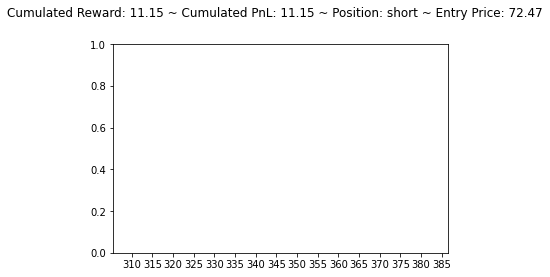

[874.5465  946.01666 921.4632 ]
short buy flat


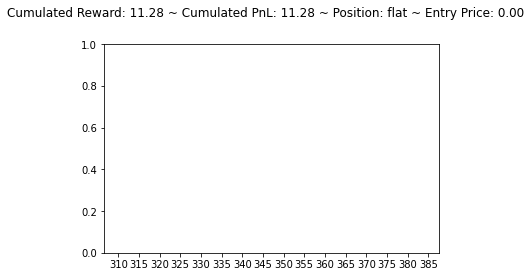

[828.51013 898.82275 859.2973 ]
flat buy long


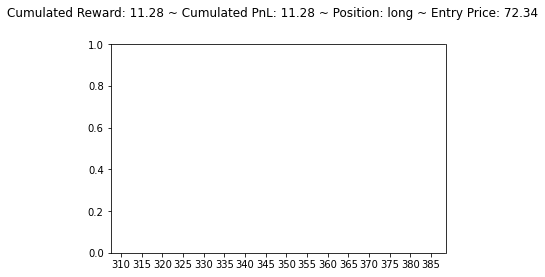

[1645.6509 1606.7742 1659.4475]
long sell flat


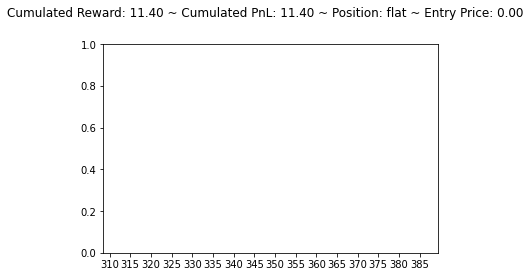

[1183.6069  447.2227 1048.9791]
flat hold flat


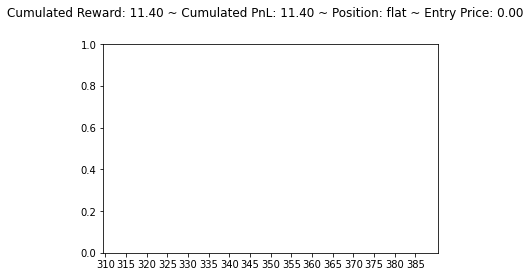

[816.6319  877.9011  846.49615]
flat buy long


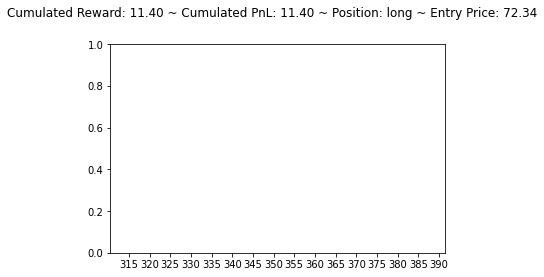

[850.34033 922.43524 903.3856 ]
long sell flat


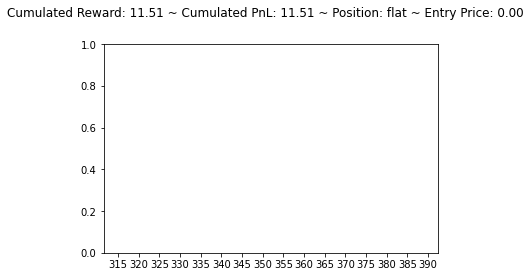

[842.2738 908.6415 860.7465]
flat buy long


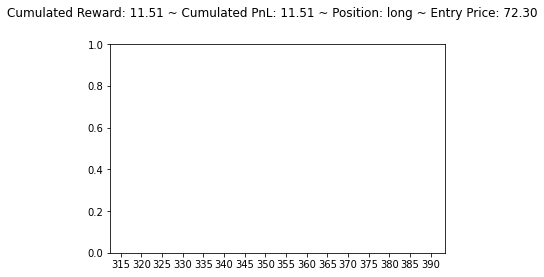

[849.6748  928.28735 903.4554 ]
long sell flat


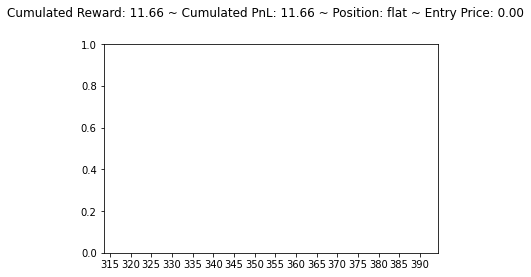

[819.80225 883.7446  848.40674]
flat buy long


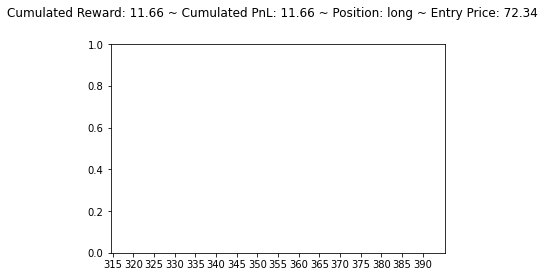

[857.93195 929.24316 907.44354]
long sell flat


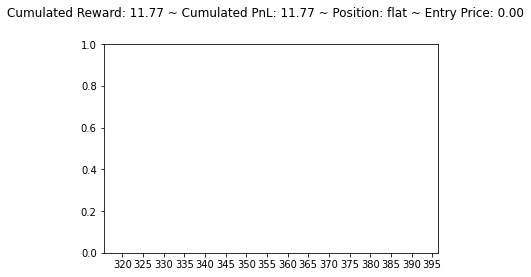

[823.0887 893.8408 850.6799]
flat buy long


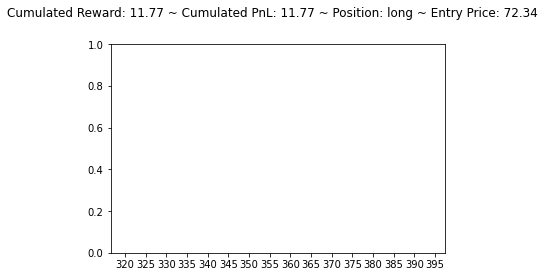

[1911.1564 1725.3359 1628.807 ]
long hold long


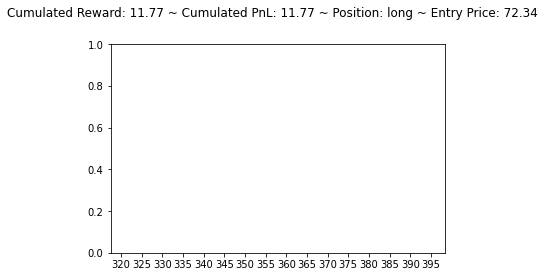

[2248.57   2121.8364 2056.1843]
long hold long


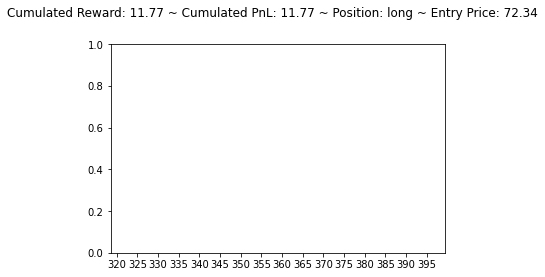

[2091.9844 2533.6895 2161.7507]
long sell flat


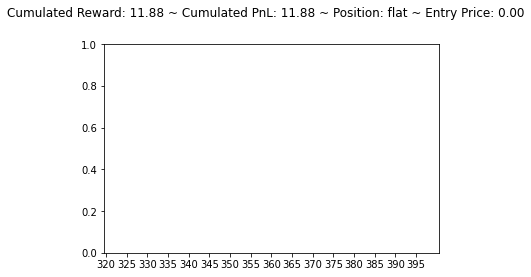

[1737.9242 1800.9647 1962.8751]
flat sell short


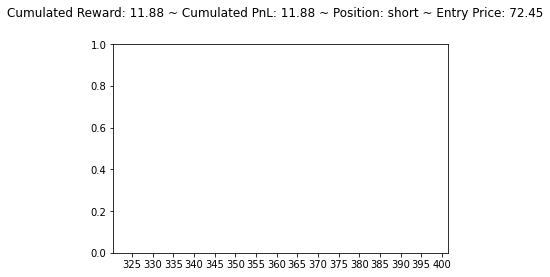

[1426.3447 1412.7498 1488.4933]
short hold short


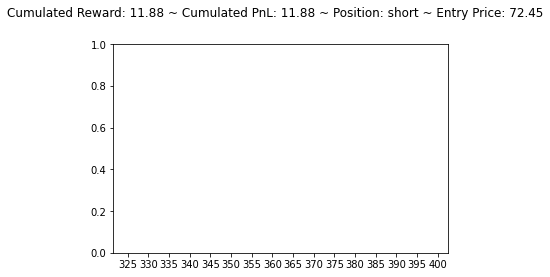

[1880.1248 2094.105  2134.0315]
short buy flat


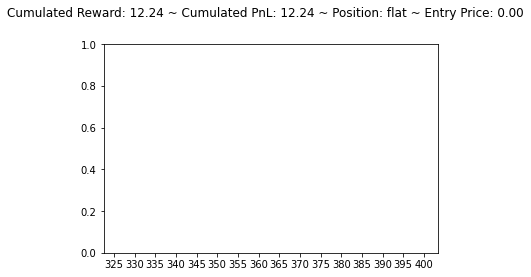

[1674.6652   948.65753 1830.41   ]
flat sell short


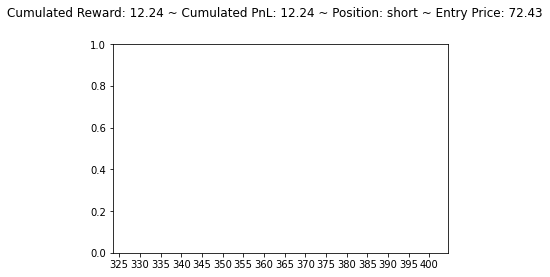

[1378.2832 1373.1052 1432.9517]
short hold short


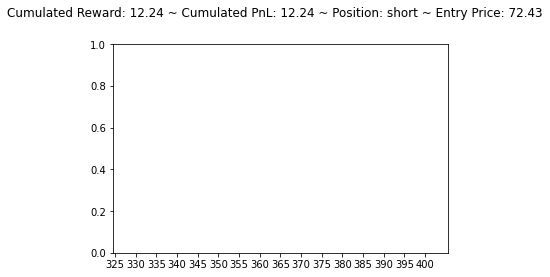

[2052.5715 2138.7712 2328.964 ]
short buy flat


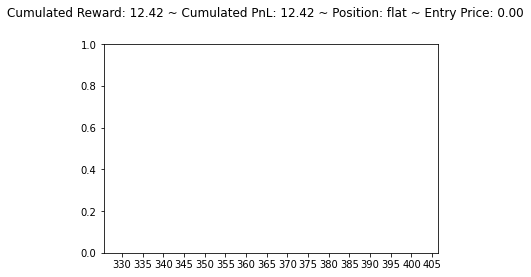

[1529.133   618.4047 1536.6239]
flat sell short


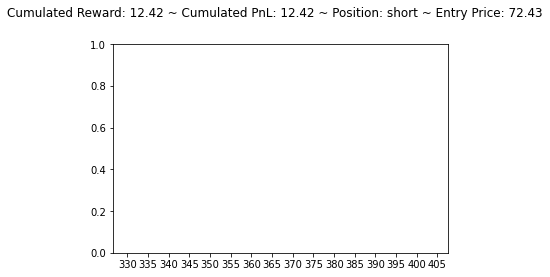

[1119.0793 1145.9159 1204.5773]
short buy flat


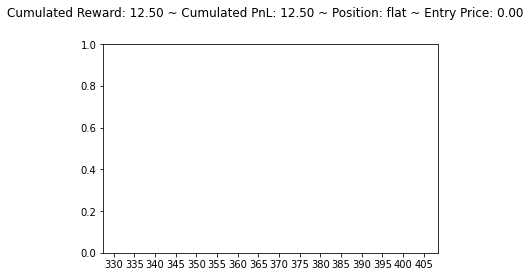

[1043.3202 1201.6017 1148.2242]
flat buy long


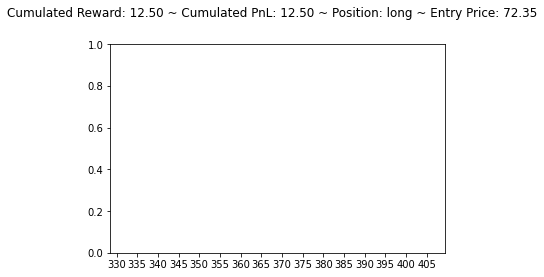

[1212.9116 1253.9141 1126.7786]
long hold long


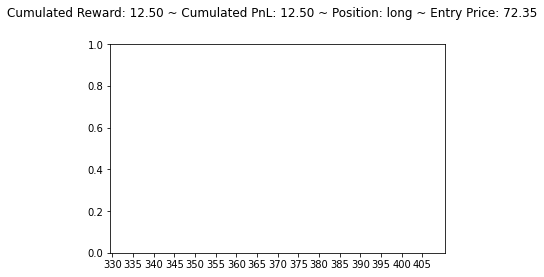

[1011.9809 1026.9576 1113.8767]
long sell flat


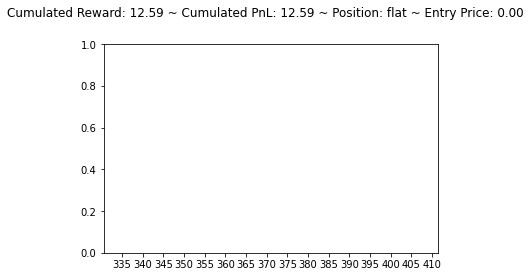

[1096.8937 1100.4236 1121.2422]
flat sell short


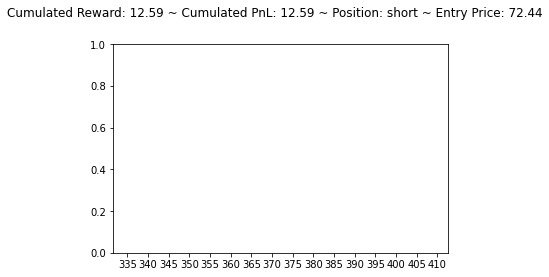

[1180.4673   923.1299   649.36304]
short hold short


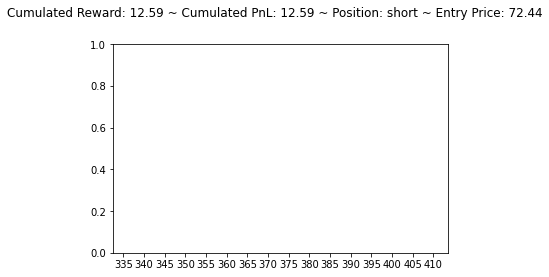

[242.95705 312.73914 216.60283]
short buy flat


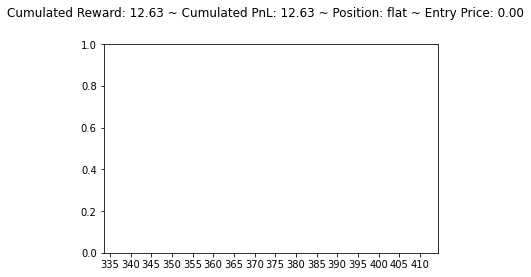

[170.12111 347.6304  276.78308]
flat buy long


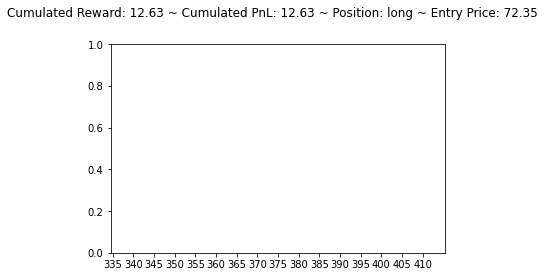

[195.66156 346.96332 262.98938]
long sell flat


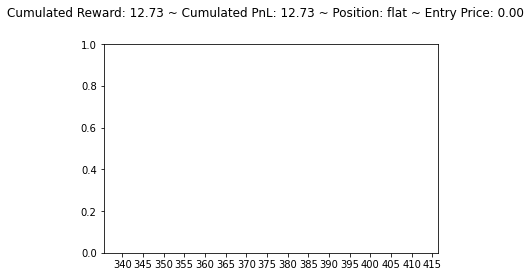

[106.99547 257.18945 170.23975]
flat buy long


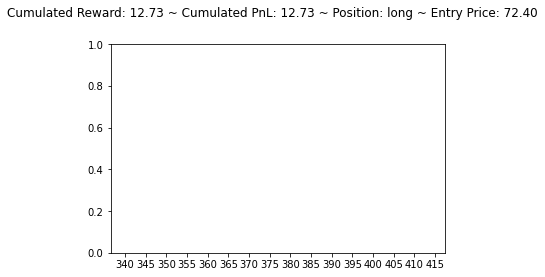

[130.12619 253.28824 235.07265]
long sell flat


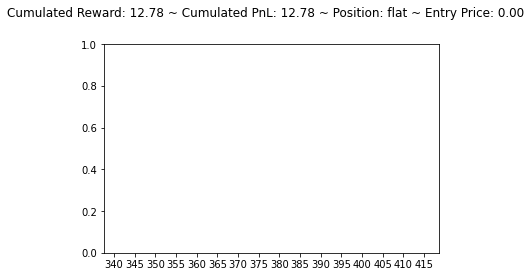

[1840.5148 2082.1572 1977.9076]
flat buy long


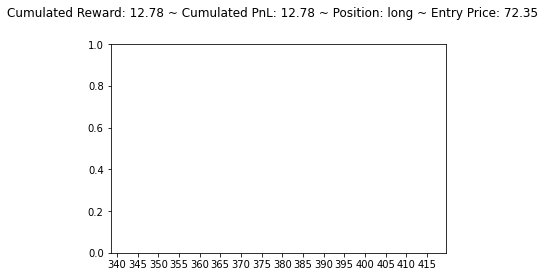

[1369.1562  695.7918 1373.8978]
long sell flat


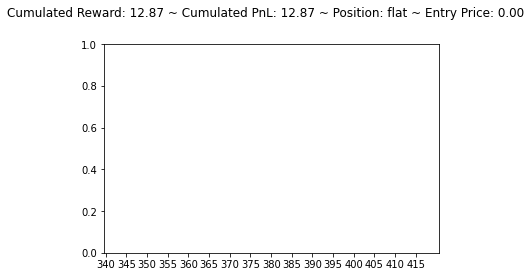

[1059.7946 1093.8698 1085.5114]
flat buy long


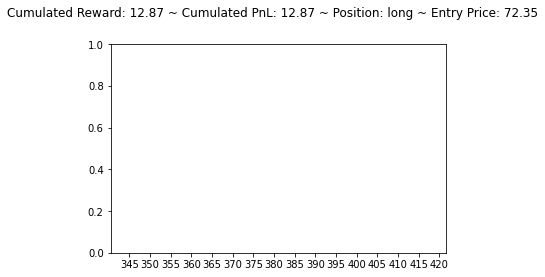

[1081.4277 1122.0278 1134.1519]
long sell flat


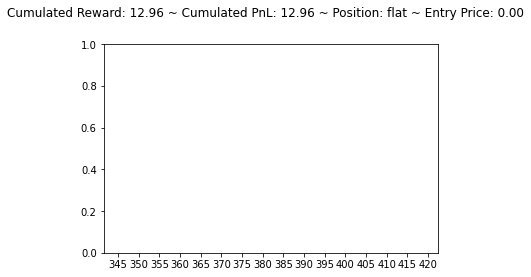

[1054.7184 1088.6428 1080.8468]
flat buy long


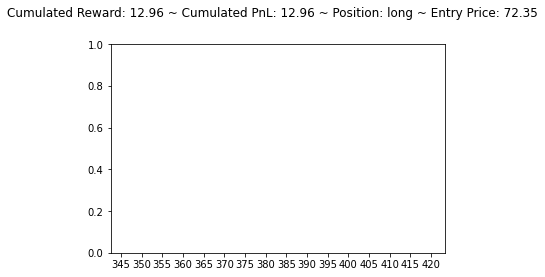

[1051.4366   977.0605   777.43866]
long hold long


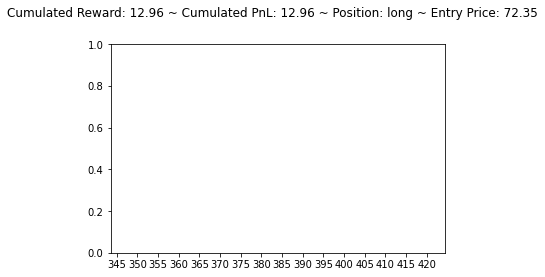

[1859.2999 2065.0022 2003.3324]
long sell flat


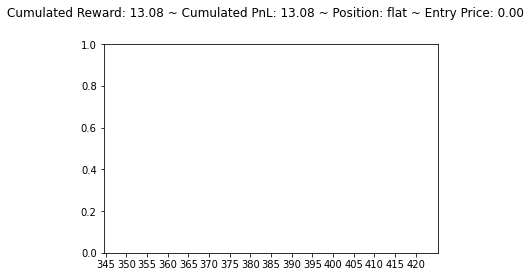

[2956.6506 2699.5151 3045.4873]
flat sell short


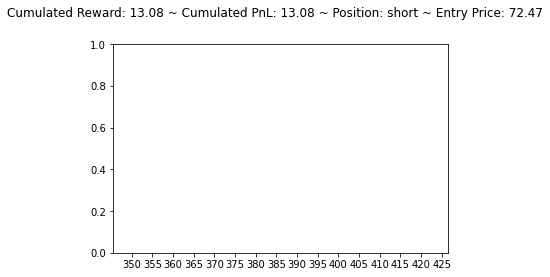

[2097.803   789.7161 1553.7462]
short hold short


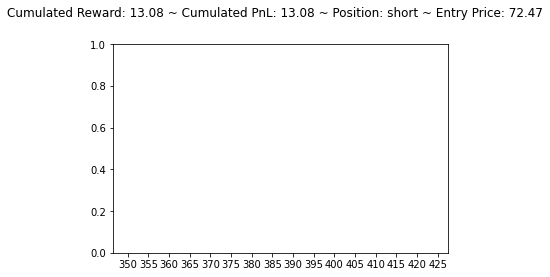

[1132.3628 1171.0948 1169.2633]
short buy flat


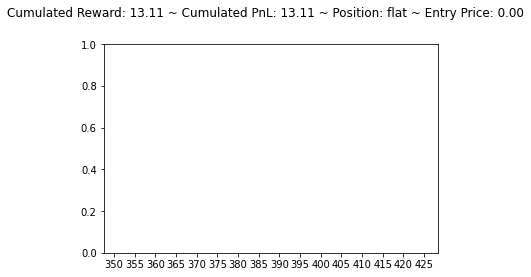

[1124.561  1168.3511 1128.3882]
flat buy long


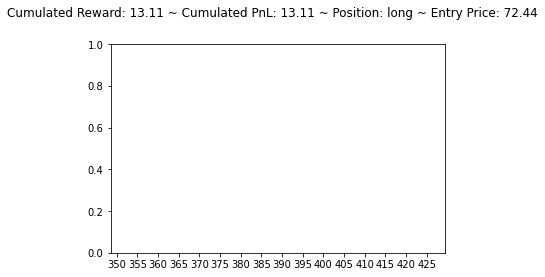

[2008.7114 1656.7312 2054.6199]
long sell flat


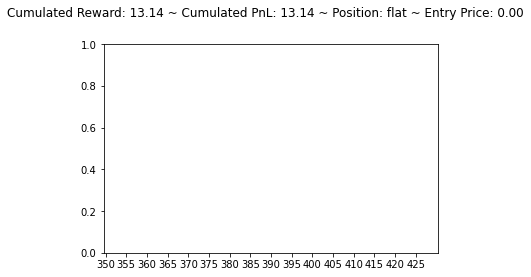

[1701.0532 1466.3403 1728.7926]
flat sell short


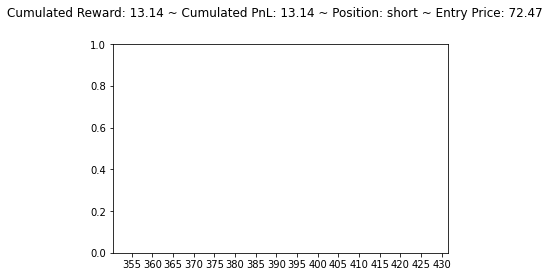

[1353.7524   770.56775  843.3226 ]
short hold short


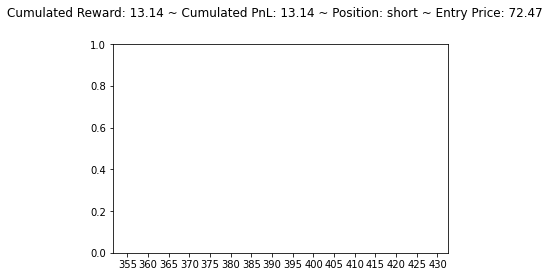

[524.24475 609.07117 572.51184]
short buy flat


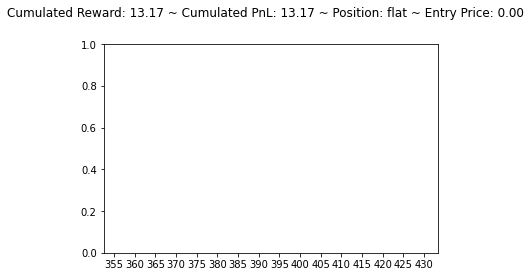

[471.82492 562.50867 511.93875]
flat buy long


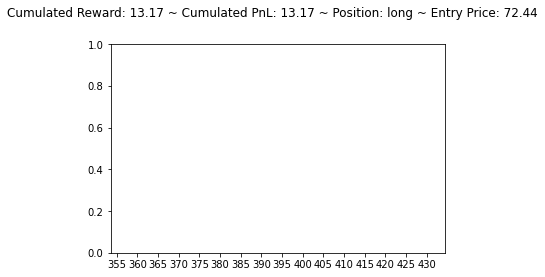

[525.7616  596.9566  560.84247]
long sell flat


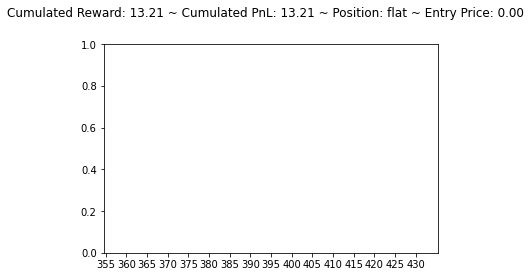

[501.91272 571.1423  514.5558 ]
flat buy long


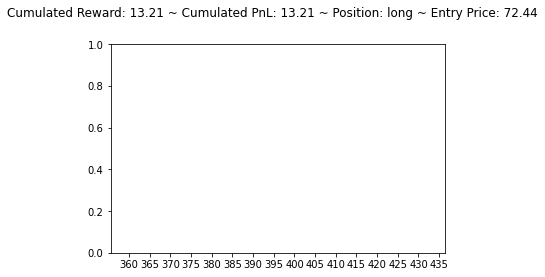

[541.0236 598.1485 564.1526]
long sell flat


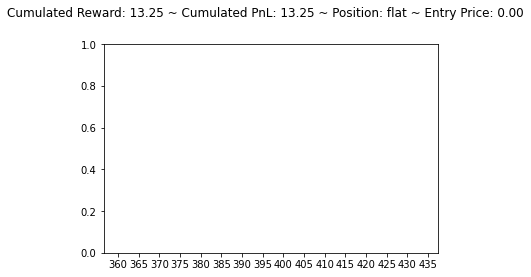

[535.3854 582.4309 526.5817]
flat buy long


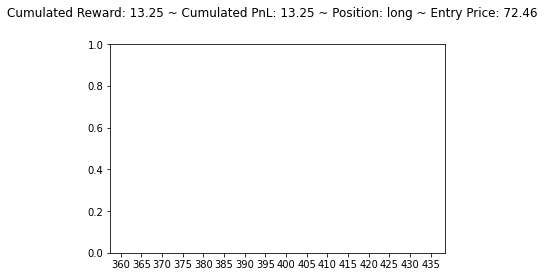

[481.7418  595.2648  552.51154]
long sell flat


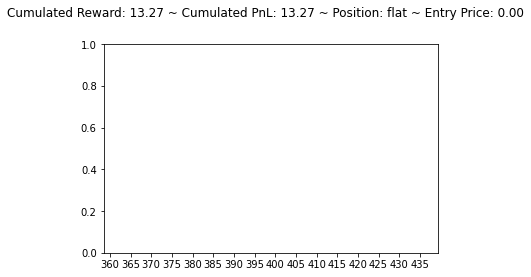

[411.86774 540.5605  403.5921 ]
flat buy long


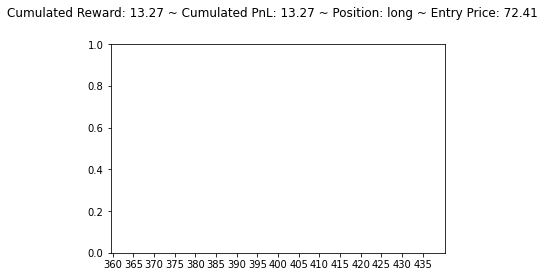

[578.89185 584.1887  513.2211 ]
long hold long


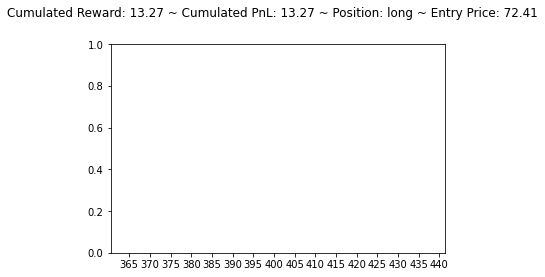

[466.35562 563.47754 544.16583]
long sell flat


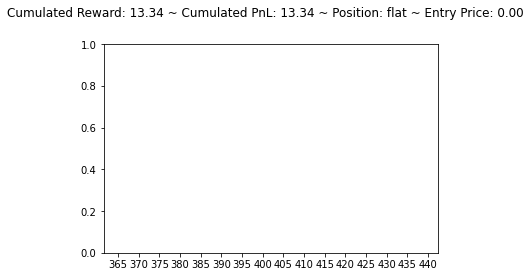

[435.8216  537.84064 485.18326]
flat buy long


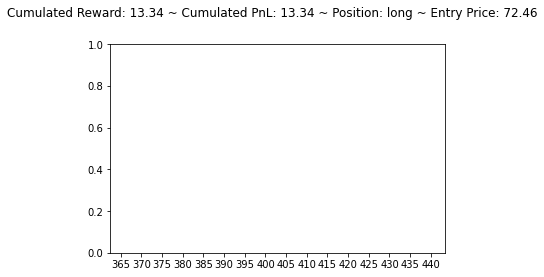

[465.48904 571.59326 539.46826]
long sell flat


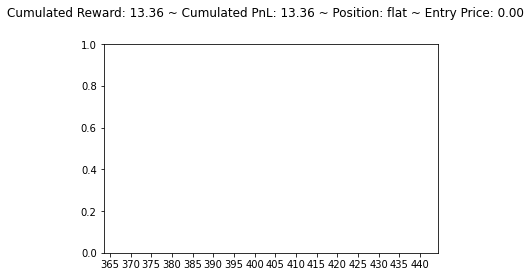

[451.33356 554.3241  493.67053]
flat buy long


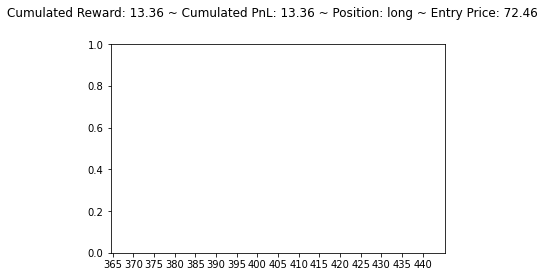

[1789.8519 1867.8059 1686.5995]
long hold long


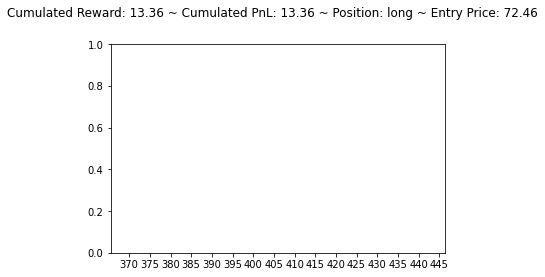

[1424.0488  855.0776  893.2681]
long hold long


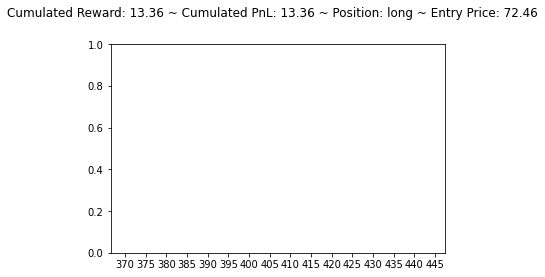

[480.16876 583.2783  539.3991 ]
long sell flat


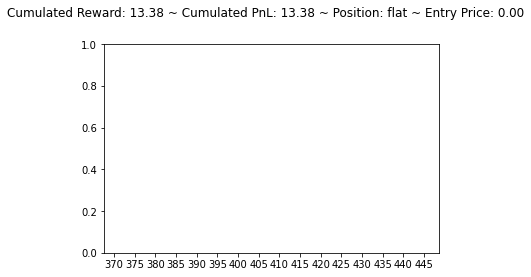

[439.44305 529.13684 474.59897]
flat buy long


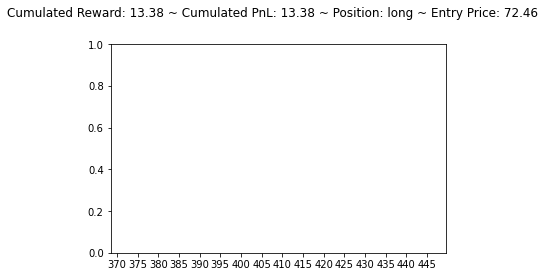

[449.59015 562.2146  517.3359 ]
long sell flat


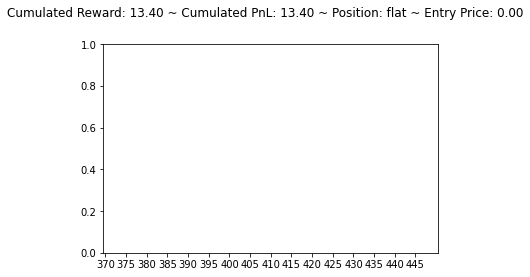

[421.54016 538.0647  463.65973]
flat buy long


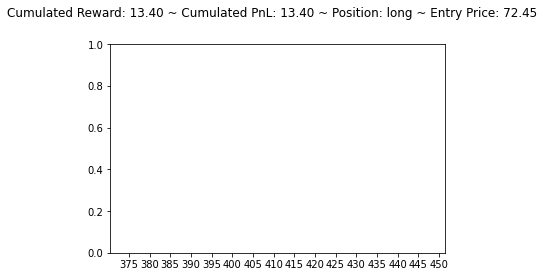

[455.62714 567.04517 524.5772 ]
long sell flat


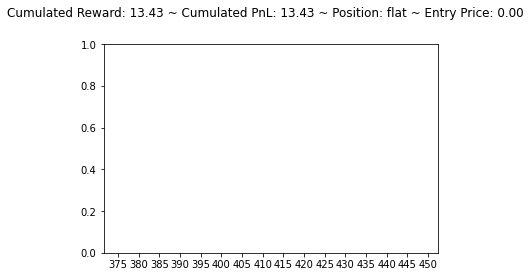

[435.94366 544.073   475.77084]
flat buy long


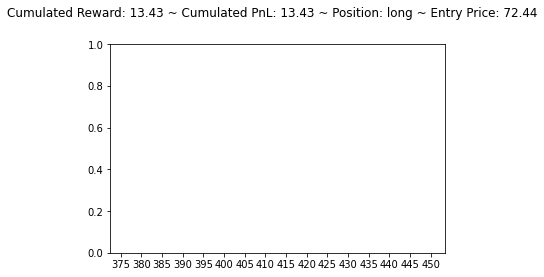

[394.66208 671.16254 738.43933]
long sell flat


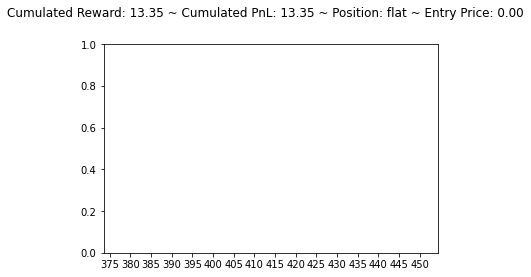

[294.76404 709.8194  539.53217]
flat buy long


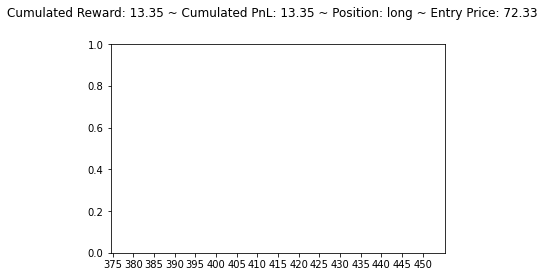

[420.18604 705.2115  632.5235 ]
long sell flat


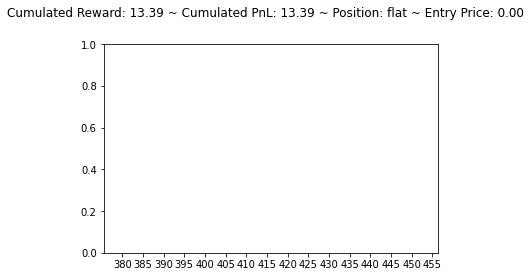

[376.02692 577.8551  487.17926]
flat buy long


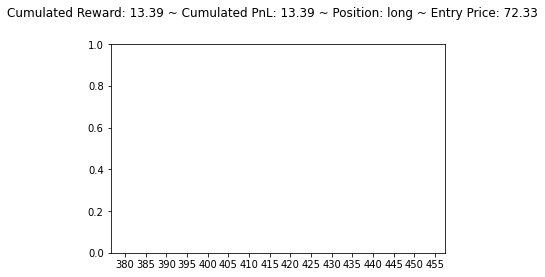

[513.9963 540.7044 517.939 ]
long sell flat


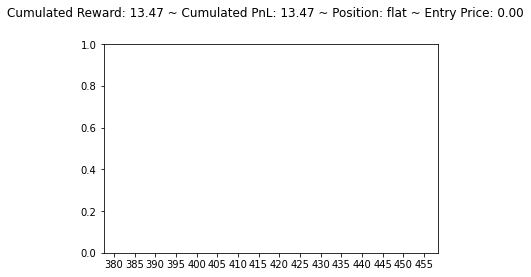

[384.48776 633.7665  525.0629 ]
flat buy long


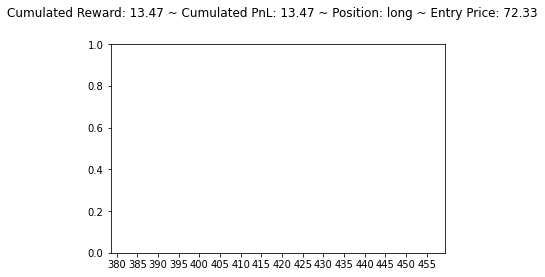

[471.36227 568.3905  536.0322 ]
long sell flat


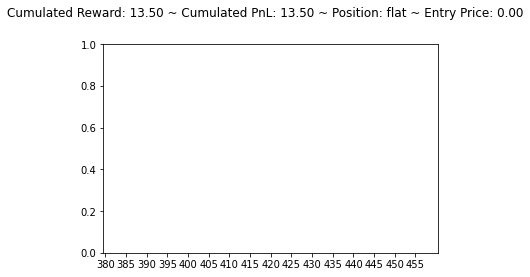

[316.27896 447.13437 375.06836]
flat buy long


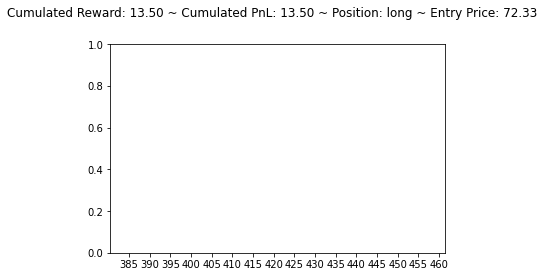

[1220.9026 1399.6362 1308.0876]
long sell flat


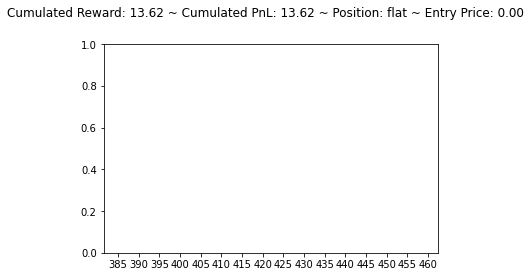

[1196.7926 1016.2676  959.8397]
flat hold flat


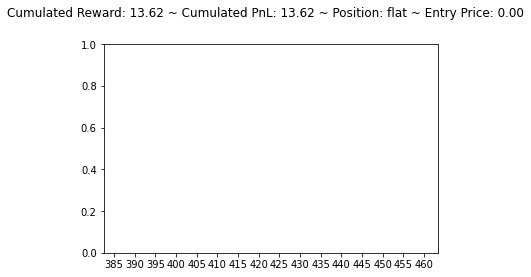

[309.60226 438.03506 399.86847]
flat buy long


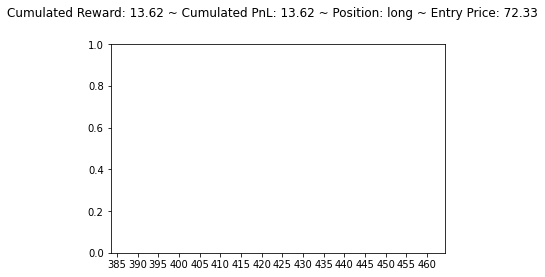

[337.96295 471.74313 465.6964 ]
long sell flat


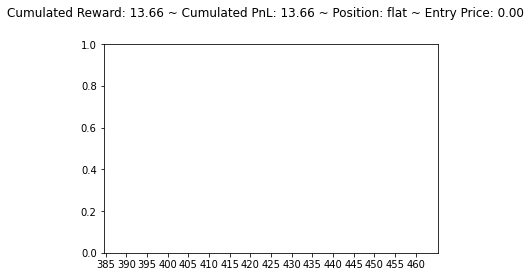

[307.23047 489.4769  444.08832]
flat buy long


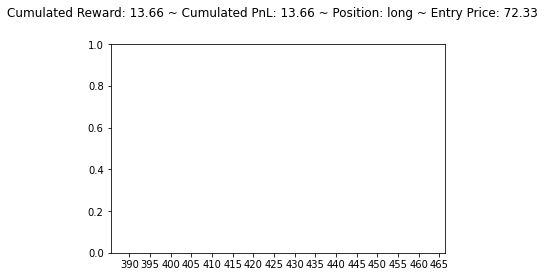

[269.11722 491.899   497.02603]
long sell flat


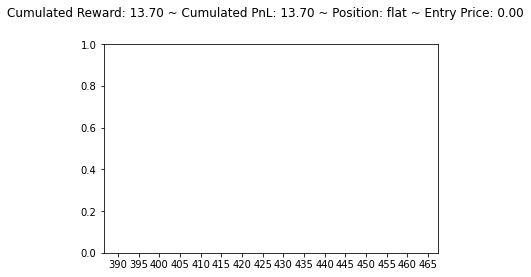

[225.18512 531.9914  342.788  ]
flat buy long


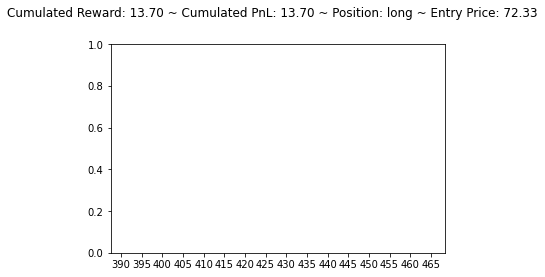

[296.93512 452.9379  337.4968 ]
long sell flat


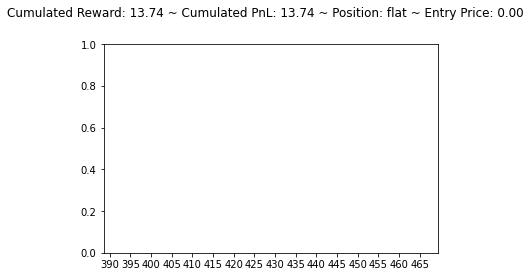

[257.18384 350.5376  275.75137]
flat buy long


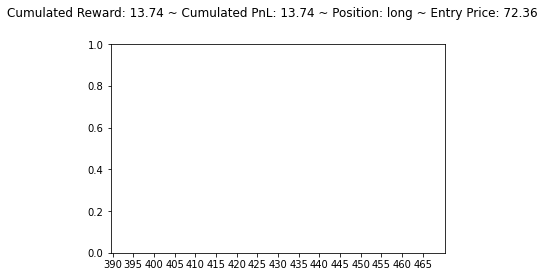

[618.95056 457.84857 560.54926]
long hold long


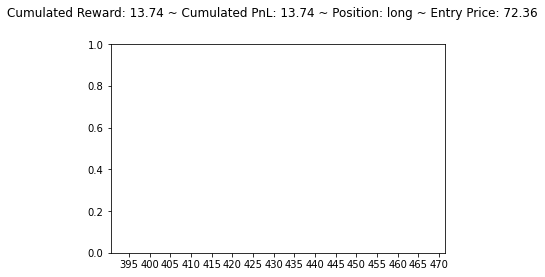

[340.09515 344.7828  357.76605]
long sell flat


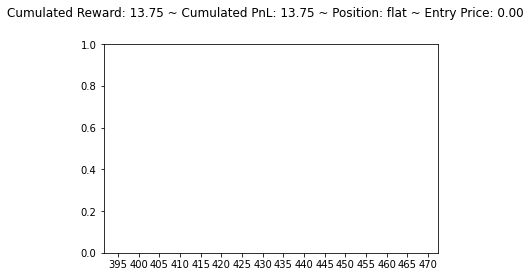

[286.16132 478.0716  529.4048 ]
flat sell short


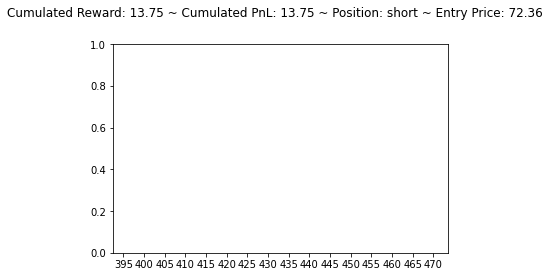

[318.46387 536.3651  422.1966 ]
short buy flat


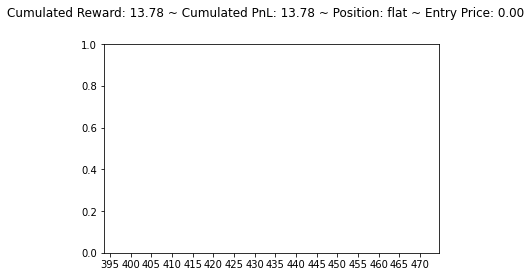

[480.1551  440.8555  496.56107]
flat sell short


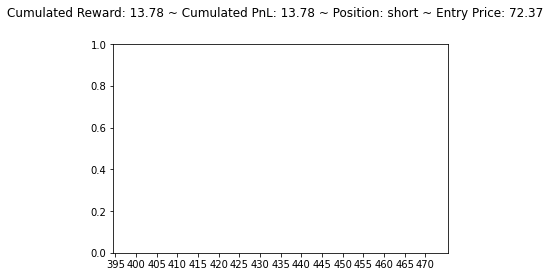

[309.50604 412.9006  293.01648]
short buy flat


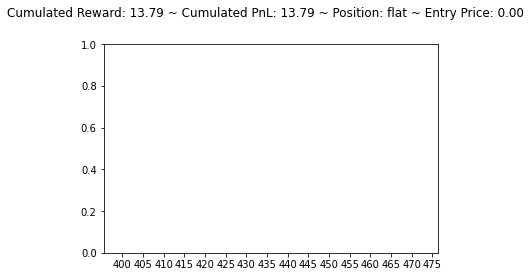

[123.11809 282.87906 232.92082]
flat buy long


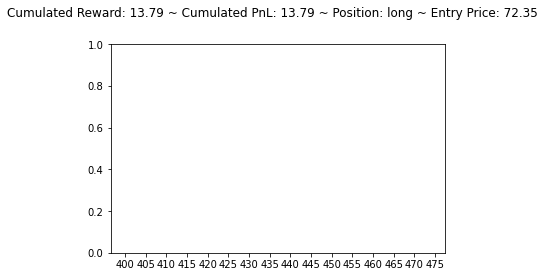

[156.62085 239.7052  161.84645]
long sell flat


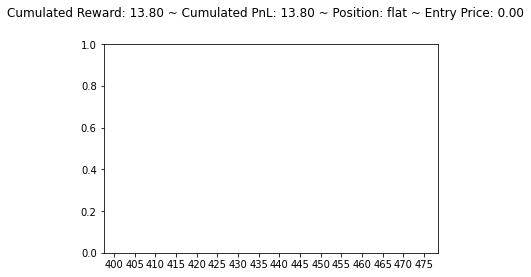

[200.28569 376.29474 397.8738 ]
flat sell short


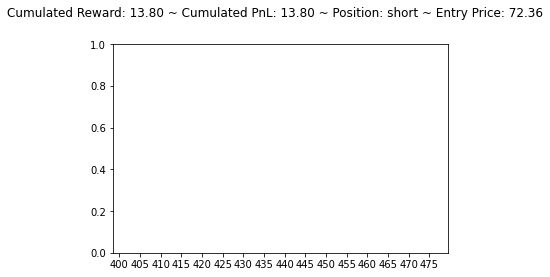

[176.15128 369.5475  403.68103]
short buy flat


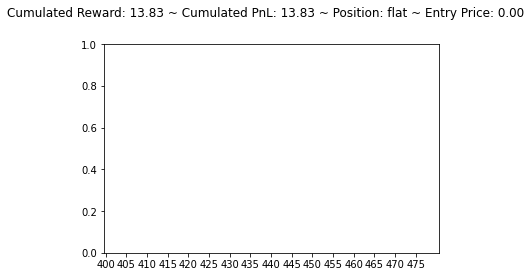

[325.32935 367.64645 354.52765]
flat buy long


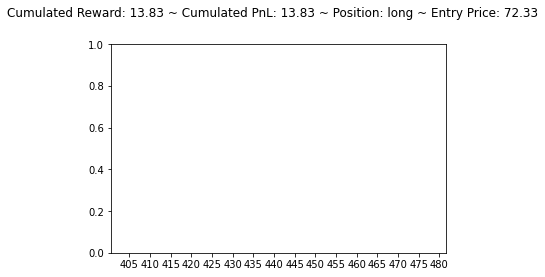

[345.64743 607.6825  503.33047]
long sell flat


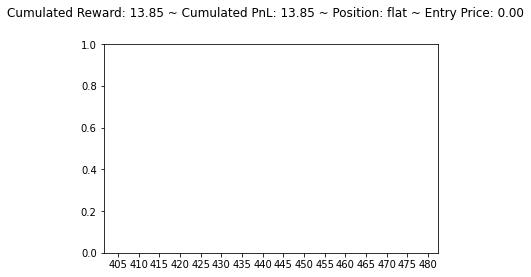

[465.5362  503.80658 427.9132 ]
flat buy long


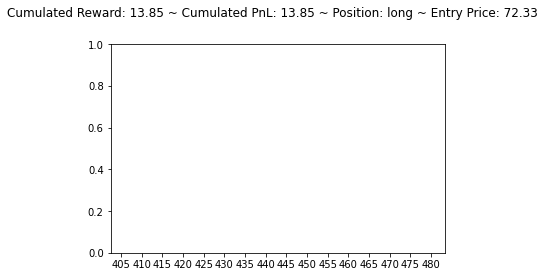

[354.8899 550.3413 524.466 ]
long sell flat


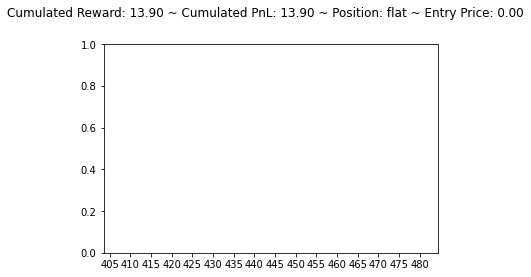

[293.9803  705.6611  524.68414]
flat buy long


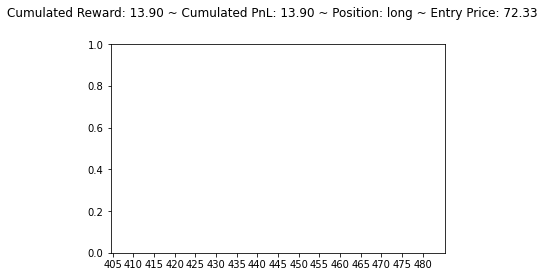

[401.83752 677.9895  613.55206]
long sell flat


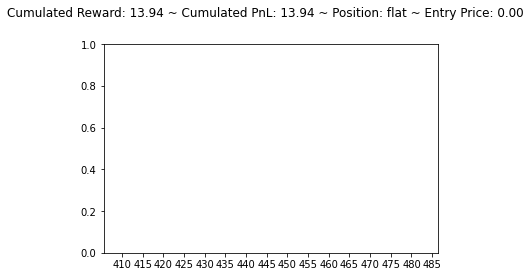

[438.10562 567.403   507.9764 ]
flat buy long


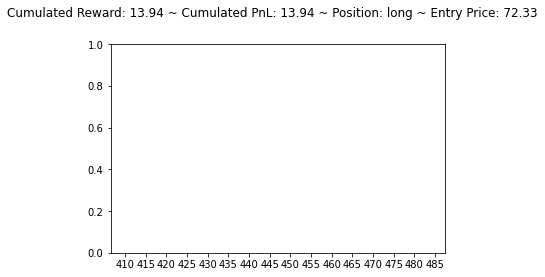

[467.1898 536.7689 517.1114]
long sell flat


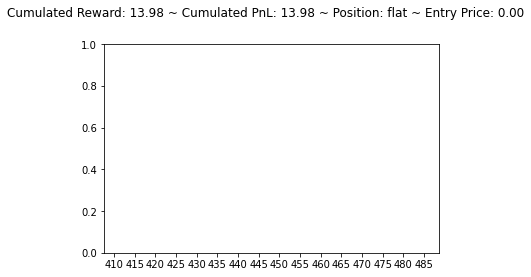

[398.8316  536.35547 496.17642]
flat buy long


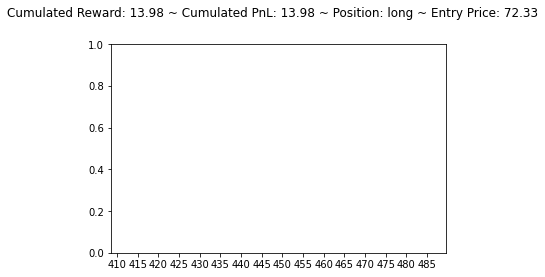

[379.90613 676.75757 591.0944 ]
long sell flat


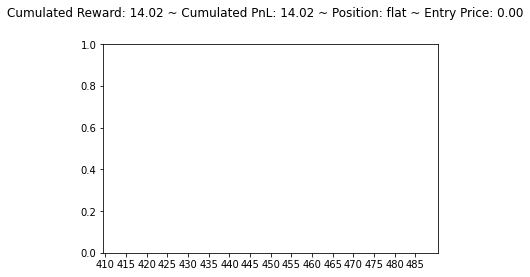

[308.22235 598.70935 477.82242]
flat buy long


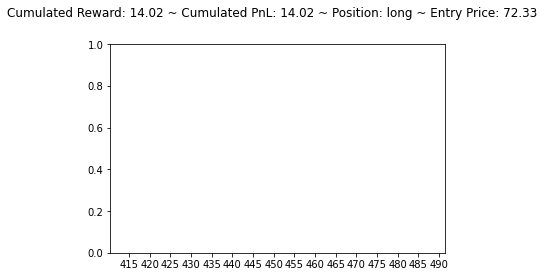

[292.6311  397.1154  466.72083]
long sell flat


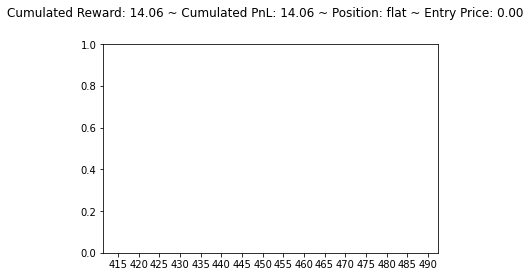

[348.12234 519.44293 453.81458]
flat buy long


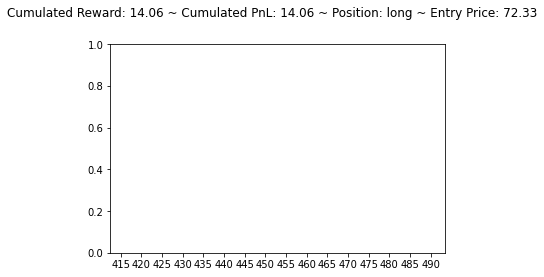

[344.7094  421.65256 499.8214 ]
long sell flat


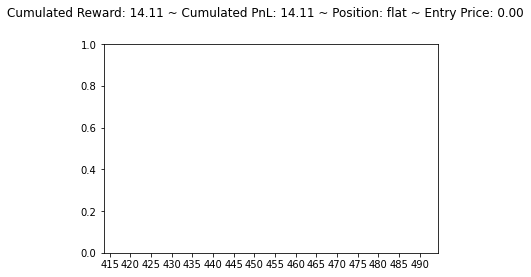

[385.0735  539.39996 477.39285]
flat buy long


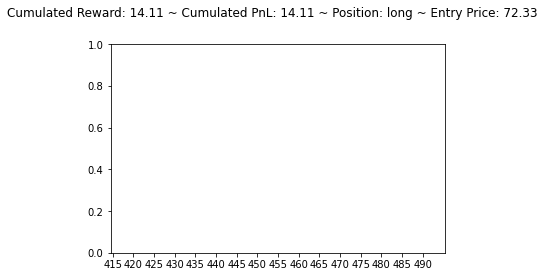

[486.75037 625.0346  531.46704]
long sell flat


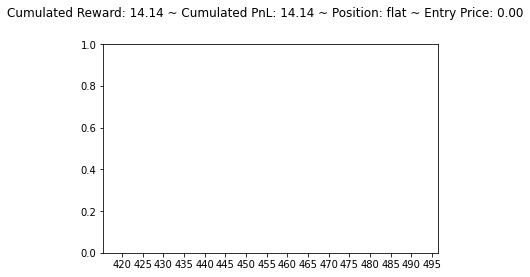

[488.21896 585.5077  523.77625]
flat buy long


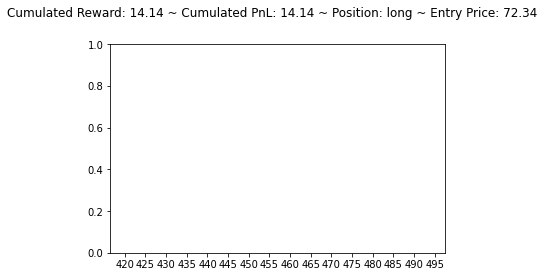

[504.89844 615.3726  575.2856 ]
long sell flat


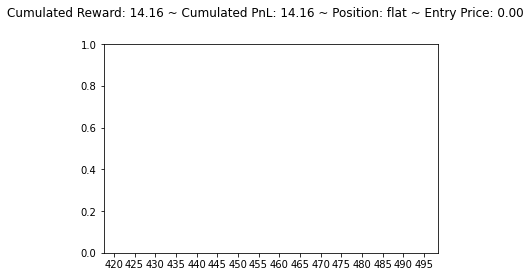

[474.34607 572.02136 519.9683 ]
flat buy long


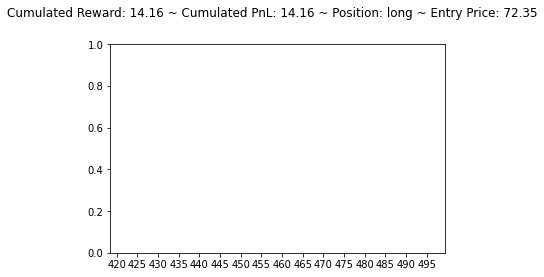

[490.9229 595.9834 567.3084]
long sell flat


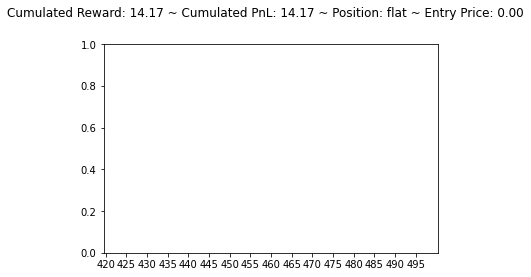

[498.40552 660.03503 527.6104 ]
flat buy long


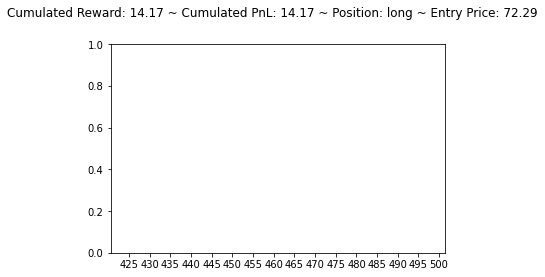

[580.7832  674.55023 641.90814]
long sell flat


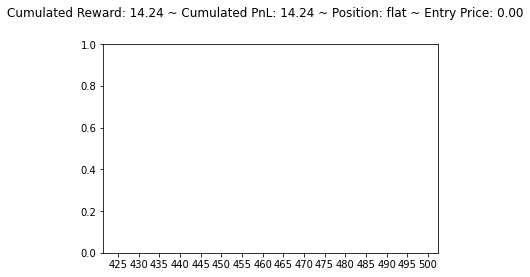

[829.135  815.6809 828.5982]
flat hold flat


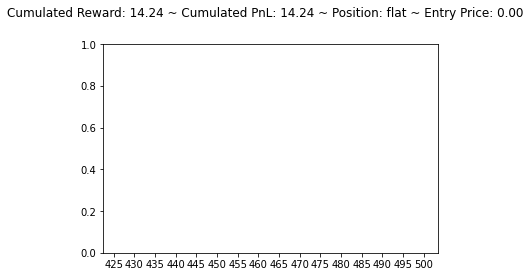

[688.3386  714.8878  717.53064]
flat sell short


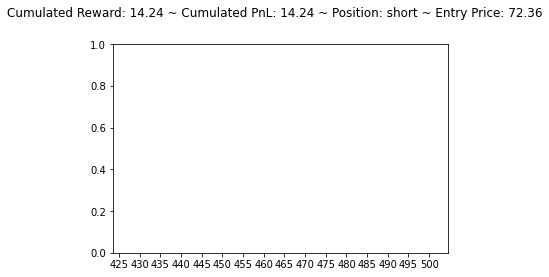

[582.25183 548.76184 605.13116]
short hold short


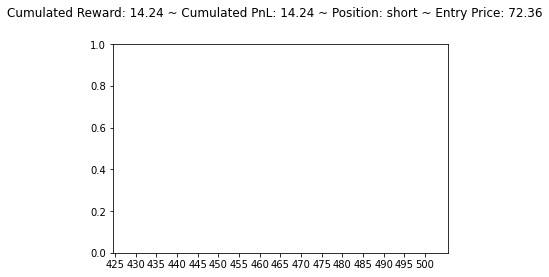

[637.43774 694.91675 638.3396 ]
short buy flat


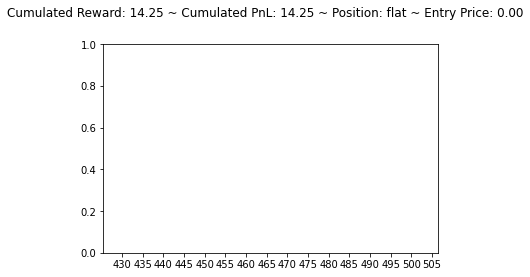

[495.92676 496.86258 565.8219 ]
flat sell short


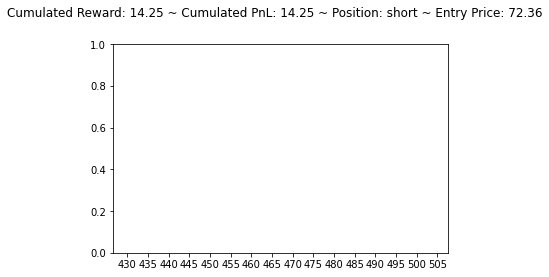

[423.08643 510.13052 522.882  ]
short buy flat


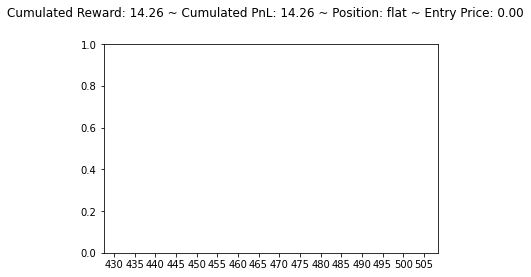

[313.86127 492.9112  409.96722]
flat buy long


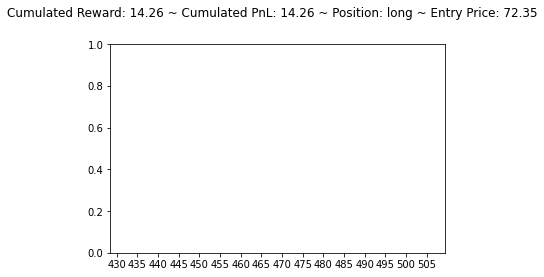

[329.4227  531.2882  416.47296]
long sell flat


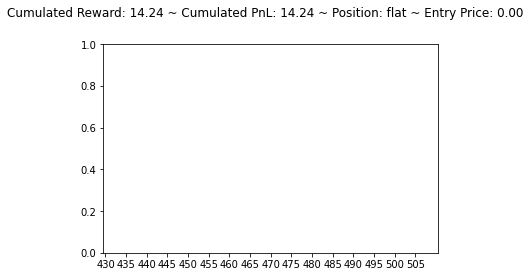

[450.8448  470.81458 358.92834]
flat buy long


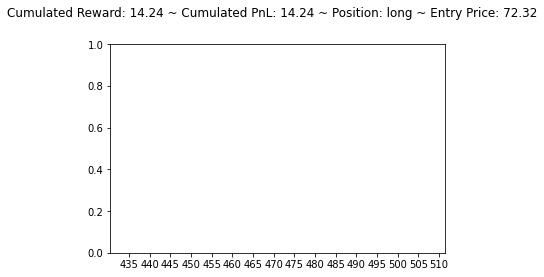

[390.71625 508.21133 445.6313 ]
long sell flat


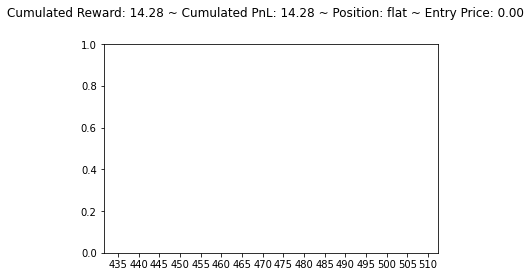

[362.65732 455.8103  388.75037]
flat buy long


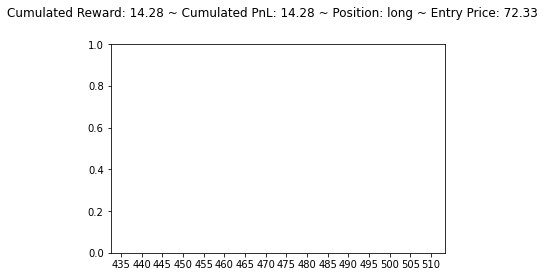

[345.86176 437.60843 390.49457]
long sell flat


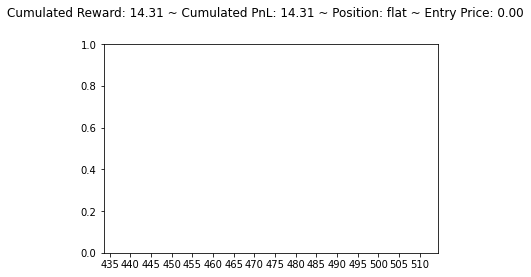

[338.6724  430.75842 351.72516]
flat buy long


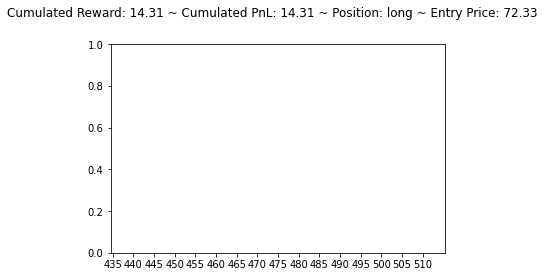

[292.60052 394.75497 292.8635 ]
long sell flat


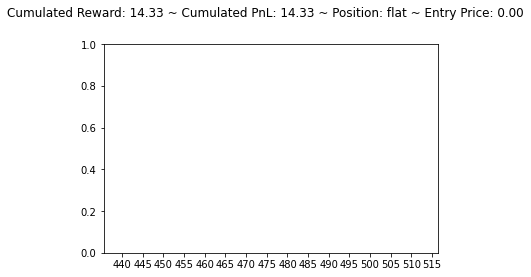

[286.15915 493.43875 295.55515]
flat buy long


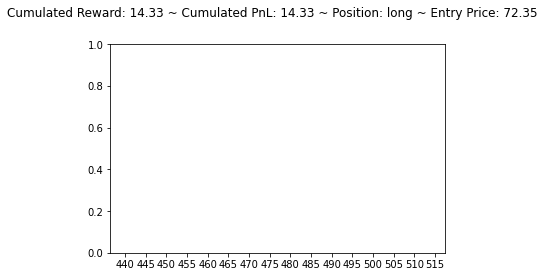

[563.4834  568.8066  549.49536]
long hold long


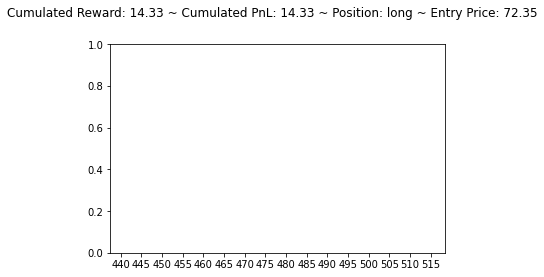

[472.30753 586.00946 541.73047]
long sell flat


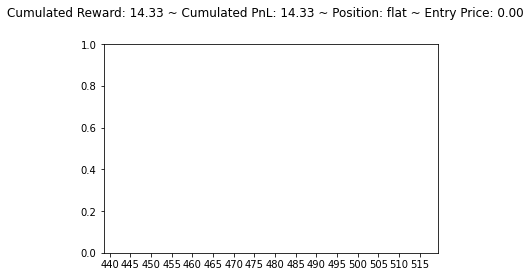

[442.06116 545.4829  486.74612]
flat buy long


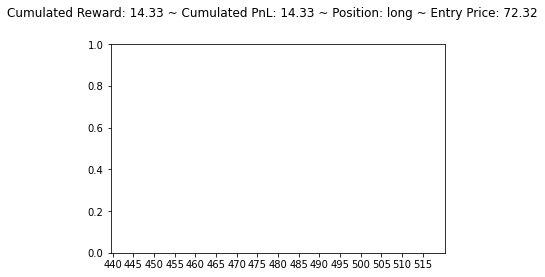

[579.1115  651.13983 584.16046]
long sell flat


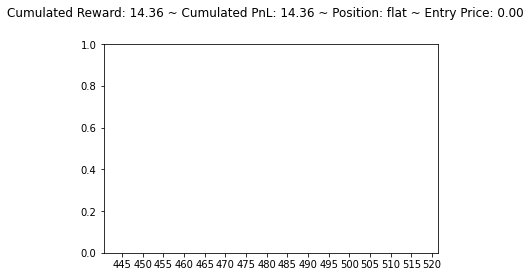

flat hold flat


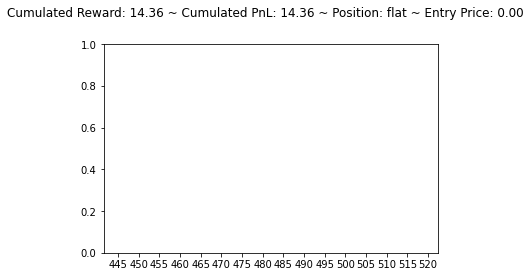

[484.29736 541.4057  536.6053 ]
flat buy long


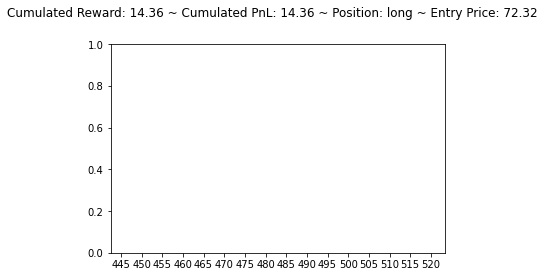

[478.88586 586.7422  552.5429 ]
long sell flat


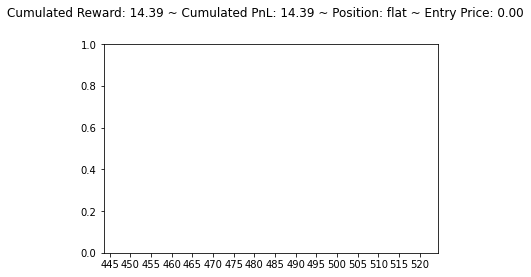

[461.12756 560.6874  504.493  ]
flat buy long


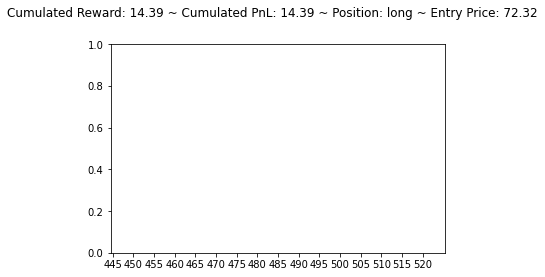

[476.20233 585.40845 551.168  ]
long sell flat


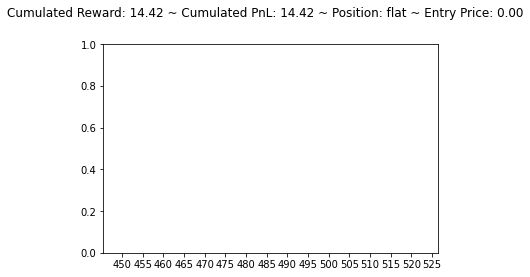

[452.11926 550.4673  499.48672]
flat buy long


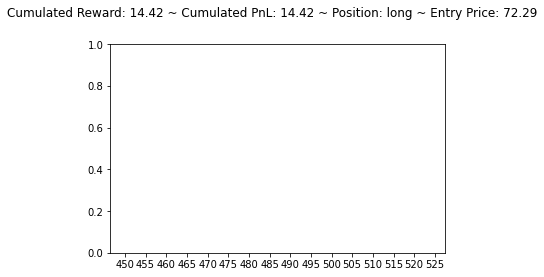

[465.11758 566.0199  452.13284]
long hold long


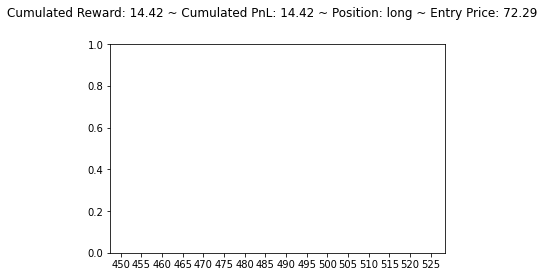

[179.19475 384.07022 338.9535 ]
long sell flat


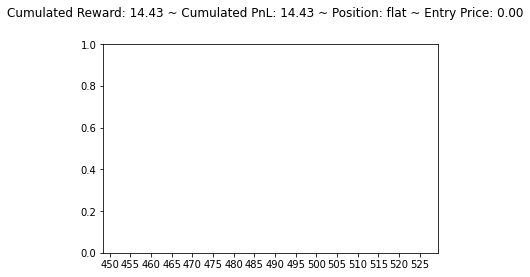

[530.79254 577.95953 493.90802]
flat buy long


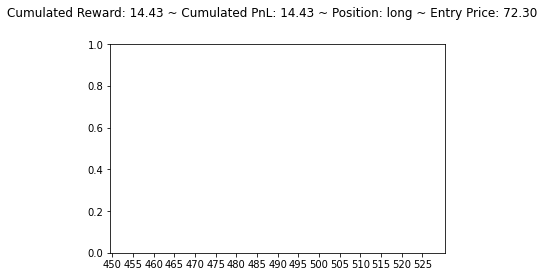

[452.37506 498.62497 541.708  ]
long sell flat


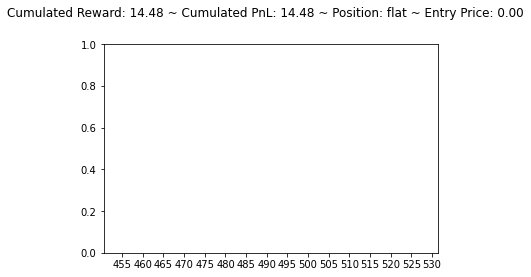

[396.3768  503.1494  445.11227]
flat buy long


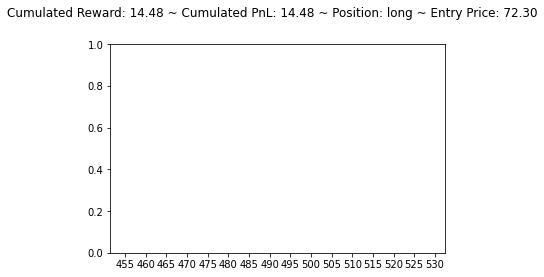

[401.47964 472.0317  488.61295]
long sell flat


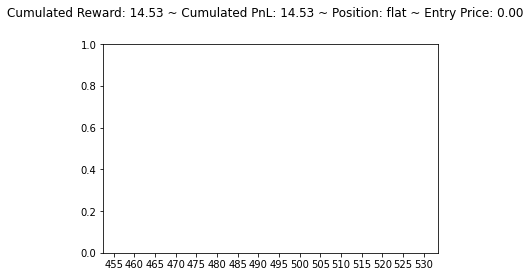

[355.165   465.93387 405.97015]
flat buy long


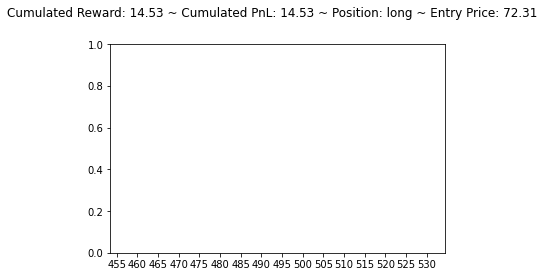

[361.48923 505.15558 414.08344]
long sell flat


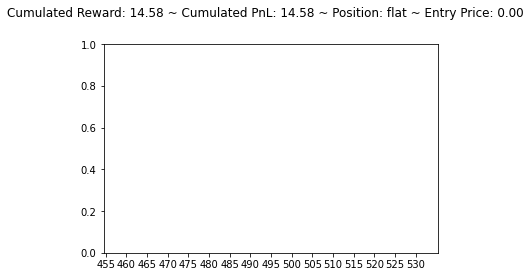

[186.31346 351.37936 297.809  ]
flat buy long


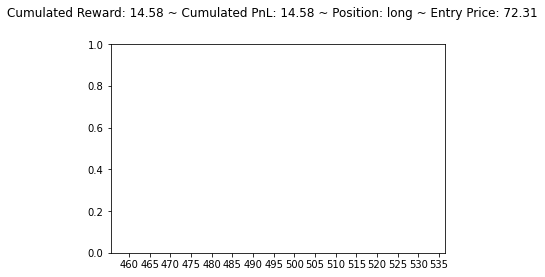

[240.46912 409.3362  262.09302]
long sell flat


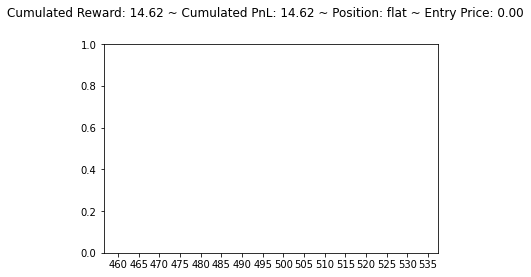

[203.69397 337.27652 273.19702]
flat buy long


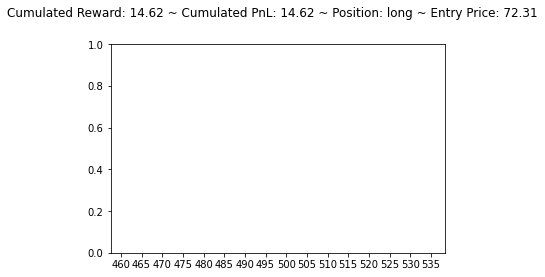

[476.14423 504.75668 416.06354]
long hold long


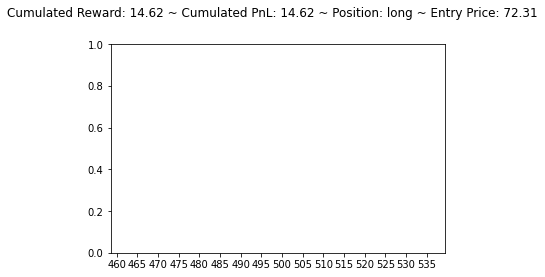

[392.5536  508.95255 466.98178]
long sell flat


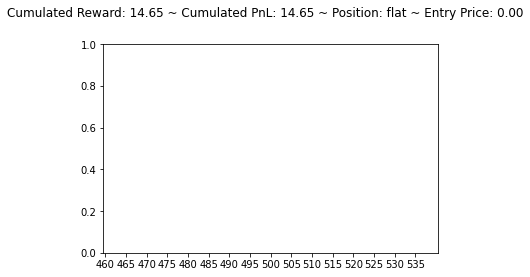

[357.37415 445.3722  411.04367]
flat buy long


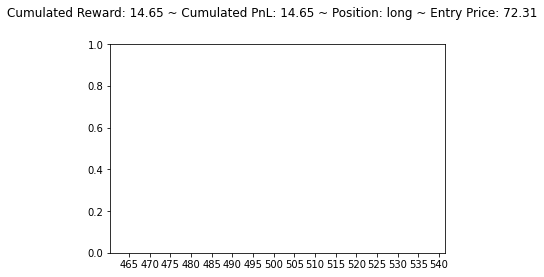

[477.3266  559.3027  499.67032]
long sell flat


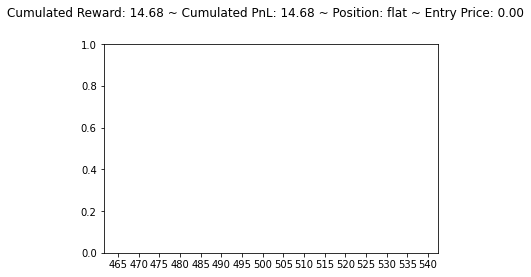

[412.6554  520.45154 454.2595 ]
flat buy long


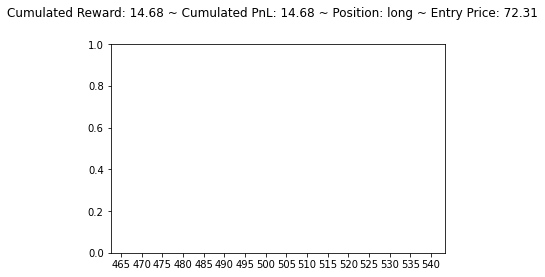

[434.38226 550.54443 504.45947]
long sell flat


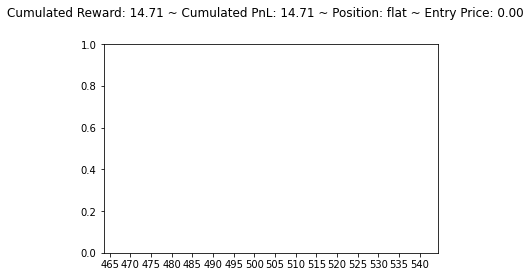

[411.42468 519.7953  453.62527]
flat buy long


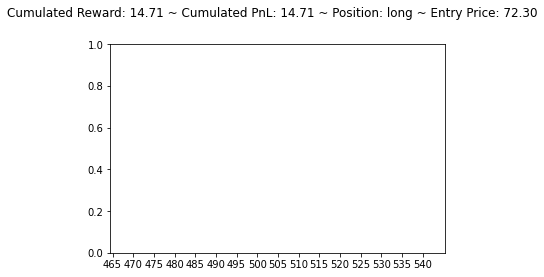

[415.63672 532.1722  494.31332]
long sell flat


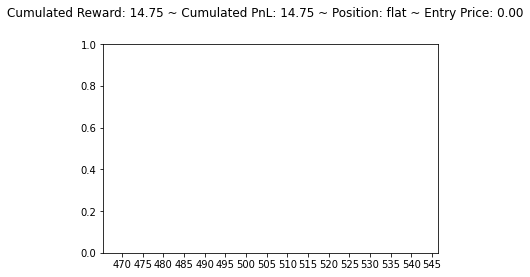

[380.81512 484.04105 436.6555 ]
flat buy long


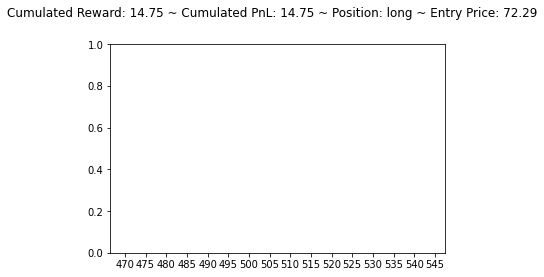

[412.20087 520.6762  491.87326]
long sell flat


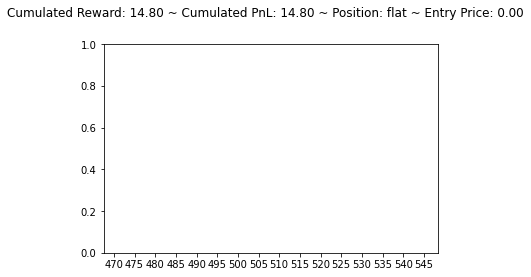

[401.53827 528.61536 446.7987 ]
flat buy long


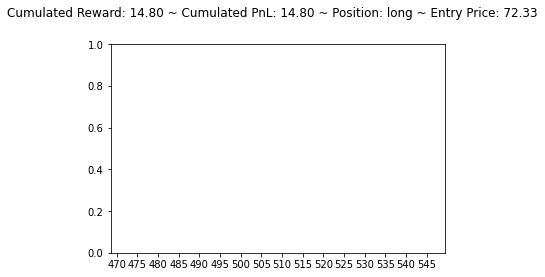

[415.29822 507.22485 356.8391 ]
long hold long


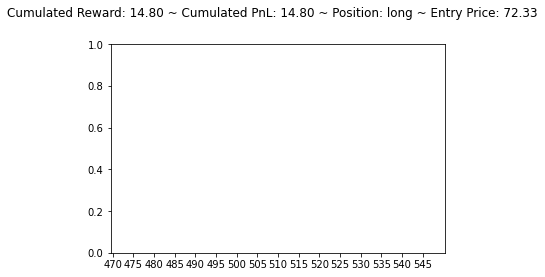

[239.32863 346.76837 267.02243]
long sell flat


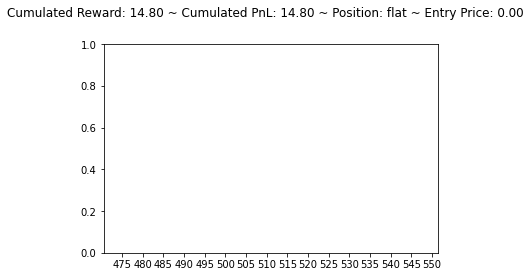

[191.14594 319.6387  241.82372]
flat buy long


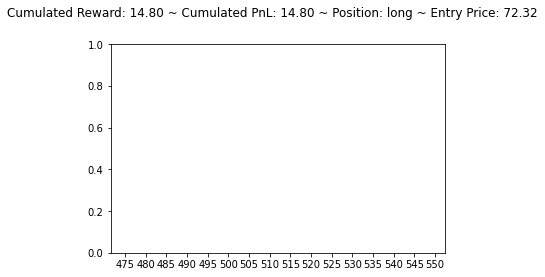

[221.98242 416.15643 378.2762 ]
long sell flat


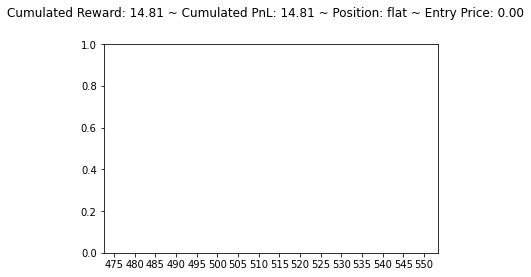

[549.34296 480.83142 455.0247 ]
flat hold flat


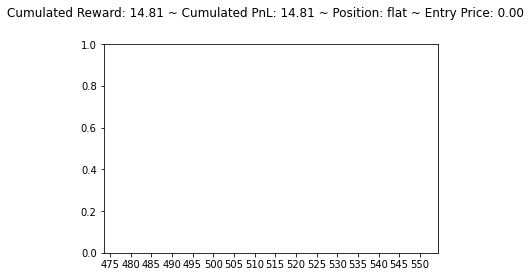

[436.0032  543.4106  470.77594]
flat buy long


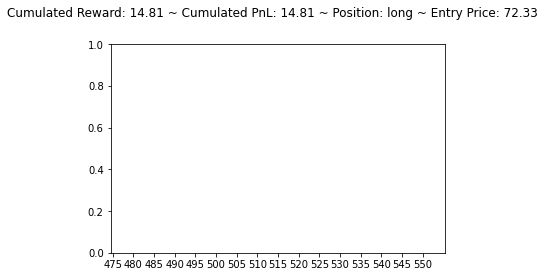

[407.57297 525.92615 498.91373]
long sell flat


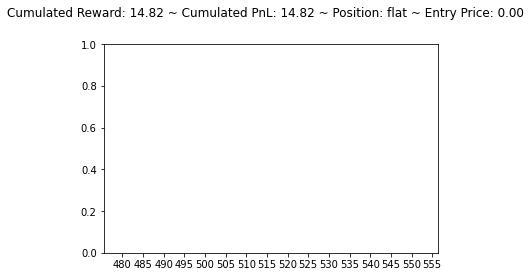

[347.96796 444.85495 443.29932]
flat buy long


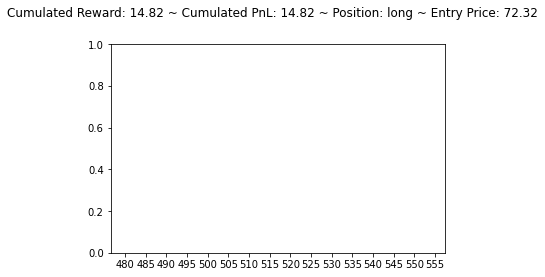

[374.375   471.64365 472.5729 ]
long sell flat


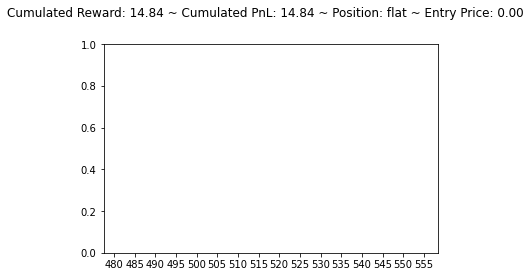

[367.17084 464.73715 430.86075]
flat buy long


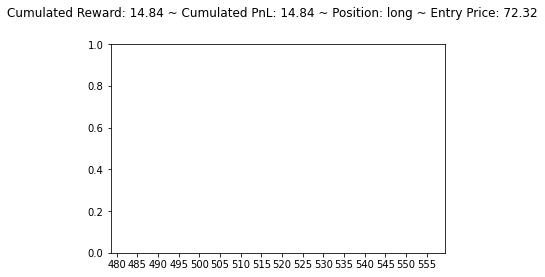

[398.86743 504.19446 486.42902]
long sell flat


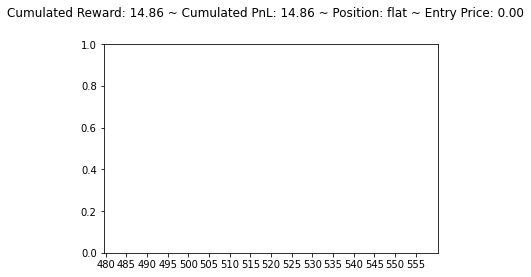

[363.8403  542.559   451.33493]
flat buy long


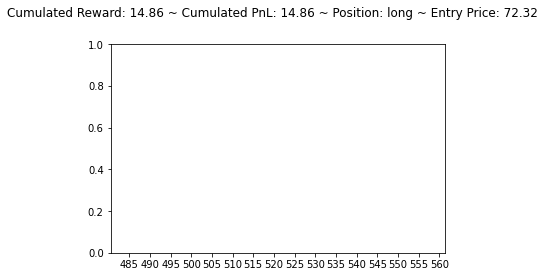

[241.90138 422.90527 349.46112]
long sell flat


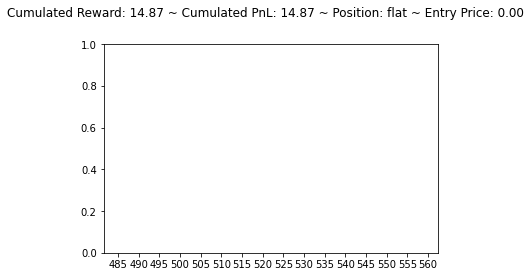

[205.89758 366.50784 289.2092 ]
flat buy long


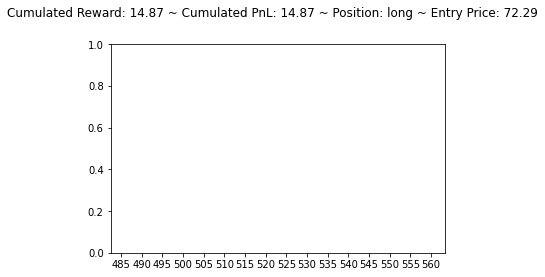

[202.53116 391.55136 326.29175]
long sell flat


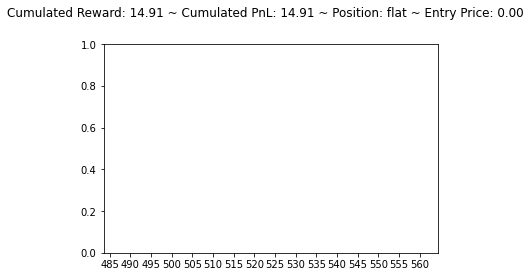

[186.5753  337.26248 263.77164]
flat buy long


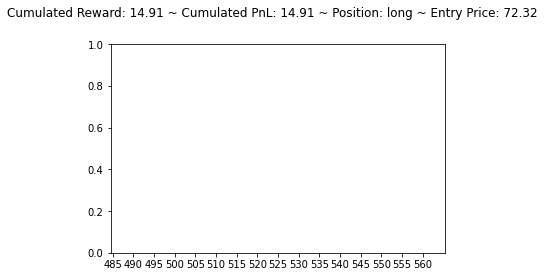

[209.77332 402.32614 355.2662 ]
long sell flat


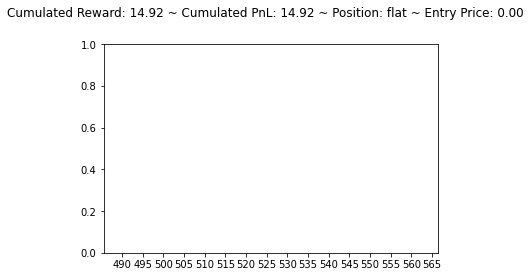

[230.75087 415.0957  249.08394]
flat buy long


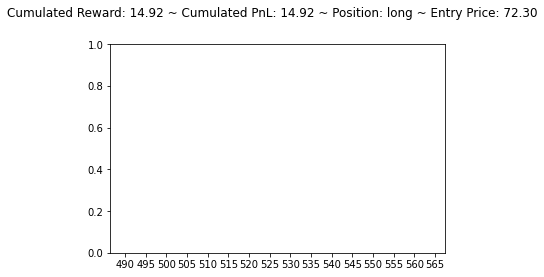

[282.48404 454.7617  451.7536 ]
long sell flat


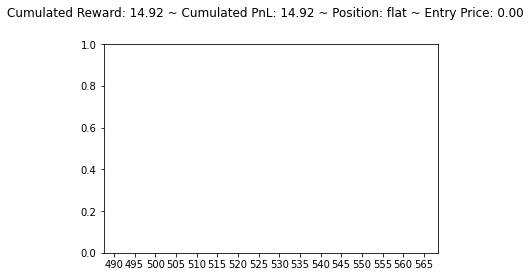

[187.60478 336.7325  186.09659]
flat buy long


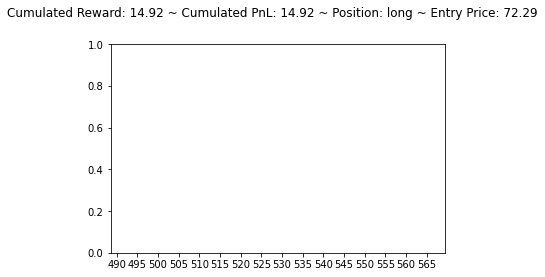

[139.95619 344.5078  267.48798]
long sell flat


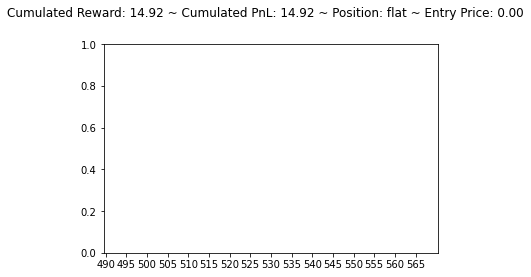

[199.64243 363.50748 342.14227]
flat buy long


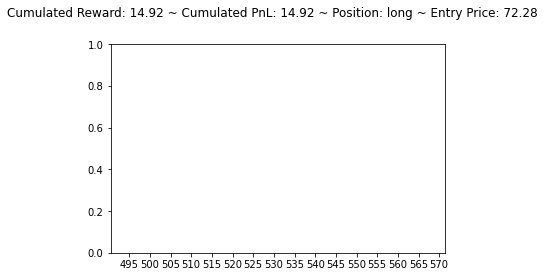

[222.63374 455.88776 343.34048]
long sell flat


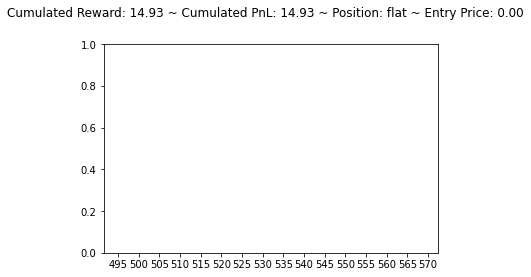

[185.66444 349.76523 271.3024 ]
flat buy long


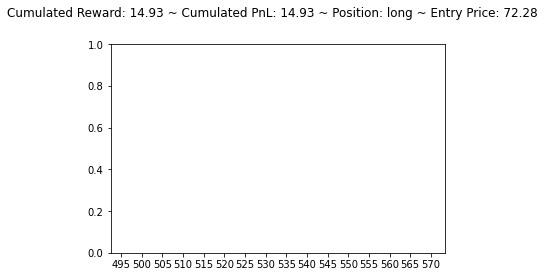

[194.84474 387.10336 317.0086 ]
long sell flat


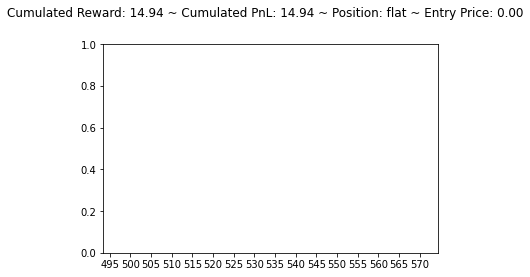

[213.01535 439.66037 310.24557]
flat buy long


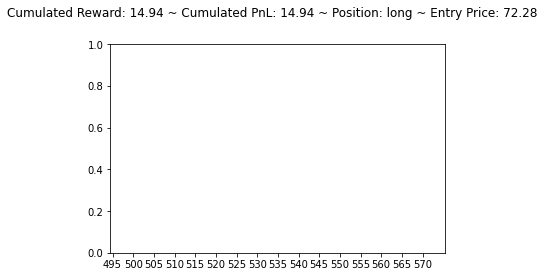

[262.64984 461.4151  376.5537 ]
long sell flat


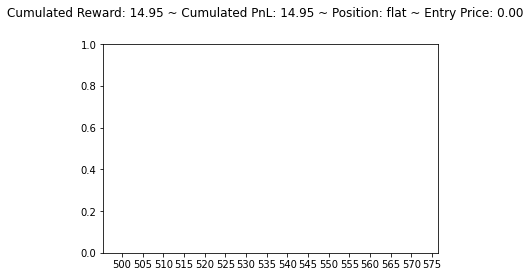

[206.18922 316.29248 218.04921]
flat buy long


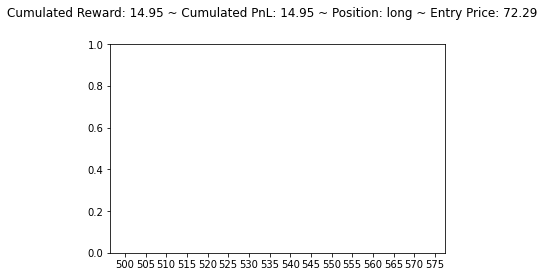

[132.11246 355.47266 278.58054]
long sell flat


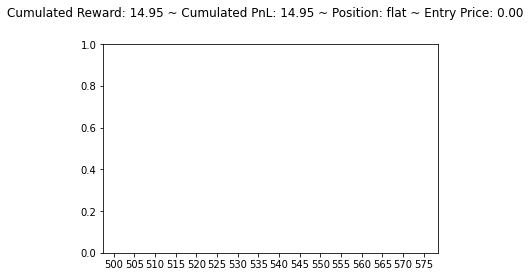

[292.76007 416.95328 358.28183]
flat buy long


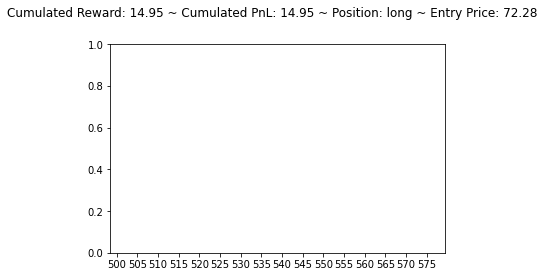

[317.00812 463.73587 437.7054 ]
long sell flat


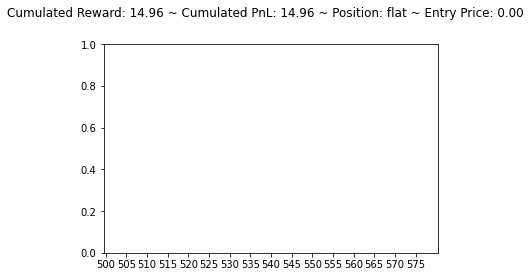

[364.5417  500.72208 419.88293]
flat buy long


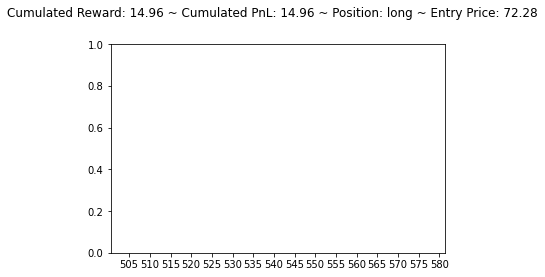

[368.91098 506.75604 464.74908]
long sell flat


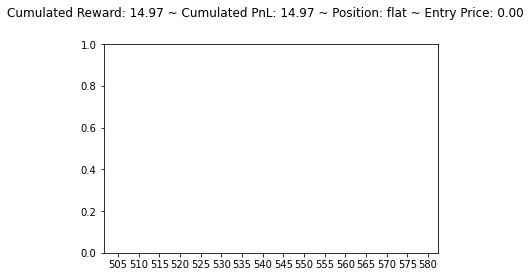

[273.27026 446.48685 467.6993 ]
flat sell short


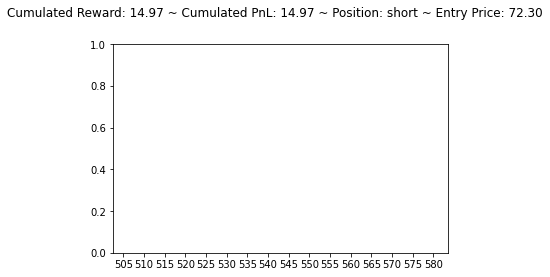

[367.2149  576.7053  456.35294]
short buy flat


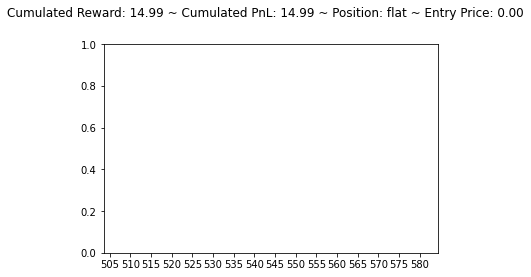

[322.28708 471.8671  437.40753]
flat buy long


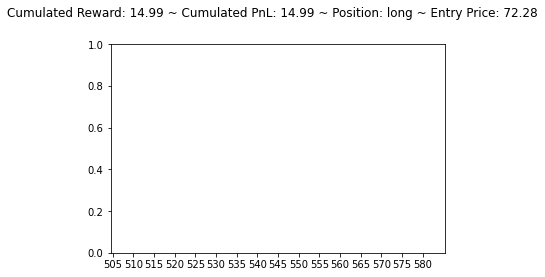

[316.558   544.0088  493.28754]
long sell flat


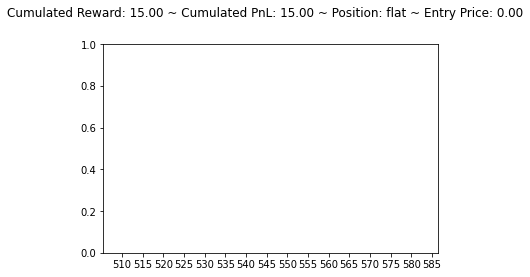

[290.37247 487.9984  448.58884]
flat buy long


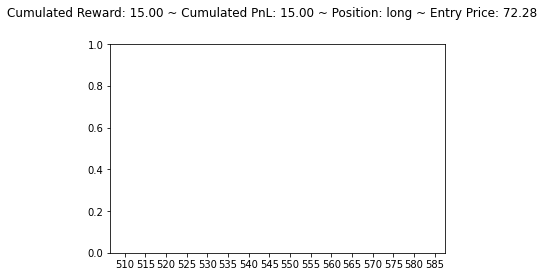

[270.01898 507.37384 528.42303]
long sell flat


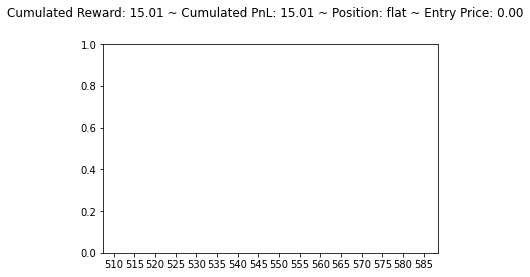

[205.2215  358.4563  344.44635]
flat buy long


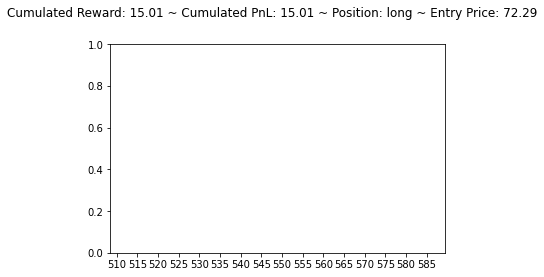

[123.295494 342.72025  316.33603 ]
long sell flat


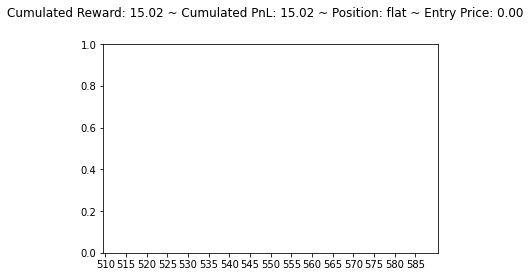

[128.1358  316.60522 286.81516]
flat buy long


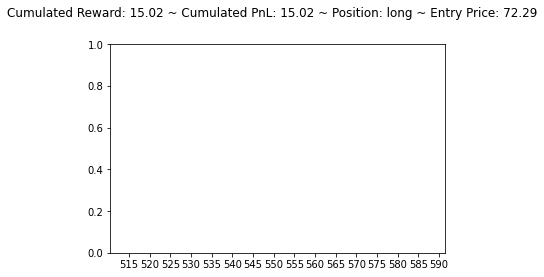

[131.43587 344.14355 327.09354]
long sell flat


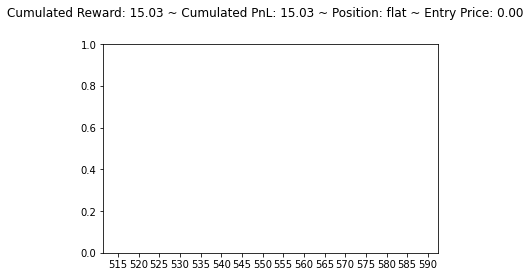

[340.85596 344.4292  265.57343]
flat buy long


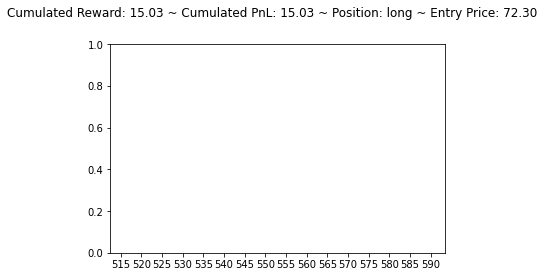

[268.85556 375.6467  341.2106 ]
long sell flat


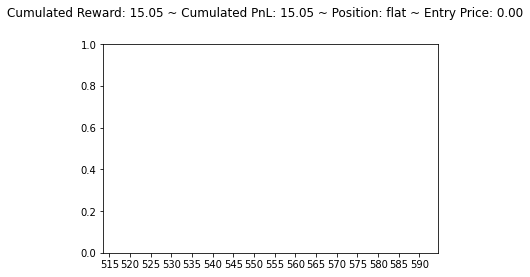

[225.89459 410.09964 361.99902]
flat buy long


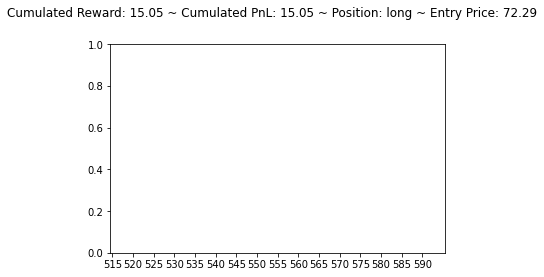

[166.58516 366.40222 356.8416 ]
long sell flat


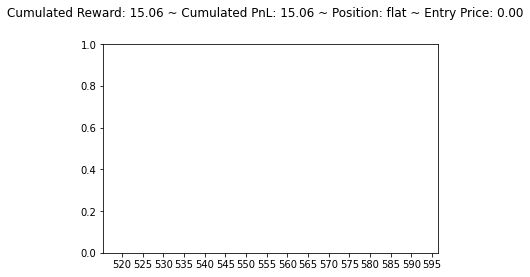

[170.51826 369.84436 220.98843]
flat buy long


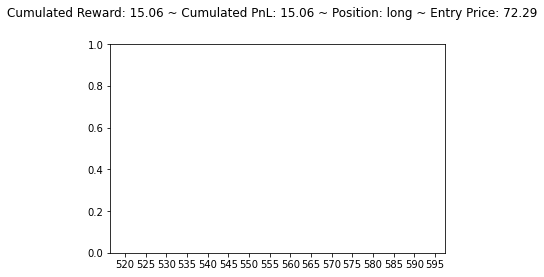

[211.01866 390.23788 338.90076]
long sell flat


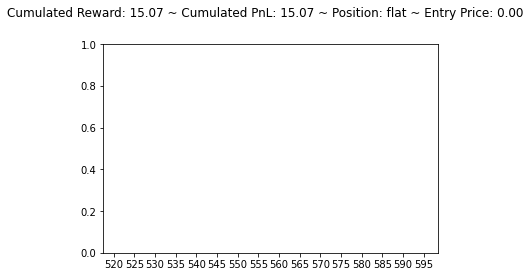

[179.75594 361.864   282.51486]
flat buy long


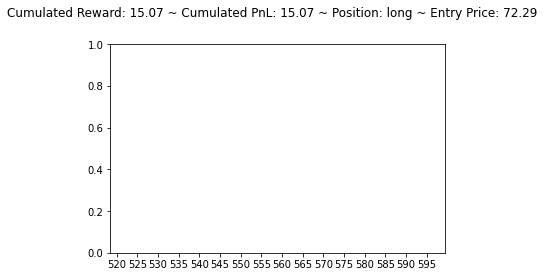

[217.99948 390.78845 261.78467]
long sell flat


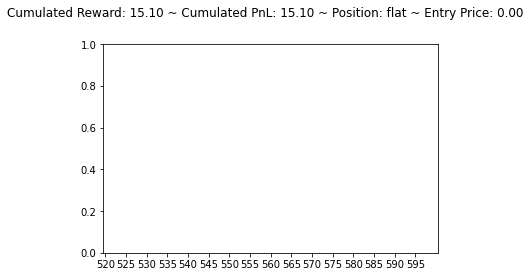

[188.43552 367.3683  348.35736]
flat buy long


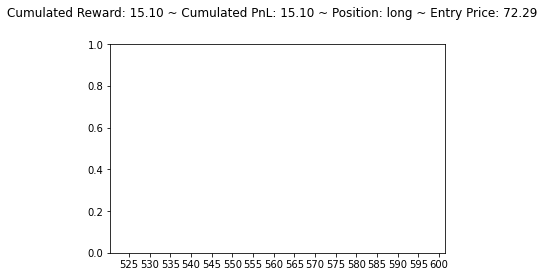

[205.61281 403.69308 249.83514]
long sell flat


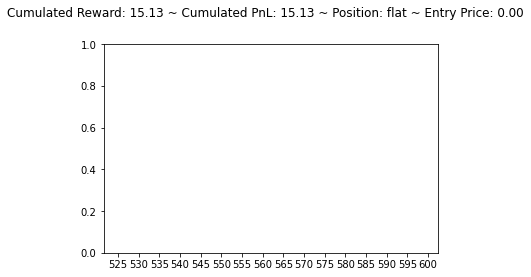

[845.56793 949.7483  869.7701 ]
flat buy long


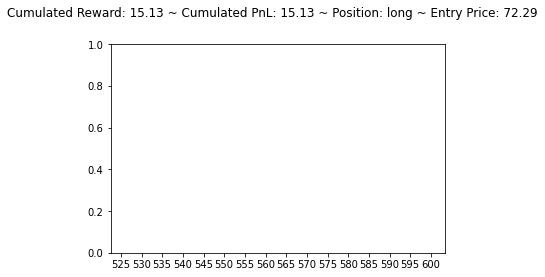

[817.8645  764.67194 661.45776]
long hold long


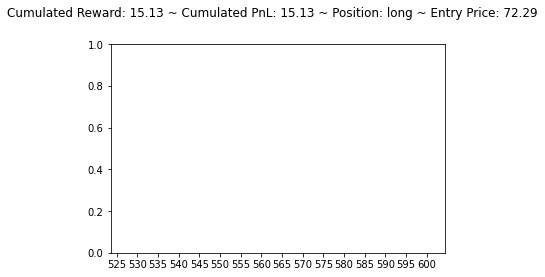

[236.65738 377.73746 354.03793]
long sell flat


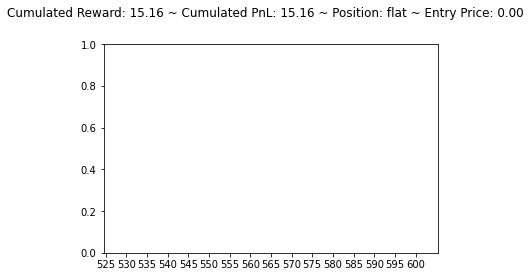

[219.46951 365.28198 267.8558 ]
flat buy long


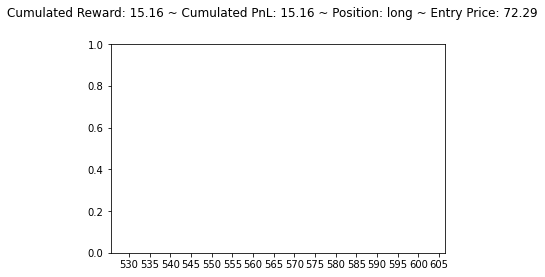

[353.17343 455.38998 400.6963 ]
long sell flat


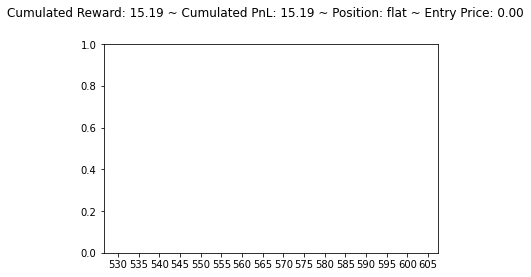

[277.73795 418.7939  305.04462]
flat buy long


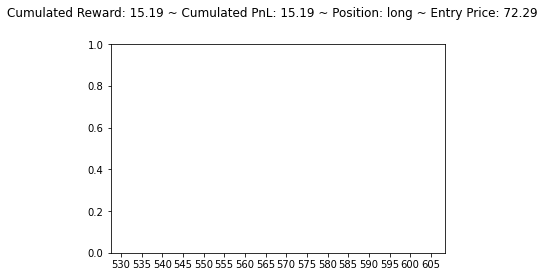

[173.02516 356.85873 295.7994 ]
long sell flat


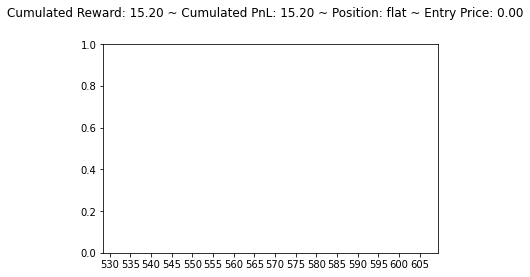

[142.76132 318.81277 240.98871]
flat buy long


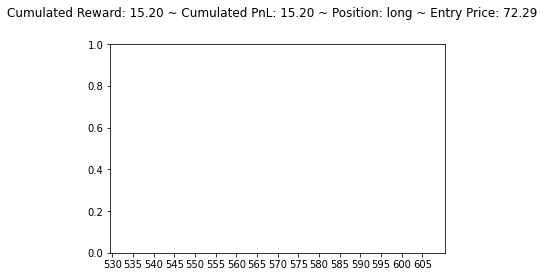

[159.02647 350.4688  282.17328]
long sell flat


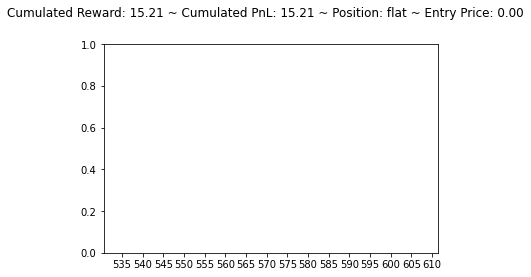

[142.89761 323.7991  176.8429 ]
flat buy long


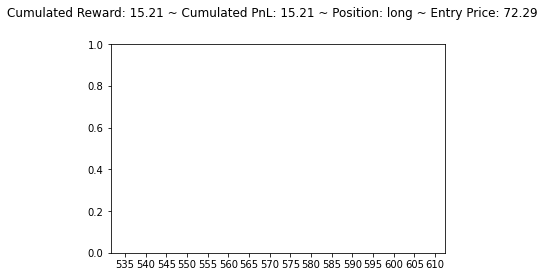

[195.5481  319.74078 220.49968]
long sell flat


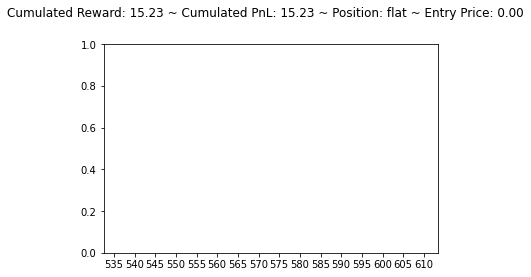

[226.3268  288.98782 189.76132]
flat buy long


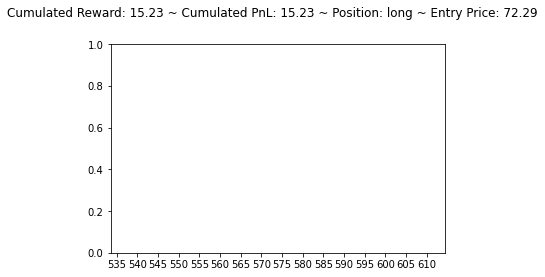

[364.1112  485.87845 388.7744 ]
long sell flat


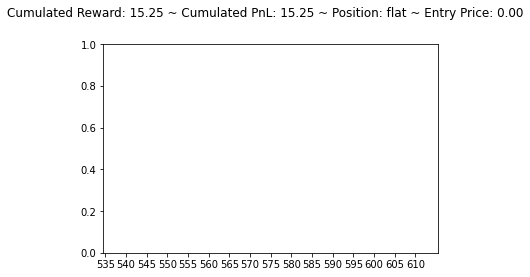

[465.4709  703.5286  634.99945]
flat buy long


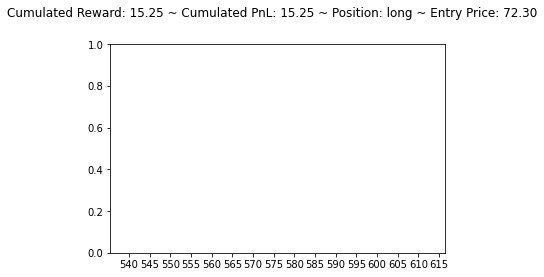

[486.81982 733.7995  707.6965 ]
long sell flat


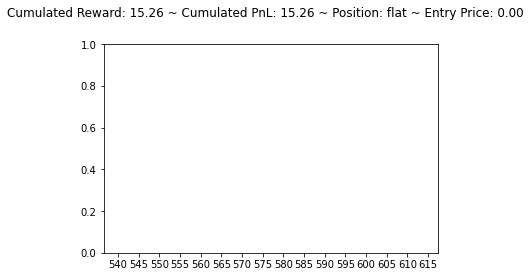

[433.52173 695.52106 633.5109 ]
flat buy long


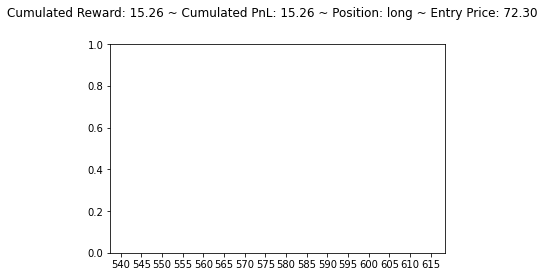

[471.386   701.8918  677.29266]
long sell flat


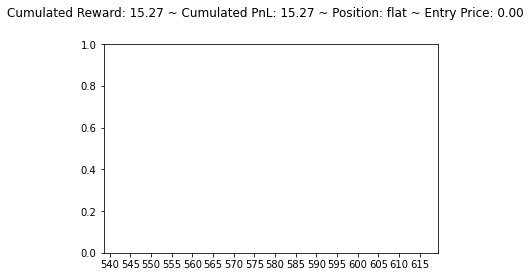

[411.06992 659.6885  605.04846]
flat buy long


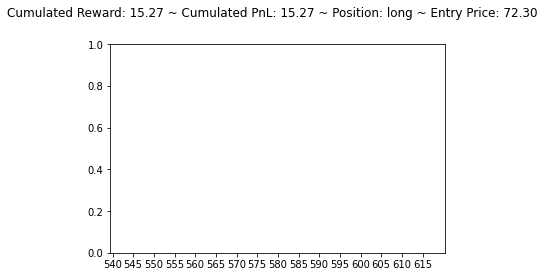

[454.4587  708.52014 678.96   ]
long sell flat


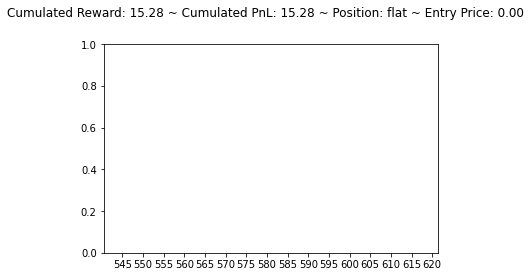

[405.56415 663.22943 609.8306 ]
flat buy long


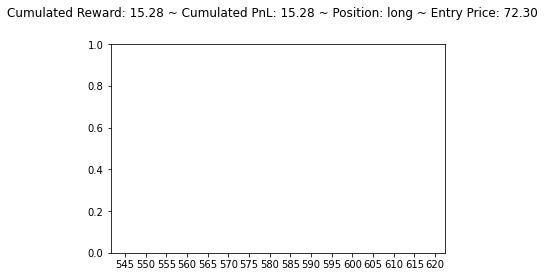

[454.49945 712.4303  682.991  ]
long sell flat


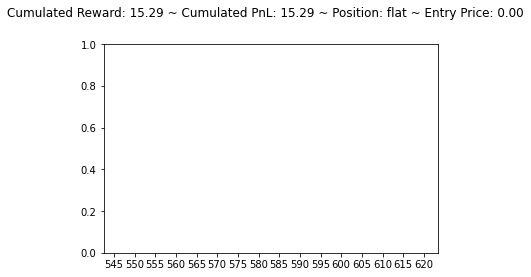

[398.66068 600.603   566.67206]
flat buy long


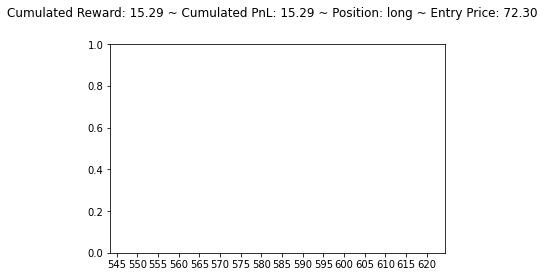

[439.55023 699.37305 662.6196 ]
long sell flat


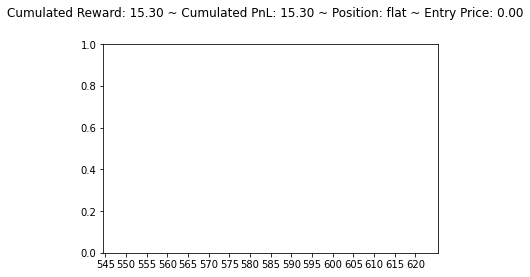

[400.41025 638.59265 582.9261 ]
flat buy long


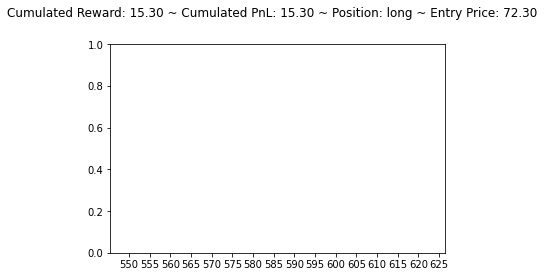

[646.43756 623.62085 553.622  ]
long hold long


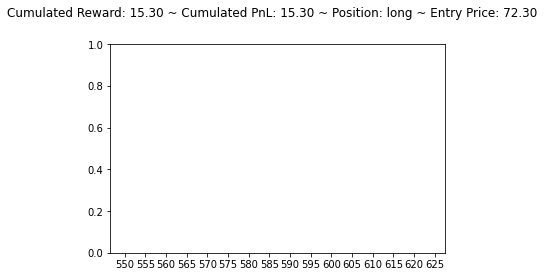

[394.34863 627.0617  592.951  ]
long sell flat


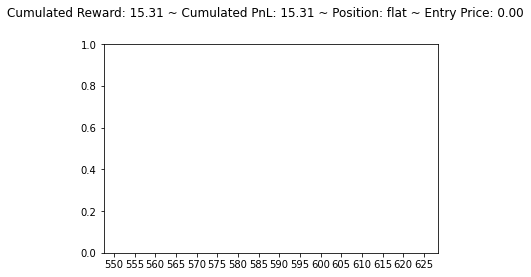

[346.71082 598.94543 593.74536]
flat buy long


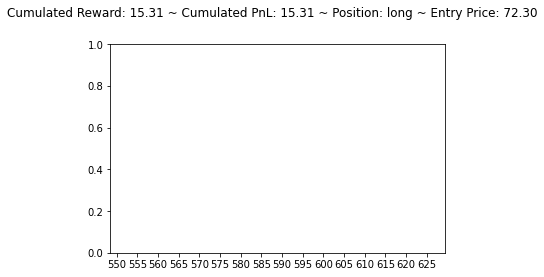

[494.4234 720.303  725.8268]
long sell flat


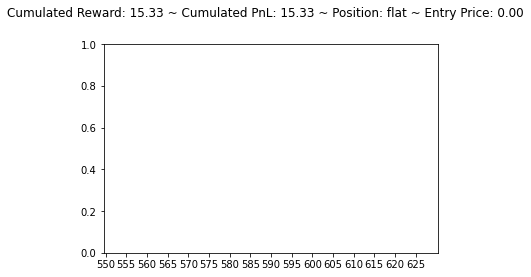

[282.9765  369.77042 344.2068 ]
flat buy long


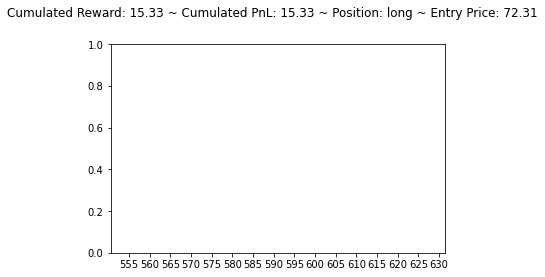

[290.7732  415.1003  372.60764]
long sell flat


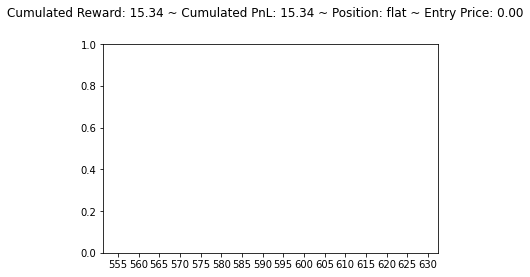

[266.27    385.2841  321.03632]
flat buy long


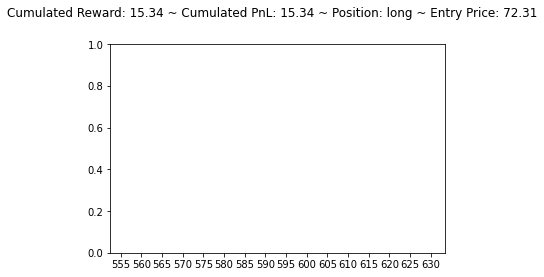

[264.83417 374.9891  388.38324]
long sell flat


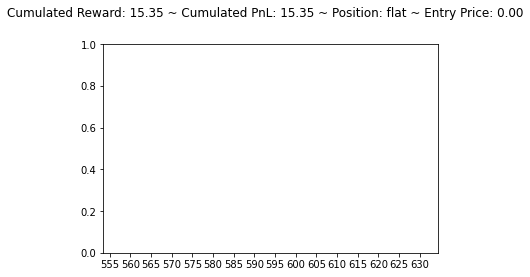

[227.16049 348.8966  284.1731 ]
flat buy long


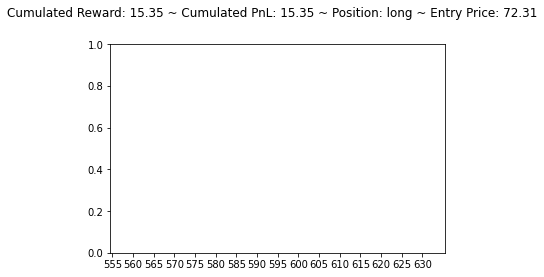

[250.00256 377.52005 334.09467]
long sell flat


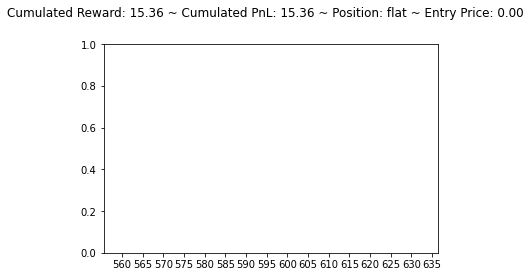

[428.38422 519.459   369.77222]
flat buy long


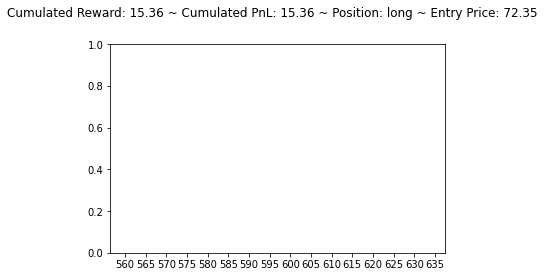

[532.07513 674.0581  608.31464]
long sell flat


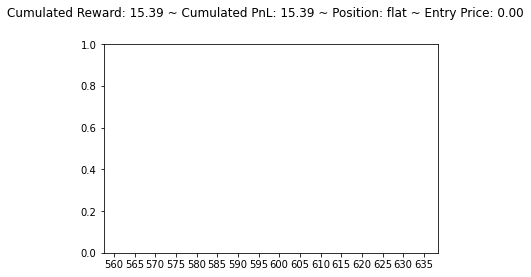

[494.6177  622.8616  544.82166]
flat buy long


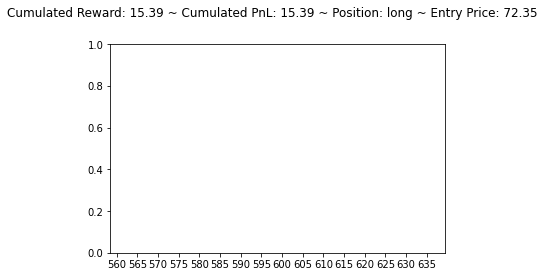

[420.29657 624.21313 560.7664 ]
long sell flat


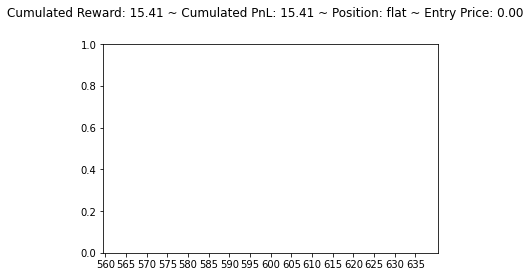

[633.6695  677.5156  507.11005]
flat buy long


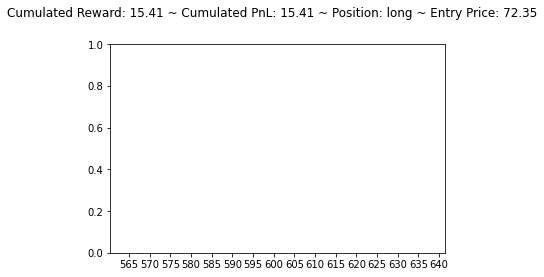

[603.52136 732.53955 644.56354]
long sell flat


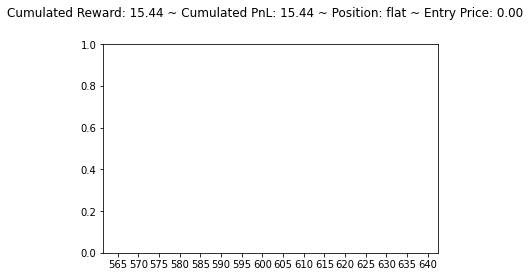

[534.3512 674.3474 563.0944]
flat buy long


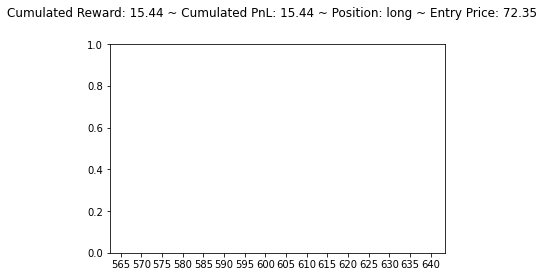

[564.24023 691.5055  635.2493 ]
long sell flat


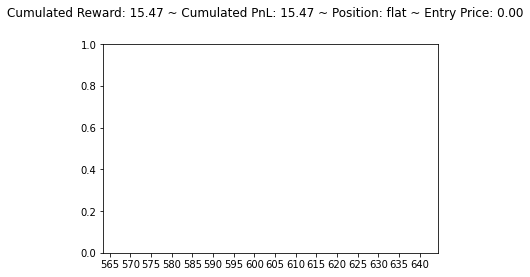

[529.7477 664.0937 569.8811]
flat buy long


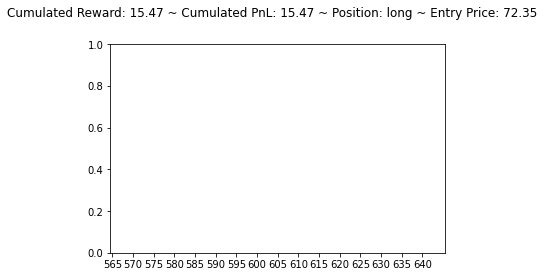

[1327.7219 1652.7902 1415.516 ]
long sell flat


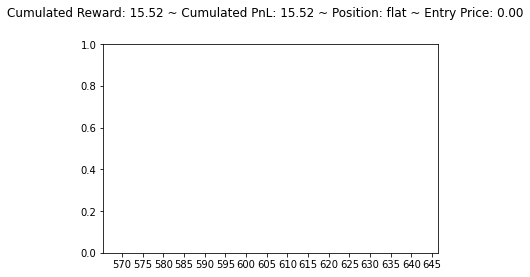

[1365.7903 1347.2191 1410.558 ]
flat sell short


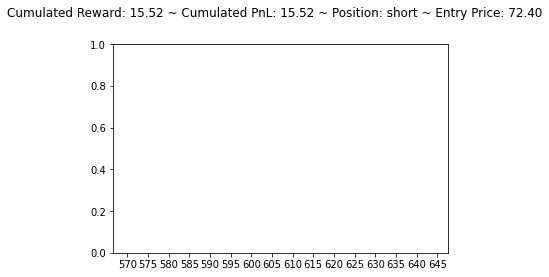

[1393.2625 1307.1841 1303.1913]
short hold short


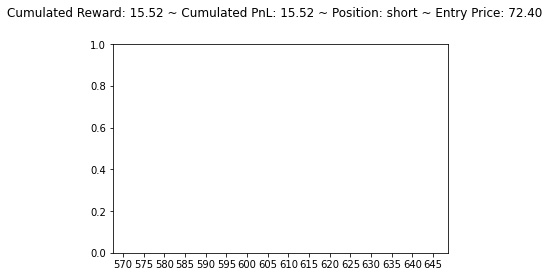

[560.33044 619.1965  600.02783]
short buy flat


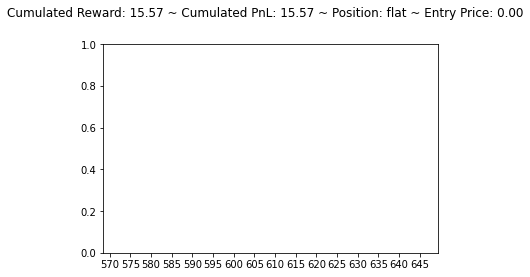

[ 838.9802 1308.9801  947.6828]
flat buy long


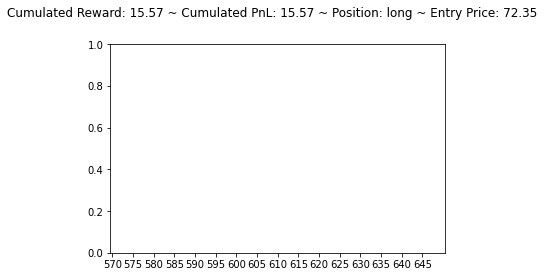

[ 957.1434  1016.78076 1043.3182 ]
long sell flat


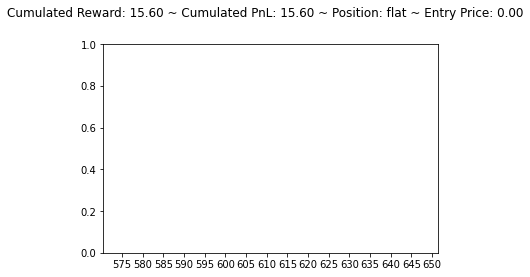

[1013.4633 1031.3224 1049.378 ]
flat sell short


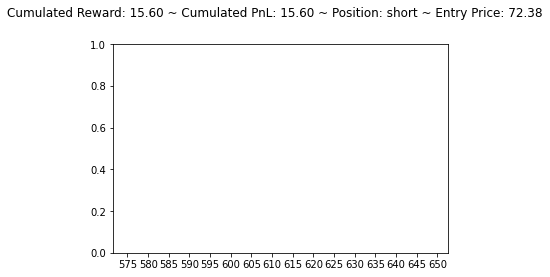

[1075.8278 1121.8793 1122.301 ]
short buy flat


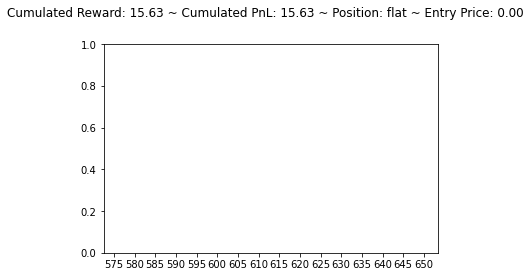

[1076.106  1116.904  1084.9924]
flat buy long


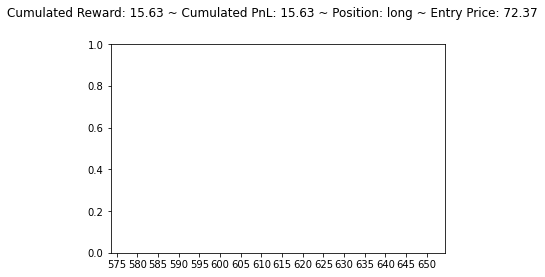

[1111.2046   887.06256  626.49805]
long hold long


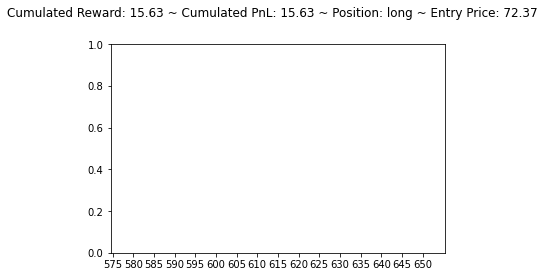

[ 88.370926 286.10306  331.65567 ]
long sell flat


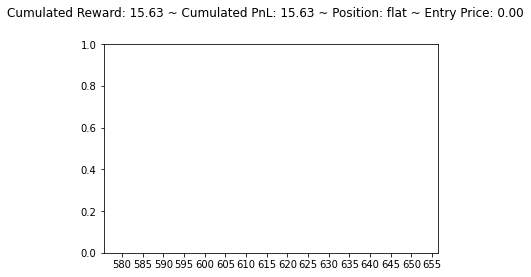

flat sell short


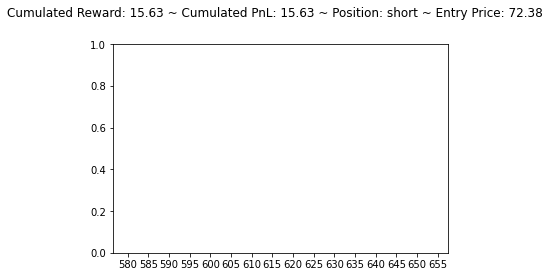

[1109.3418   951.16943  723.206  ]
short hold short


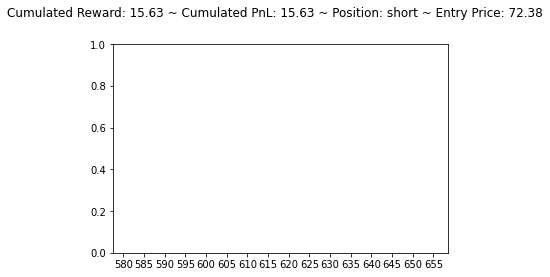

[585.5545 927.4319 563.3379]
short buy flat


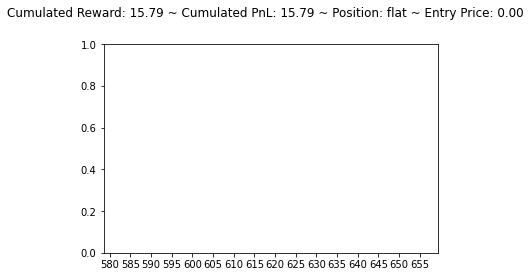

[1015.1621 1869.3375 1994.32  ]
flat sell short


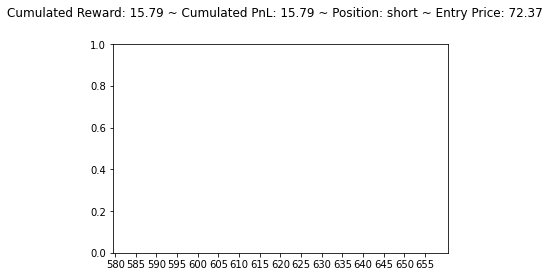

[1376.4713 1473.2498 1442.7164]
short buy flat


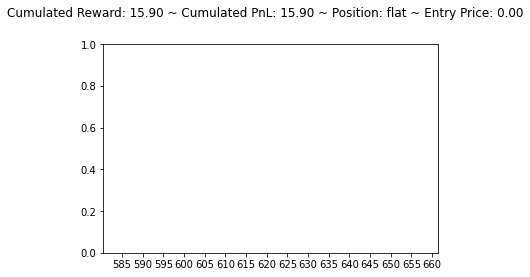

[1148.904  1190.0101 1162.9086]
flat buy long


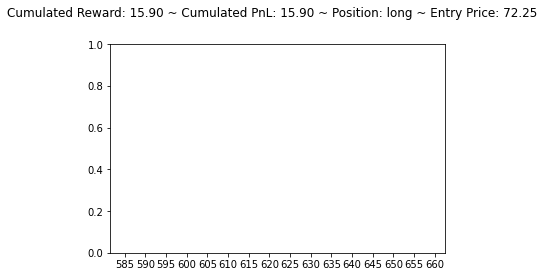

[1603.6495 1624.2295 1706.1305]
long sell flat


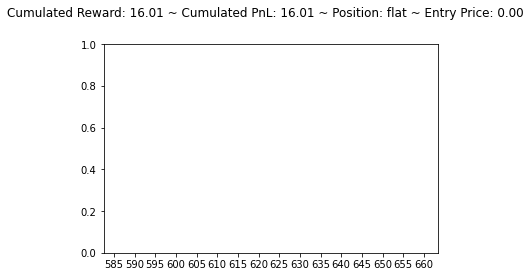

[1275.156    826.08734 1317.896  ]
flat sell short


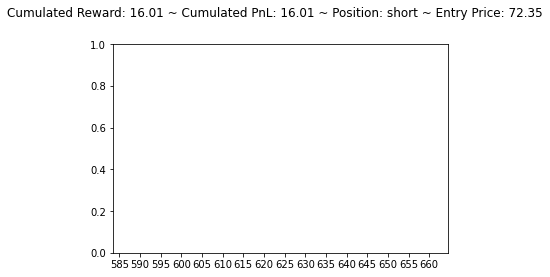

[1105.7831 1146.7605 1148.202 ]
short buy flat


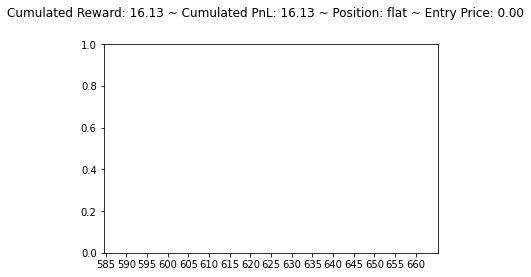

[1090.0686 1132.5023 1102.7167]
flat buy long


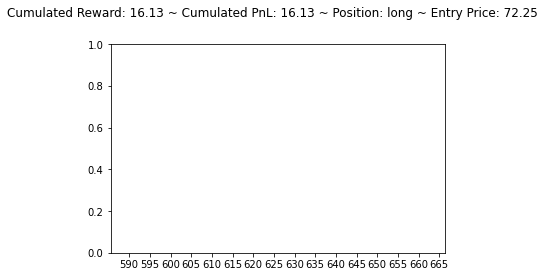

[1121.2955 1167.7261 1157.7512]
long sell flat


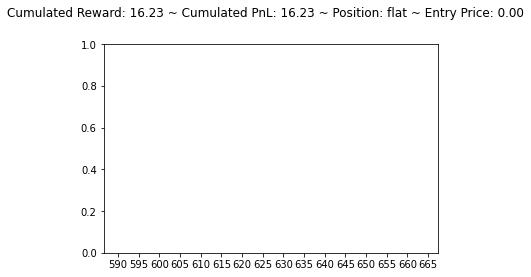

[885.16284 533.6277  630.3235 ]
flat hold flat


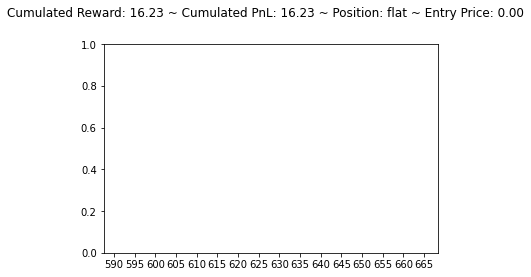

[410.40674 519.0814  458.82736]
flat buy long


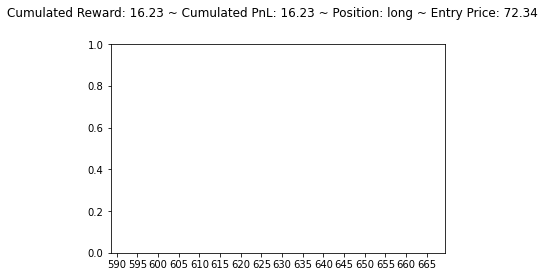

[1164.8748 1245.2587 1027.5375]
long hold long


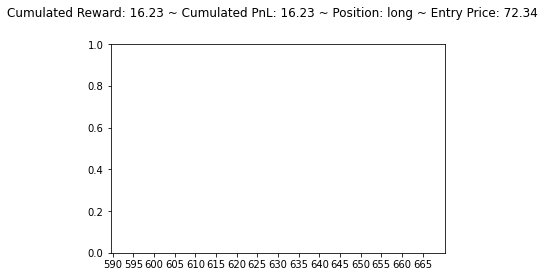

[841.98267 573.5897  746.39594]
long hold long


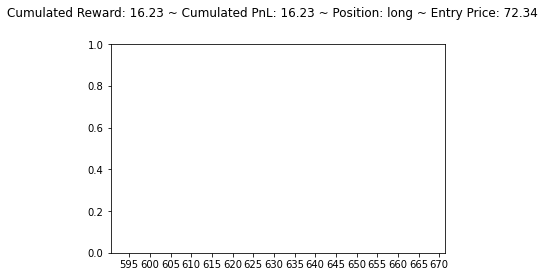

[440.13605 508.73776 527.34625]
long sell flat


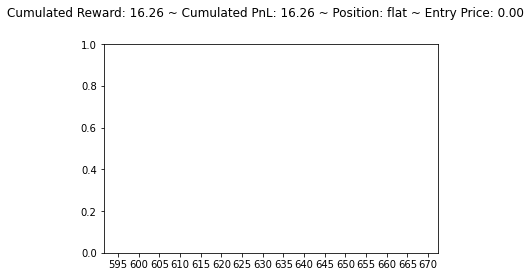

[395.46152 499.73804 447.2882 ]
flat buy long


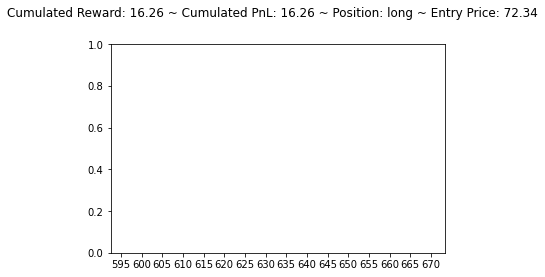

[405.3474  485.33884 492.41248]
long sell flat


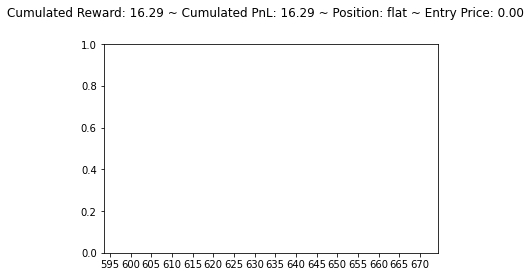

[408.40204 557.6467  437.78568]
flat buy long


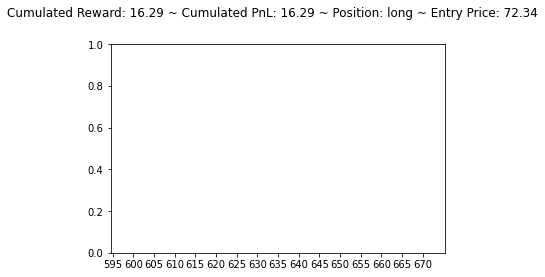

[582.6382 698.2163 642.8704]
long sell flat


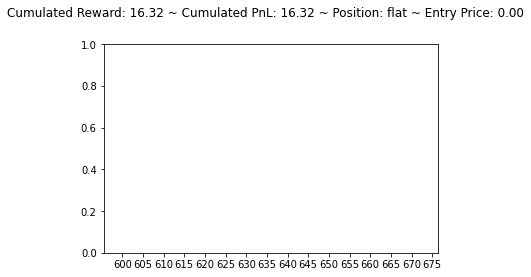

[547.887   644.7787  590.18787]
flat buy long


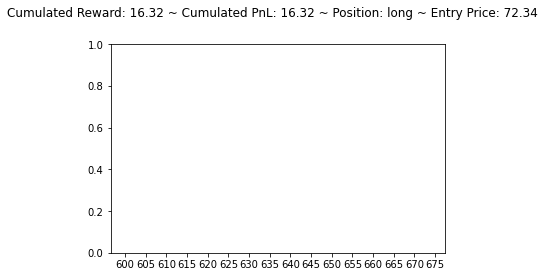

[561.8921  642.6323  507.35168]
long hold long


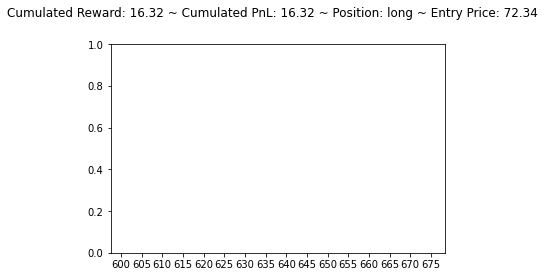

[556.3448  581.39557 481.07587]
long hold long


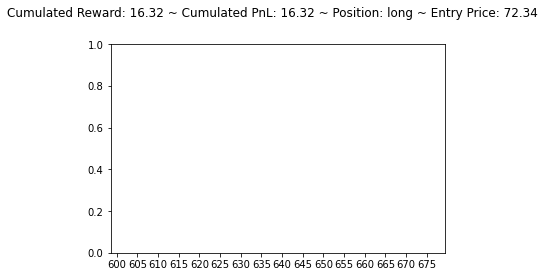

[469.0731  605.66437 537.8883 ]
long sell flat


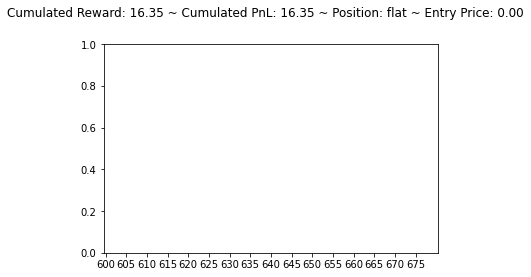

[458.90918 552.86755 508.50266]
flat buy long


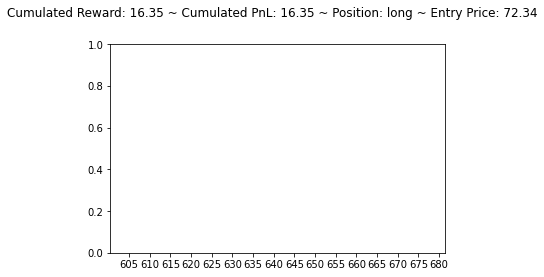

[594.8214  657.75793 488.55243]
long hold long


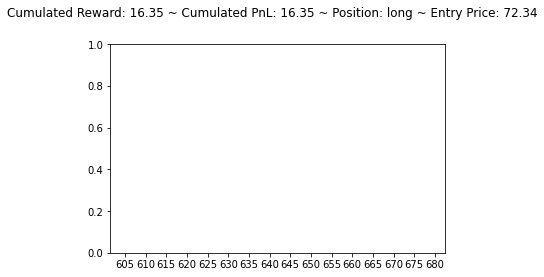

[487.87012 901.3257  741.39514]
long sell flat


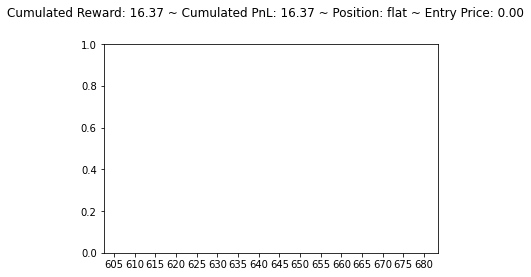

[614.57825 655.78534 575.70056]
flat buy long


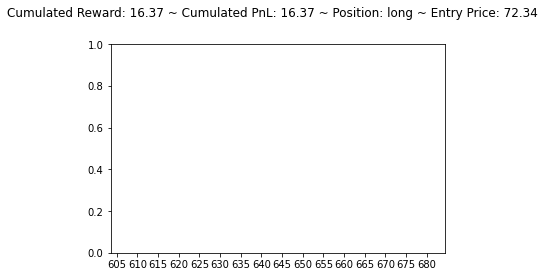

[631.1475 708.1624 642.524 ]
long sell flat


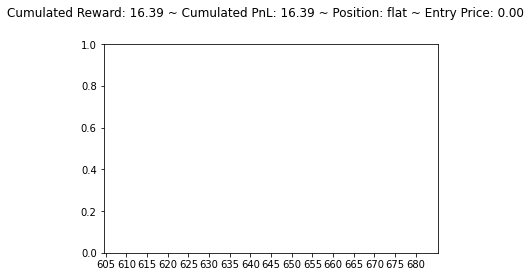

[541.7246  640.20337 550.5369 ]
flat buy long


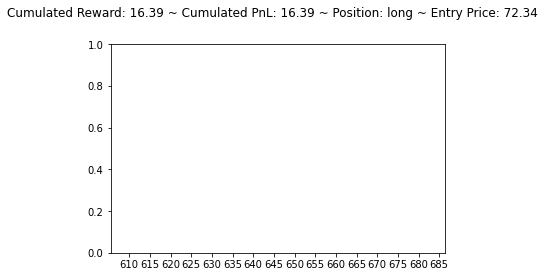

[687.67053 707.1931  656.3371 ]
long hold long


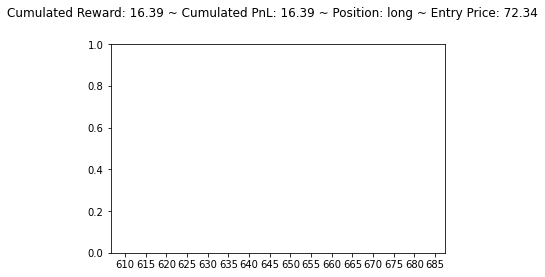

[644.0562  745.1991  667.13446]
long sell flat


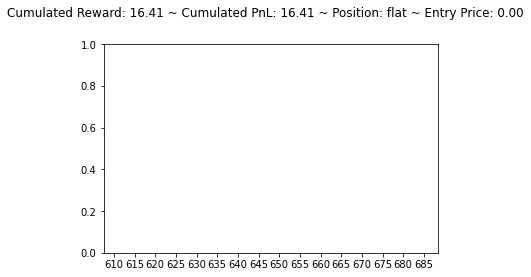

[650.7709  731.21387 624.76636]
flat buy long


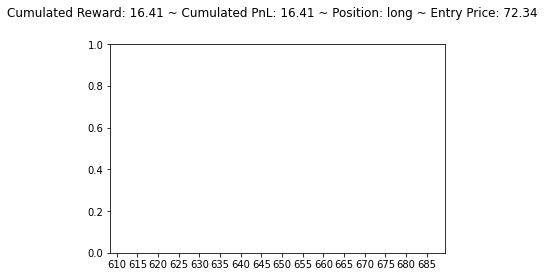

[660.3222  792.8977  701.96313]
long sell flat


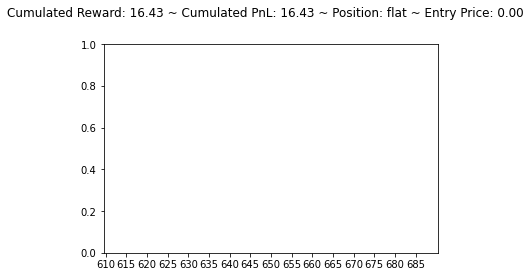

[532.2121  690.8611  578.02905]
flat buy long


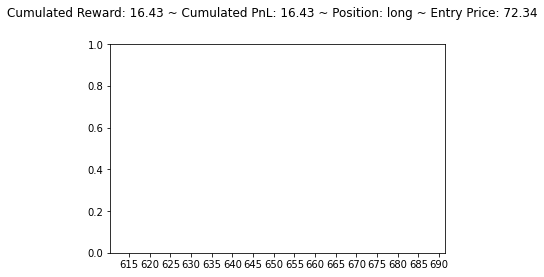

[544.3046  645.00934 578.6589 ]
long sell flat


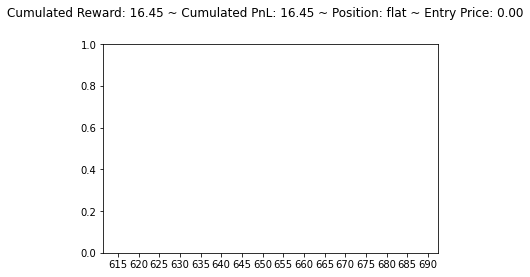

[476.62796 583.92725 503.11328]
flat buy long


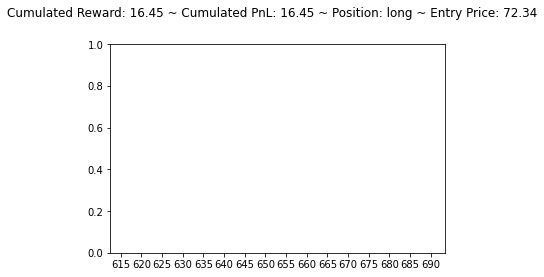

[524.0894 646.4879 595.5045]
long sell flat


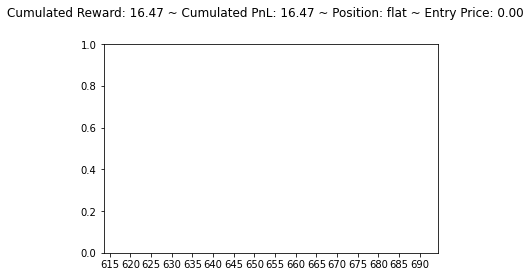

[625.02527 606.0231  548.3311 ]
flat hold flat


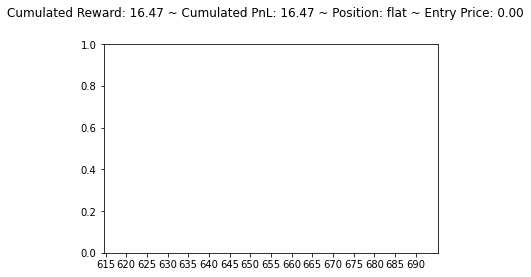

[546.34314 677.35706 586.2659 ]
flat buy long


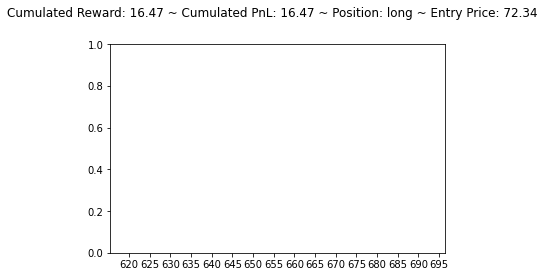

[558.6988  693.28723 638.4306 ]
long sell flat


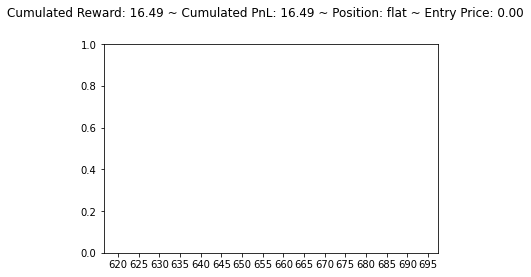

[449.1527 654.9563 546.0738]
flat buy long


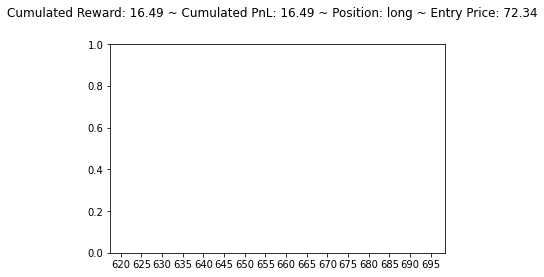

[480.58774 589.7035  539.0648 ]
long sell flat


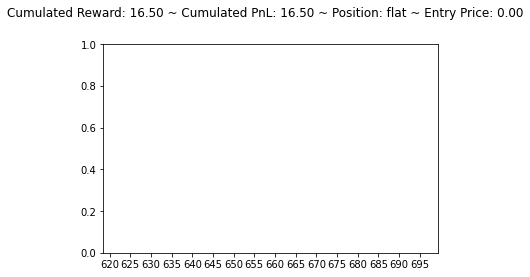

[300.97363 327.14676 346.03317]
flat sell short


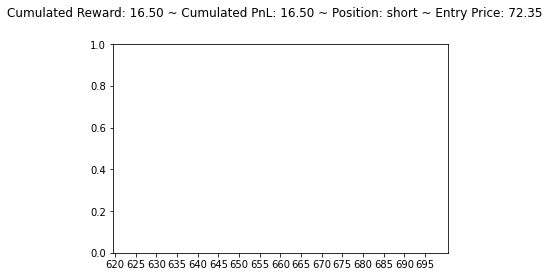

[312.26306 510.2612  453.30914]
short buy flat


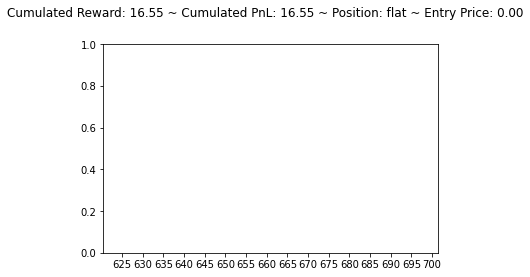

[377.22772 556.4051  555.30804]
flat buy long


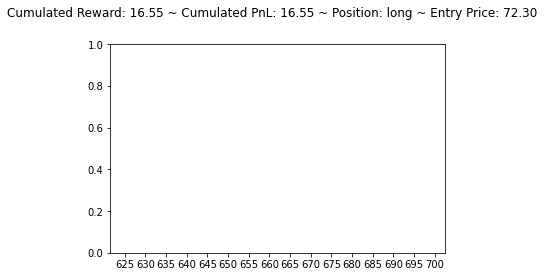

[589.78516 736.0652  611.50397]
long sell flat


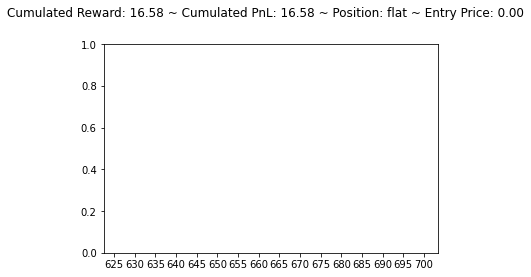

[302.84808 312.02298 388.6148 ]
flat sell short


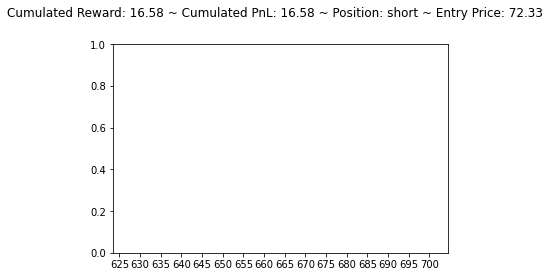

[313.11255 441.64078 448.17468]
short buy flat


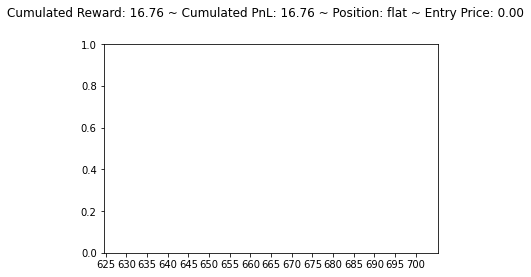

[1190.9336 1360.2618 1246.1683]
flat buy long


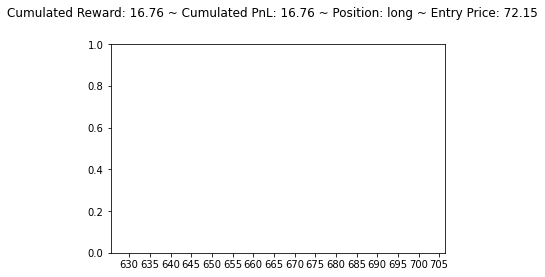

[1201.7322  1037.2778   854.62085]
long hold long


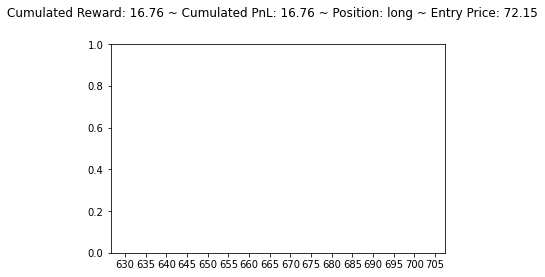

[1316.3352 1463.9431 1400.2391]
long sell flat


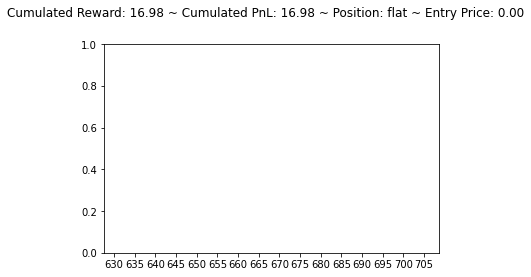

[1113.0007  835.7437 1199.9663]
flat sell short


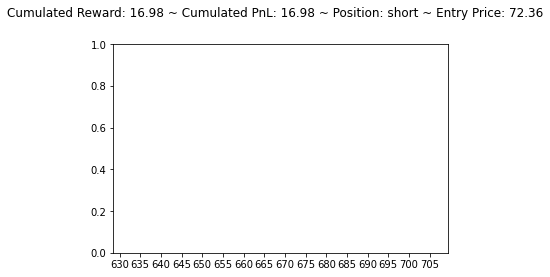

[1270.3135 1340.9053 1334.148 ]
short buy flat


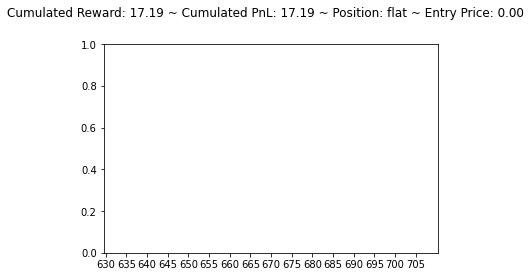

[1199.1313 1222.132  1228.6724]
flat sell short


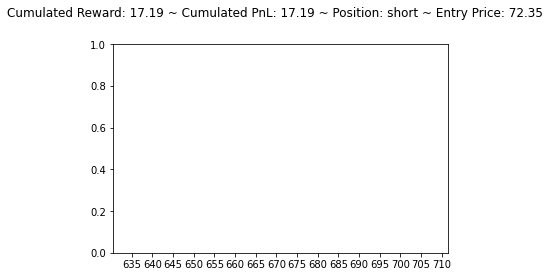

[1081.7837   828.37024 1218.4993 ]
short hold short


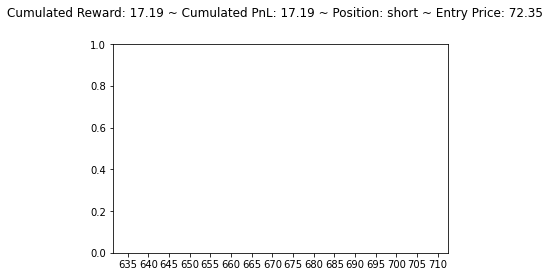

[ 954.0024 1036.003  1020.009 ]
short buy flat


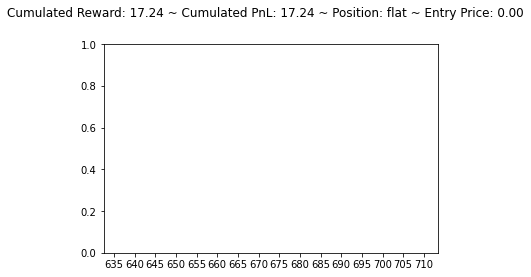

[1792.2607 2020.0339 1836.4537]
flat buy long


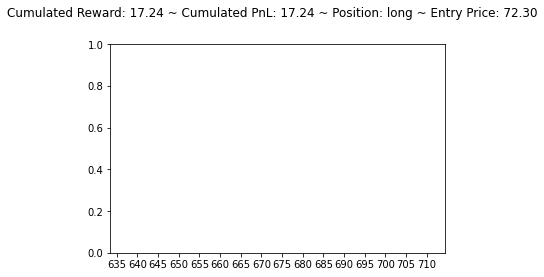

[2007.3802 1950.9614 2017.3798]
long sell flat


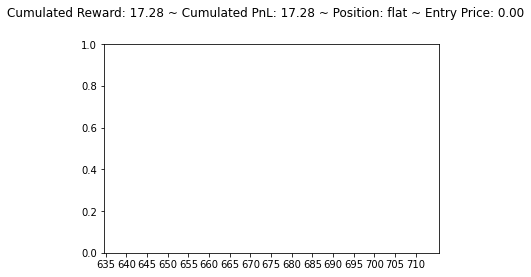

[1508.5624   717.05804 1467.1803 ]
flat hold flat


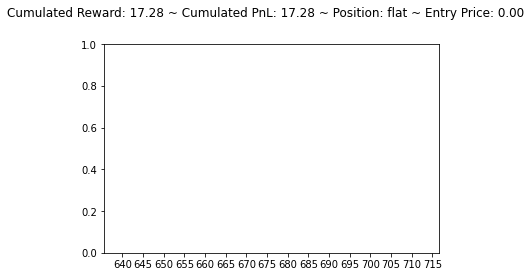

[1218.0779 1241.1697 1221.7935]
flat buy long


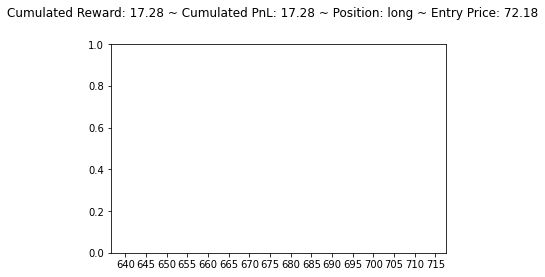

[1124.177   952.2279 1150.1421]
long sell flat


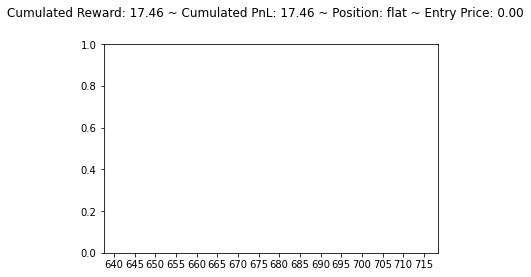

[1360.2124 1267.4258 1304.8785]
flat hold flat


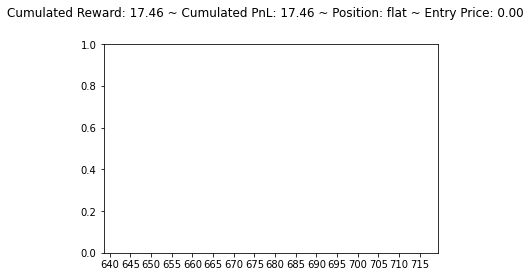

[1216.9517 1242.8356 1209.1031]
flat buy long


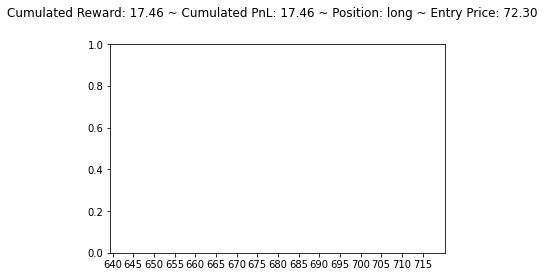

[1231.388   963.6699  687.3278]
long hold long


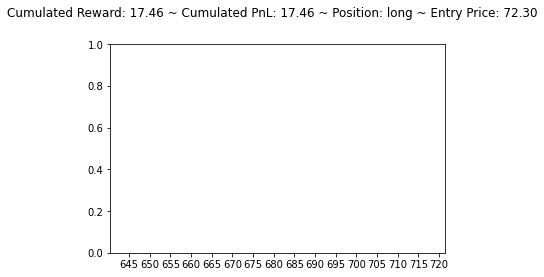

[602.7301 618.4909 572.2879]
long hold long


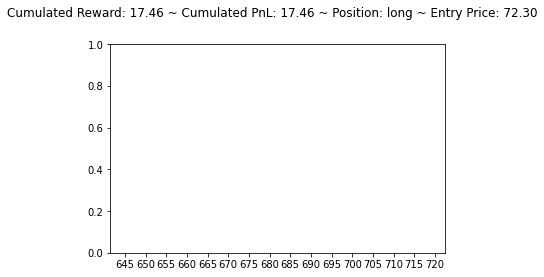

[500.73224 610.47986 567.4088 ]
long sell flat


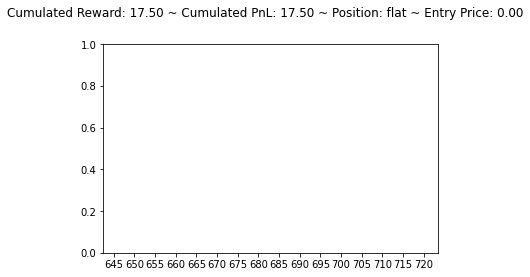

[1296.2297 1303.035  1195.569 ]
flat buy long


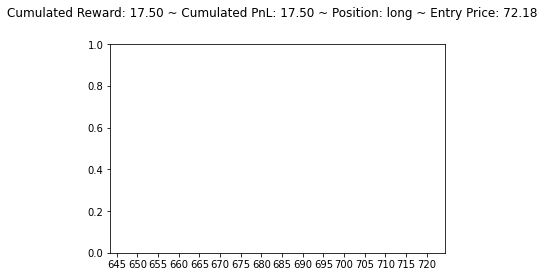

[1173.2456 1174.1248 1216.6436]
long sell flat


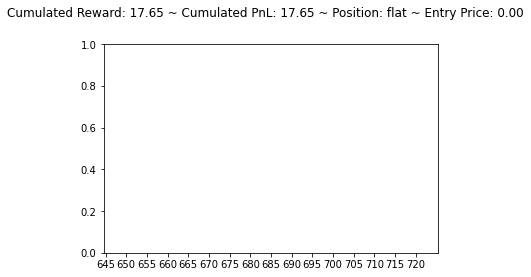

[1135.054 1175.72  1138.474]
flat buy long


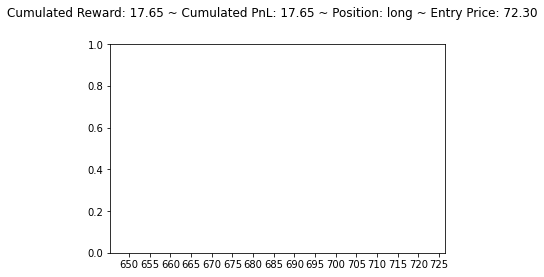

[882.2461 484.4747 639.4252]
long hold long


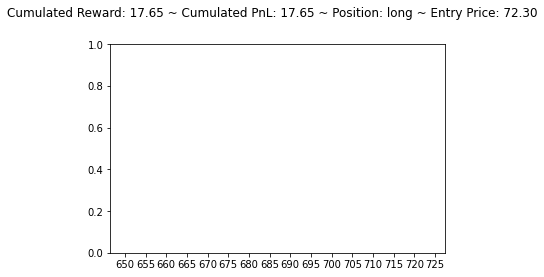

[493.5818  604.40515 563.6112 ]
long sell flat


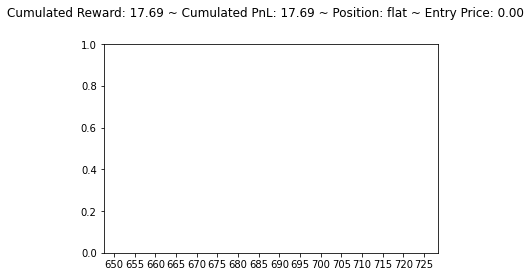

[1173.8269 1243.7507 1079.1727]
flat buy long


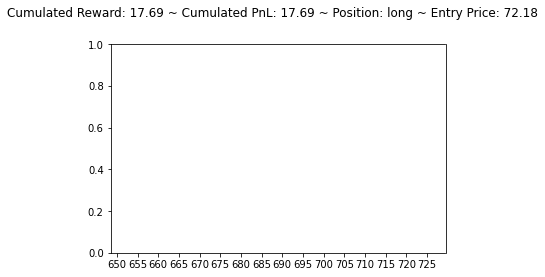

[1145.4712 1204.1715 1181.1323]
long sell flat


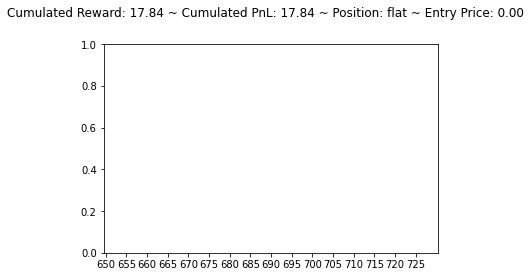

[1137.5488 1174.3286 1145.6973]
flat buy long


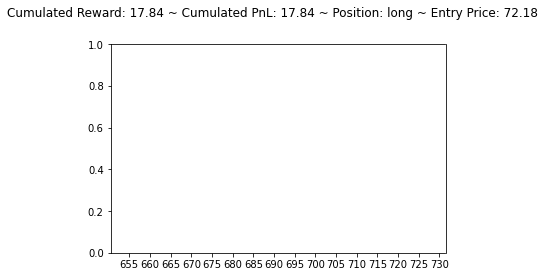

[1183.1227 1220.364  1207.472 ]
long sell flat


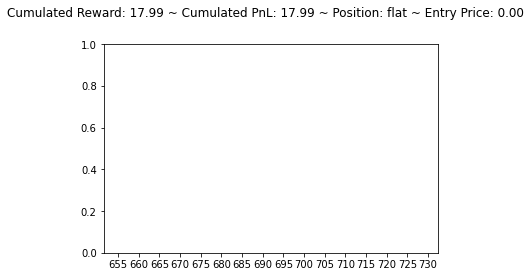

[1162.6793 1193.1992 1157.4987]
flat buy long


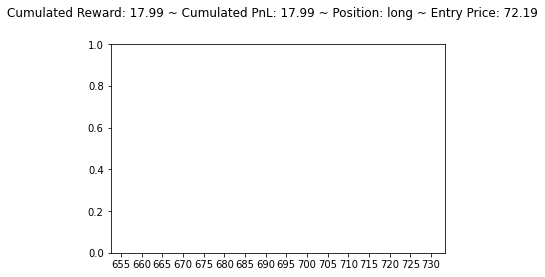

[1167.9551 1207.6183 1200.9585]
long sell flat


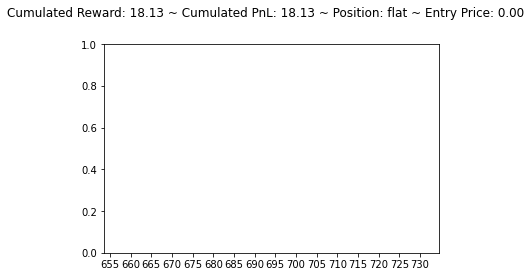

[1126.7847 1168.8945 1137.8276]
flat buy long


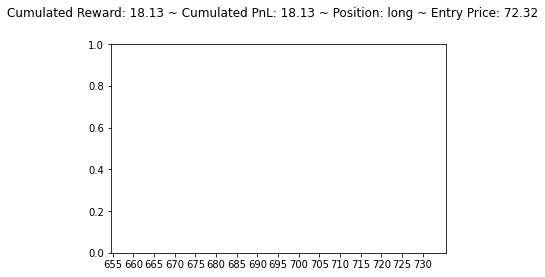

[1127.4779   973.89795  737.6914 ]
long hold long


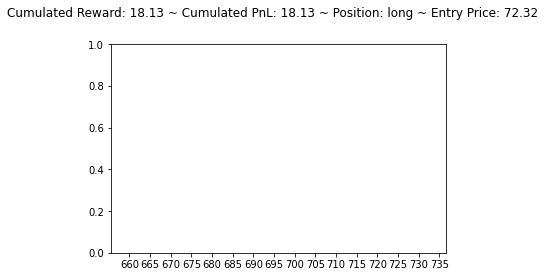

[447.19666 639.50635 414.05853]
long hold long


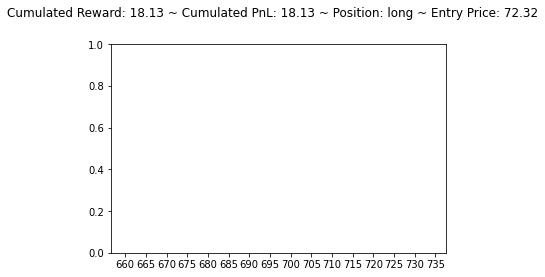

[ 710.3774 2013.959  1677.5575]
long sell flat


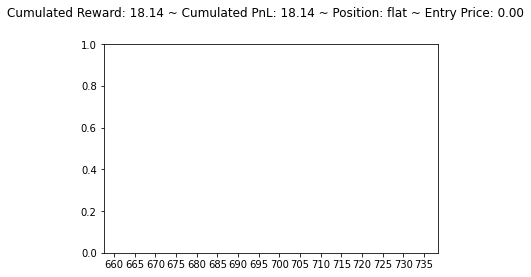

[ 900.376   1019.20215  962.56793]
flat buy long


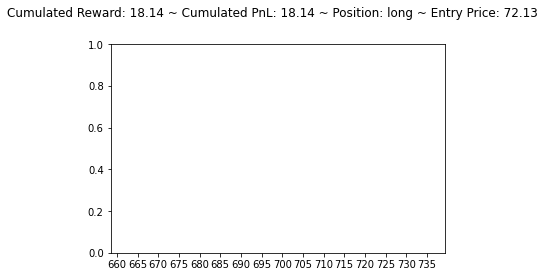

[1034.2698 1188.8885 1249.1414]
long sell flat


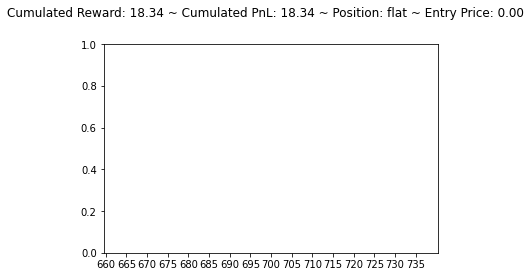

[1060.3838 1164.693  1157.0841]
flat buy long


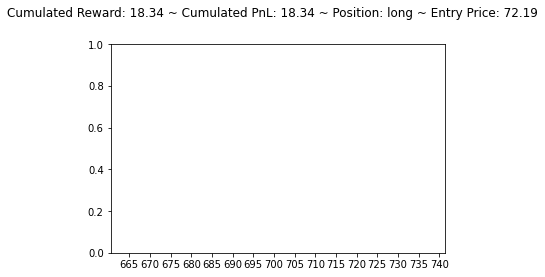

[1097.4434 1138.4592 1157.7161]
long sell flat


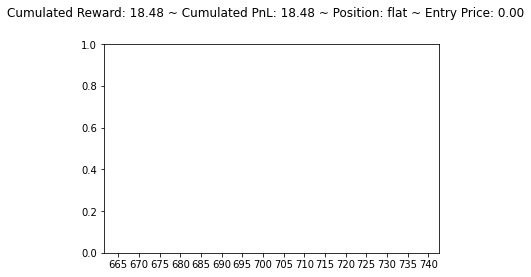

[1075.3752 1101.0635 1106.9067]
flat sell short


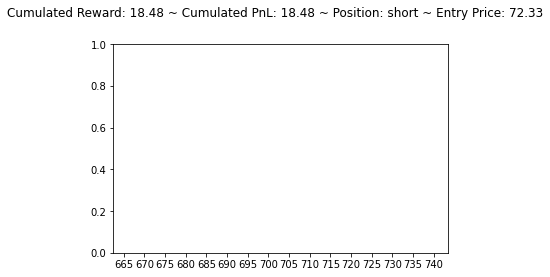

[1127.6616 1163.0801 1173.0426]
short buy flat


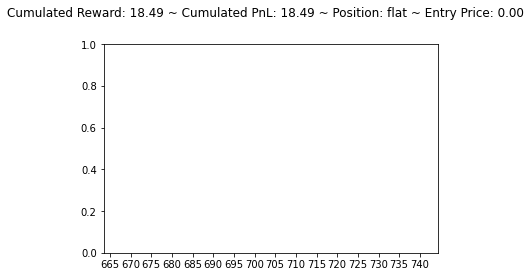

[1097.7598   932.6554   691.45514]
flat hold flat


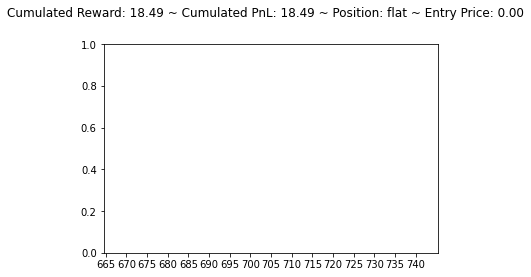

[495.62814 532.06335 425.66345]
flat buy long


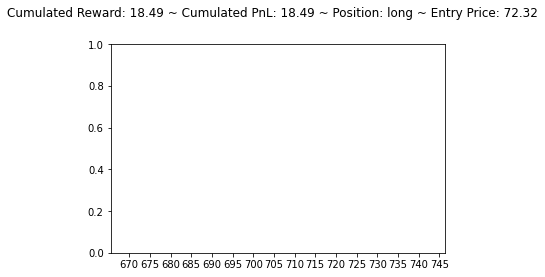

[696.9807  900.8308  939.06274]
long sell flat


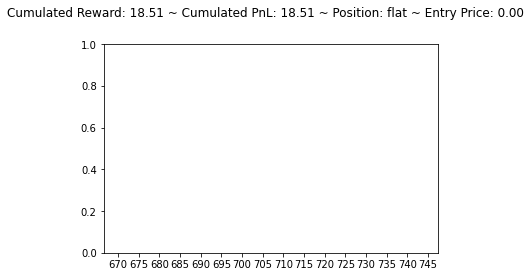

[578.95374 166.64044 820.7544 ]
flat sell short


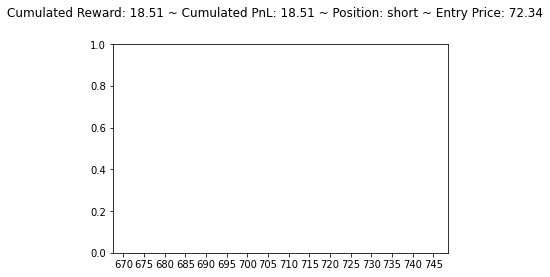

[1246.3585 1408.8308 1136.7489]
short buy flat


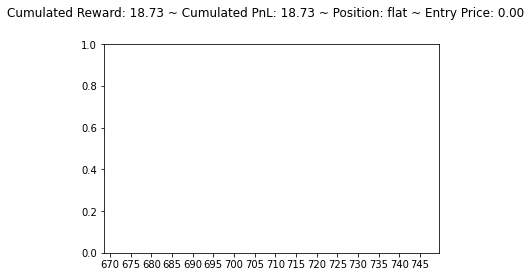

[1169.9446 1191.2363 1187.3685]
flat buy long


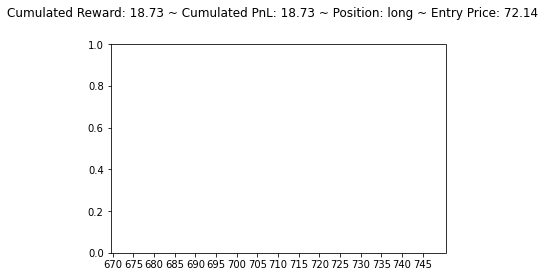

[1183.1105 1219.6731 1233.3579]
long sell flat


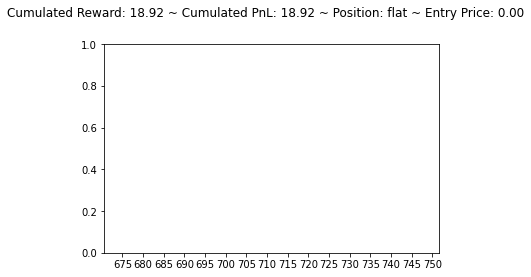

[1130.5143 1154.3358 1166.2621]
flat sell short


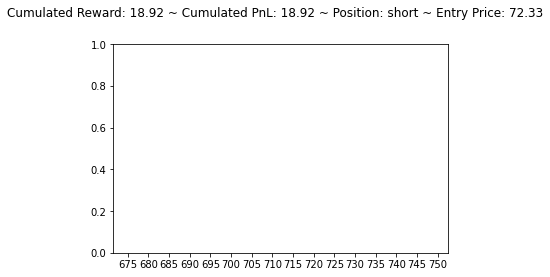

[1081.1375  934.5947 1121.0276]
short hold short


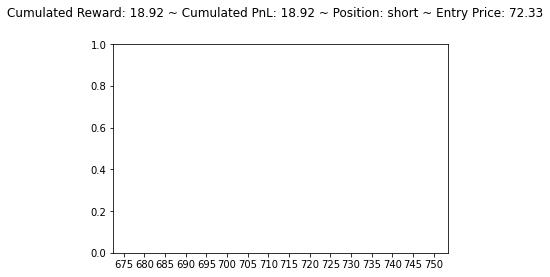

[383.2151  478.38635 482.08215]
short buy flat


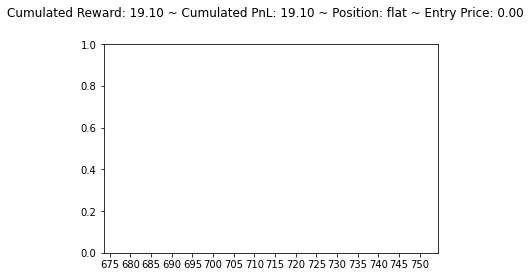

[408.0009  501.19858 458.2501 ]
flat buy long


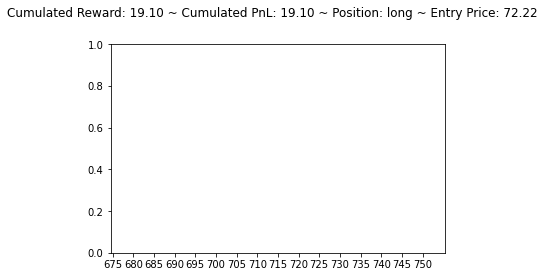

[1283.6812 1248.4626 1172.1188]
long hold long


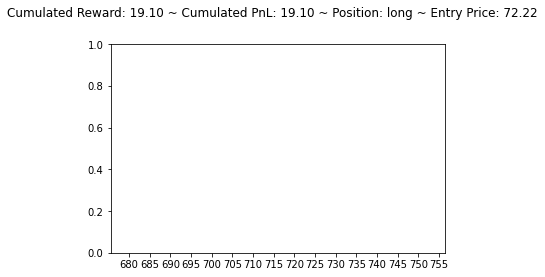

[1079.0635 1132.8972 1121.7013]
long sell flat


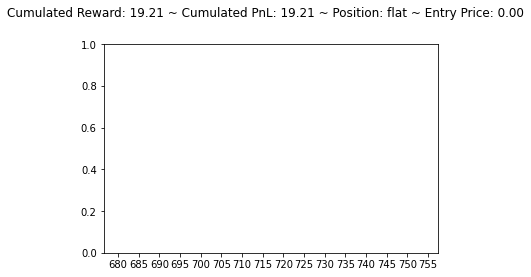

[1014.0327 1058.935  1048.0098]
flat buy long


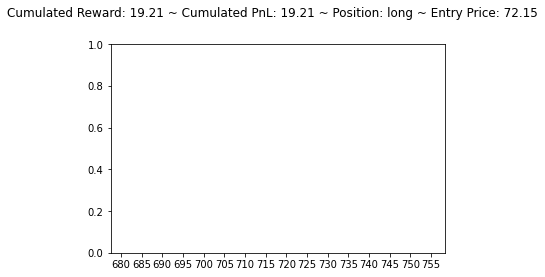

[1060.593  1096.4412 1110.351 ]
long sell flat


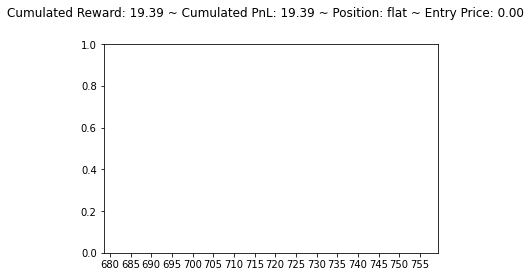

[896.23755 647.8961  938.75793]
flat sell short


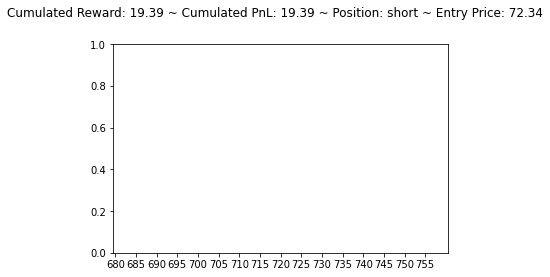

[1131.7059 1350.9897 1062.3035]
short buy flat


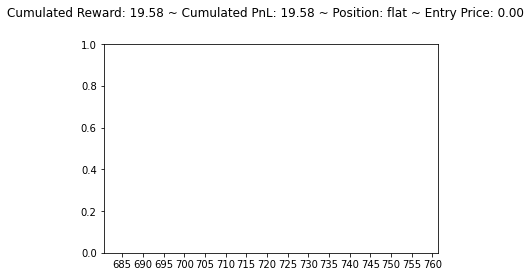

[1011.6841 1040.8524 1085.0857]
flat sell short


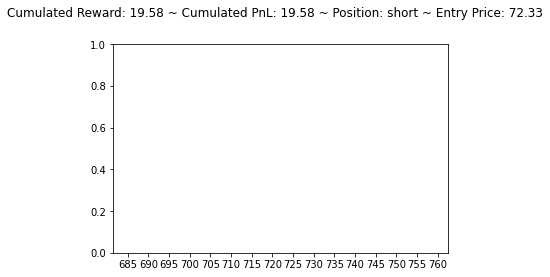

[1058.8286 1059.7526 1145.6564]
short buy flat


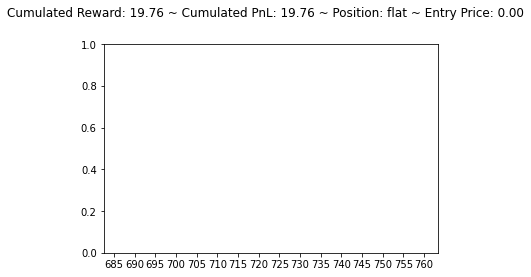

[1128.3547 1145.2898 1147.4474]
flat sell short


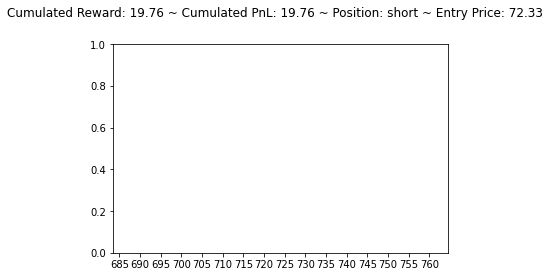

[1179.8981 1222.5391 1214.3348]
short buy flat


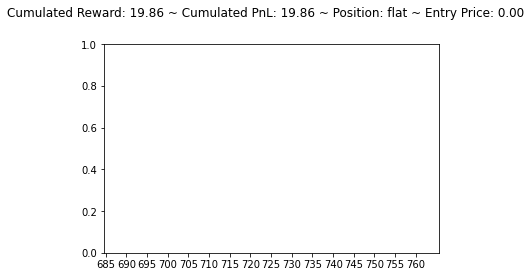

[1149.4988 1186.2129 1160.3766]
flat buy long


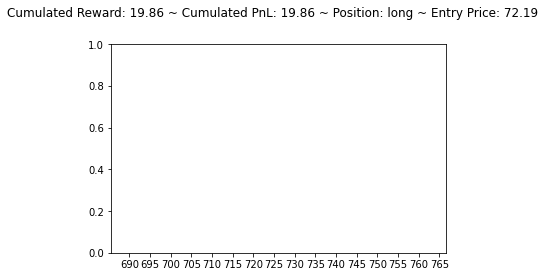

[1170.6488   984.5147   745.91693]
long hold long


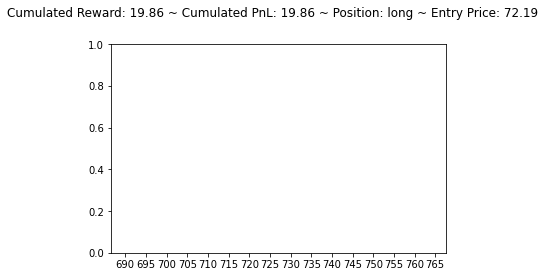

[1216.3837 1315.4773 1283.7692]
long sell flat


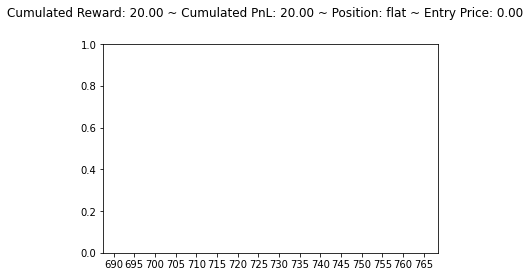

[1089.5264 1128.9592 1115.6631]
flat buy long


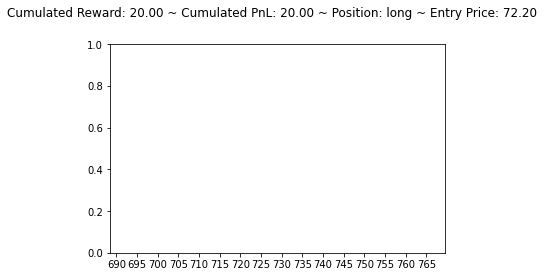

[1899.7738 1907.951  2020.6971]
long sell flat


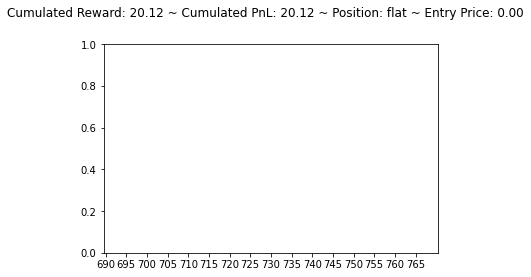

[1330.0782   483.24228 1307.879  ]
flat hold flat


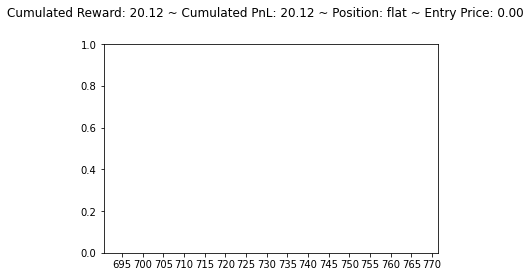

[ 971.08234 1010.0078  1012.0241 ]
flat sell short


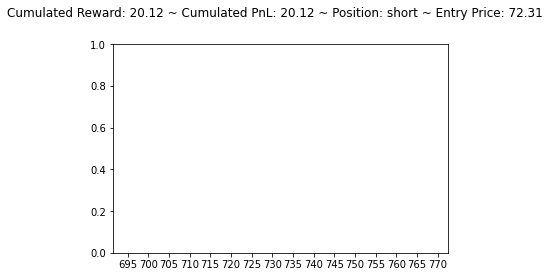

[899.19653 793.6083  995.49414]
short hold short


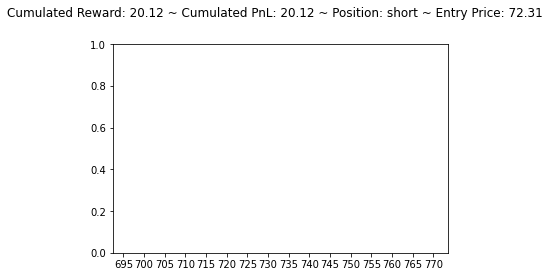

[ 977.6865 1261.7682  965.2331]
short buy flat


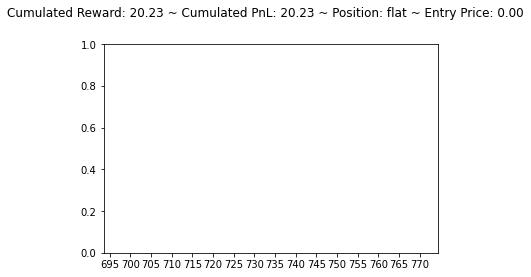

[ 997.9777 1031.1958 1037.6   ]
flat sell short


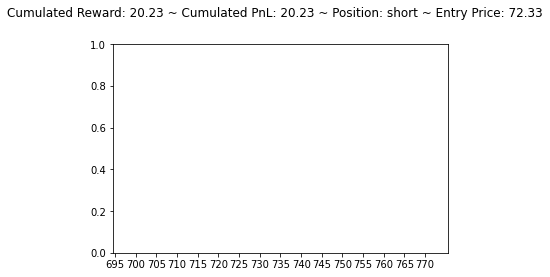

[1068.3274 1105.2146 1113.0536]
short buy flat


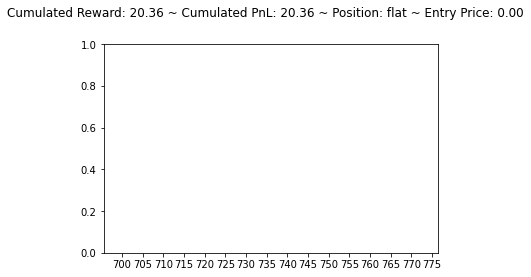

[1082.4495 1123.5696 1083.3075]
flat buy long


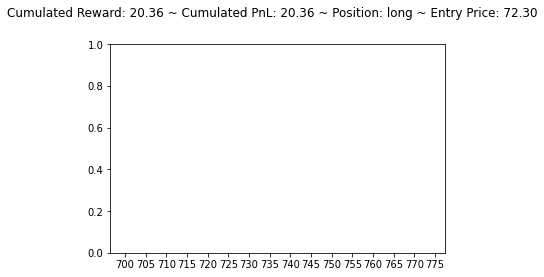

[855.86304 496.09354 593.74774]
long hold long


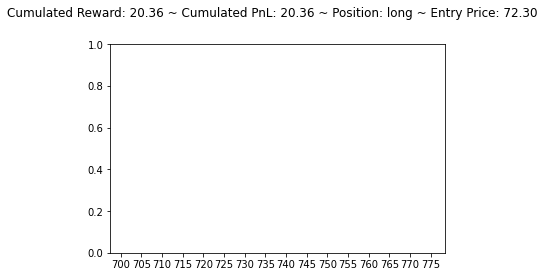

[434.31662 565.7117  456.18555]
long sell flat


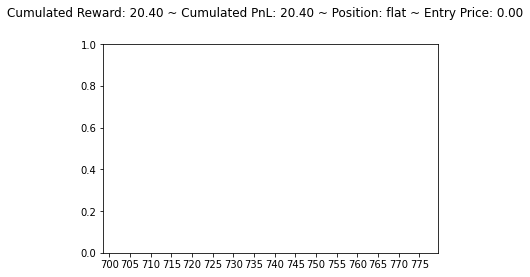

[ 768.1394 1155.9926  979.3004]
flat buy long


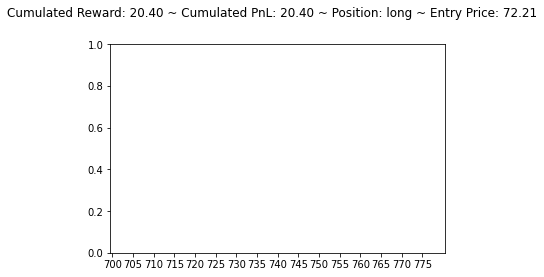

[1034.8679 1059.9021 1089.2069]
long sell flat


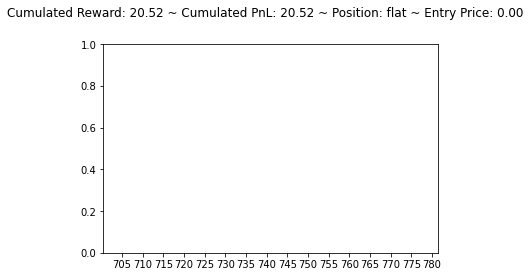

[1058.5269 1107.4769 1065.9875]
flat buy long


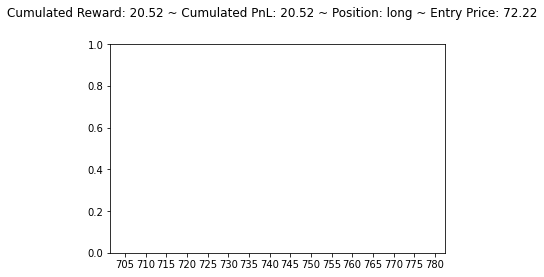

[2124.0303 1553.8368 2233.7231]
long sell flat


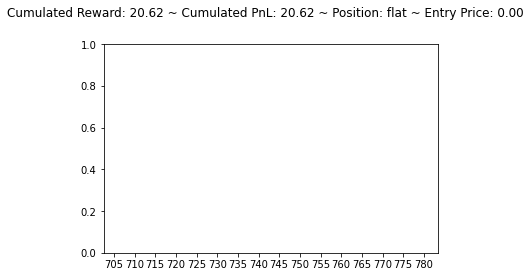

[1344.7677   453.40994 1152.9388 ]
flat hold flat


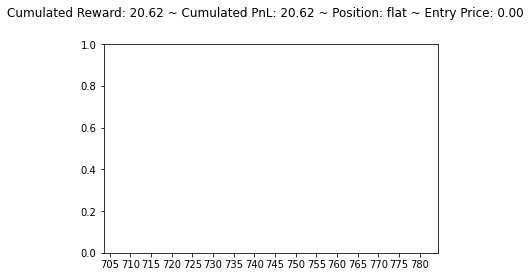

[1014.9221 1069.2843 1025.3892]
flat buy long


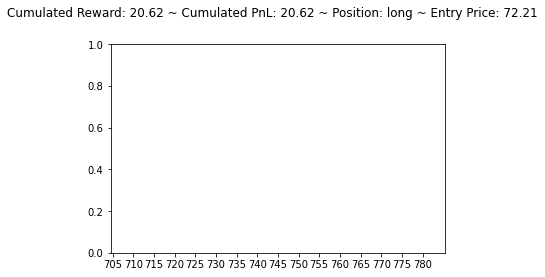

[1037.3318 1095.4255 1075.5753]
long sell flat


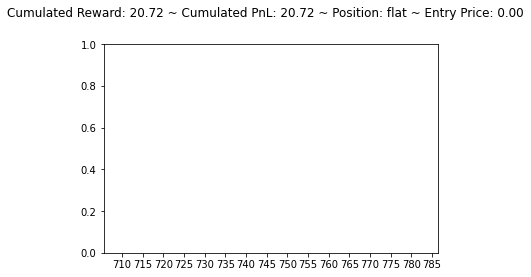

[1071.8694 1101.2517 1045.3396]
flat buy long


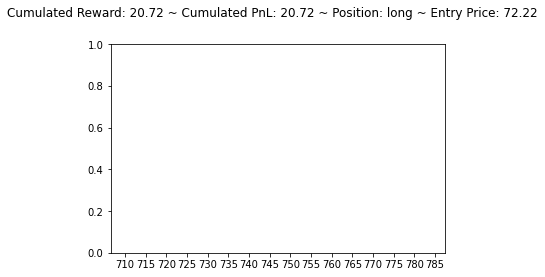

[1079.4717 1124.1821 1107.769 ]
long sell flat


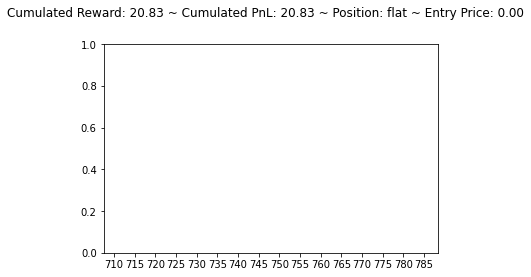

[807.53613 453.44492 555.7646 ]
flat hold flat


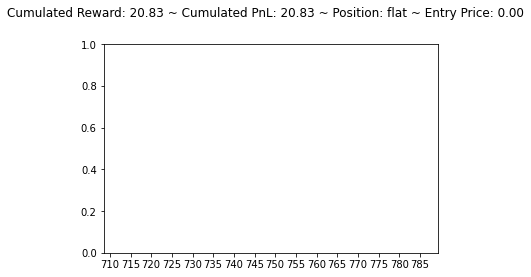

[384.26157 415.60886 341.67285]
flat buy long


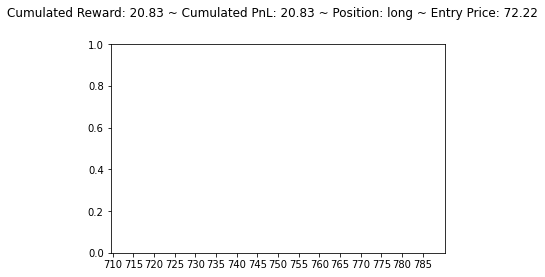

[228.61139 355.31448 296.73987]
long sell flat


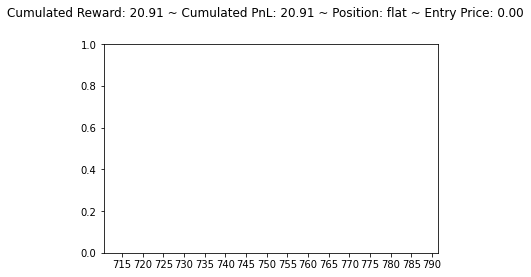

[1120.4167 1224.1912 1140.9645]
flat buy long


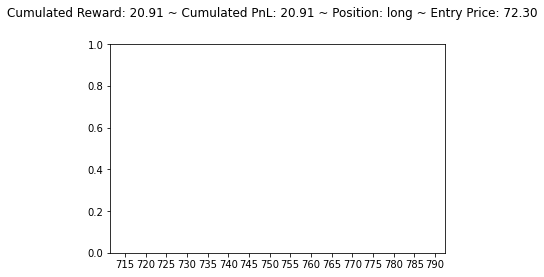

[1064.4363 1119.6487 1101.5901]
long sell flat


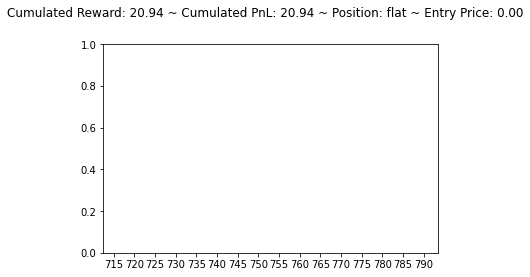

[813.74677 480.5819  591.48737]
flat hold flat


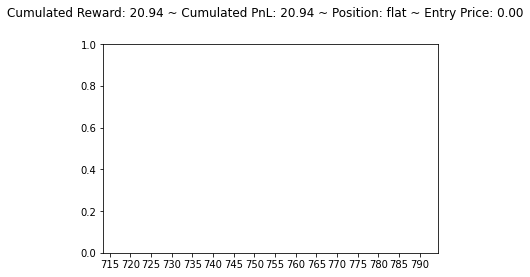

[410.15417 481.86557 456.409  ]
flat buy long


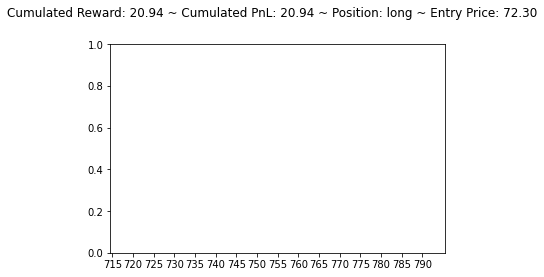

[552.11945 599.6277  555.7829 ]
long sell flat


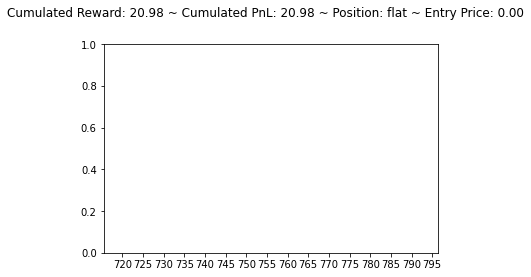

[588.95435 640.72205 581.6485 ]
flat buy long


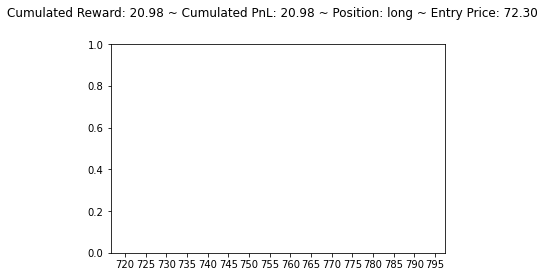

[631.64124 690.719   643.1567 ]
long sell flat


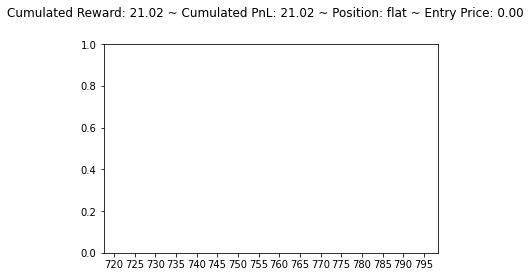

[515.30707 540.9529  555.0744 ]
flat sell short


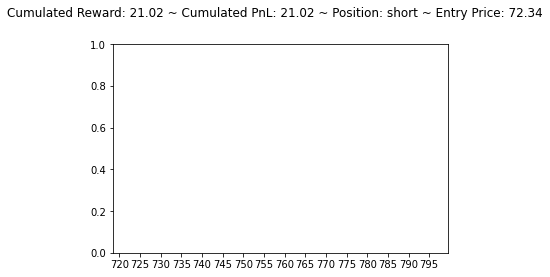

[491.77753 552.99786 405.01718]
short buy flat


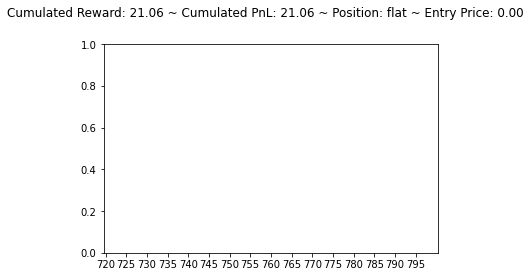

[171.06717 315.7444  196.74553]
flat buy long


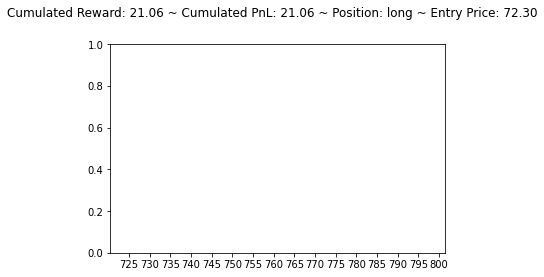

[463.3224  502.09338 398.5366 ]
long hold long


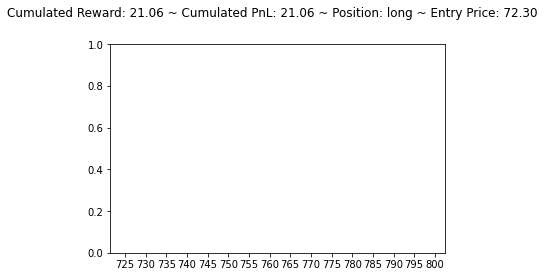

[345.39224 413.0317  405.91864]
long sell flat


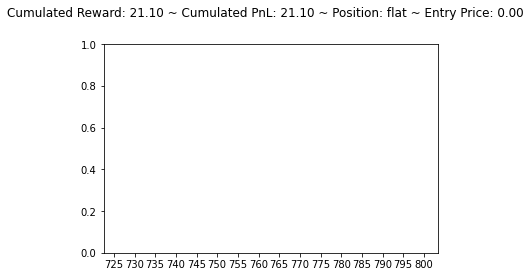

[560.958   516.23553 507.4495 ]
flat hold flat


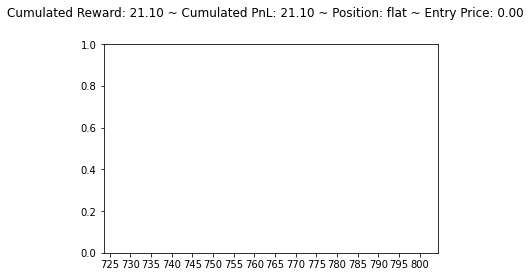

[447.51    522.5008  495.34897]
flat buy long


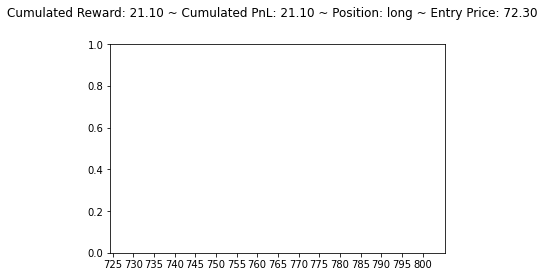

[1280.001  1439.2611 1430.735 ]
long sell flat


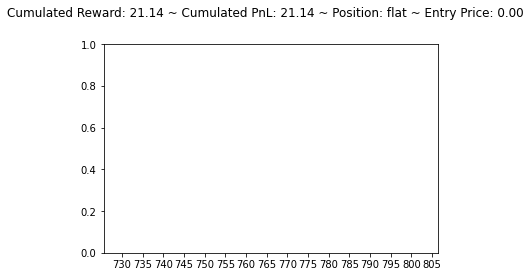

[2269.875  2553.203  1879.9059]
flat buy long


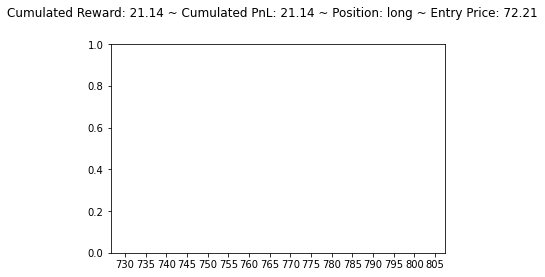

[3290.723  2603.4807 2261.7996]
long hold long


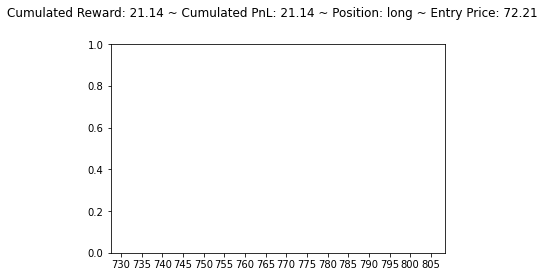

[2933.1257 2935.1387 2336.7178]
long hold long


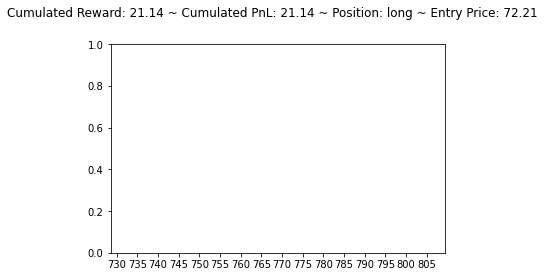

[1652.663  1063.7463 1843.84  ]
long sell flat


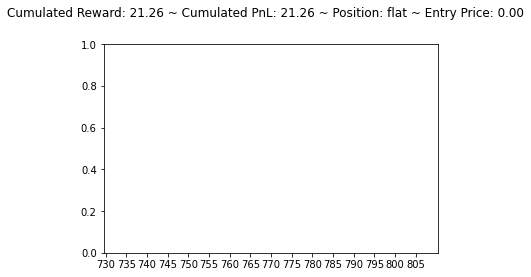

[1131.7864 1168.3215 1088.724 ]
flat buy long


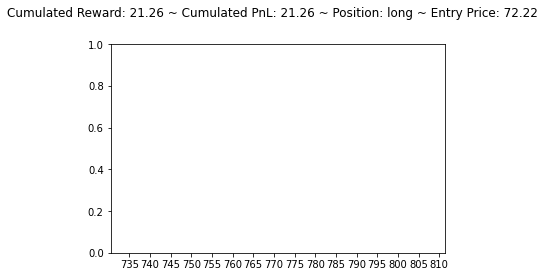

[1138.4602 1184.1167 1171.0449]
long sell flat


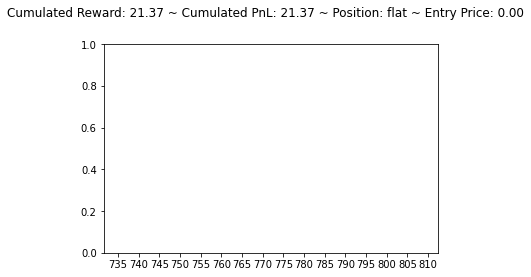

[1099.2028   829.87164  598.9463 ]
flat hold flat


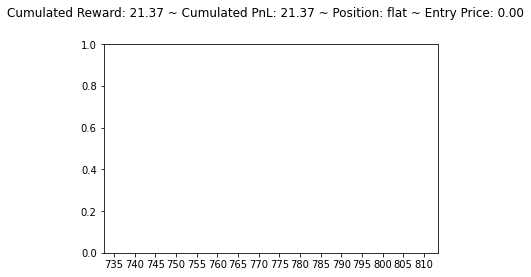

[191.10951 320.898   236.93188]
flat buy long


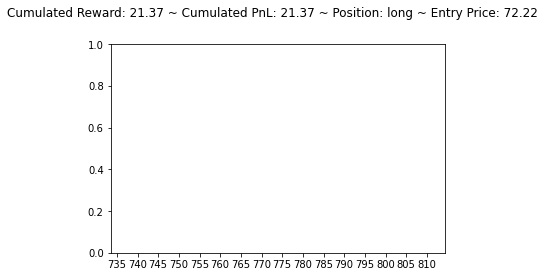

[1115.5334 1186.0825 1152.6199]
long sell flat


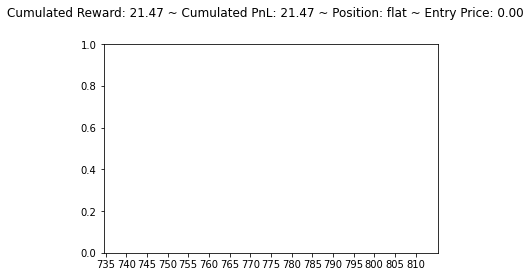

[1015.4257   852.1902   622.39404]
flat hold flat


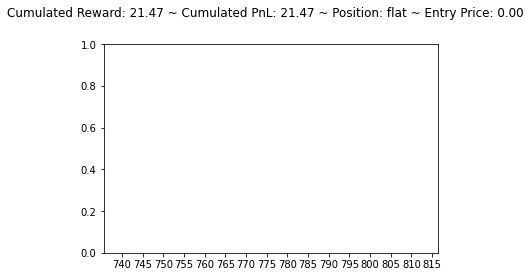

[165.34363 334.40048 266.0493 ]
flat buy long


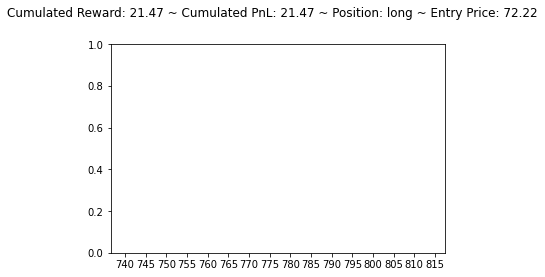

[181.96382 366.41425 310.84738]
long sell flat


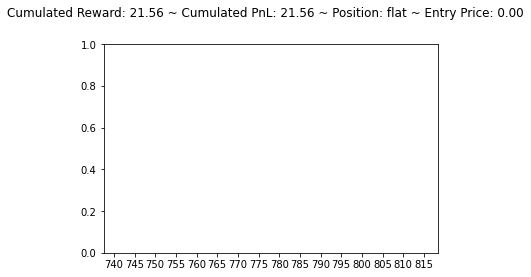

[194.88593 407.4466  293.9975 ]
flat buy long


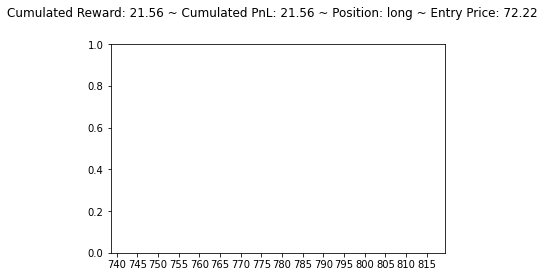

[386.95428 489.38995 426.54373]
long sell flat


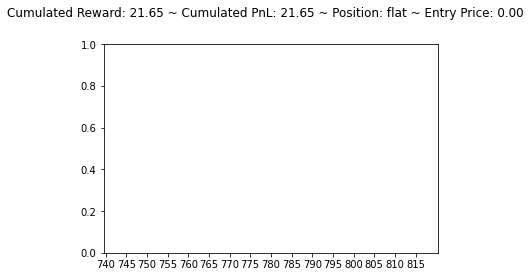

[261.0636  362.58588 348.92624]
flat buy long


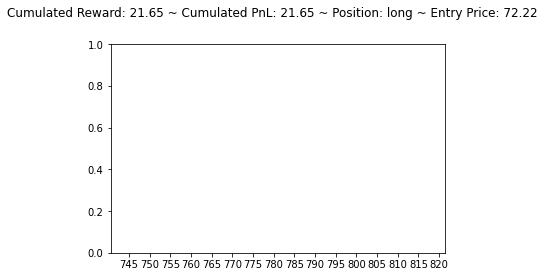

[355.39252 481.23907 395.918  ]
long sell flat


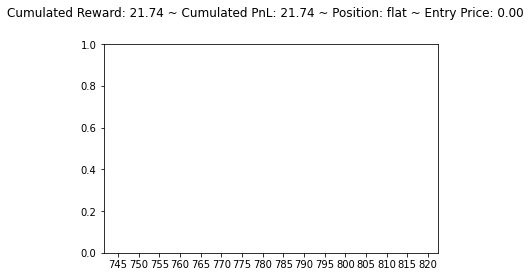

[184.18478 340.08237 286.80768]
flat buy long


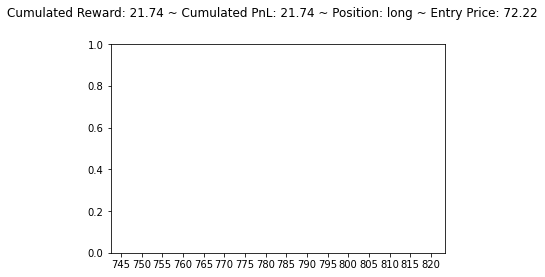

[223.041  425.9628 338.9574]
long sell flat


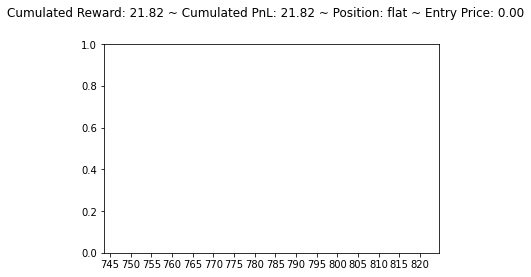

[206.09743 346.93707 289.06482]
flat buy long


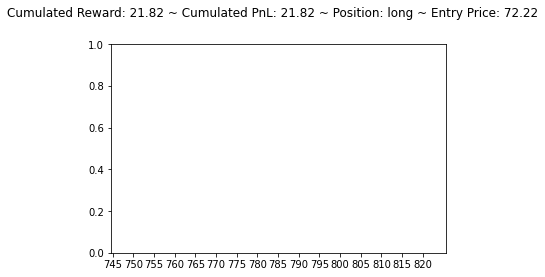

[256.62167 459.19025 358.40353]
long sell flat


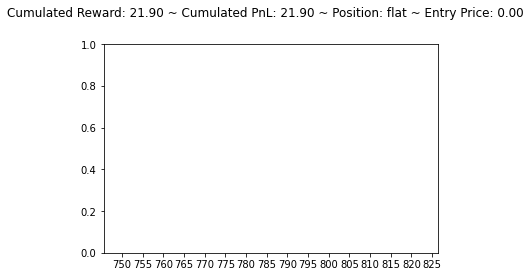

[240.61093 397.90878 315.18384]
flat buy long


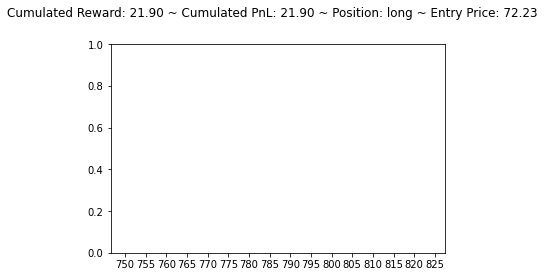

[262.05792 454.92795 369.78113]
long sell flat


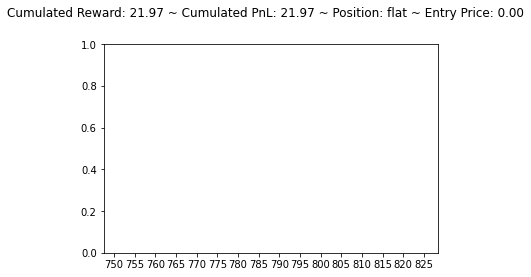

[251.48143 416.9732  327.90555]
flat buy long


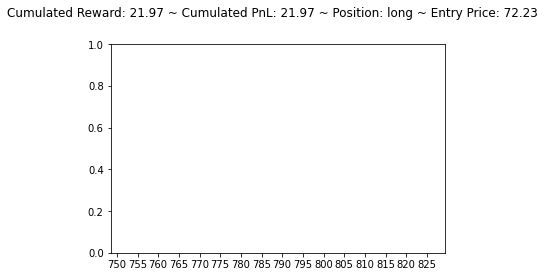

[303.83734 572.734   467.87228]
long sell flat


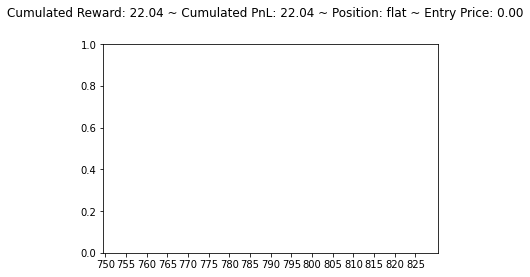

[361.78357 554.12726 464.4237 ]
flat buy long


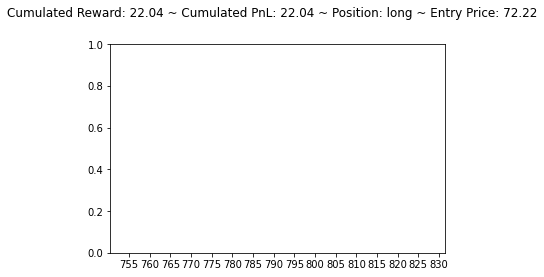

[333.13235 473.58807 460.62402]
long sell flat


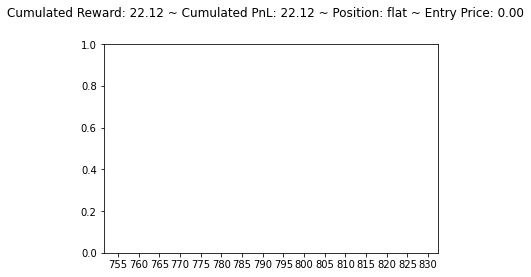

[233.1571  306.05646 264.69617]
flat buy long


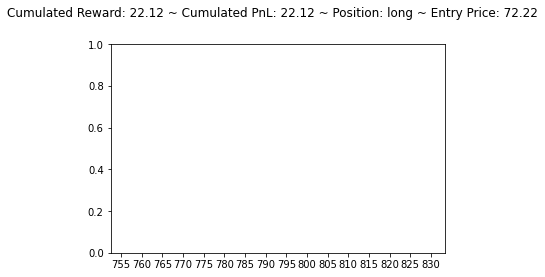

[164.08284 382.09872 324.83603]
long sell flat


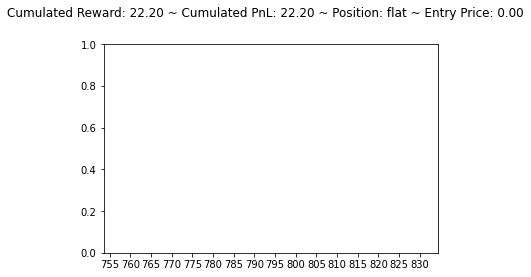

[ 943.94617 1566.2083   976.9371 ]
flat buy long


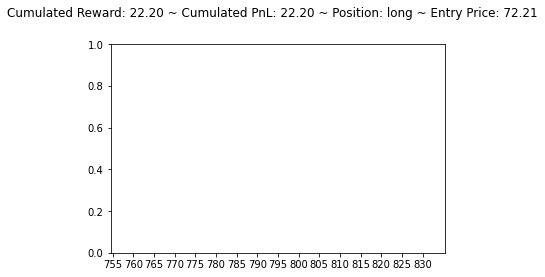

[658.299  723.0587 463.0467]
long hold long


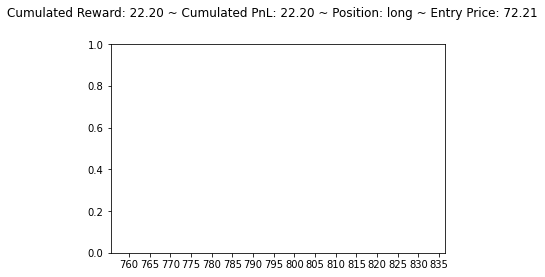

[257.5699  441.79376 363.6402 ]
long sell flat


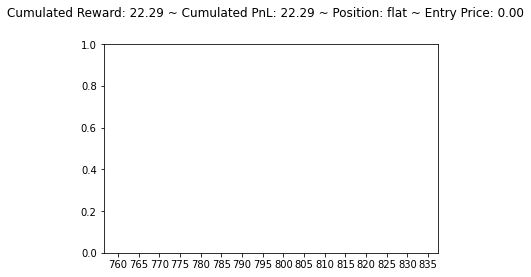

[ 972.17896 1768.3463  1066.9746 ]
flat buy long


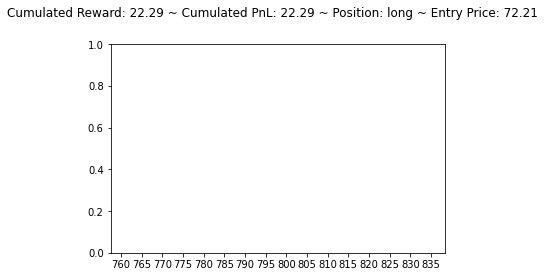

[1228.6636 2299.0078 1941.6842]
long sell flat


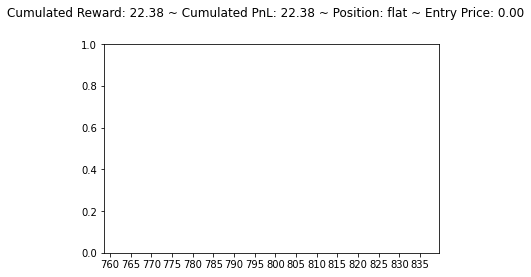

[605.8959  698.45703 373.82794]
flat buy long


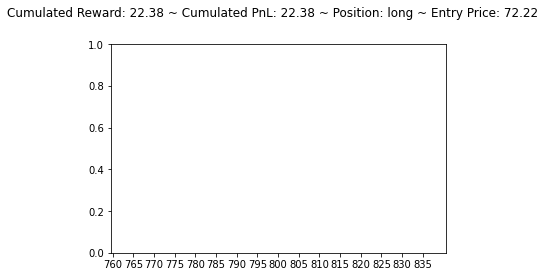

[ 978.7815 1832.6122 1075.9213]
long sell flat


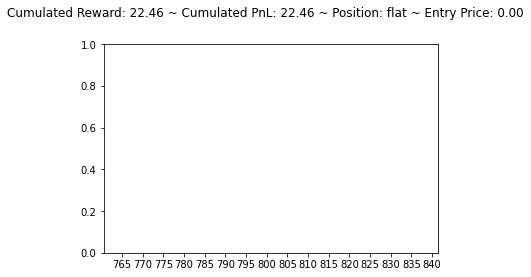

[1204.1633 2397.8088 1890.9325]
flat buy long


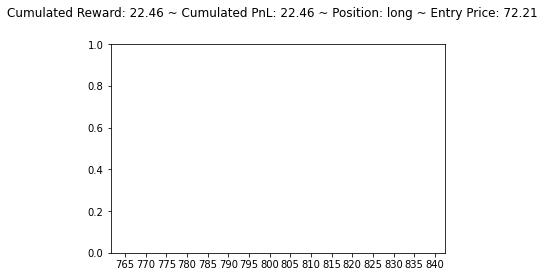

[1225.054  2282.0361 1937.9728]
long sell flat


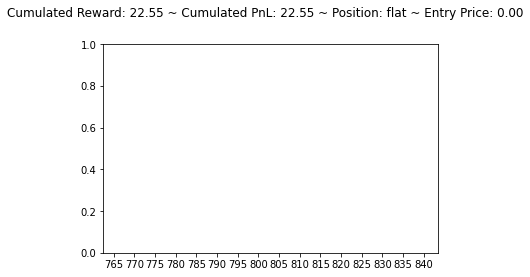

[607.5242  677.6729  408.12024]
flat buy long


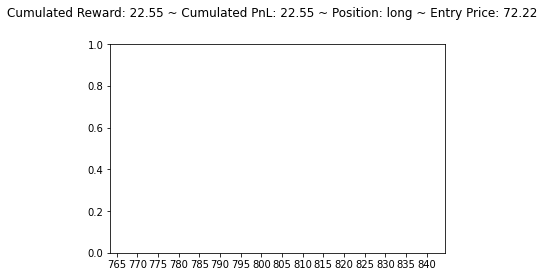

[310.2382  422.47174 359.39423]
long sell flat


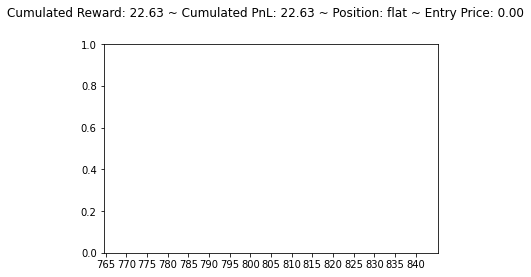

[329.87994 451.91537 420.43   ]
flat buy long


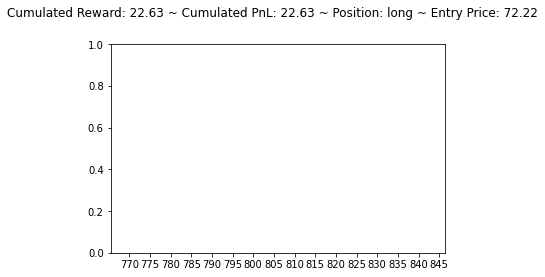

[244.01451 397.25397 287.47516]
long sell flat


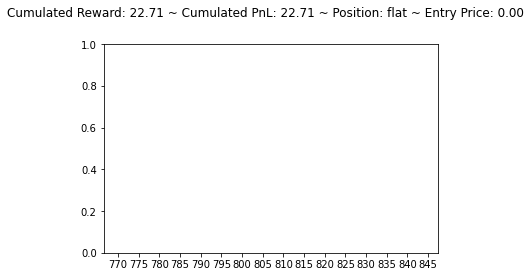

[271.43146 380.9937  303.43243]
flat buy long


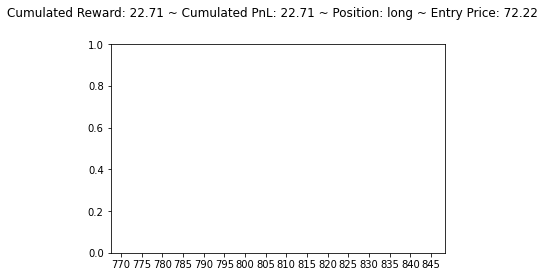

[479.20407 617.8476  533.804  ]
long sell flat


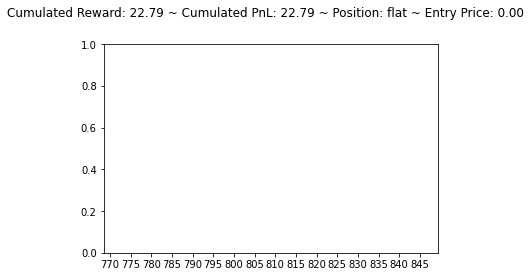

[350.46466 492.97055 408.60425]
flat buy long


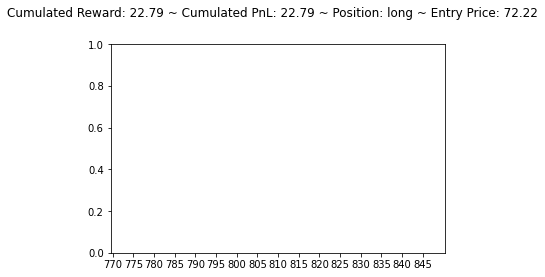

[353.448   491.19418 474.40967]
long sell flat


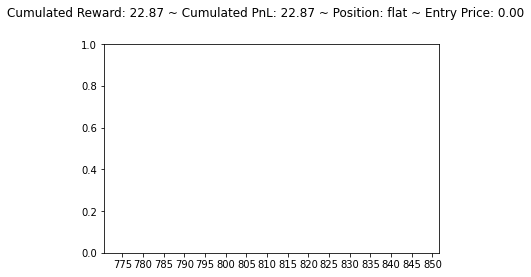

[310.34192 437.95175 405.55017]
flat buy long


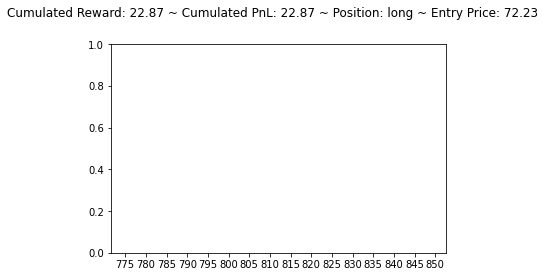

[303.3338 500.0217 465.1078]
long sell flat


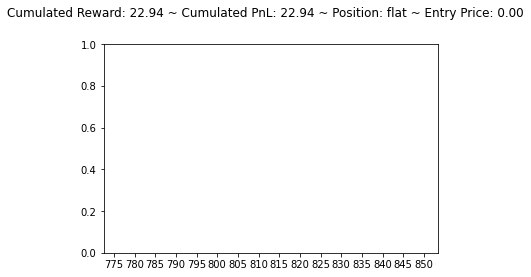

[202.77267 355.35934 284.93134]
flat buy long


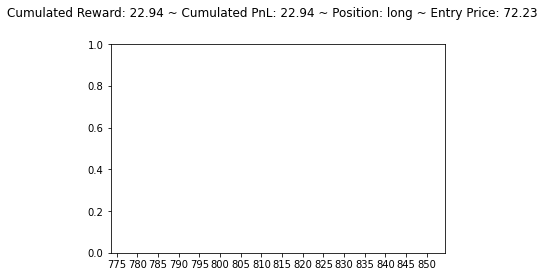

[255.99275 472.93222 365.6215 ]
long sell flat


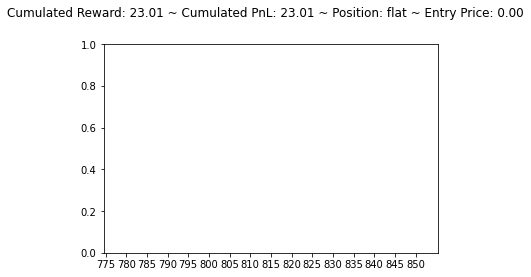

[ 966.4997 1142.1224 1049.4547]
flat buy long


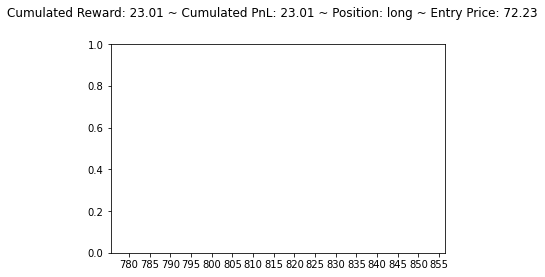

[2442.9539 2108.6353 1996.1012]
long hold long


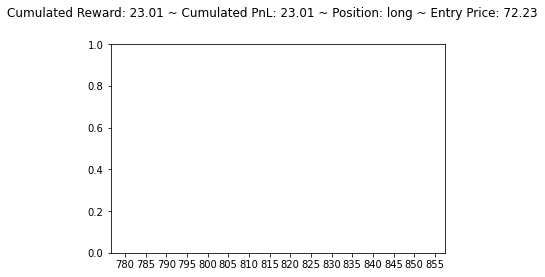

[1583.1436  963.2889 1853.5912]
long sell flat


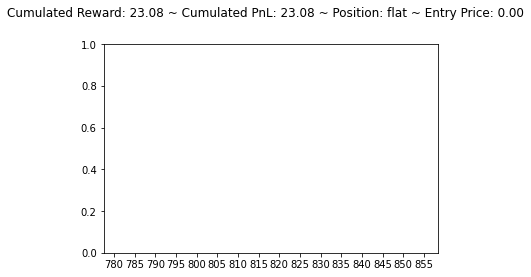

[1012.4322 1054.1323 1028.0852]
flat buy long


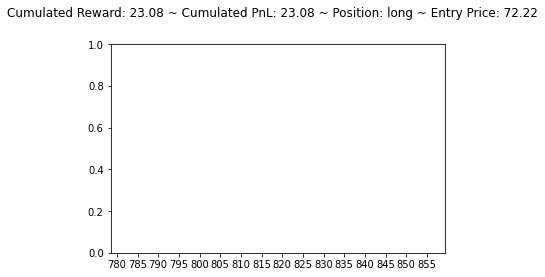

[1050.671    863.28564  618.4895 ]
long hold long


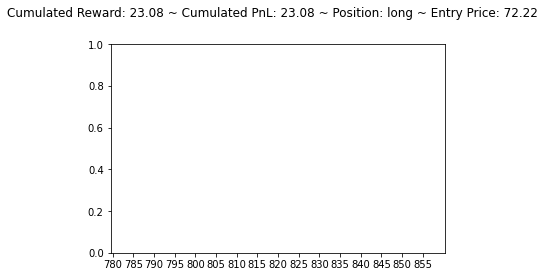

[288.98572 337.64304 244.48302]
long hold long


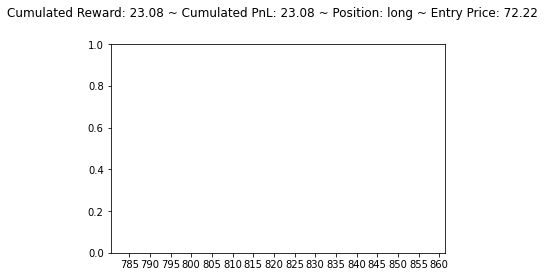

[ 900.99927 1944.7026  1144.0273 ]
long sell flat


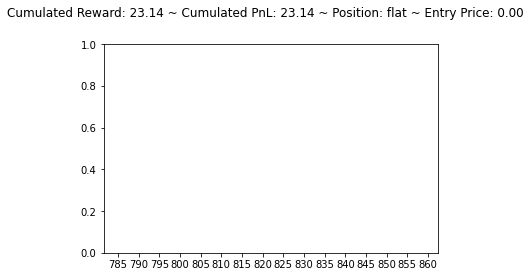

[594.17645 583.0271  513.45746]
flat hold flat


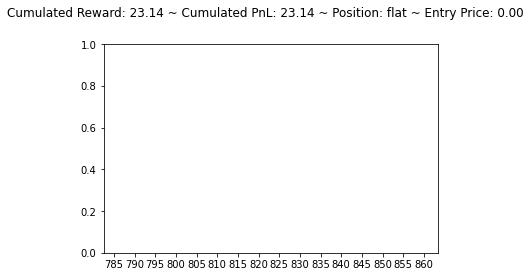

[313.12067 443.9302  400.70618]
flat buy long


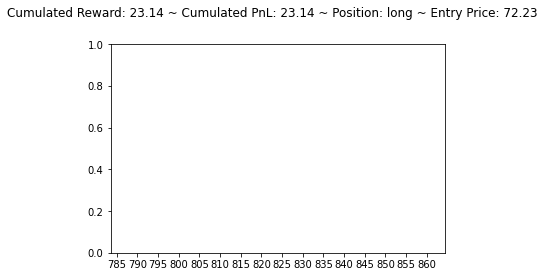

[335.8193  468.22083 461.11493]
long sell flat


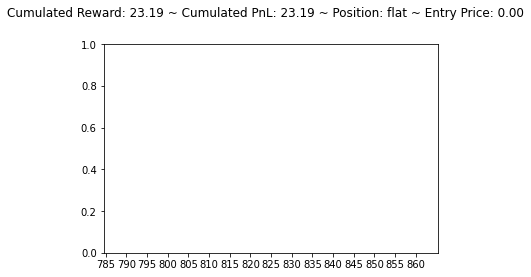

[1064.2668 1674.4801 1115.8326]
flat buy long


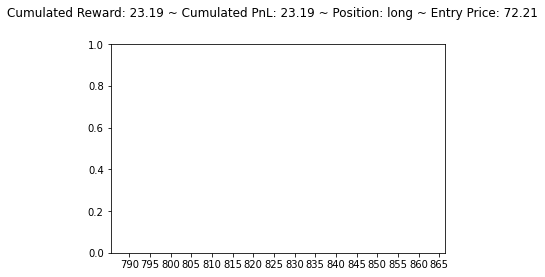

[1363.739  2402.5193 1995.4354]
long sell flat


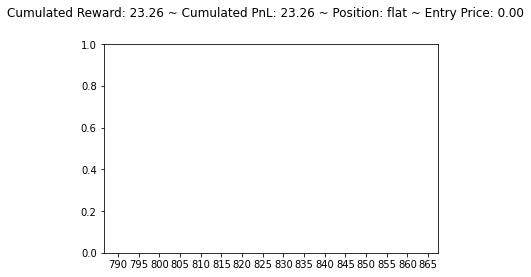

[1383.0184 2526.0642 2015.7096]
flat buy long


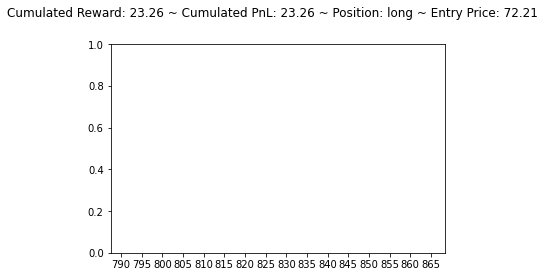

[692.39624 697.5216  554.01324]
long hold long


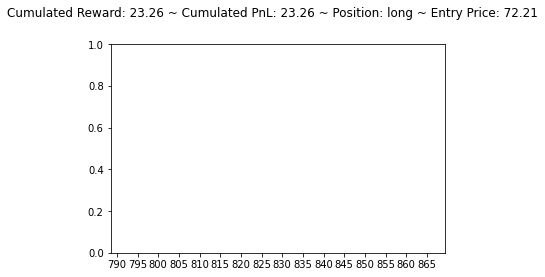

[242.42426 386.65536 284.02277]
long sell flat


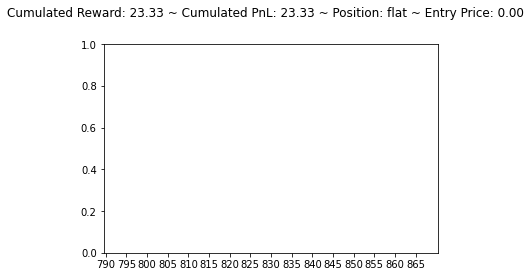

[238.14041 372.30142 295.34872]
flat buy long


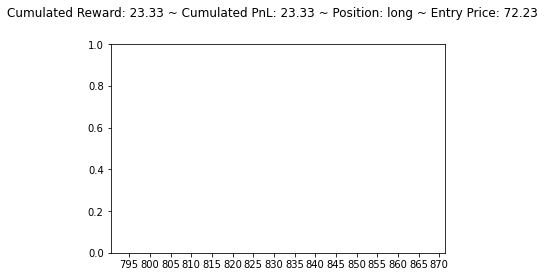

[346.58142 480.6034  464.72253]
long sell flat


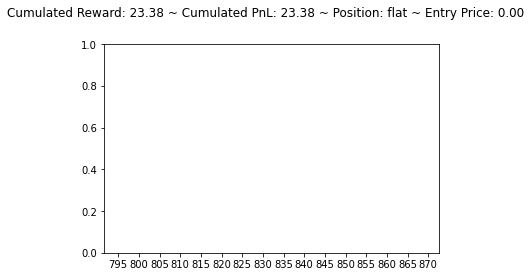

[302.37848 545.1663  461.73718]
flat buy long


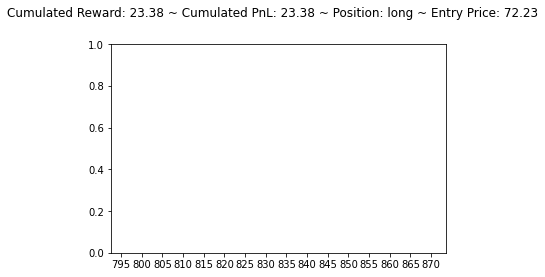

[318.5537 559.882  552.3321]
long sell flat


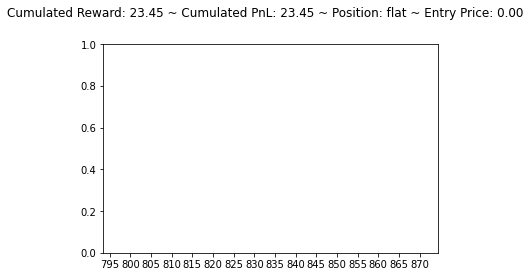

[1018.71783 1200.3092  1071.8452 ]
flat buy long


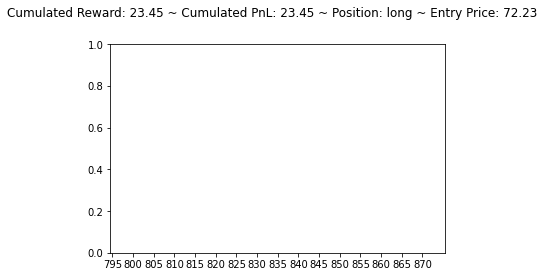

[1083.203  1122.6506 1124.0126]
long sell flat


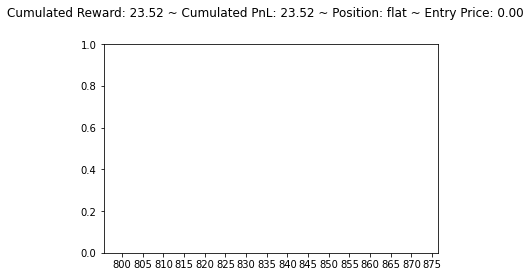

[1044.2913 1095.5552 1065.9987]
flat buy long


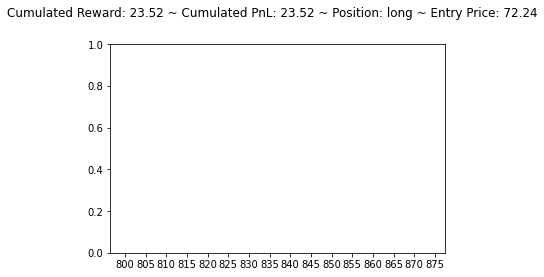

[1044.1196   960.11444  831.7481 ]
long hold long


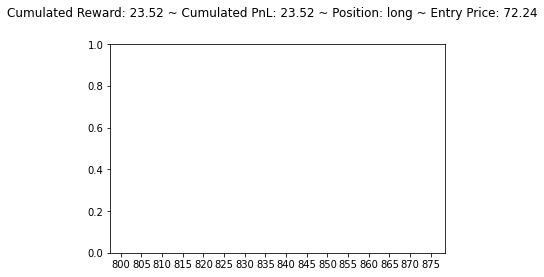

[1071.3434  1428.73     980.78204]
long hold long


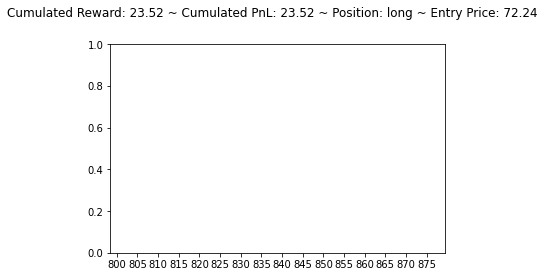

[2868.8044 2133.0828 1910.4124]
long hold long


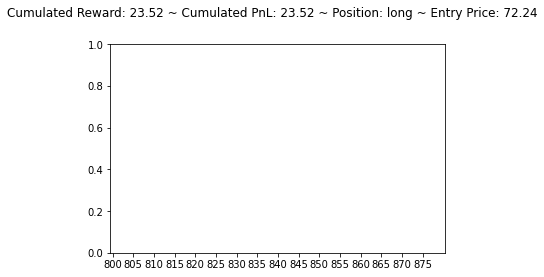

[1450.113 1059.017 1708.026]
long sell flat


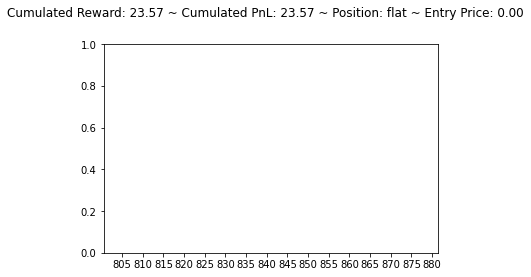

[947.9607  878.02734 756.94275]
flat hold flat


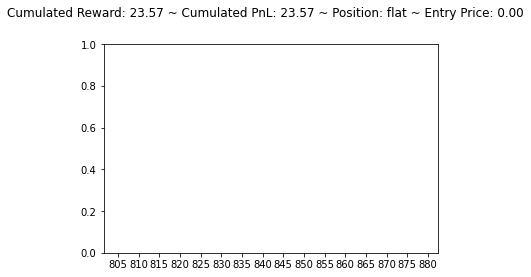

[304.04657 542.00543 457.17886]
flat buy long


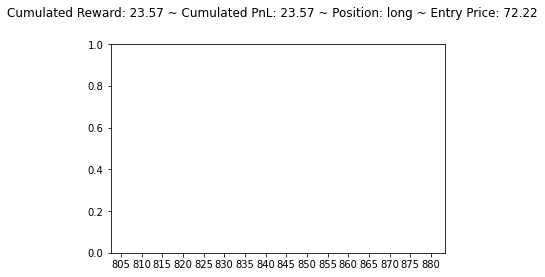

[323.8055 549.8234 541.3004]
long sell flat


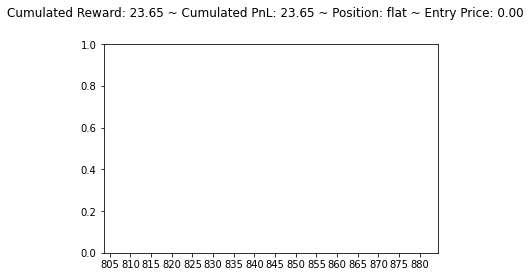

[1066.9933 1243.3434 1125.3114]
flat buy long


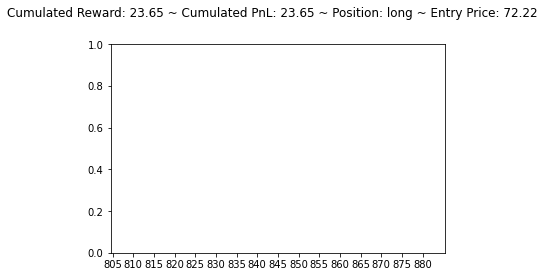

[1122.4563 1159.4265 1162.5881]
long sell flat


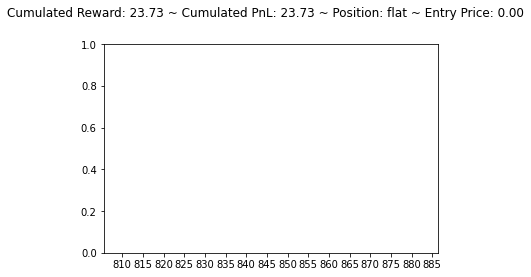

[1023.34985  937.88617 1079.7795 ]
flat sell short


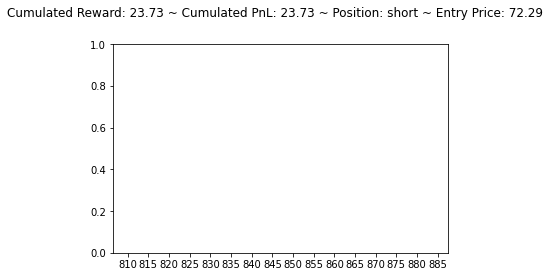

[953.29333 907.7738  794.3598 ]
short hold short


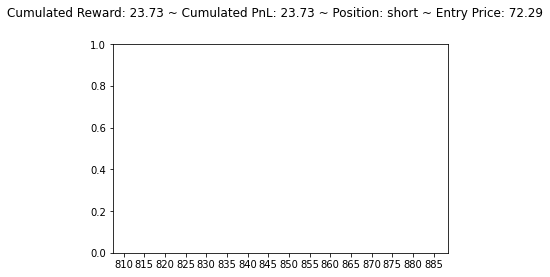

[1118.7235 1262.561  1174.9536]
short buy flat


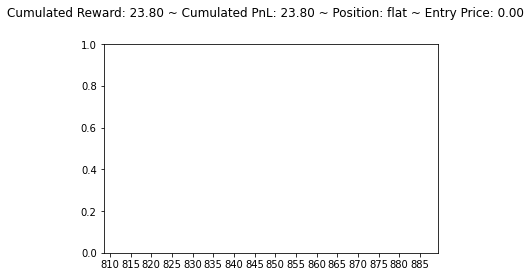

[1055.3547 1068.3546 1088.9994]
flat sell short


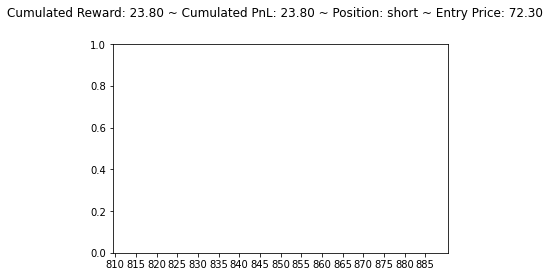

[ 987.53204 1033.4673  1080.1874 ]
short buy flat


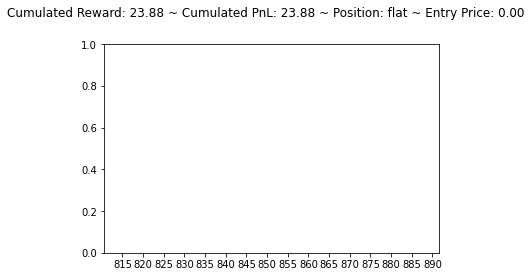

[ 917.13574 1147.9995  1143.4813 ]
flat buy long


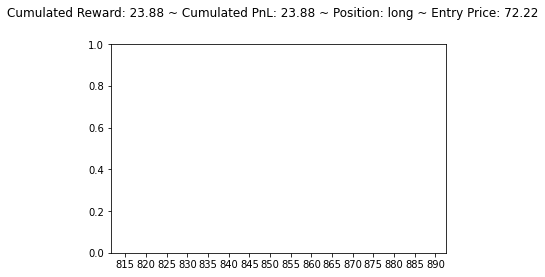

[669.64    736.9698  677.58704]
long sell flat


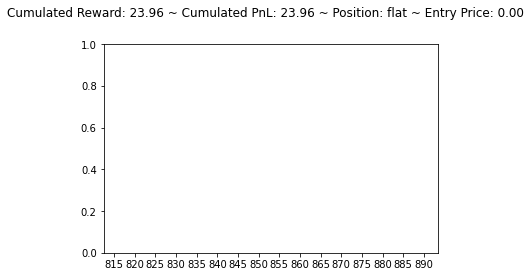

[412.31274 697.5991  717.41254]
flat sell short


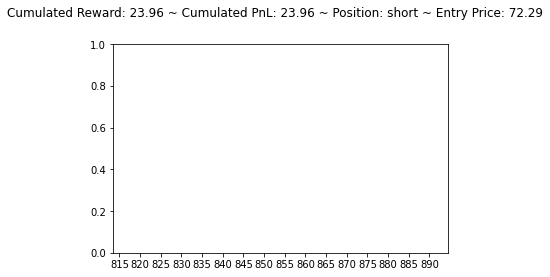

[447.8579  940.0189  750.60846]
short buy flat


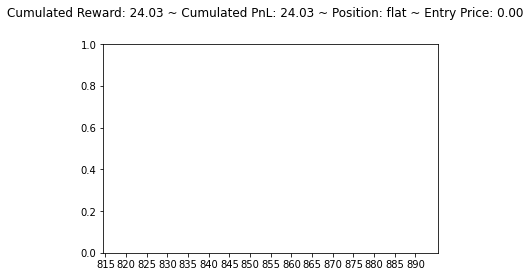

[564.04034 677.47205 585.61426]
flat buy long


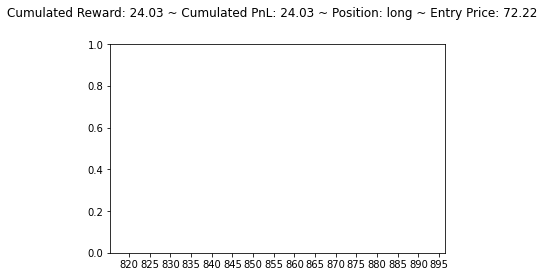

[636.44806 786.6116  683.73785]
long sell flat


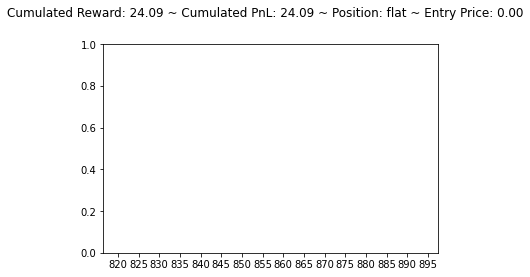

[453.0363  558.2679  468.58765]
flat buy long


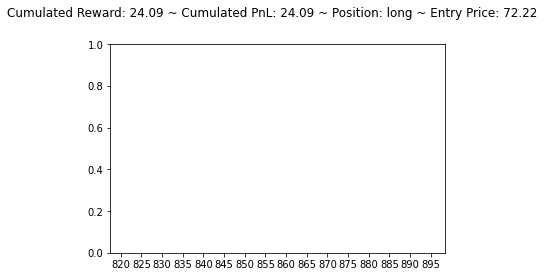

[456.9483  556.2552  512.02466]
long sell flat


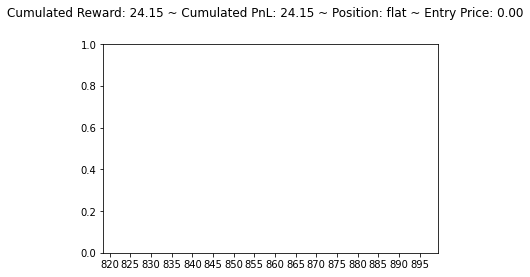

[347.0819  500.65076 481.65085]
flat buy long


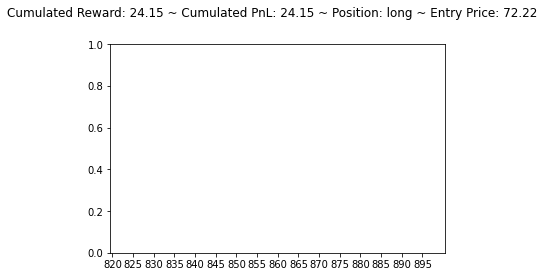

[488.1644 623.6919 526.1714]
long sell flat


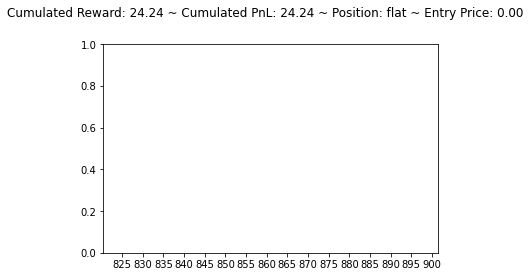

[427.57272 538.89825 471.35428]
flat buy long


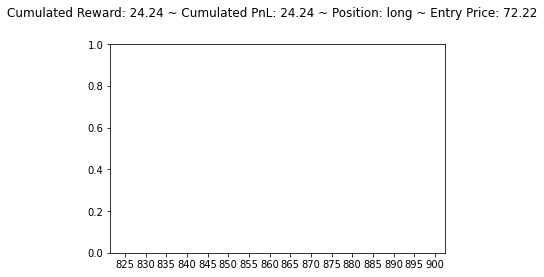

[543.0108  576.97473 564.82684]
long sell flat


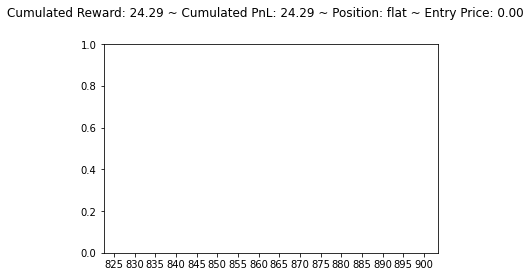

[402.1847  596.46765 504.01813]
flat buy long


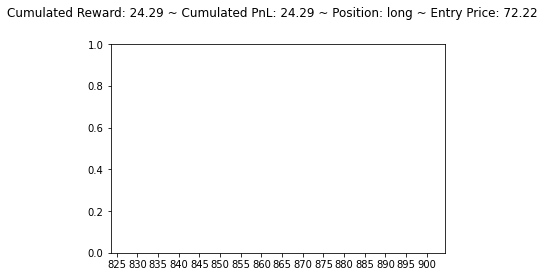

[578.44586 727.7082  617.5071 ]
long sell flat


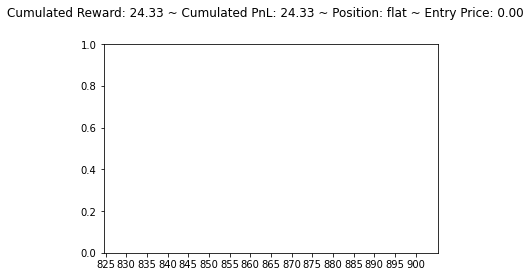

[588.53687 711.87915 588.3961 ]
flat buy long


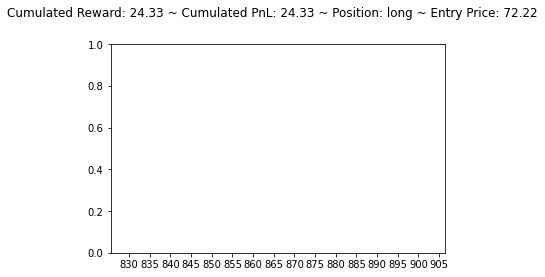

[440.51447 672.21655 693.9115 ]
long sell flat


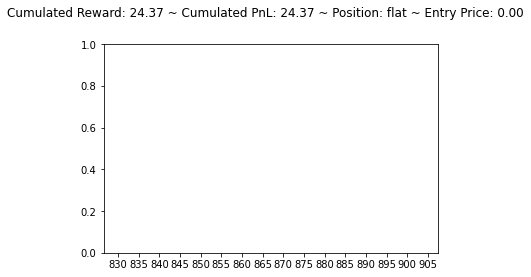

[706.3963 739.4979 638.0185]
flat buy long


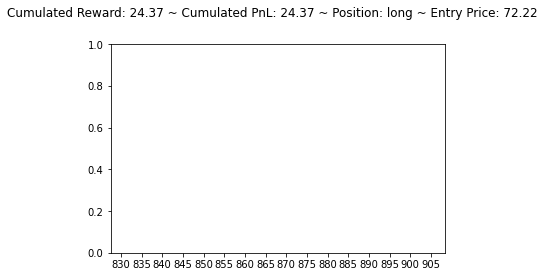

[411.95898 607.3181  512.73724]
long sell flat


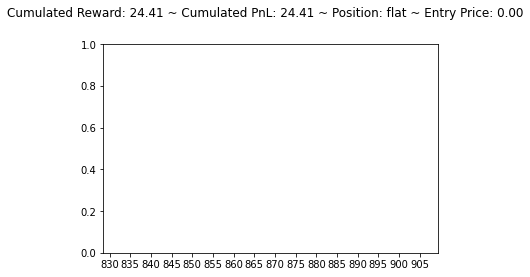

[390.2365 507.0796 443.7327]
flat buy long


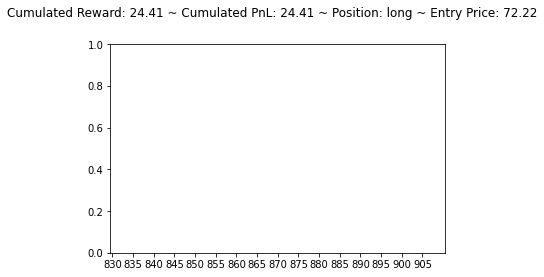

[1145.0023 1259.5254 1109.8386]
long hold long


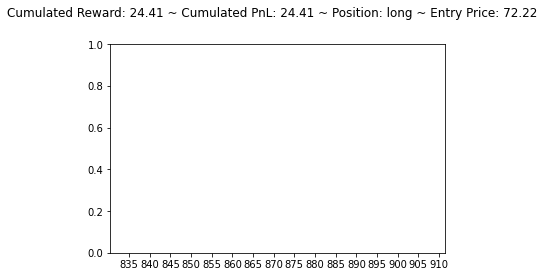

[1039.7638 1885.4412 1639.7748]
long sell flat


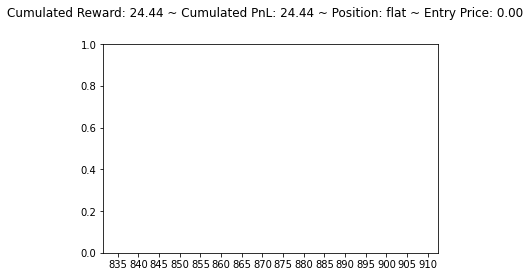

[1077.4738 1884.0225 1523.5159]
flat buy long


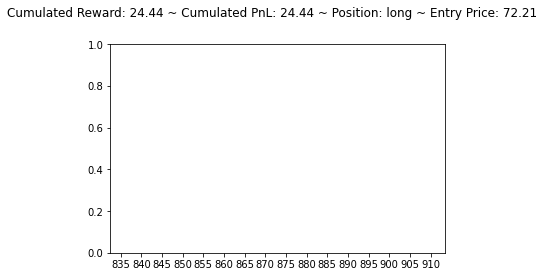

[1024.2251 1893.6565 1679.4644]
long sell flat


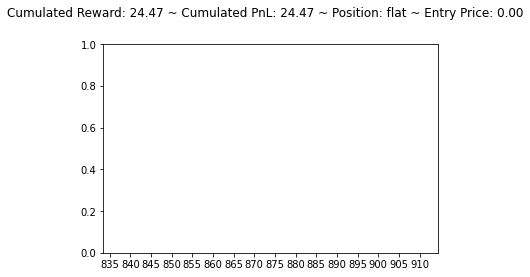

[1037.9495 1890.2007 1455.9496]
flat buy long


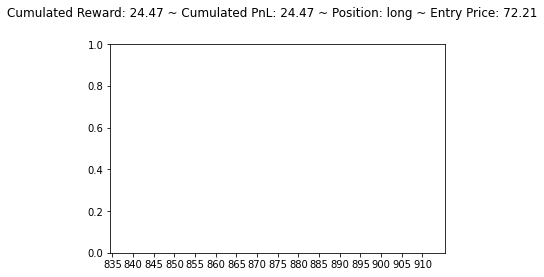

[511.89783 568.62354 409.22687]
long hold long


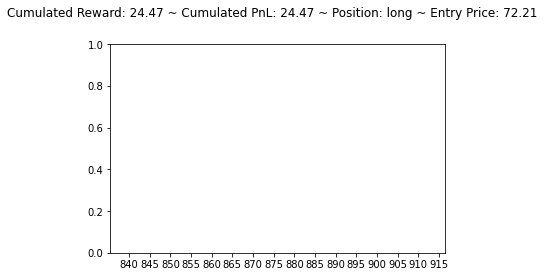

[240.23997 386.2493  339.62213]
long sell flat


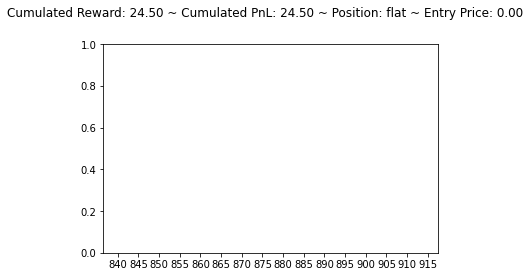

[274.06992 438.45728 389.72327]
flat buy long


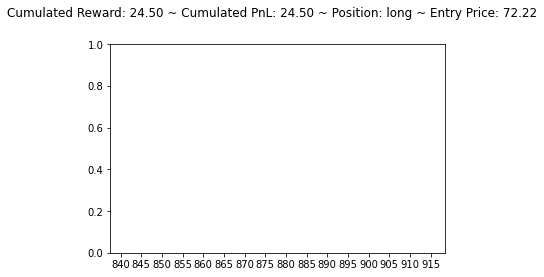

[ 857.1327 1290.2627  815.5916]
long hold long


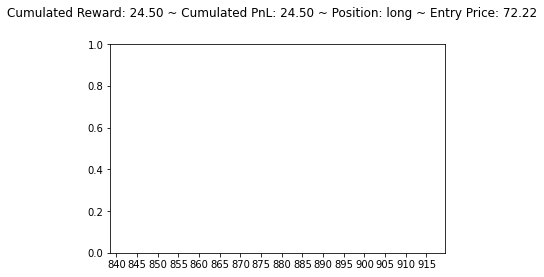

[574.9733  622.9487  457.26666]
long hold long


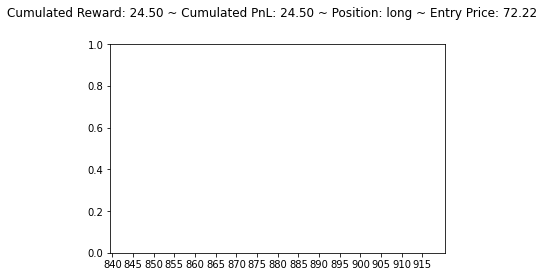

[292.3222  503.74203 404.1412 ]
long sell flat


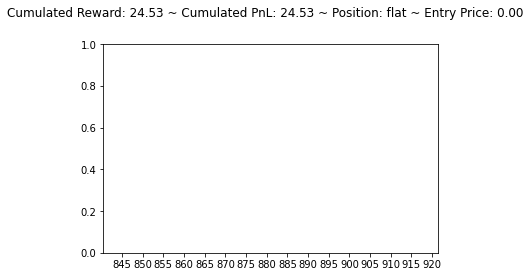

[327.17728 435.21542 356.18607]
flat buy long


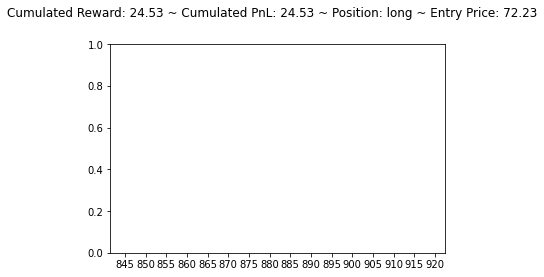

[377.62445 510.06485 485.16953]
long sell flat


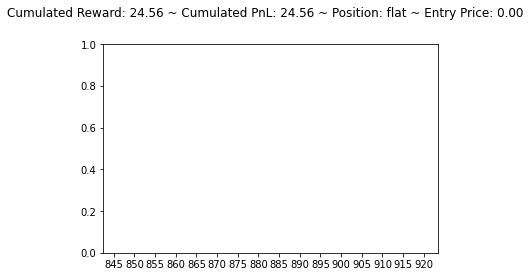

[713.97095 825.21075 662.3162 ]
flat buy long


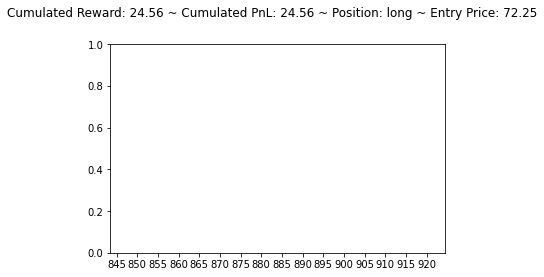

[632.9241  765.19794 724.11053]
long sell flat


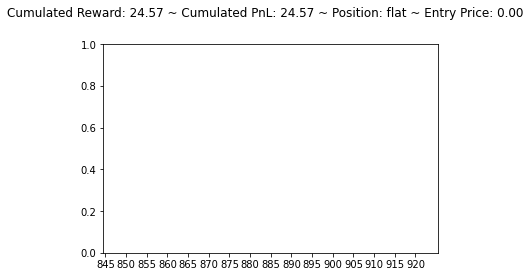

[317.81012 454.0024  401.37683]
flat buy long


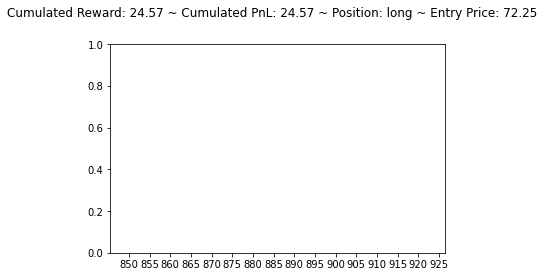

[303.34518 440.0002  437.71396]
long sell flat


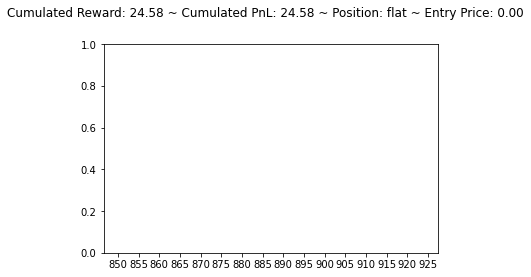

[224.03418 361.65375 340.77838]
flat buy long


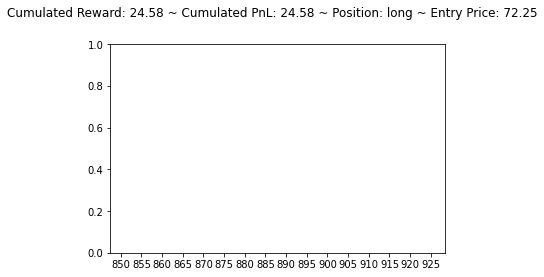

[227.99991 367.70337 328.667  ]
long sell flat


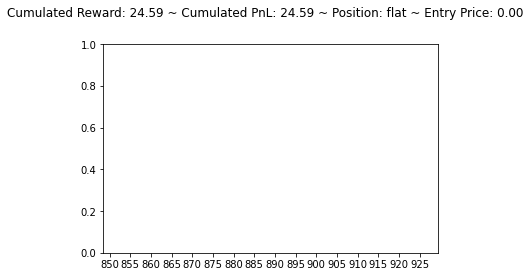

[231.70328 413.34518 435.31848]
flat sell short


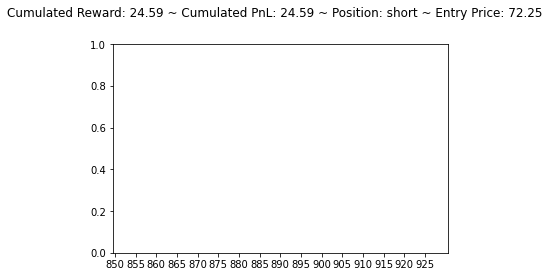

[1054.0481 1577.7456  784.4273]
short buy flat


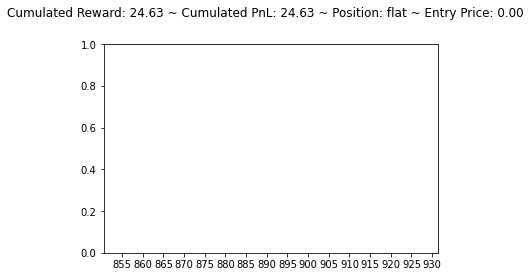

[1147.5398 1997.0714 1642.9161]
flat buy long


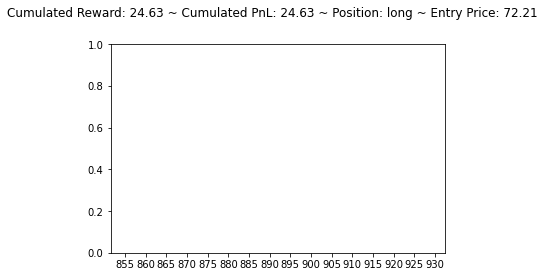

[557.9816  532.07153 550.252  ]
long hold long


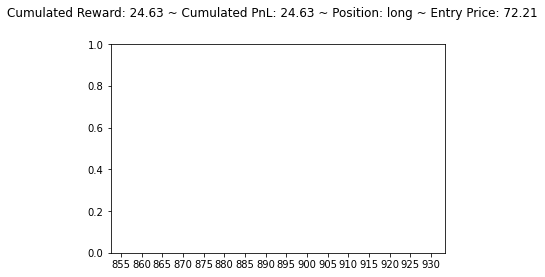

[240.16382 388.90875 282.8935 ]
long sell flat


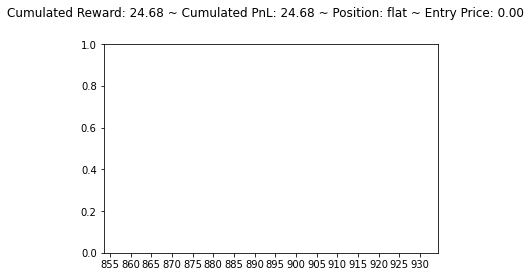

[ 765.03613 1605.2218   933.0236 ]
flat buy long


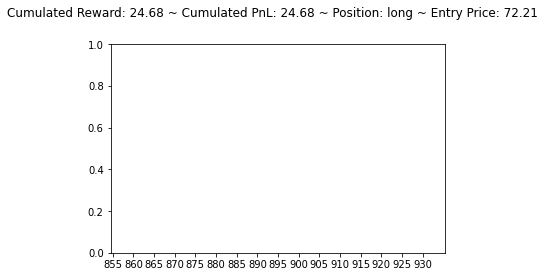

[1162.7737 1971.9856 1703.5376]
long sell flat


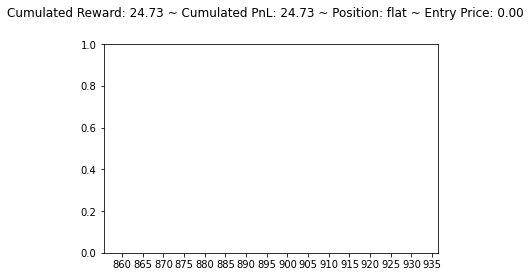

[495.4892  467.58804 503.81903]
flat sell short


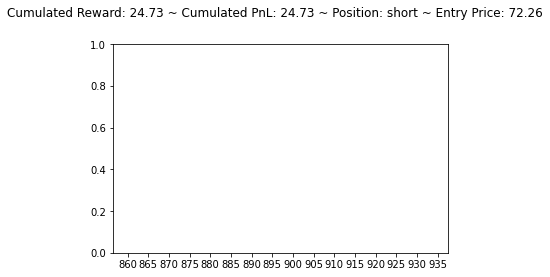

[470.05167 609.35156 494.5112 ]
short buy flat


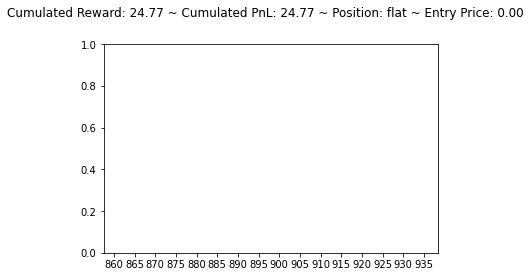

[553.14777 577.9517  521.1789 ]
flat buy long


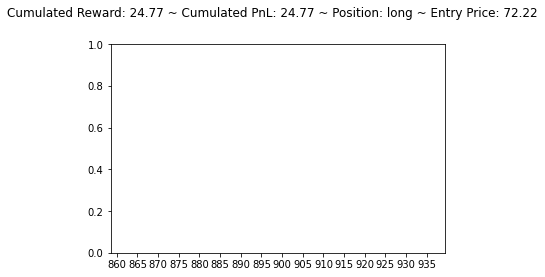

[463.2564 652.8024 586.7824]
long sell flat


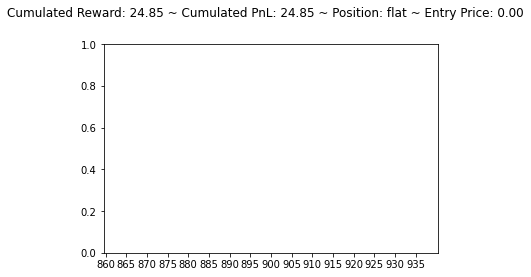

[ 961.96344 1108.7092   922.29596]
flat buy long


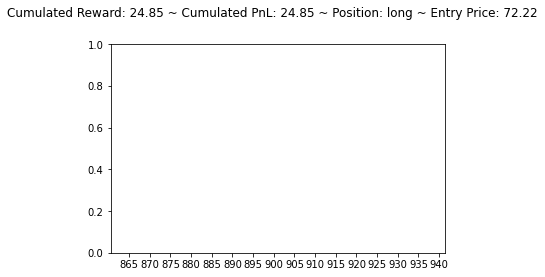

[ 805.6531  1020.33655  967.8107 ]
long sell flat


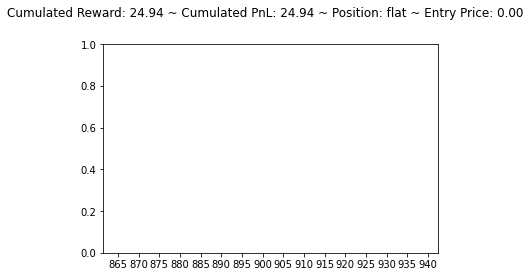

[230.8235  319.28088 212.82782]
flat buy long


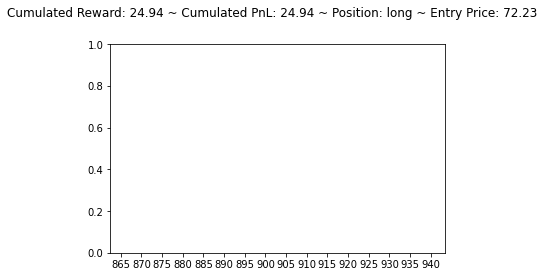

[110.56545 296.71606 272.2212 ]
long sell flat


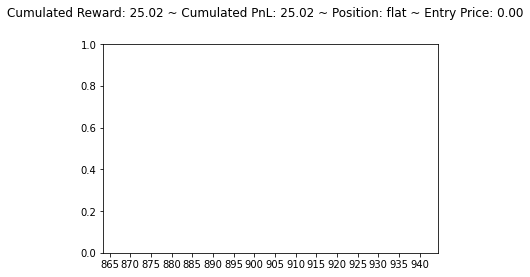

[172.0306  302.72882 280.22418]
flat buy long


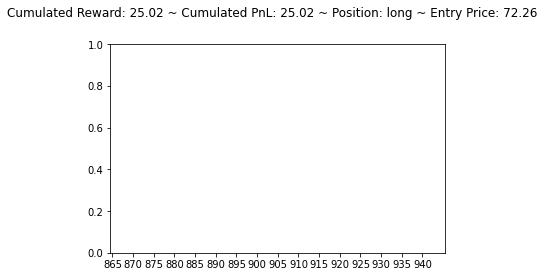

[171.79462 367.04742 296.71265]
long sell flat


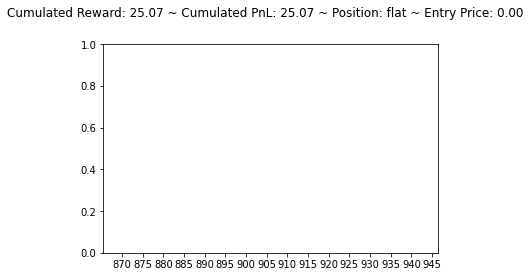

[148.6319  330.8736  246.37798]
flat buy long


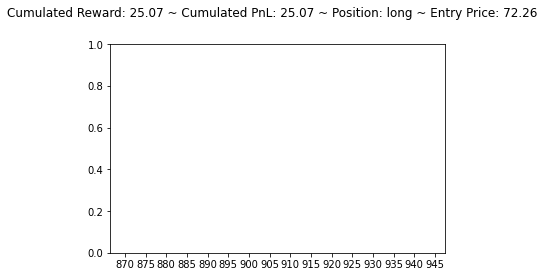

[161.34705 361.54    245.5069 ]
long sell flat


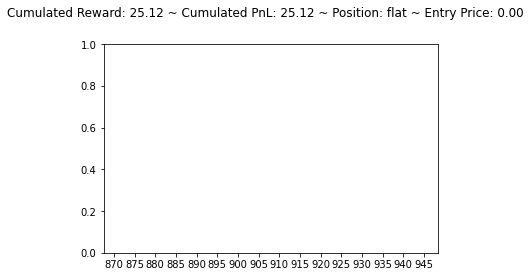

[146.83733 304.48843 158.44357]
flat buy long


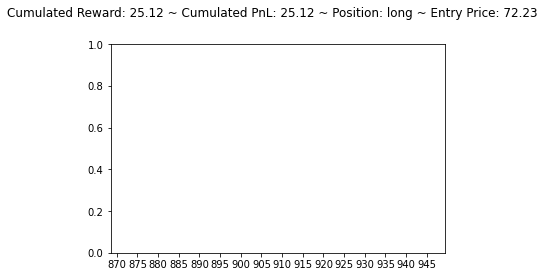

[365.72824 299.84824 254.29001]
long hold long


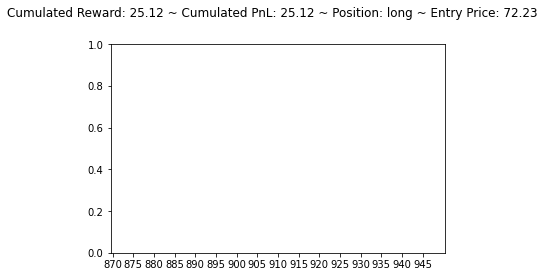

[229.92361 414.35095 430.5899 ]
long sell flat


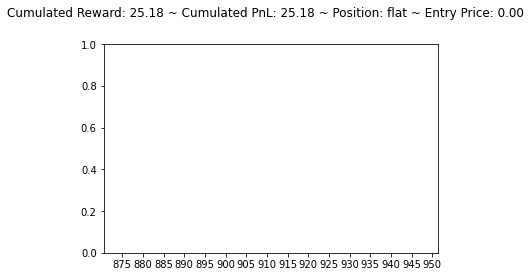

[286.78815 397.62906 323.66824]
flat buy long


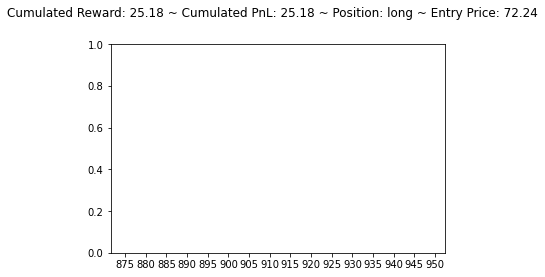

[290.73245 430.22073 428.4337 ]
long sell flat


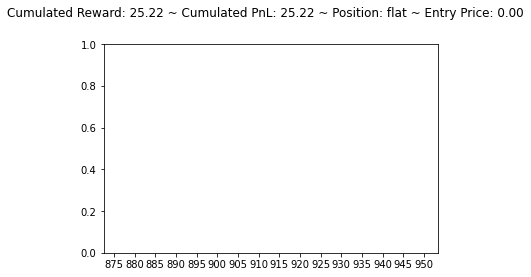

[320.77185 447.9472  379.12216]
flat buy long


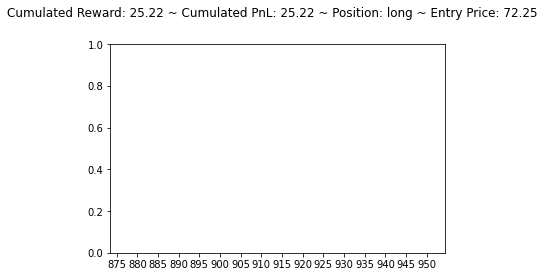

[344.94254 480.118   464.59335]
long sell flat


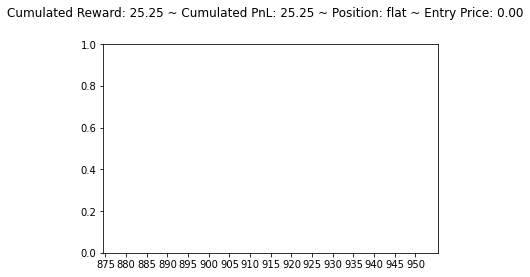

[343.75632 459.5284  426.8207 ]
flat buy long


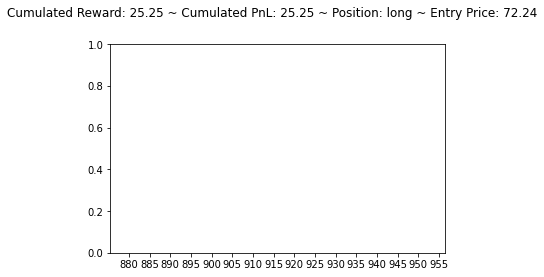

[343.995   479.2518  463.99524]
long sell flat


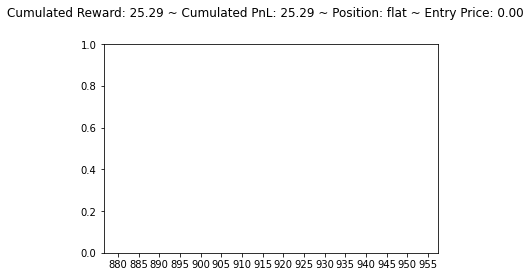

[332.0653  470.59146 422.61255]
flat buy long


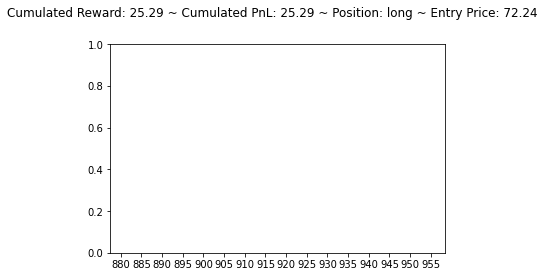

[321.3544  478.11826 431.65836]
long sell flat


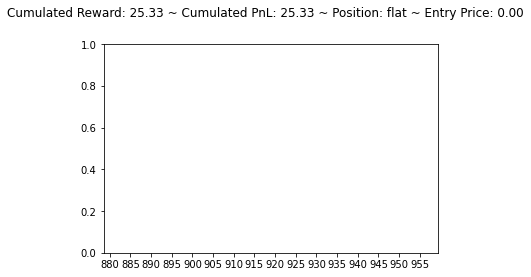

[897.1123 901.1688 782.5613]
flat buy long


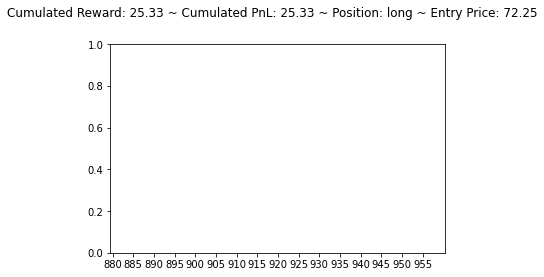

[ 772.3263 1334.2302 1222.287 ]
long sell flat


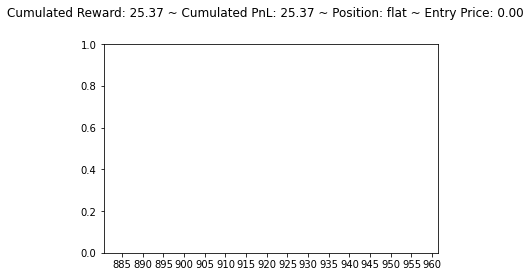

[ 914.2494 1393.522  1098.9586]
flat buy long


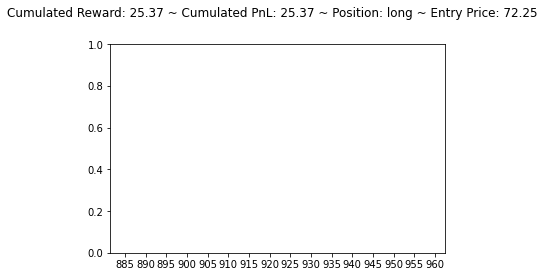

[1042.6556 1486.9781 1217.9049]
long sell flat


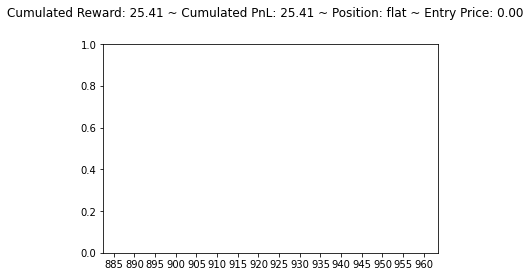

[395.543   251.84601 540.90515]
flat sell short


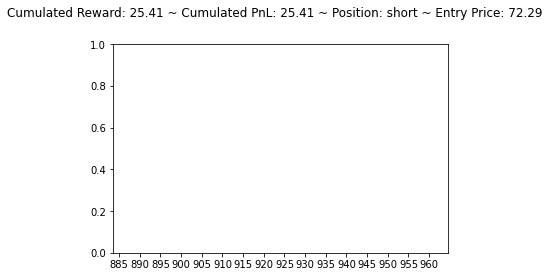

[337.86264 473.12604 468.31183]
short buy flat


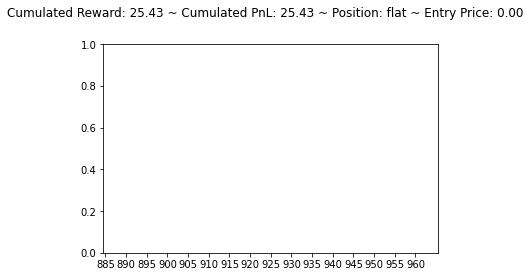

[293.0898  454.9542  411.24878]
flat buy long


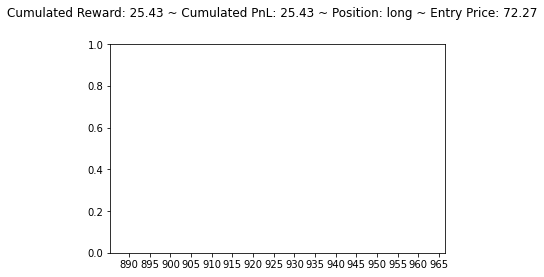

[339.6383  439.17294 391.5451 ]
long sell flat


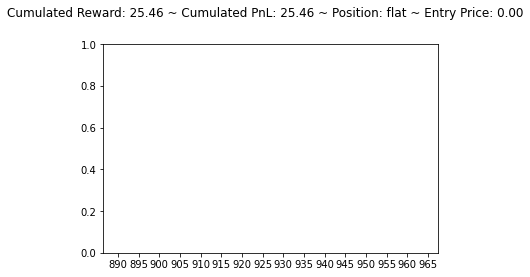

[239.12724 480.03592 424.73444]
flat buy long


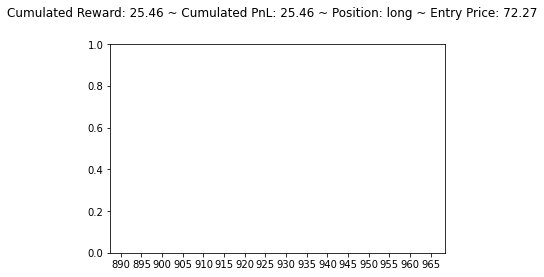

[485.56195 419.82297 450.96326]
long hold long


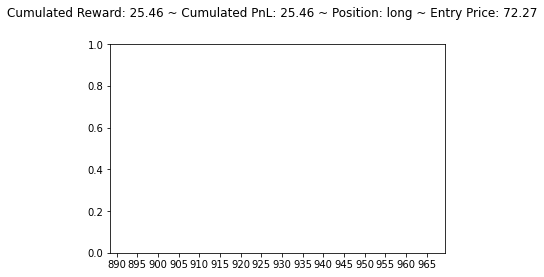

[317.41928 414.3336  360.33008]
long sell flat


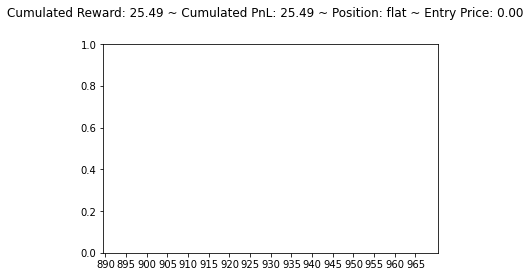

[316.12753 444.39297 401.91858]
flat buy long


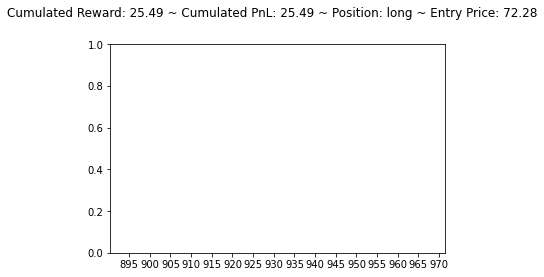

[264.57343 504.94443 505.69858]
long sell flat


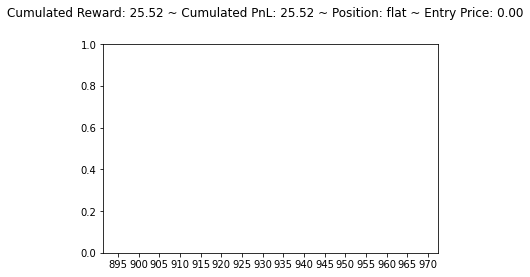

[206.16168 329.00684 206.9564 ]
flat buy long


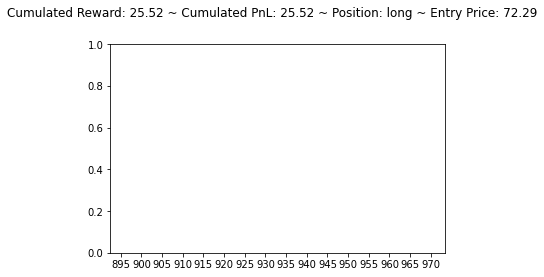

[106.733925 182.70131  188.1035  ]
long sell flat


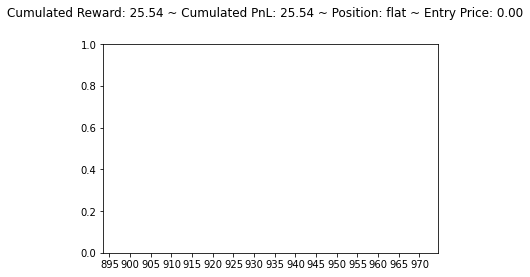

[127.12108 207.92984 162.2071 ]
flat buy long


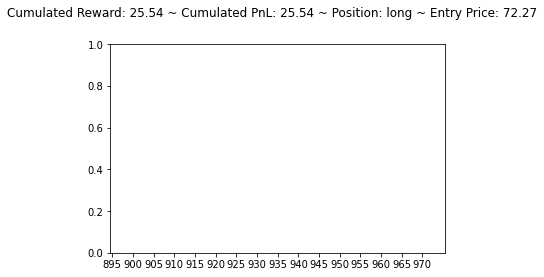

[193.72852 440.7731  359.39624]
long sell flat


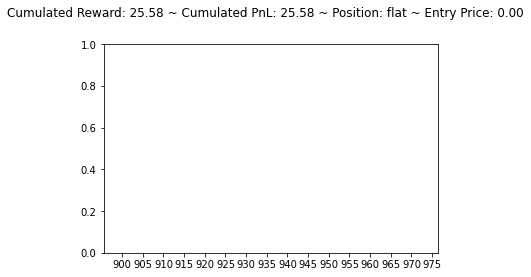

[200.95488 397.7517  306.17874]
flat buy long


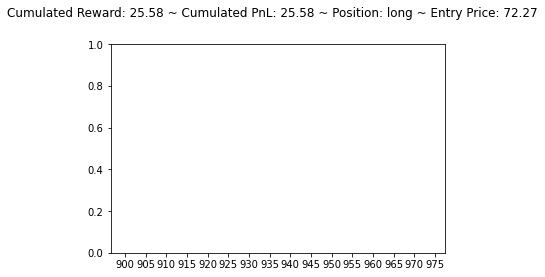

[202.68283 418.938   339.46674]
long sell flat


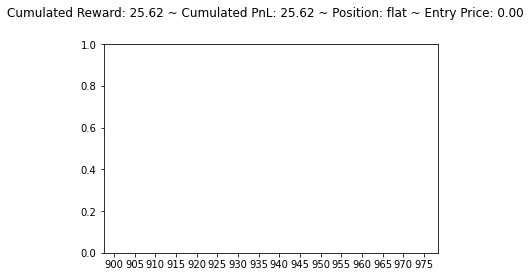

[154.33992 314.43765 239.72786]
flat buy long


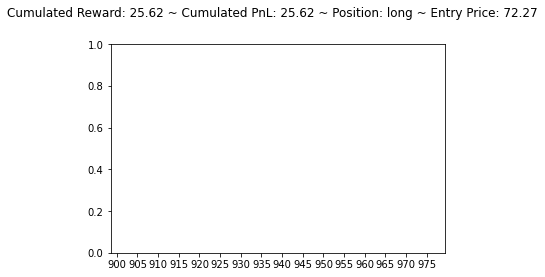

[168.70566 369.1837  200.68701]
long sell flat


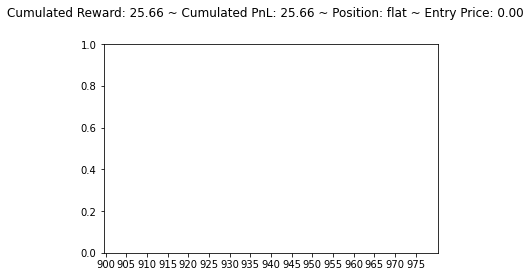

[303.3663  274.11563 204.24841]
flat hold flat


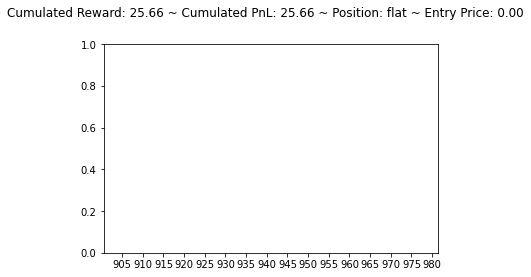

[202.32924 312.41742 208.97496]
flat buy long


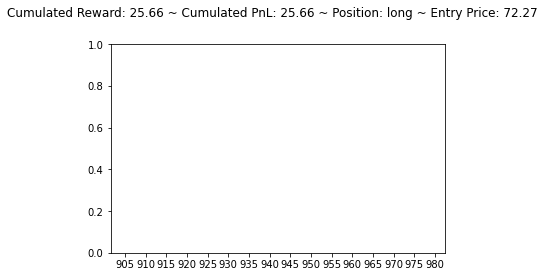

[192.1005  371.79355 330.22076]
long sell flat


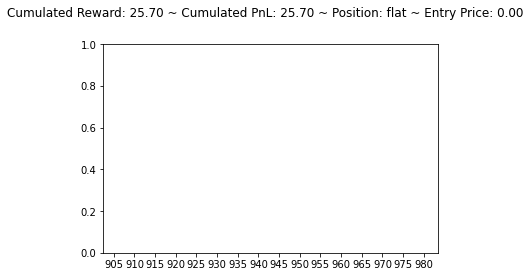

[244.51776 393.5473  340.7423 ]
flat buy long


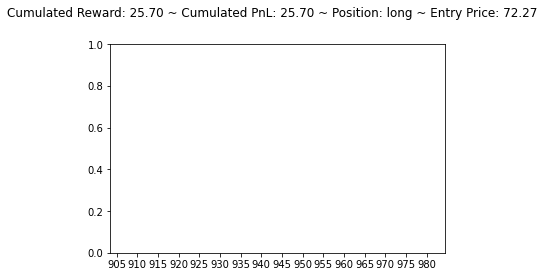

[527.9763  572.07324 440.91882]
long hold long


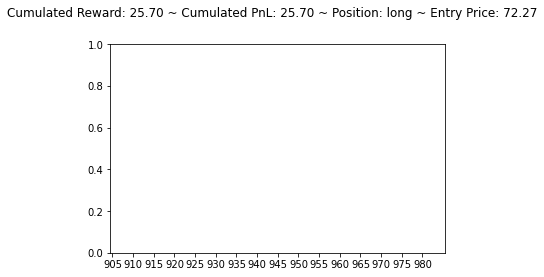

[414.09625 565.63226 458.2259 ]
long sell flat


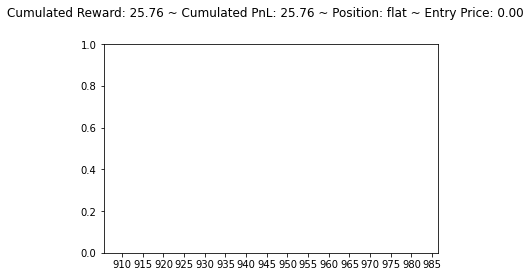

[184.978   358.37558 277.76505]
flat buy long


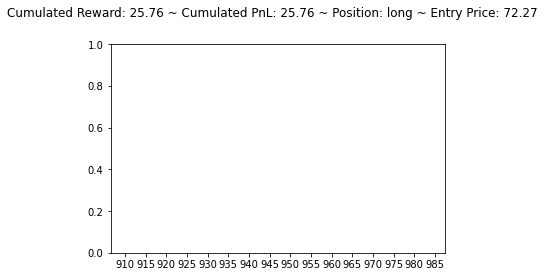

[239.17496 407.48517 268.21024]
long sell flat


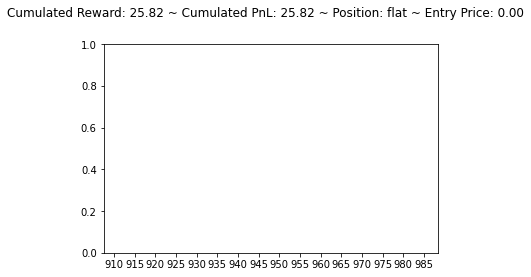

[224.32074 398.19046 354.25885]
flat buy long


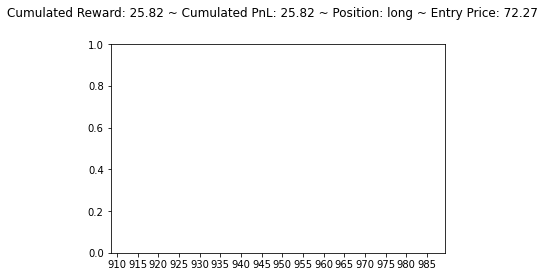

[203.12247 379.56268 326.42706]
long sell flat


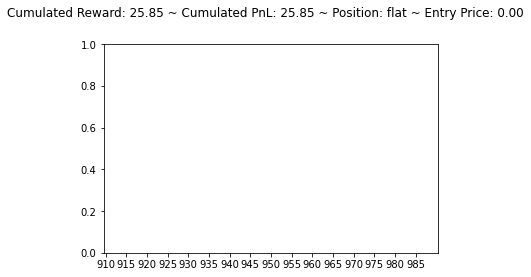

[191.438   353.86316 289.88058]
flat buy long


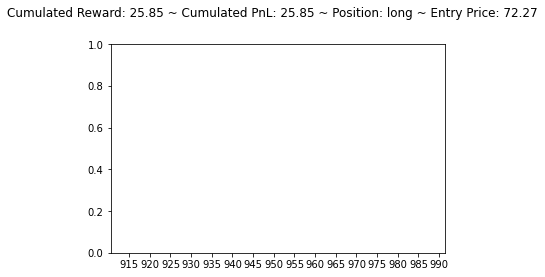

[189.24146 368.1943  315.39963]
long sell flat


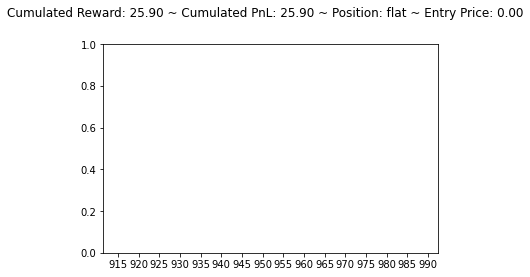

[180.77797 344.03476 258.73154]
flat buy long


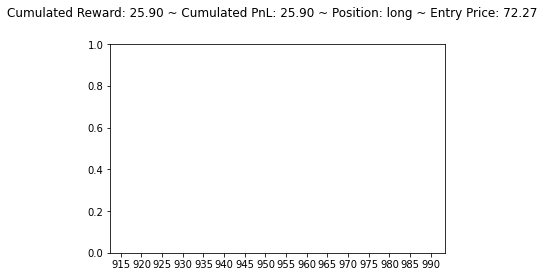

[238.26999 480.0228  368.81042]
long sell flat


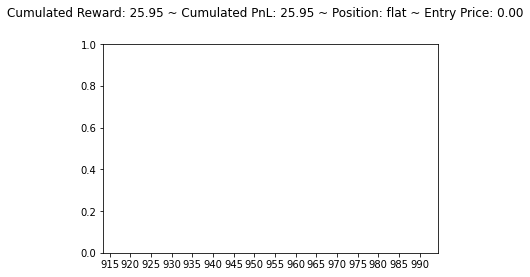

[331.11456 726.07684 535.5238 ]
flat buy long


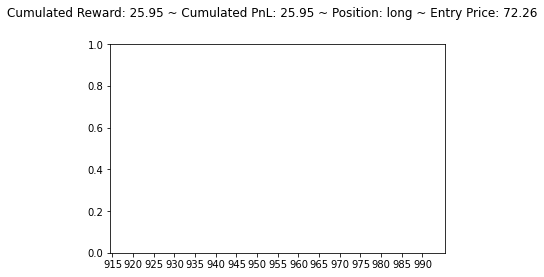

[385.34222 479.4631  484.52524]
long sell flat


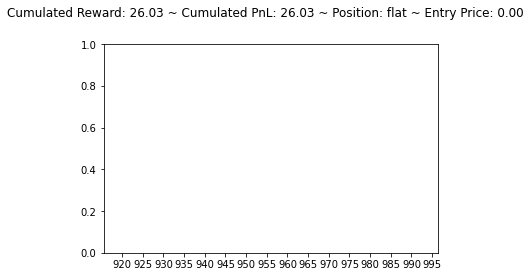

[387.95795 483.05457 448.2151 ]
flat buy long


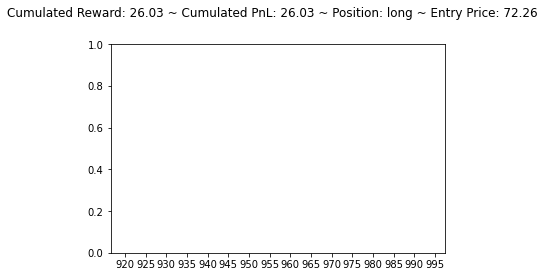

[373.28186 475.9379  563.69495]
long sell flat


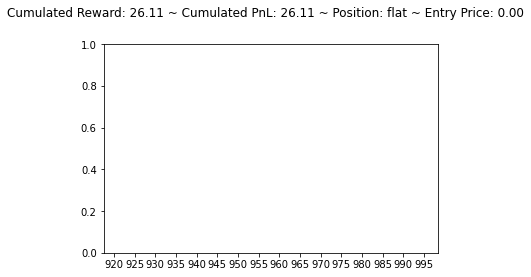

[250.36066 456.72128 401.73706]
flat buy long


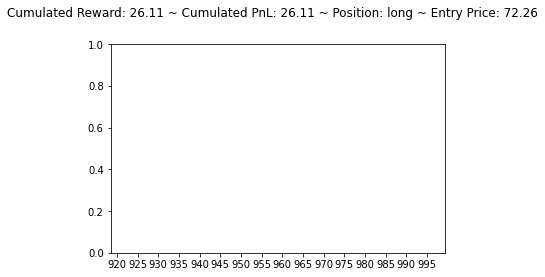

[234.81079 423.4056  349.58163]
long sell flat


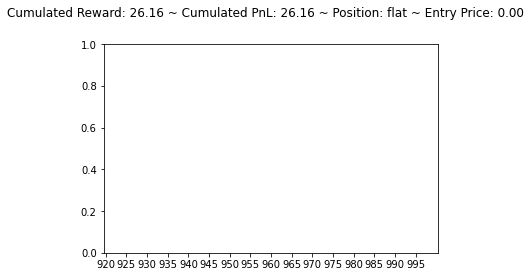

In [43]:
# Running the agent
done = False
state = environment.reset()
while not done:
    action = agent.act(state)
    
    for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            position_name = position
        
    for _action in environment._actions:
          if all(action==environment._actions[_action]):
            action_name = _action
    
    state, _, done, info = environment.step(action)
    
    for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            next_position_name = position
               
    print(position_name, action_name, next_position_name)
    
    if 'status' in info and info['status'] == 'Closed plot':
        done = True
    else:
        environment.render()